<a href="https://colab.research.google.com/github/dwarfy35/deep_learning2/blob/main/Working_CGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [73]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.optim as optim
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from google.colab import drive
from torch.autograd import grad
from sklearn.model_selection import train_test_split
from torch.utils.data import ConcatDataset
from torch.autograd import grad
from collections import defaultdict

drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [74]:
ngf = 32
nc = 1
ndf = 32

number of fonts is 14990

In [75]:
class FontStyleEncoder(nn.Module):
    def __init__(self, img_size, style_dim):
        super(FontStyleEncoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size=4, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.ReLU(),
            nn.Flatten(),
            nn.Linear(128 * (img_size // 4) ** 2, style_dim)  # Global style features
        )

    def forward(self, x):
        return self.encoder(x)  # Returns a feature vector representing the font style


In [76]:
class Generator3(nn.Module):
    def __init__(self, latent_dim, style_dim=128, img_size=32):
        """
        Args:
            latent_dim: Dimension of the latent vector (z).
            style_dim: Dimension of the font style vector extracted by FontStyleEncoder.
            img_size: Spatial size of the input image (assumed square).
        """
        super(Generator3, self).__init__()

        self.init_size = img_size // 16  # Initial spatial size after FC layer
        self.fc = nn.Linear(latent_dim + style_dim, 512 * self.init_size * self.init_size)

        # Deconvolutional blocks
        self.deconv_blocks = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 1, kernel_size=4, stride=2, padding=1),
            nn.Tanh(),
        )

        # FontStyleEncoder to extract font style features
        self.font_style_encoder = FontStyleEncoder(img_size, style_dim)

    def forward(self, z, condition):
        """
        Forward pass for the generator.

        Args:
            z: Latent vector (batch_size, latent_dim).
            condition: Conditional image (batch_size, 1, img_size, img_size).

        Returns:
            Generated image (batch_size, 1, img_size, img_size).
        """
        # Extract font style features from the condition image
        #font_style_features = self.font_style_encoder(condition)
        condition_features = condition.mean(dim=(2, 3))  # Global average pooling
        condition_features = condition_features.view(-1, 1)  # Flatten to scalar

        # Concatenate latent vector with font style features
        #z = torch.cat((z, font_style_features), dim=1)
        z = torch.cat((z, condition_features), dim=1)
        out = self.fc(z).view(-1, 128, 4, 4)
        # Fully connected layer
        #out = self.fc(z)
        out = out.view(out.size(0), 512, self.init_size, self.init_size)

        # Deconvolutional blocks
        img = self.deconv_blocks(out)
        return img


class Discriminator3(nn.Module):
    def __init__(self, nc=1, ndf=32):
        """
        Args:
            nc: Number of channels in the input image (e.g., 1 for grayscale).
            ndf: Number of filters in the first convolutional layer.
        """
        super(Discriminator3, self).__init__()

        # Increase input channels to handle the concatenated image and condition
        self.main = nn.Sequential(
            nn.Conv2d(nc * 2, ndf, 4, 2, 1, bias=False),  # Input channels = 2 (img + condition)
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),
        )

    def forward(self, img, condition_img):
        """
        Args:
            img: Input image (real or fake).
            condition_img: Conditional image.

        Returns:
            validity: Discriminator's validity score for the input.
        """
        # Concatenate the input image and condition along the channel dimension
        x = torch.cat((img, condition_img), dim=1)
        validity = self.main(x)
        return validity




In [77]:
class NPZDataset(Dataset):
    def __init__(self, npz_file, font_range=None, transform=None, filter_label=None, num_samples=None):
        """
        Initialize the dataset with optional filtering by font range.

        Args:
            npz_file (str): Path to the .npz file containing images and labels.
            font_range (tuple, optional): Range of fonts to include (start, end). If None, include all fonts.
            transform (callable, optional): Transformations to apply to the images.
            filter_label (int, optional): Filter dataset by a specific label.
            num_samples (int, optional): Limit the number of samples in the dataset.
        """
        # Load the data from the .npz file
        data = np.load(npz_file)
        self.images = data['images']
        self.labels = data['labels']
        self.transform = transform

        font_size = 26  # Number of letters per font (A-Z)

        # Limit the dataset to the specified range of fonts
        if font_range is not None:
            start_font, end_font = font_range
            start_idx = start_font * font_size
            end_idx = end_font * font_size  # Exclusive of the last font
            self.images = self.images[start_idx:end_idx]
            self.labels = self.labels[start_idx:end_idx]

        # Filter by label if specified
        if filter_label is not None:
            # Find indices of the desired label
            label_indices = np.where(self.labels == filter_label)[0]

            # If num_samples is specified, limit the number of samples
            if num_samples is not None:
                label_indices = label_indices[:num_samples]

            # Filter images and labels
            self.images = self.images[label_indices]
            self.labels = self.labels[label_indices]

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        """
        Retrieve an item from the dataset.

        Args:
            idx (int): Index of the item.

        Returns:
            Tuple[torch.Tensor, torch.Tensor, torch.Tensor]: Image, condition image, and label.
        """
        # Get the image and label for the given index
        image = self.images[idx]
        label = self.labels[idx]

        # Determine the font ID based on dataset ordering
        font_id = idx // 26  # Calculate the font ID based on position in dataset

        # Get the "A" from the same font as the condition
        condition_index = font_id * 26  # First letter (A) of the current font
        condition_image = self.images[condition_index]

        # Reshape the images
        image = image[np.newaxis, ...]  # Add channel dimension
        condition_image = condition_image[np.newaxis, ...]

        # Apply transformations if any
        if self.transform:
            image = self.transform(image)
            condition_image = self.transform(condition_image)

        # Convert to PyTorch tensors
        image = torch.tensor(image, dtype=torch.float32)
        condition_image = torch.tensor(condition_image, dtype=torch.float32)
        label = torch.tensor(label, dtype=torch.long)

        return image, condition_image, label


In [78]:
def number_to_alphabet(num):
    if 0 <= num <= 25:
        return chr(num + 65)  # 65 is the ASCII code for 'A'
    else:
        raise ValueError("Number must be between 0 and 25 inclusive.")


In [79]:
def displayGeneratedImage(class_index, generator, z_s, num_classes, device='cuda'):
    """
    Generates and displays an image for a given class using the generator.

    Args:
        class_index (int): Index of the character class to generate (0 to num_classes - 1).
        generator (nn.Module): Pre-trained generator model.
        z_dim (int): Dimension of the style vector.
        num_classes (int): Number of character classes.
        device (str): Device for computation ('cuda' or 'cpu').
    """
    # Ensure the class index is valid
    if not (0 <= class_index < num_classes):
        raise ValueError(f"Invalid class_index: {class_index}. Must be in range [0, {num_classes - 1}].")

    # Create the one-hot vector for the class
    z_c = torch.zeros(1, num_classes, device=device)
    z_c[0, class_index] = 1  # Set the desired class

    # Create the random style vector
    #z_s = torch.randn(1, z_dim, device=device)

    # Concatenate the style and class vectors
    z = torch.cat((z_s, z_c), dim=1)

    # Generate the image
    with torch.no_grad():
        generated_img = generator(z).cpu().numpy()[0, 0]  # Extract the first batch and first channel

    # Rescale the image from [-1, 1] to [0, 255]
    #generated_img = np.rot90(generated_img, k=-1)
    generated_img = np.uint8(np.interp(generated_img, (-1, 1), (0, 255)))

    # Display the image
    plt.figure(figsize=(5, 5))
    plt.imshow(generated_img, cmap='gray')
    plt.axis("off")
    plt.title(f"Generated Image for Class {number_to_alphabet(class_index)}")
    plt.show()


In [80]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))  # Normalize to [-1, 1]
])

#dataset = NPZDataset(npz_file, transform=transform)

In [90]:
def compute_gradient_penalty(discriminator, real_samples, fake_samples, condition_samples, device="cuda"):
    """
    Compute the gradient penalty for WGAN-GP in a conditional GAN setup where
    the discriminator takes both the input and the condition image.

    Args:
        discriminator: The discriminator model.
        real_samples: Batch of real images.
        fake_samples: Batch of fake images generated by the generator.
        condition_samples: Batch of conditional images (e.g., letter A from the same font).
        device: The device to run the computations on.

    Returns:
        Gradient penalty (scalar).
    """
    # Interpolate between real and fake samples
    alpha = torch.rand(real_samples.size(0), 1, 1, 1, device=device)  # Mixing factor
    interpolated_samples = (alpha * real_samples + (1 - alpha) * fake_samples).requires_grad_(True)

    # Compute the discriminator output for the interpolated samples and conditions
    d_interpolates = discriminator(interpolated_samples, condition_samples)

    # Flatten the discriminator output
    d_interpolates = d_interpolates.view(-1)  # Shape: [batch_size]

    # Create grad_outputs for the gradient computation
    fake = torch.ones(d_interpolates.size(), device=device)

    # Compute gradients of the discriminator's output w.r.t. interpolated inputs
    gradients = torch.autograd.grad(
        outputs=d_interpolates,
        inputs=interpolated_samples,
        grad_outputs=fake,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]

    # Compute the gradient penalty
    gradients = gradients.view(gradients.size(0), -1)  # Flatten gradients
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()

    return gradient_penalty


In [82]:
def split_dataset_no_shuffle(full_data, test_size=0.1, val_size=0.1):
    """
    Split the dataset into train, validation, and test sets without shuffling.

    Args:
        full_data (Dataset): Full dataset to be split.
        test_size (float): Proportion of the dataset to include in the test split.
        val_size (float): Proportion of the dataset to include in the validation split.

    Returns:
        train_data (Dataset): Training split.
        val_data (Dataset): Validation split.
        test_data (Dataset): Test split.
    """
    total_size = len(full_data)
    test_size_count = int(total_size * test_size)
    val_size_count = int(total_size * val_size)
    train_size_count = total_size - test_size_count - val_size_count

    # Perform the split without shuffling (sequential split)
    train_data = torch.utils.data.Subset(full_data, range(0, train_size_count))
    val_data = torch.utils.data.Subset(full_data, range(train_size_count, train_size_count + val_size_count))
    test_data = torch.utils.data.Subset(full_data, range(train_size_count + val_size_count, total_size))

    return train_data, val_data, test_data


# Example usage with your dataset (assuming `fullData` is already loaded as a PyTorch Dataset)


In [83]:
# Hyperparameters
z_dim = 100
num_classes = 26  # For uppercase alphabets
img_size = 32  # Assuming 32x32 images
batch_size = 1024
print(batch_size)
lr = 0.0002
lambda_gp = 10  # Gradient penalty weight
n_critic = 5  # Number of discriminator updates per generator update
epochs = 100
npz_file = "/content/gdrive/My Drive/character_font.npz"

fullData = NPZDataset(npz_file, transform=transform)
#train_data, val_data, test_data = split_dataset_no_shuffle(full_data=fullData, test_size=0.1, val_size=0.1)
train_data = NPZDataset(npz_file, font_range=(0,100),transform=transform)

# Print sizes to verify
#print(f"Train Data: {len(train_data)} samples")
#print(f"Validation Data: {len(val_data)} samples")
#print(f"Test Data: {len(test_data)} samples")
#print(len(fullData))

#testing_data = NPZDataset(npz_file, transform=transform, num_fonts=1)

1024


In [84]:
#testloader = DataLoader(test_data, batch_size=1, shuffle=False)

In [85]:
from collections import defaultdict


In [86]:
from collections import defaultdict
from torch.utils.data import DataLoader

# Step 1: Group the data by label
grouped_data = defaultdict(list)
for img, condition_img, label in train_data:  # Unpack condition_img as well
    grouped_data[label.item()].append((img, condition_img, label))

# Step 2: Prepare datasets for each label
grouped_datasets = {
    label: [(img, cond_img, lbl) for img, cond_img, lbl in imgs]
    for label, imgs in grouped_data.items()
}

# Step 3: Create dataloaders for each group
grouped_dataloaders = {
    letter: DataLoader(dataset, batch_size=batch_size, shuffle=False)
    for letter, dataset in grouped_datasets.items()
}


<ipython-input-77-0151f720c1fe>:76: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image = torch.tensor(image, dtype=torch.float32)
<ipython-input-77-0151f720c1fe>:77: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  condition_image = torch.tensor(condition_image, dtype=torch.float32)


In [87]:
def displayGeneratorOutput(generator, z_s, condition_image, class_index, num_classes, device='cuda'):
    """
    Displays the output of the generator for a single class.

    Args:
        generator (nn.Module): Pre-trained generator model.
        z_s (torch.Tensor): Style vector.
        condition_image (torch.Tensor): Conditional image (e.g., "A").
        class_index (int): Index of the class to generate (0-25 for A-Z).
        num_classes (int): Total number of character classes.
        device (str): Device for computation ('cuda' or 'cpu').
    """
    # Ensure the inputs are on the correct device
    z_s = z_s.to(device)
    condition_image = condition_image.to(device)

    # Create the one-hot vector for the class
    z_c = torch.zeros(batch_size, num_classes, device=device)
    z_c[0, class_index] = 1  # Set the desired class

    # Concatenate the style and class vectors
    z = torch.cat((z_s, z_c), dim=1)

    # Generate the image
    with torch.no_grad():
        generated_img = generator(z, condition_image.unsqueeze(0)).cpu().numpy()[0, 0]

    # Rescale the image from [-1, 1] to [0, 255]
    generated_img = np.uint8(np.interp(generated_img, (-1, 1), (0, 255)))
    condition_img = np.uint8(np.interp(condition_img, (-1, 1), (0, 255)))
    # Display the generated image
    plt.imshow(generated_img, cmap='gray')
    plt.axis("off")
    plt.title(f"Generated Image for Class {chr(65 + class_index)}")  # Convert index to letter
    plt.show()
    plt.imshow(condition_img, cmap='gray')
    plt.axis("off")
    plt.title(f"Condition")  # Convert index to letter
    plt.show()


In [88]:
import matplotlib.pyplot as plt
import numpy as np


def displayGeneratedSample(generator, z_s, condition_imgs, labels, num_classes, class_index=0, device='cuda'):
    """
    Displays one generated image from the generator.

    Args:
        generator (nn.Module): Pre-trained generator model.
        z_s (torch.Tensor): Style vector.
        condition_imgs (torch.Tensor): Conditional images (batch).
        labels (torch.Tensor): Labels for the batch.
        num_classes (int): Number of character classes.
        class_index (int): Index of the sample in the batch to display.
        device (str): Device for computation ('cuda' or 'cpu').
    """
    # Ensure the inputs are on the correct device
    z_s = z_s.to(device)
    condition_imgs = condition_imgs.to(device)
    labels = labels.to(device)

    # Create one-hot encoding for the batch
    batch_size = labels.size(0)
    z_c = torch.zeros(batch_size, num_classes, device=device)
    z_c[torch.arange(batch_size), labels] = 1

    # Concatenate style and class vectors
    z = torch.cat((z_s, z_c), dim=1)

    # Generate images
    with torch.no_grad():
        fake_imgs = generator(z, condition_imgs)

    # Select the specified class index
    generated_img = fake_imgs[class_index].cpu().numpy()[0]  # Extract the first channel

    # Rescale the image from [-1, 1] to [0, 255]
    generated_img = np.uint8(np.interp(generated_img, (-1, 1), (0, 255)))

    # Display the generated image
    plt.imshow(generated_img, cmap='gray')
    plt.axis("off")
    plt.title(f"Generated Image for Class {chr(65 + labels[class_index].item())}")  # Convert label to letter
    plt.show()


In [95]:
def add_noise(images, noise_level=0.1):
    """
    Add Gaussian noise to images.

    Args:
        images: Tensor of images (B, C, H, W).
        noise_level: Standard deviation of the Gaussian noise.

    Returns:
        Noisy images.
    """
    noise = torch.randn_like(images) * noise_level
    return images + noise


In [ ]:
import torch.nn.functional as F

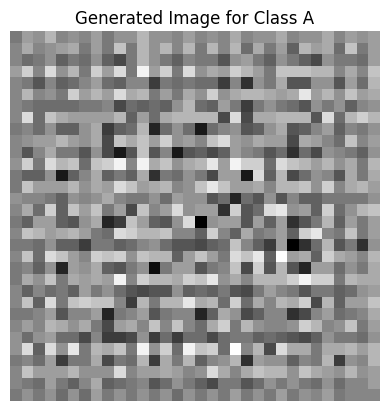

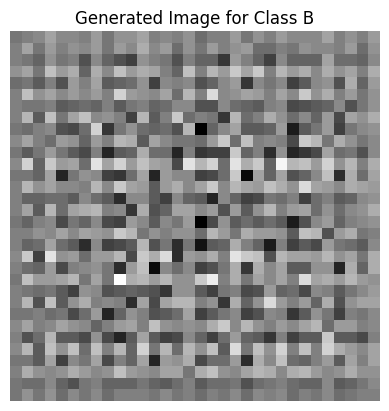

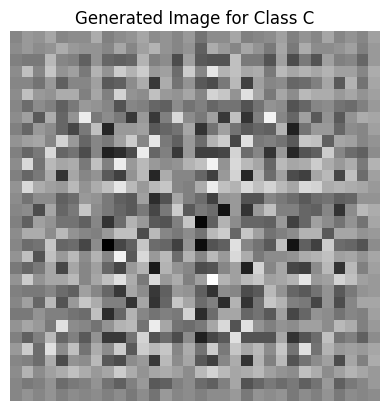

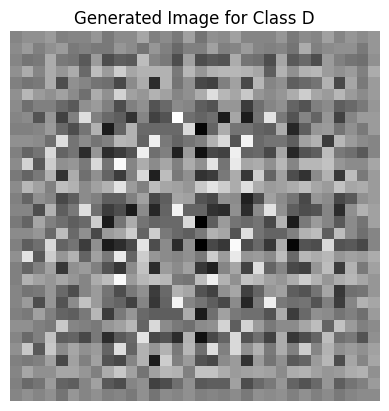

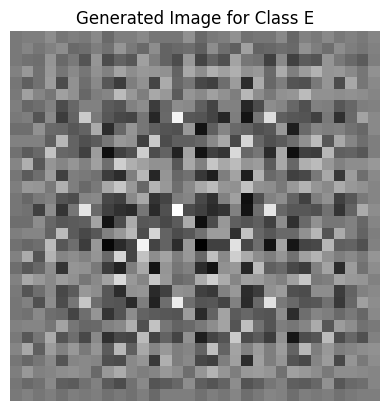

...

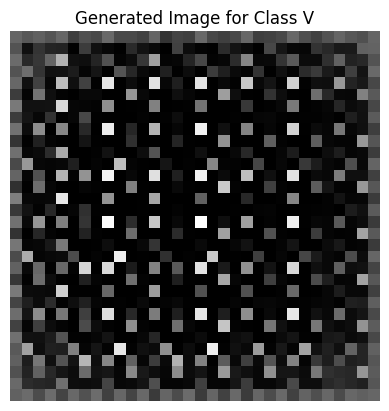

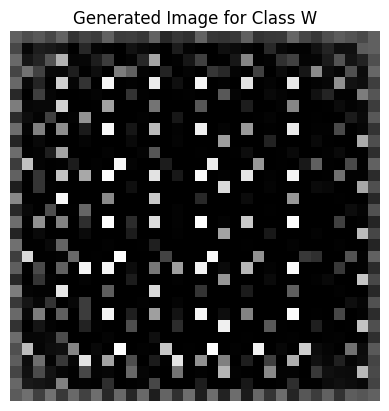

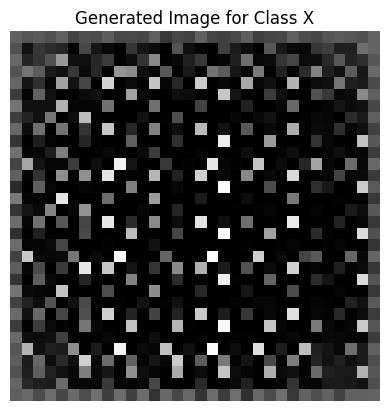

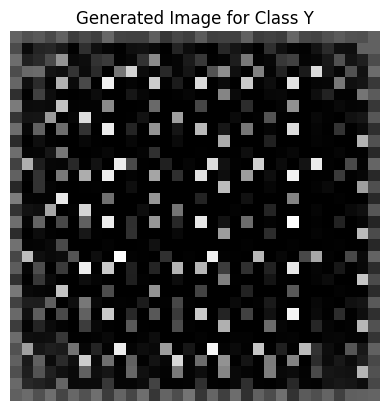

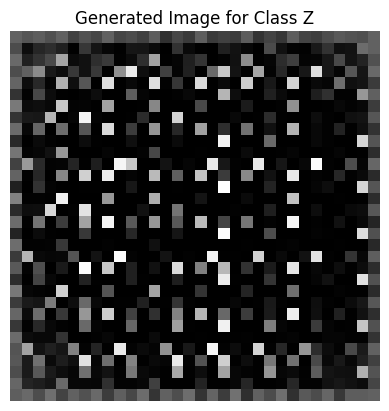

Epoch [1/5000], D_loss: 5.6644, G_loss: -1.0679
Epoch [2/5000], D_loss: -5.6995, G_loss: -0.9481
Epoch [3/5000], D_loss: -17.0760, G_loss: 5.8173
Epoch [4/5000], D_loss: -23.7468, G_loss: -12.4182
Epoch [5/5000], D_loss: -18.1441, G_loss: -3.6899
Epoch [6/5000], D_loss: -22.3438, G_loss: -2.5253
Epoch [7/5000], D_loss: -10.9843, G_loss: -24.9778
Epoch [8/5000], D_loss: -8.4942, G_loss: -10.0099
Epoch [9/5000], D_loss: -25.7379, G_loss: 7.3252
Epoch [10/5000], D_loss: -9.7092, G_loss: -23.5911
Epoch [11/5000], D_loss: -11.3865, G_loss: 0.4124
Epoch [12/5000], D_loss: -16.8145, G_loss: -0.7901
Epoch [13/5000], D_loss: -5.0412, G_loss: 1.3595
Epoch [14/5000], D_loss: -13.5978, G_loss: 2.5940
Epoch [15/5000], D_loss: -15.7848, G_loss: 2.9428
Epoch [16/5000], D_loss: -16.7221, G_loss: 1.6659
Epoch [17/5000], D_loss: -13.7733, G_loss: 3.1771
Epoch [18/5000], D_loss: -16.2161, G_loss: -0.6340
Epoch [19/5000], D_loss: -14.4233, G_loss: -5.5039
Epoch [20/5000], D_loss: -13.3874, G_loss: -1.2227

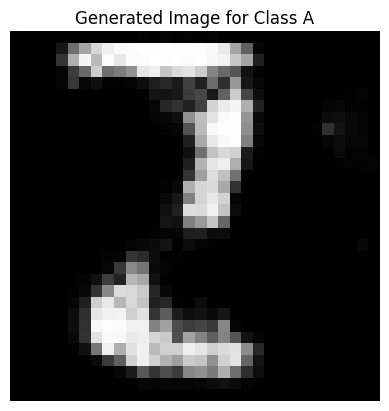

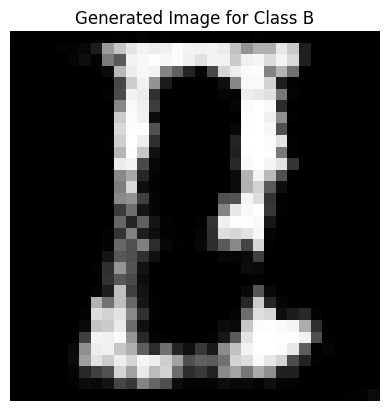

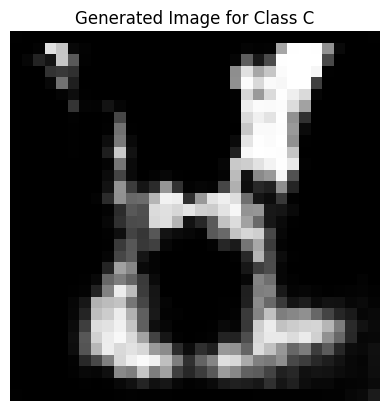

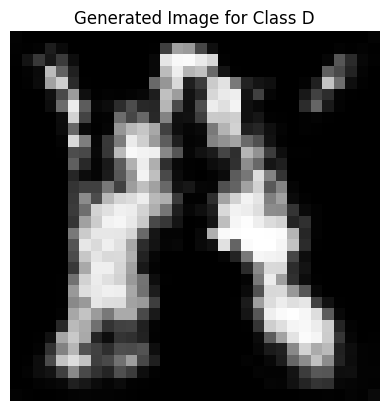

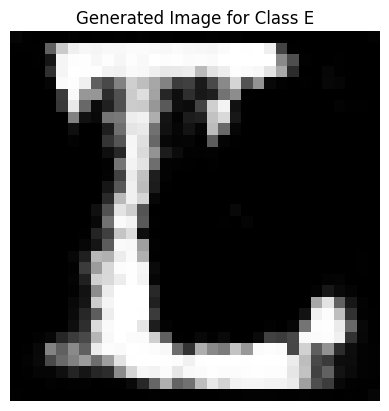

...

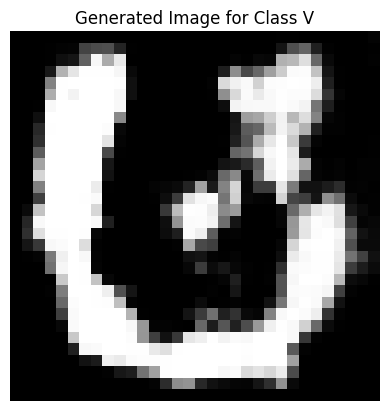

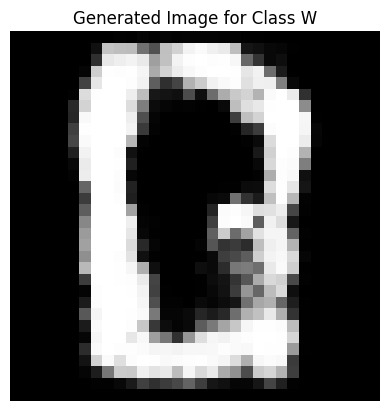

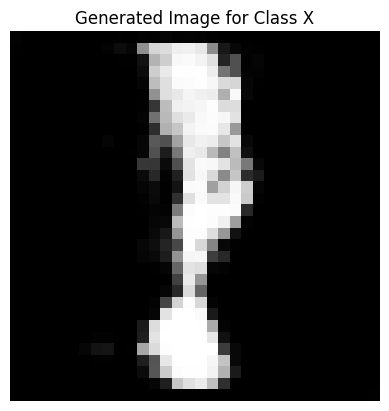

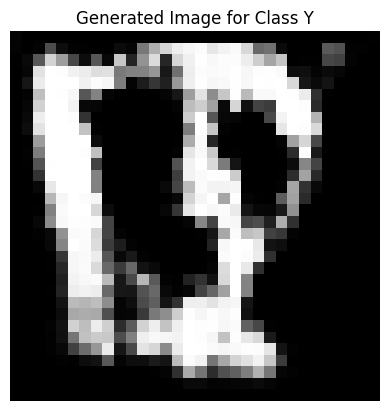

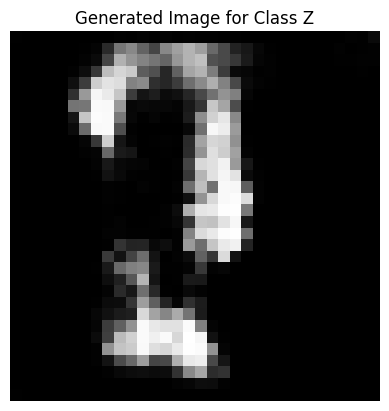

Epoch [201/5000], D_loss: -5.2272, G_loss: -17.4777
Epoch [202/5000], D_loss: -5.4917, G_loss: -15.8417
Epoch [203/5000], D_loss: -3.9775, G_loss: -20.2277
Epoch [204/5000], D_loss: -5.6748, G_loss: -17.5719
Epoch [205/5000], D_loss: -5.2032, G_loss: -20.2052
Epoch [206/5000], D_loss: -5.4993, G_loss: -17.8465
Epoch [207/5000], D_loss: -5.8279, G_loss: -18.5472
Epoch [208/5000], D_loss: -5.1009, G_loss: -18.5257
Epoch [209/5000], D_loss: -3.6645, G_loss: -20.3044
Epoch [210/5000], D_loss: -5.4316, G_loss: -16.1649
Epoch [211/5000], D_loss: -4.7311, G_loss: -19.7968
Epoch [212/5000], D_loss: -4.4770, G_loss: -17.8075
Epoch [213/5000], D_loss: -6.0361, G_loss: -15.0550
Epoch [214/5000], D_loss: -5.0495, G_loss: -17.7415
Epoch [215/5000], D_loss: -4.8056, G_loss: -15.9656
Epoch [216/5000], D_loss: -4.2616, G_loss: -17.3623
Epoch [217/5000], D_loss: -5.6214, G_loss: -19.0489
Epoch [218/5000], D_loss: -5.5677, G_loss: -16.8525
Epoch [219/5000], D_loss: -4.7441, G_loss: -18.0361
Epoch [220/5

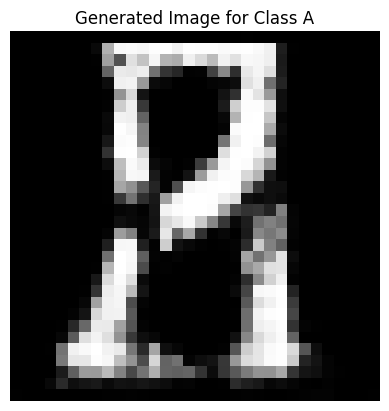

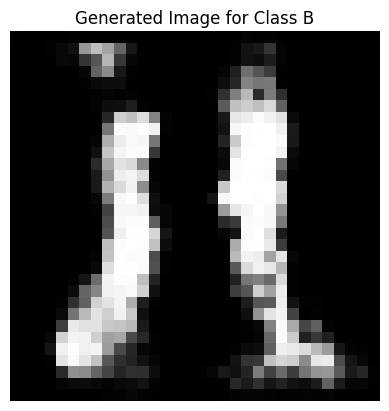

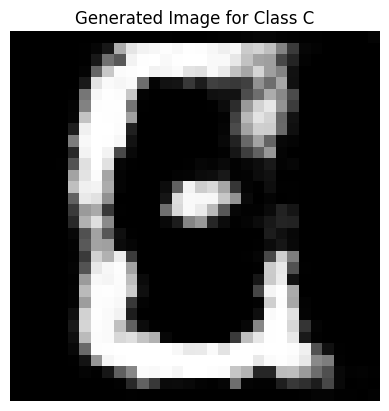

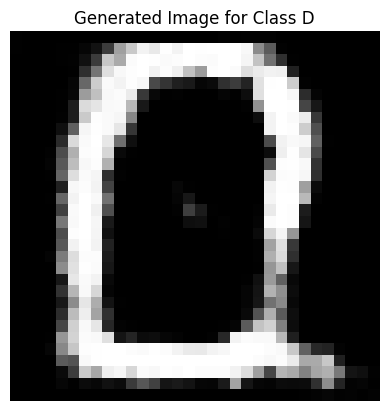

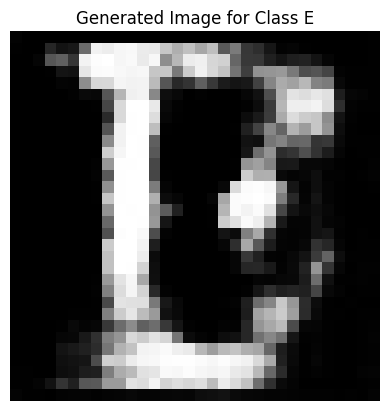

...

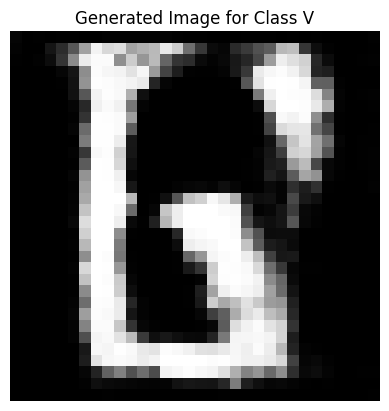

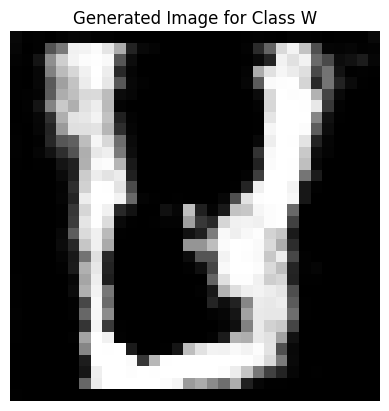

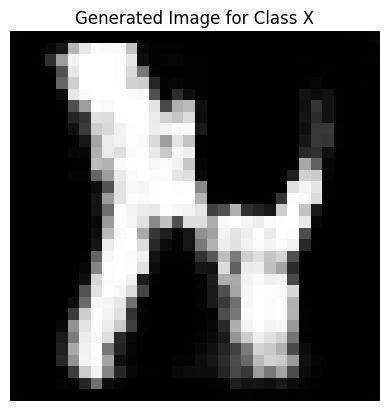

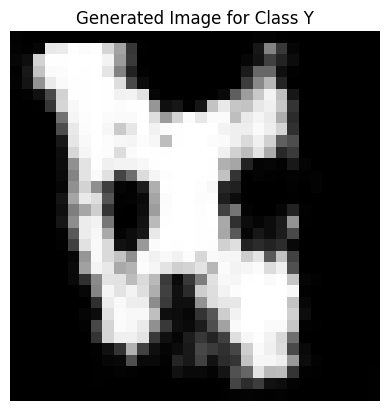

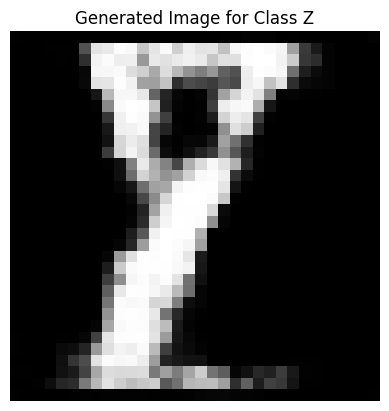

Epoch [401/5000], D_loss: -7.0570, G_loss: -39.8283
Epoch [402/5000], D_loss: -6.5742, G_loss: -40.2571
Epoch [403/5000], D_loss: -6.9412, G_loss: -40.1436
Epoch [404/5000], D_loss: -6.2811, G_loss: -42.8974
Epoch [405/5000], D_loss: -7.3264, G_loss: -45.0182
Epoch [406/5000], D_loss: -6.7640, G_loss: -43.0291
Epoch [407/5000], D_loss: -8.3157, G_loss: -42.6115
Epoch [408/5000], D_loss: -7.7823, G_loss: -44.3289
Epoch [409/5000], D_loss: -7.8009, G_loss: -42.4953
Epoch [410/5000], D_loss: -7.5103, G_loss: -40.6096
Epoch [411/5000], D_loss: -8.2253, G_loss: -39.8136
Epoch [412/5000], D_loss: -7.4801, G_loss: -39.9471
Epoch [413/5000], D_loss: -7.9564, G_loss: -41.7268
Epoch [414/5000], D_loss: -6.7857, G_loss: -42.8798
Epoch [415/5000], D_loss: -7.4614, G_loss: -41.5192
Epoch [416/5000], D_loss: -7.2358, G_loss: -42.7881
Epoch [417/5000], D_loss: -6.8697, G_loss: -43.0370
Epoch [418/5000], D_loss: -8.1042, G_loss: -42.2031
Epoch [419/5000], D_loss: -7.3776, G_loss: -41.0364
Epoch [420/5

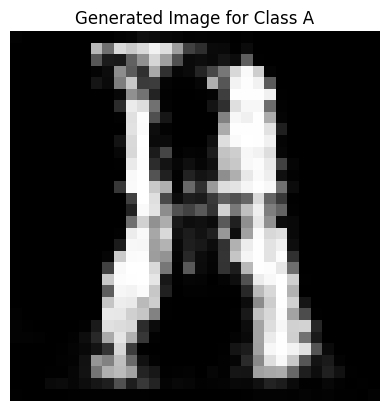

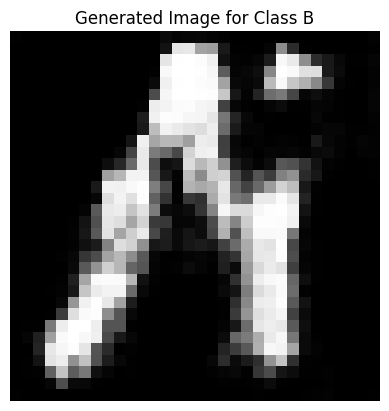

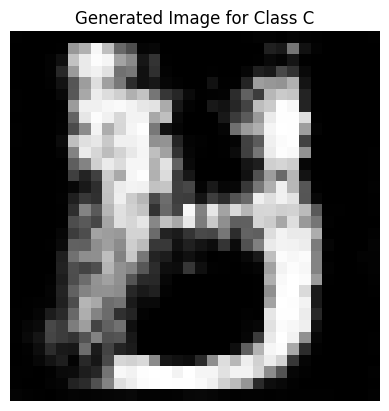

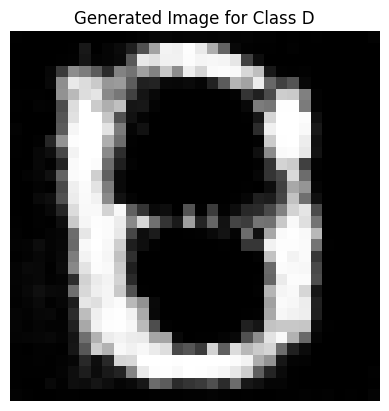

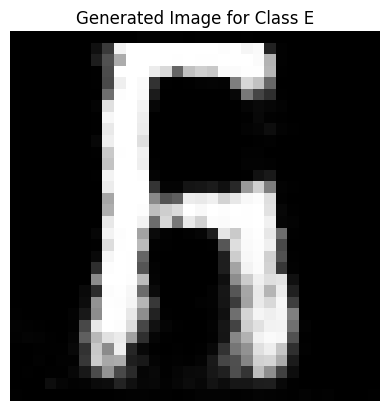

...

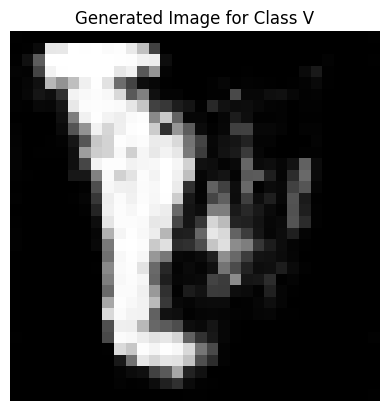

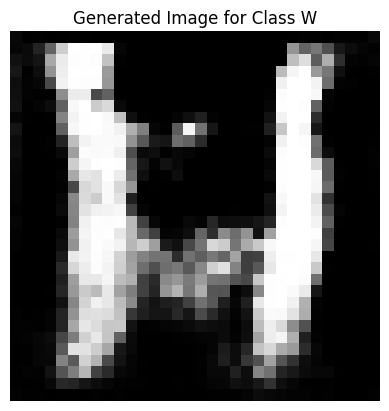

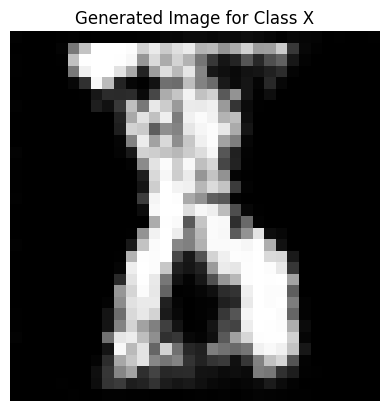

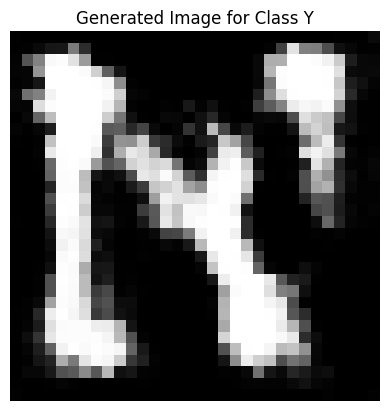

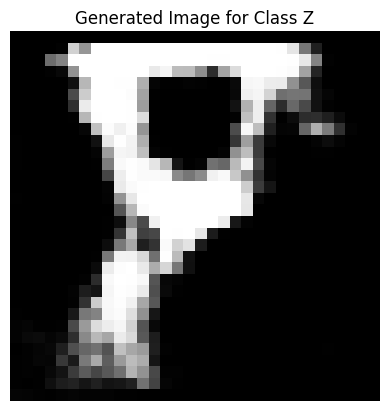

Epoch [601/5000], D_loss: -7.9896, G_loss: -34.6093
Epoch [602/5000], D_loss: -7.7058, G_loss: -37.1927
Epoch [603/5000], D_loss: -7.8727, G_loss: -37.5907
Epoch [604/5000], D_loss: -7.3974, G_loss: -38.3789
Epoch [605/5000], D_loss: -8.2085, G_loss: -40.4971
Epoch [606/5000], D_loss: -7.7437, G_loss: -38.3670
Epoch [607/5000], D_loss: -8.7838, G_loss: -40.9747
Epoch [608/5000], D_loss: -8.7633, G_loss: -38.8491
Epoch [609/5000], D_loss: -7.5875, G_loss: -40.5262
Epoch [610/5000], D_loss: -8.2872, G_loss: -40.0461
Epoch [611/5000], D_loss: -7.6984, G_loss: -38.1935
Epoch [612/5000], D_loss: -8.3188, G_loss: -35.8356
Epoch [613/5000], D_loss: -8.7087, G_loss: -35.7954
Epoch [614/5000], D_loss: -8.2377, G_loss: -35.5454
Epoch [615/5000], D_loss: -8.9707, G_loss: -34.5793
Epoch [616/5000], D_loss: -7.5896, G_loss: -32.5508
Epoch [617/5000], D_loss: -9.2434, G_loss: -35.2383
Epoch [618/5000], D_loss: -8.9226, G_loss: -34.1723
Epoch [619/5000], D_loss: -8.1788, G_loss: -32.5043
Epoch [620/5

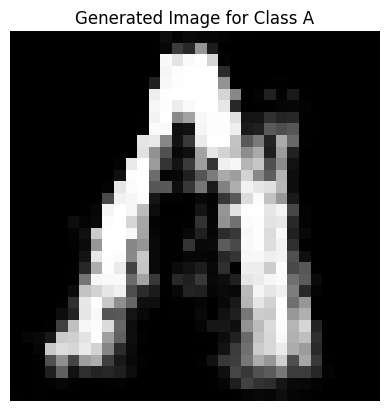

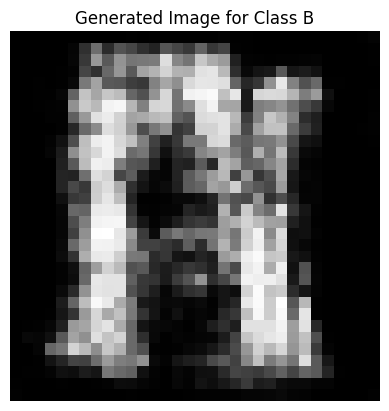

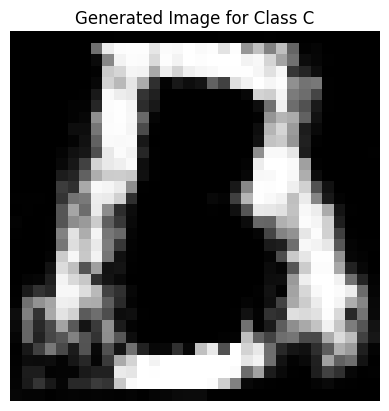

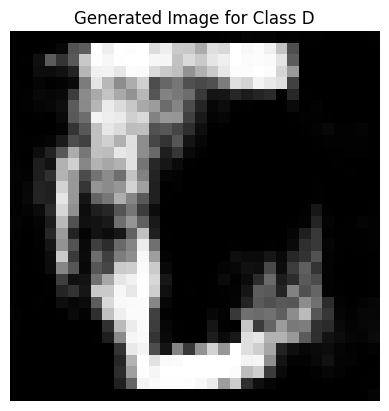

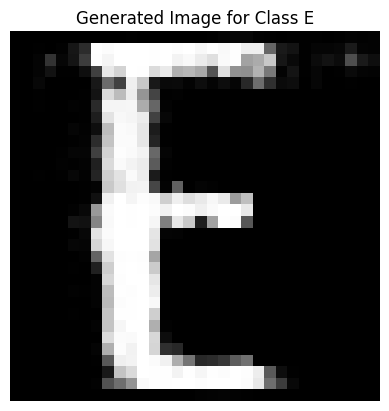

...

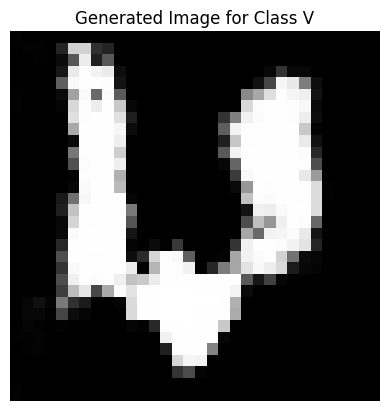

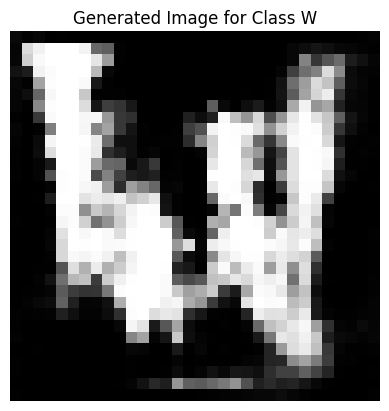

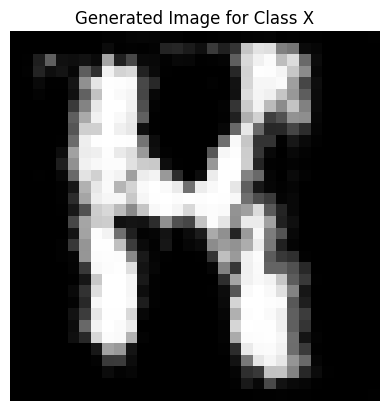

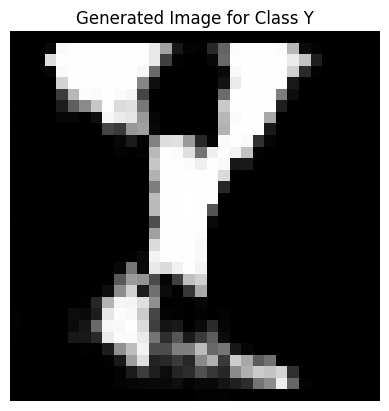

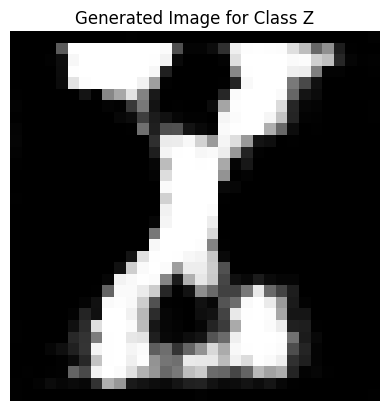

Epoch [801/5000], D_loss: -9.2977, G_loss: -26.4111
Epoch [802/5000], D_loss: -9.7280, G_loss: -27.2830
Epoch [803/5000], D_loss: -9.0728, G_loss: -25.3650
Epoch [804/5000], D_loss: -8.7512, G_loss: -27.7828
Epoch [805/5000], D_loss: -8.8640, G_loss: -32.7488
Epoch [806/5000], D_loss: -8.8825, G_loss: -32.9588
Epoch [807/5000], D_loss: -9.0308, G_loss: -28.8359
Epoch [808/5000], D_loss: -9.8587, G_loss: -33.7085
Epoch [809/5000], D_loss: -8.3379, G_loss: -33.1573
Epoch [810/5000], D_loss: -9.0052, G_loss: -31.8740
Epoch [811/5000], D_loss: -8.8939, G_loss: -34.5975
Epoch [812/5000], D_loss: -8.6699, G_loss: -31.7933
Epoch [813/5000], D_loss: -9.3628, G_loss: -33.3184
Epoch [814/5000], D_loss: -8.8598, G_loss: -33.2835
Epoch [815/5000], D_loss: -8.9090, G_loss: -30.4641
Epoch [816/5000], D_loss: -9.2716, G_loss: -30.9700
Epoch [817/5000], D_loss: -8.5369, G_loss: -34.1751
Epoch [818/5000], D_loss: -9.0810, G_loss: -35.3526
Epoch [819/5000], D_loss: -9.3141, G_loss: -33.3648
Epoch [820/5

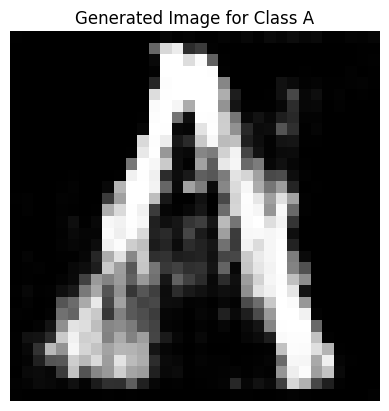

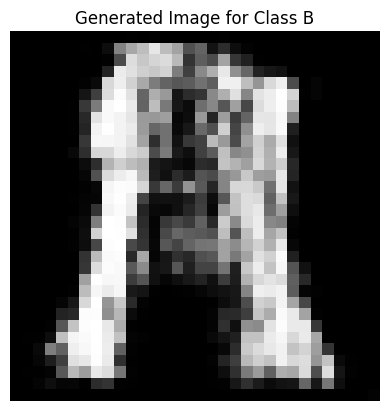

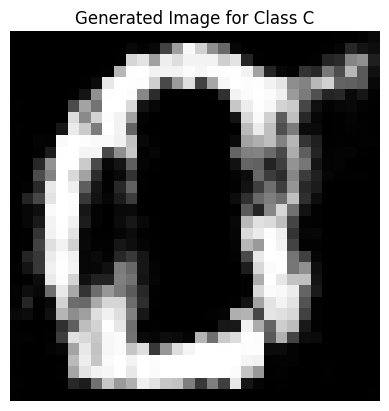

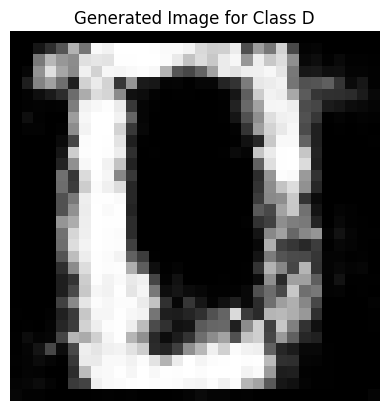

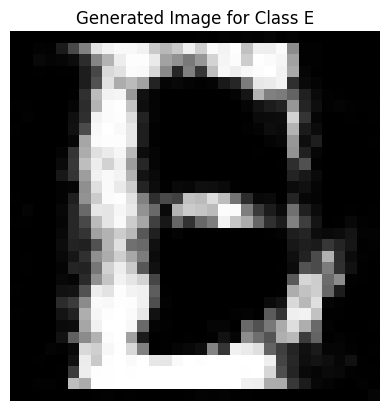

...

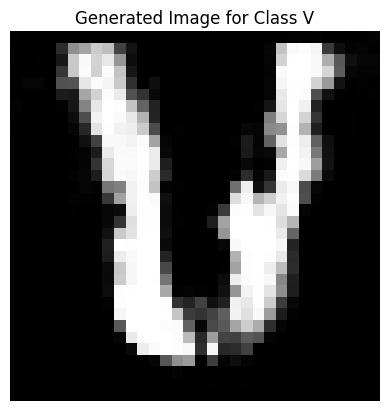

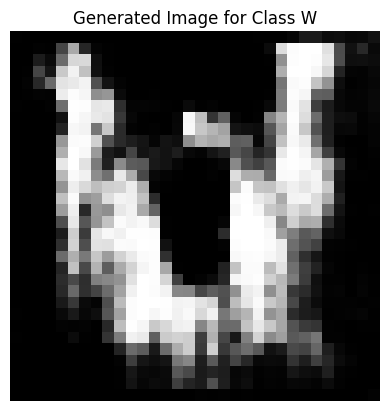

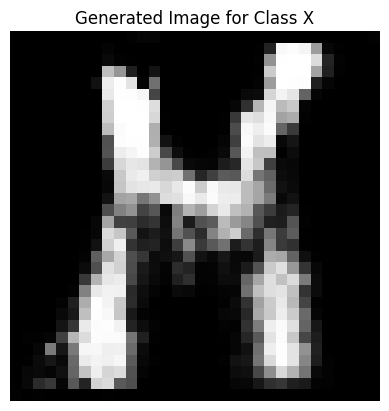

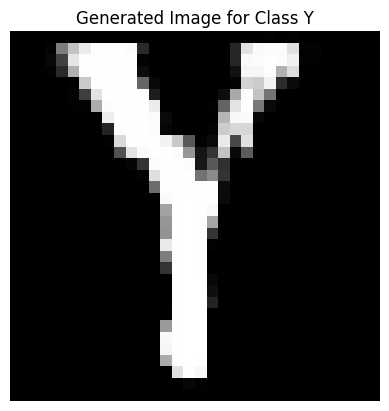

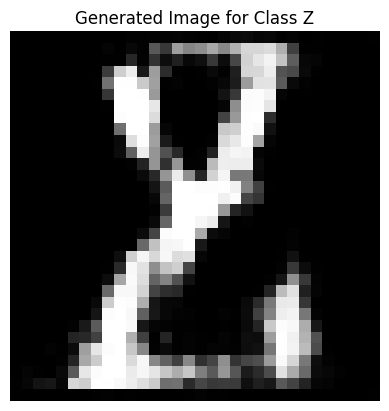

Epoch [1001/5000], D_loss: -9.5724, G_loss: -33.0745
Epoch [1002/5000], D_loss: -9.5981, G_loss: -28.0946
Epoch [1003/5000], D_loss: -9.6183, G_loss: -28.4912
Epoch [1004/5000], D_loss: -9.8977, G_loss: -28.0717
Epoch [1005/5000], D_loss: -9.1470, G_loss: -32.0276
Epoch [1006/5000], D_loss: -9.0920, G_loss: -32.5656
Epoch [1007/5000], D_loss: -9.9956, G_loss: -33.7370
Epoch [1008/5000], D_loss: -9.4821, G_loss: -32.6972
Epoch [1009/5000], D_loss: -9.2181, G_loss: -27.4303
Epoch [1010/5000], D_loss: -10.1625, G_loss: -30.9072
Epoch [1011/5000], D_loss: -9.5455, G_loss: -28.2731
Epoch [1012/5000], D_loss: -9.4721, G_loss: -22.3561
Epoch [1013/5000], D_loss: -9.3606, G_loss: -27.1043
Epoch [1014/5000], D_loss: -9.6130, G_loss: -26.3189
Epoch [1015/5000], D_loss: -9.7951, G_loss: -26.2966
Epoch [1016/5000], D_loss: -9.5588, G_loss: -30.4623
Epoch [1017/5000], D_loss: -9.4084, G_loss: -30.5594
Epoch [1018/5000], D_loss: -9.1951, G_loss: -28.7280
Epoch [1019/5000], D_loss: -10.2365, G_loss: 

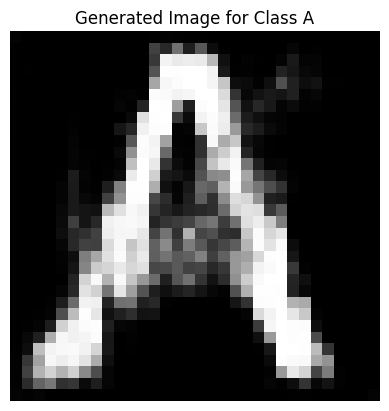

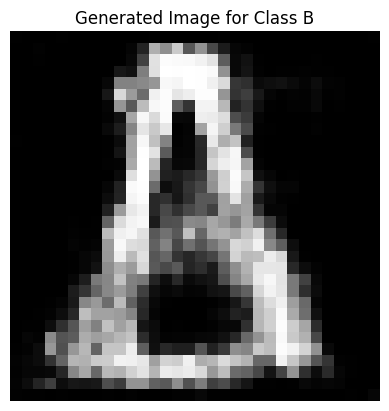

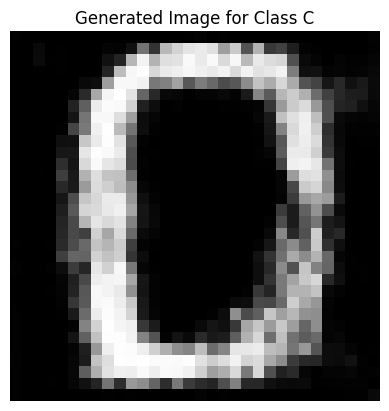

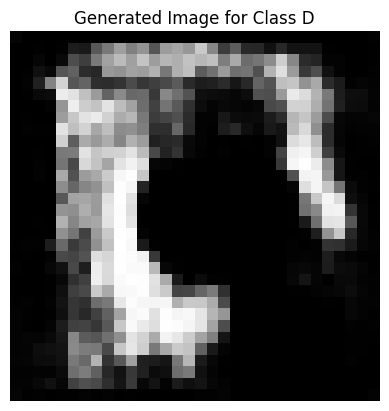

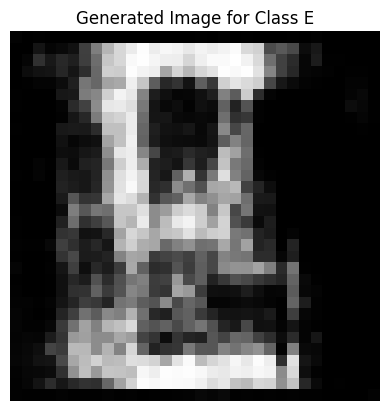

...

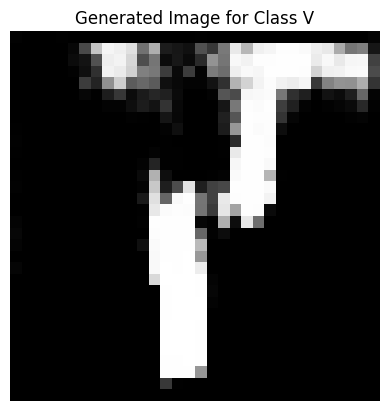

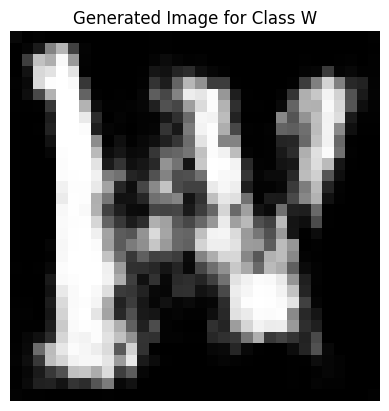

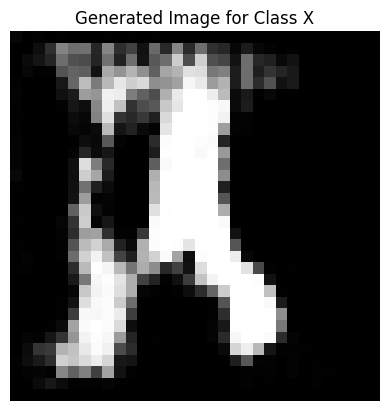

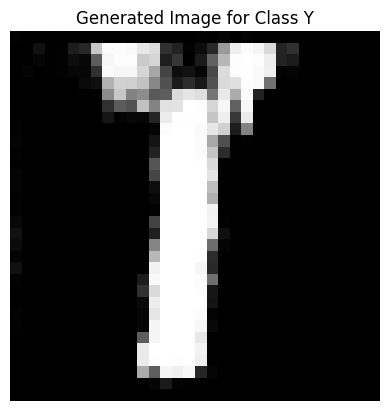

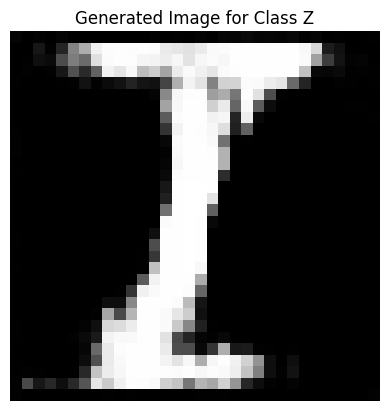

Epoch [1201/5000], D_loss: -10.9521, G_loss: -25.5322
Epoch [1202/5000], D_loss: -9.2001, G_loss: -26.9416
Epoch [1203/5000], D_loss: -10.7658, G_loss: -25.2982
Epoch [1204/5000], D_loss: -9.4346, G_loss: -22.8751
Epoch [1205/5000], D_loss: -10.3440, G_loss: -26.3854
Epoch [1206/5000], D_loss: -10.1383, G_loss: -27.3408
Epoch [1207/5000], D_loss: -9.5233, G_loss: -26.6367
Epoch [1208/5000], D_loss: -9.7229, G_loss: -27.2863
Epoch [1209/5000], D_loss: -10.0989, G_loss: -28.3963
Epoch [1210/5000], D_loss: -9.6840, G_loss: -29.0292
Epoch [1211/5000], D_loss: -9.2384, G_loss: -29.7942
Epoch [1212/5000], D_loss: -10.4457, G_loss: -29.7956
Epoch [1213/5000], D_loss: -9.8495, G_loss: -30.5000
Epoch [1214/5000], D_loss: -9.4571, G_loss: -26.4983
Epoch [1215/5000], D_loss: -10.7983, G_loss: -25.8827
Epoch [1216/5000], D_loss: -9.9431, G_loss: -25.2228
Epoch [1217/5000], D_loss: -10.5540, G_loss: -24.7499
Epoch [1218/5000], D_loss: -10.1030, G_loss: -21.4624
Epoch [1219/5000], D_loss: -10.7029, 

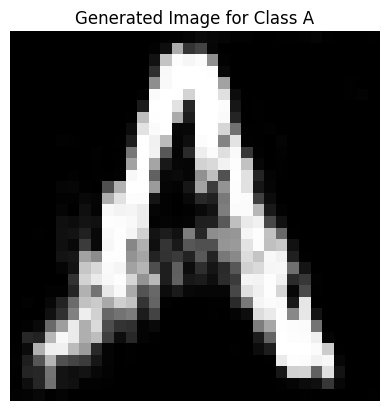

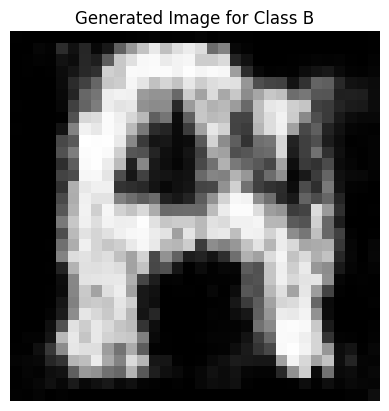

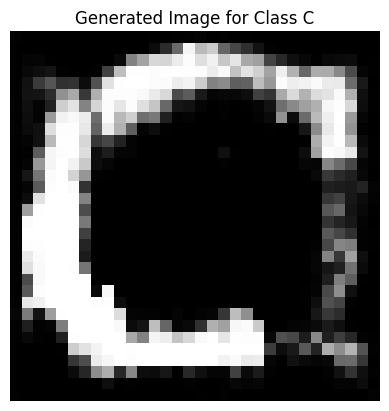

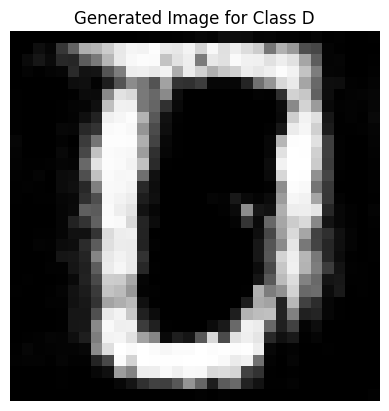

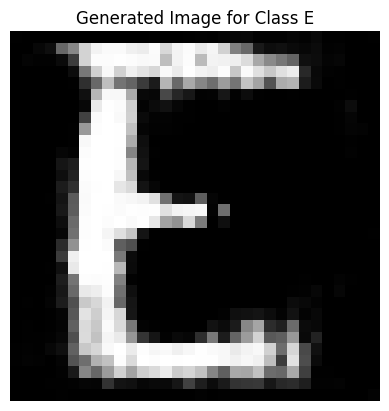

...

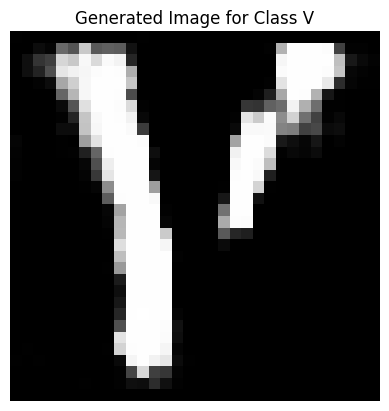

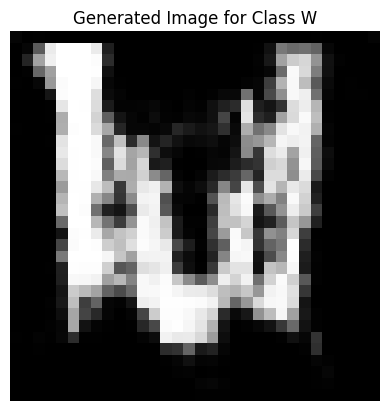

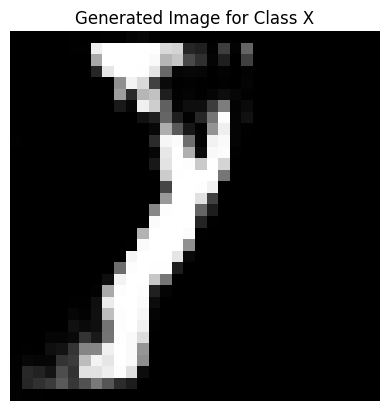

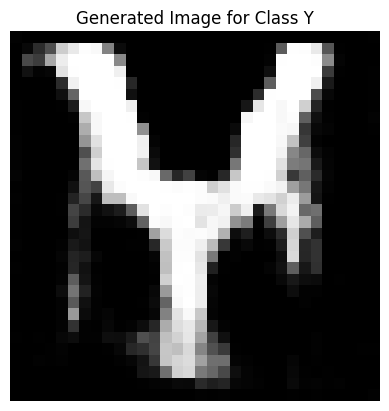

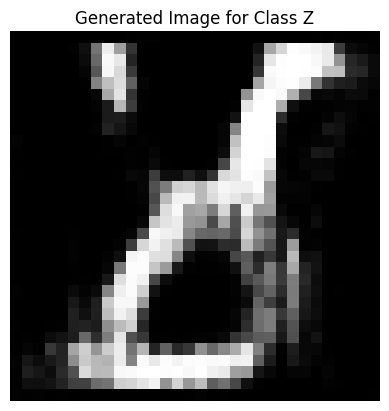

Epoch [1401/5000], D_loss: -10.1836, G_loss: -13.3763
Epoch [1402/5000], D_loss: -11.0707, G_loss: -7.6515
Epoch [1403/5000], D_loss: -10.2501, G_loss: -11.3849
Epoch [1404/5000], D_loss: -10.6199, G_loss: -15.5634
Epoch [1405/5000], D_loss: -10.4625, G_loss: -9.2941
Epoch [1406/5000], D_loss: -9.5694, G_loss: -12.4858
Epoch [1407/5000], D_loss: -10.4220, G_loss: -13.6353
Epoch [1408/5000], D_loss: -9.5623, G_loss: -9.3394
Epoch [1409/5000], D_loss: -9.2617, G_loss: -6.9459
Epoch [1410/5000], D_loss: -10.8324, G_loss: -15.4919
Epoch [1411/5000], D_loss: -9.6660, G_loss: -8.3124
Epoch [1412/5000], D_loss: -9.3913, G_loss: -6.5135
Epoch [1413/5000], D_loss: -10.0858, G_loss: -12.5090
Epoch [1414/5000], D_loss: -9.5500, G_loss: -12.6830
Epoch [1415/5000], D_loss: -9.3451, G_loss: -10.9515
Epoch [1416/5000], D_loss: -10.1334, G_loss: -8.1068
Epoch [1417/5000], D_loss: -10.0416, G_loss: -7.1824
Epoch [1418/5000], D_loss: -10.1884, G_loss: -8.2496
Epoch [1419/5000], D_loss: -9.6250, G_loss: 

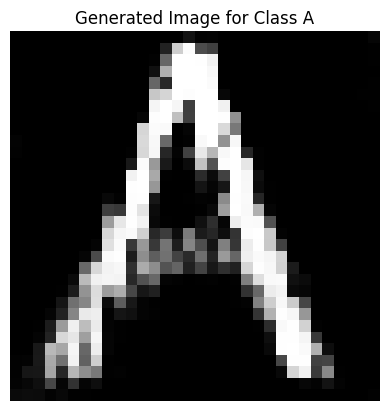

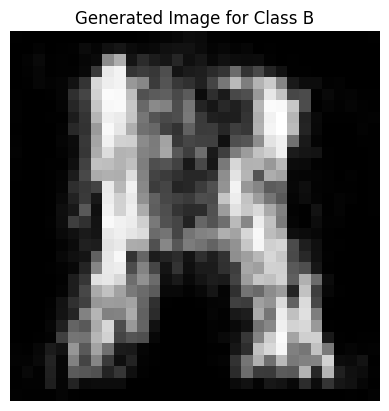

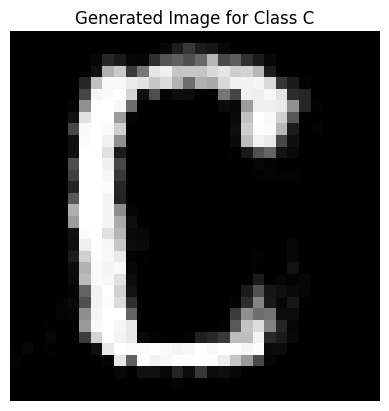

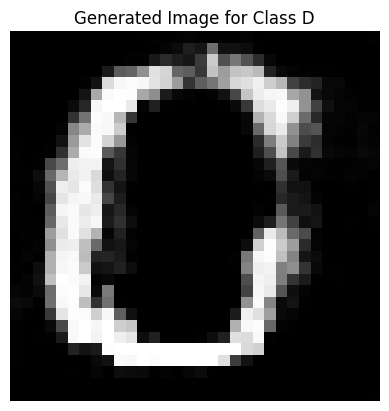

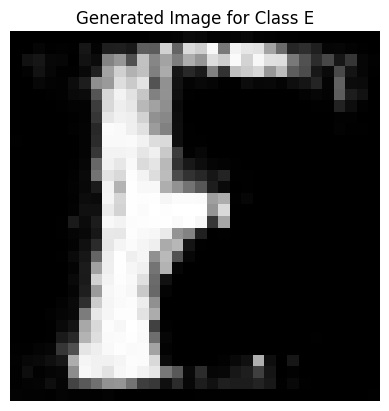

...

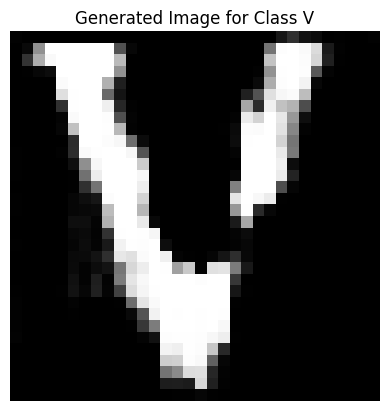

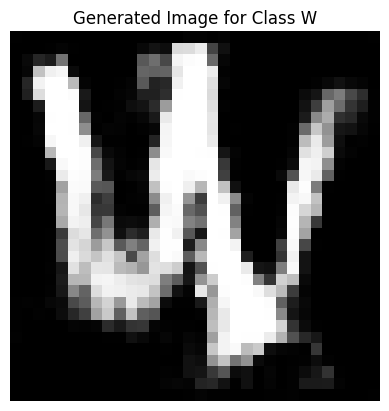

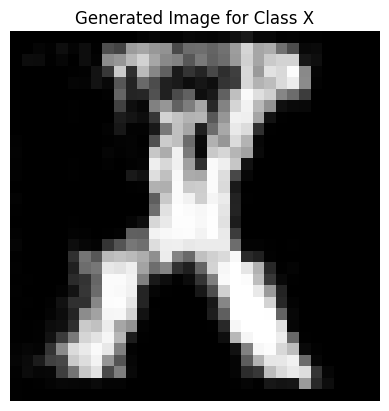

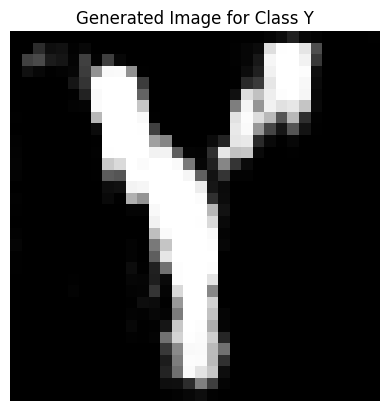

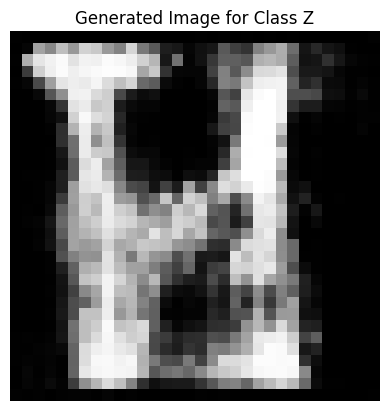

Epoch [1601/5000], D_loss: -10.2798, G_loss: -3.8585
Epoch [1602/5000], D_loss: -10.5527, G_loss: -3.8758
Epoch [1603/5000], D_loss: -10.6519, G_loss: -1.9724
Epoch [1604/5000], D_loss: -10.8778, G_loss: -7.0020
Epoch [1605/5000], D_loss: -10.3149, G_loss: -3.2748
Epoch [1606/5000], D_loss: -9.8537, G_loss: -1.1043
Epoch [1607/5000], D_loss: -9.7109, G_loss: -2.6164
Epoch [1608/5000], D_loss: -10.0590, G_loss: -5.5034
Epoch [1609/5000], D_loss: -11.1082, G_loss: -2.0703
Epoch [1610/5000], D_loss: -10.5282, G_loss: -3.2429
Epoch [1611/5000], D_loss: -10.5201, G_loss: -6.2331
Epoch [1612/5000], D_loss: -10.5055, G_loss: -2.5352
Epoch [1613/5000], D_loss: -10.7707, G_loss: 0.5623
Epoch [1614/5000], D_loss: -10.8879, G_loss: -3.6212
Epoch [1615/5000], D_loss: -10.1202, G_loss: -4.1666
Epoch [1616/5000], D_loss: -10.4207, G_loss: -2.3582
Epoch [1617/5000], D_loss: -10.4965, G_loss: -6.4974
Epoch [1618/5000], D_loss: -9.6921, G_loss: -8.2943
Epoch [1619/5000], D_loss: -9.4163, G_loss: -7.422

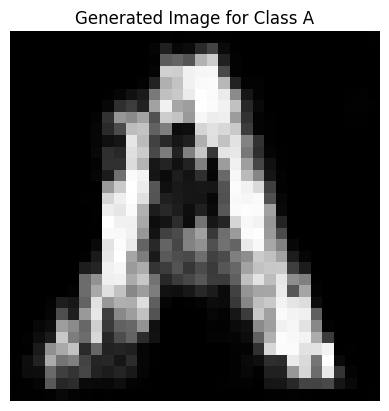

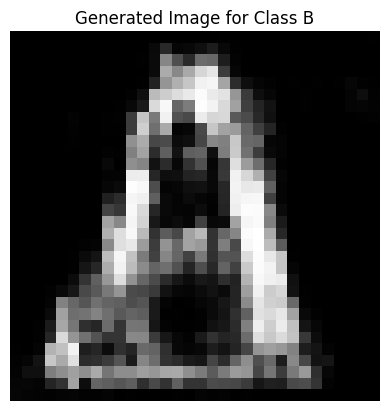

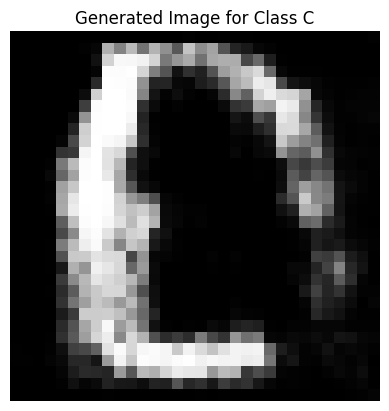

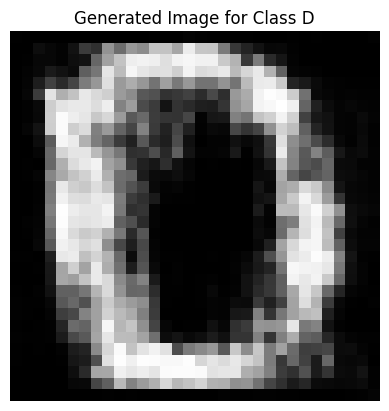

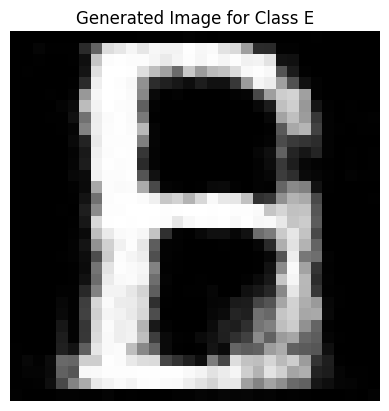

...

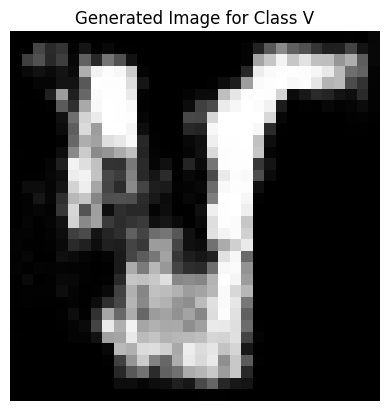

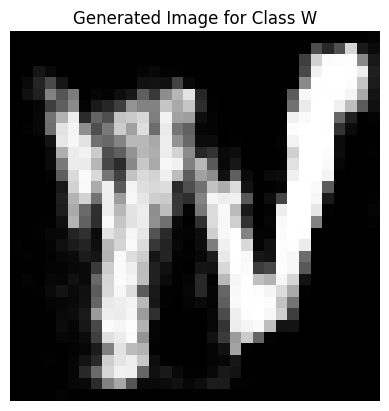

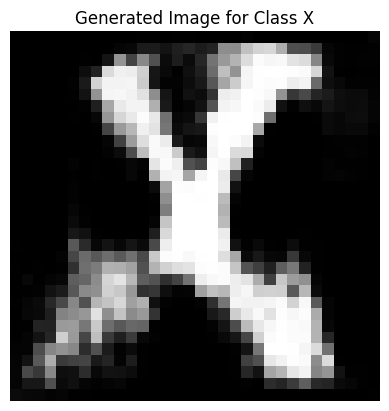

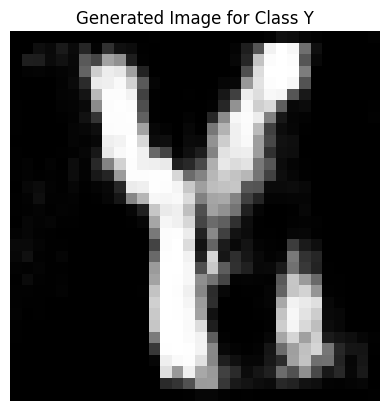

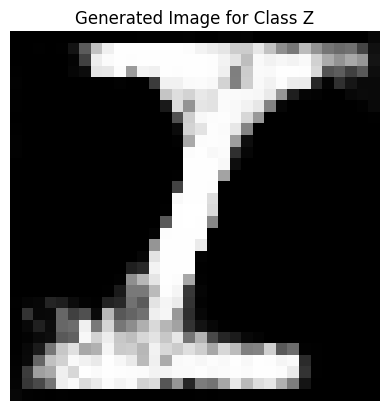

Epoch [1801/5000], D_loss: -10.7279, G_loss: 2.4156
Epoch [1802/5000], D_loss: -11.2690, G_loss: 4.2190
Epoch [1803/5000], D_loss: -10.7819, G_loss: 2.0691
Epoch [1804/5000], D_loss: -10.2966, G_loss: -3.7171
Epoch [1805/5000], D_loss: -10.3602, G_loss: -4.1930
Epoch [1806/5000], D_loss: -11.1222, G_loss: -0.8466
Epoch [1807/5000], D_loss: -10.7047, G_loss: -0.3270
Epoch [1808/5000], D_loss: -10.5659, G_loss: -1.5187
Epoch [1809/5000], D_loss: -10.2148, G_loss: -1.8824
Epoch [1810/5000], D_loss: -10.3059, G_loss: -0.9974
Epoch [1811/5000], D_loss: -10.5742, G_loss: 1.4151
Epoch [1812/5000], D_loss: -10.6583, G_loss: 0.8214
Epoch [1813/5000], D_loss: -10.7725, G_loss: 1.9650
Epoch [1814/5000], D_loss: -9.9732, G_loss: 2.8386
Epoch [1815/5000], D_loss: -9.7628, G_loss: -1.4311
Epoch [1816/5000], D_loss: -11.2517, G_loss: 1.1800
Epoch [1817/5000], D_loss: -10.7305, G_loss: 2.1872
Epoch [1818/5000], D_loss: -10.8143, G_loss: 1.2662
Epoch [1819/5000], D_loss: -10.3430, G_loss: 1.5622
Epoch 

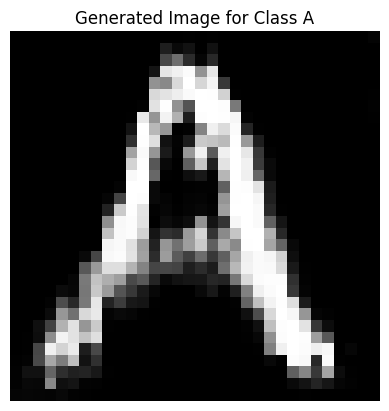

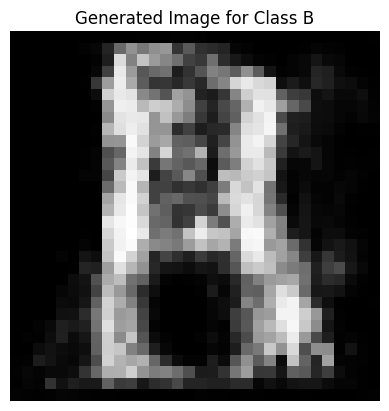

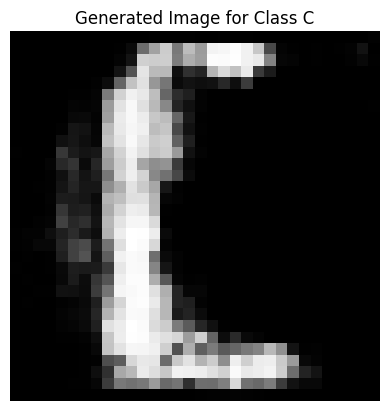

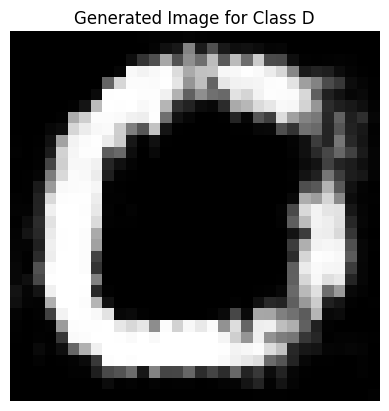

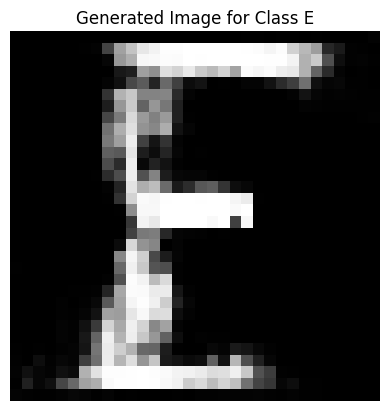

...

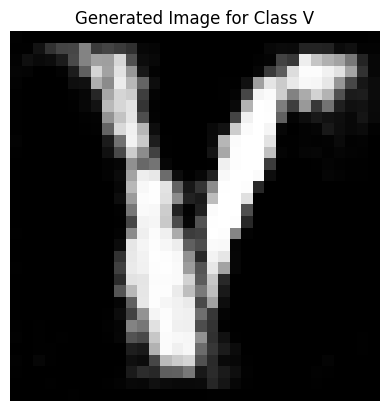

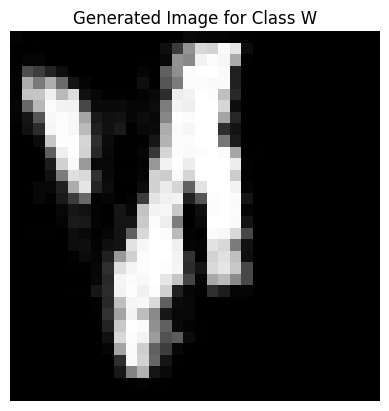

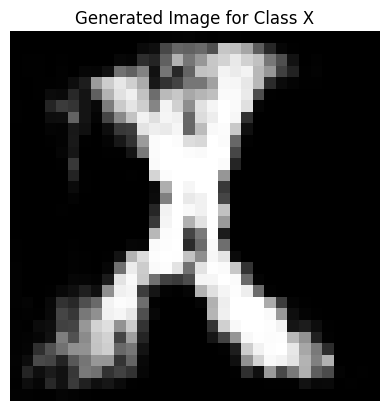

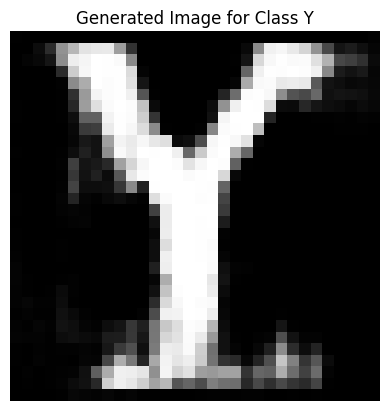

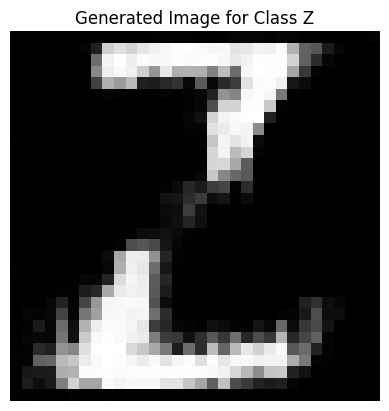

Epoch [2001/5000], D_loss: -10.4792, G_loss: 9.8736
Epoch [2002/5000], D_loss: -10.4648, G_loss: 8.3375
Epoch [2003/5000], D_loss: -10.2205, G_loss: 10.3926
Epoch [2004/5000], D_loss: -10.5854, G_loss: 11.5700
Epoch [2005/5000], D_loss: -10.2448, G_loss: 13.5643
Epoch [2006/5000], D_loss: -10.4662, G_loss: 8.8776
Epoch [2007/5000], D_loss: -10.5819, G_loss: 7.4497
Epoch [2008/5000], D_loss: -11.0559, G_loss: 4.4372
Epoch [2009/5000], D_loss: -11.0288, G_loss: 9.1062
Epoch [2010/5000], D_loss: -9.9923, G_loss: 9.3305
Epoch [2011/5000], D_loss: -10.4105, G_loss: 7.8706
Epoch [2012/5000], D_loss: -9.7053, G_loss: 10.4004
Epoch [2013/5000], D_loss: -10.5752, G_loss: 9.9715
Epoch [2014/5000], D_loss: -10.3187, G_loss: 9.4541
Epoch [2015/5000], D_loss: -10.9244, G_loss: 9.9266
Epoch [2016/5000], D_loss: -10.4547, G_loss: 10.0362
Epoch [2017/5000], D_loss: -10.8117, G_loss: 8.4916
Epoch [2018/5000], D_loss: -10.8301, G_loss: 6.5873
Epoch [2019/5000], D_loss: -10.8599, G_loss: 8.1389
Epoch [20

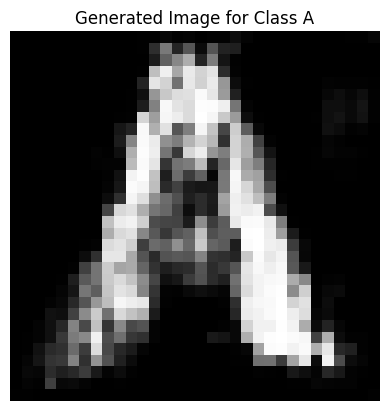

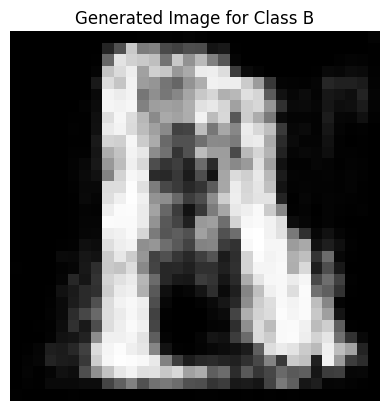

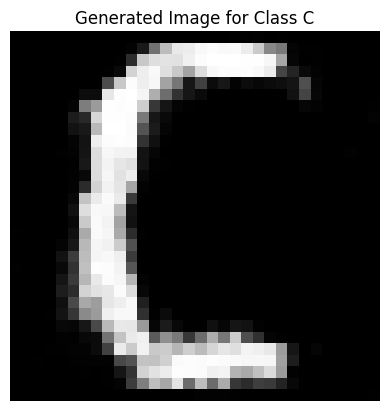

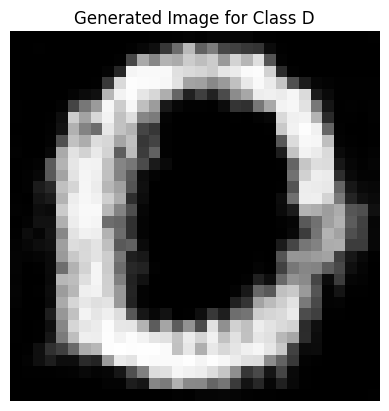

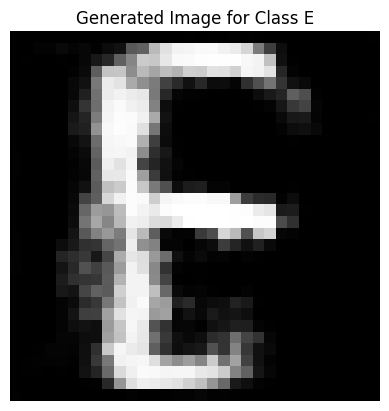

...

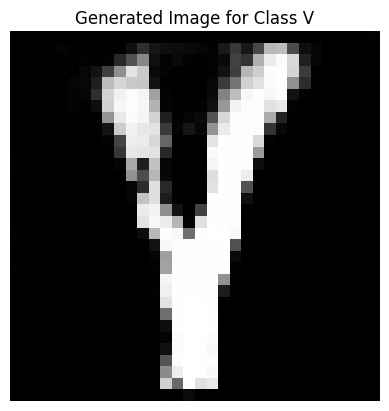

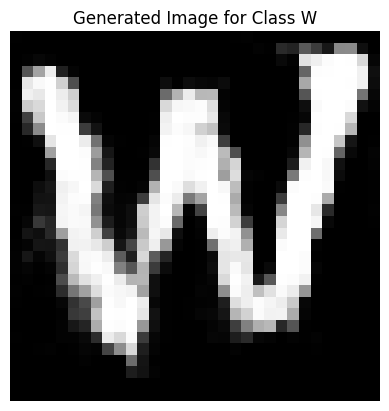

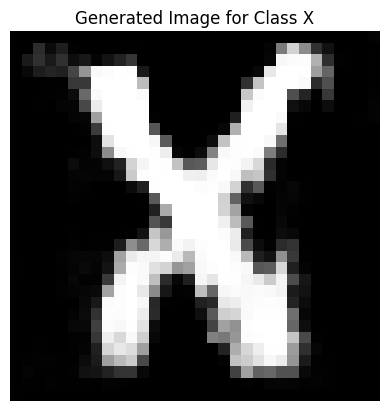

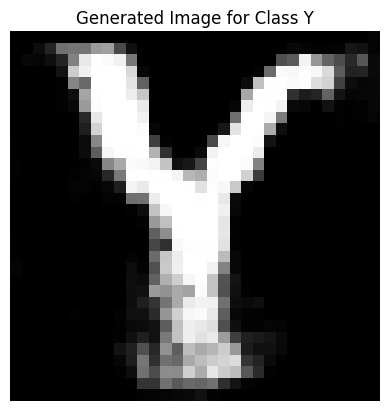

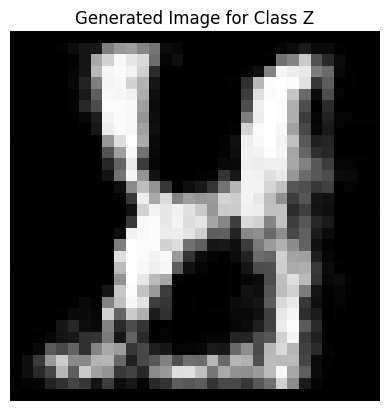

Epoch [2201/5000], D_loss: -10.4498, G_loss: 6.4756
Epoch [2202/5000], D_loss: -10.7554, G_loss: 3.9065
Epoch [2203/5000], D_loss: -10.5132, G_loss: 7.0341
Epoch [2204/5000], D_loss: -10.9645, G_loss: 9.1196
Epoch [2205/5000], D_loss: -10.5956, G_loss: 5.6546
Epoch [2206/5000], D_loss: -9.9758, G_loss: 5.9368
Epoch [2207/5000], D_loss: -10.9390, G_loss: 4.8570
Epoch [2208/5000], D_loss: -10.5544, G_loss: 6.9645
Epoch [2209/5000], D_loss: -11.0297, G_loss: 6.8567
Epoch [2210/5000], D_loss: -10.7366, G_loss: 2.9499
Epoch [2211/5000], D_loss: -10.7548, G_loss: 5.7278
Epoch [2212/5000], D_loss: -10.0288, G_loss: 7.5604
Epoch [2213/5000], D_loss: -10.3110, G_loss: 5.0956
Epoch [2214/5000], D_loss: -11.0651, G_loss: 4.8469
Epoch [2215/5000], D_loss: -10.1956, G_loss: 7.7047
Epoch [2216/5000], D_loss: -10.5988, G_loss: 6.0306
Epoch [2217/5000], D_loss: -10.1920, G_loss: 8.2072
Epoch [2218/5000], D_loss: -10.1771, G_loss: 5.3418
Epoch [2219/5000], D_loss: -10.5001, G_loss: 7.1019
Epoch [2220/5

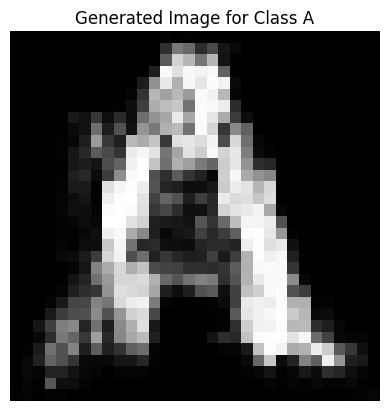

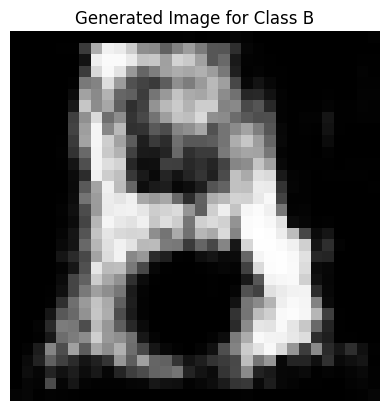

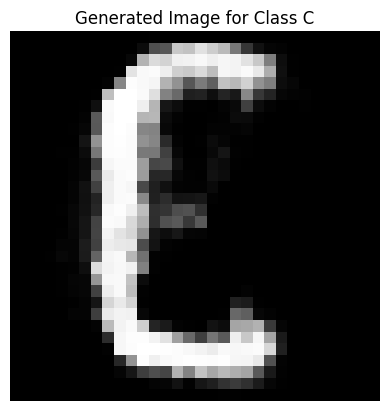

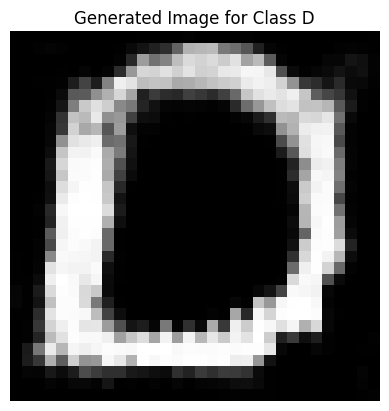

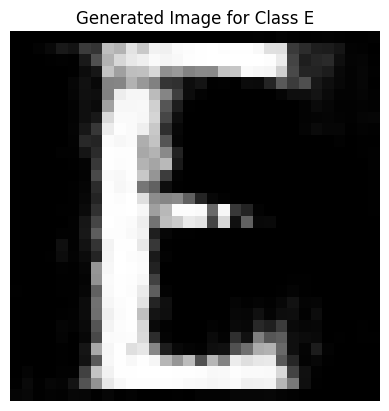

...

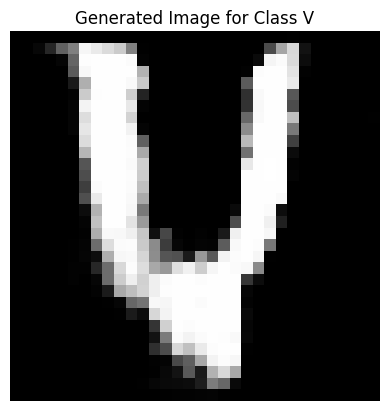

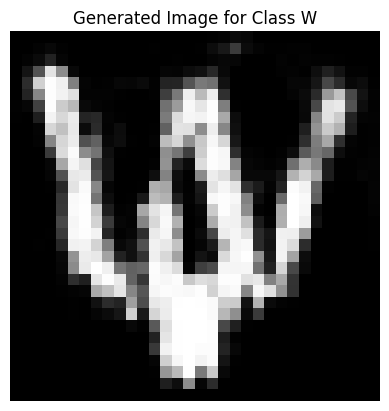

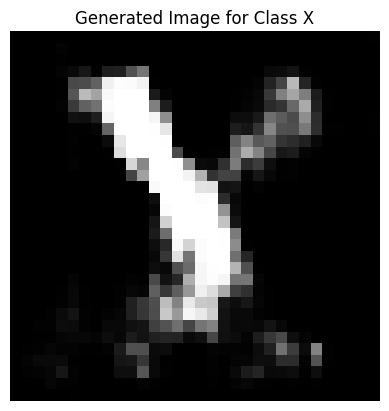

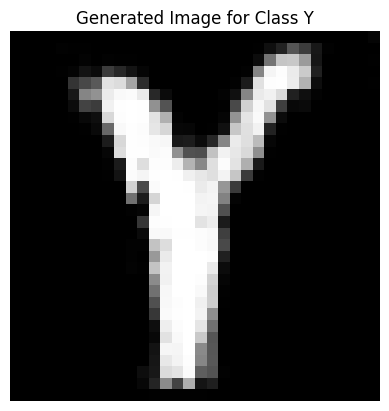

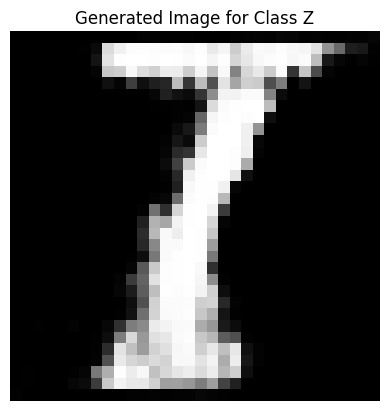

Epoch [2401/5000], D_loss: -10.5408, G_loss: 8.5133
Epoch [2402/5000], D_loss: -10.1891, G_loss: 5.6089
Epoch [2403/5000], D_loss: -10.8478, G_loss: 0.6870
Epoch [2404/5000], D_loss: -10.9876, G_loss: 2.2386
Epoch [2405/5000], D_loss: -10.3458, G_loss: 1.5821
Epoch [2406/5000], D_loss: -10.1430, G_loss: 7.5580
Epoch [2407/5000], D_loss: -10.7553, G_loss: 9.5665
Epoch [2408/5000], D_loss: -10.6779, G_loss: 3.8045
Epoch [2409/5000], D_loss: -9.7744, G_loss: 2.8930
Epoch [2410/5000], D_loss: -9.9296, G_loss: 5.5980
Epoch [2411/5000], D_loss: -10.6583, G_loss: 5.3303
Epoch [2412/5000], D_loss: -11.1258, G_loss: 8.1192
Epoch [2413/5000], D_loss: -9.9982, G_loss: 2.3386
Epoch [2414/5000], D_loss: -10.3241, G_loss: 1.9229
Epoch [2415/5000], D_loss: -9.8812, G_loss: 0.8133
Epoch [2416/5000], D_loss: -10.3023, G_loss: 3.3106
Epoch [2417/5000], D_loss: -10.4304, G_loss: 1.3007
Epoch [2418/5000], D_loss: -10.5945, G_loss: 4.4869
Epoch [2419/5000], D_loss: -10.4922, G_loss: 2.8373
Epoch [2420/5000

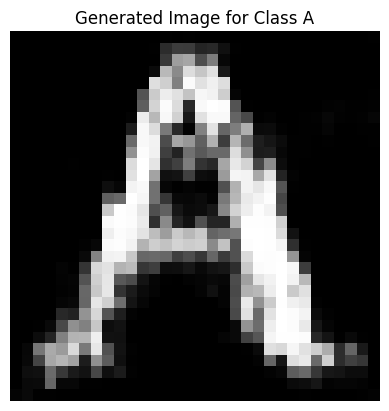

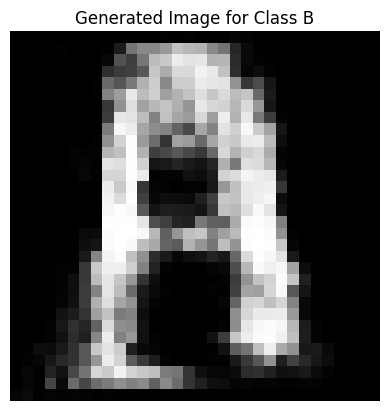

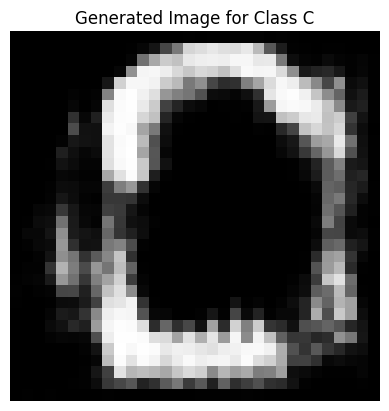

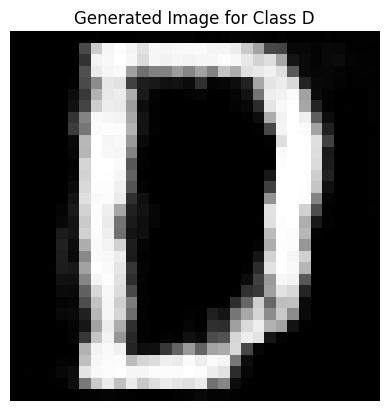

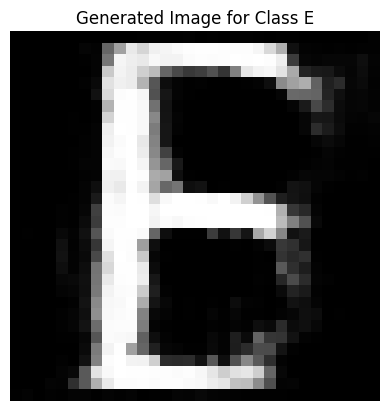

...

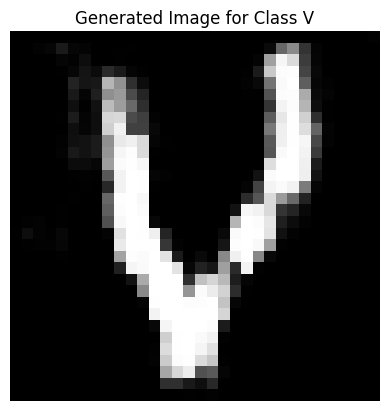

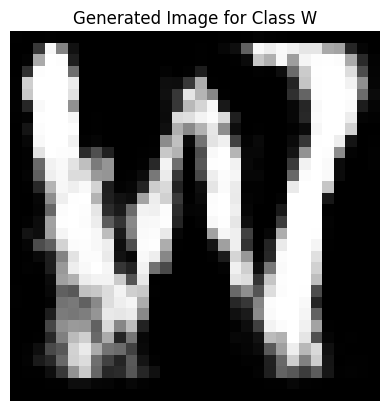

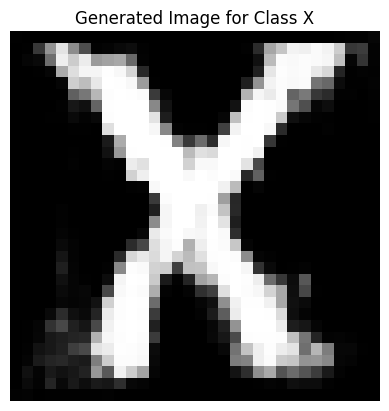

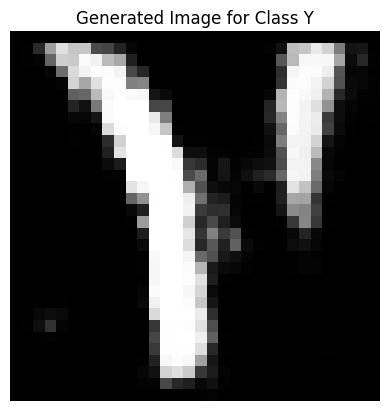

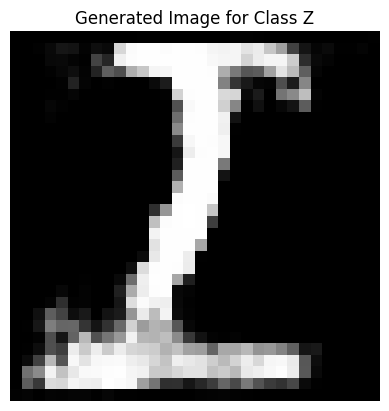

Epoch [2601/5000], D_loss: -10.3778, G_loss: 9.2199
Epoch [2602/5000], D_loss: -10.2852, G_loss: 6.6847
Epoch [2603/5000], D_loss: -10.8746, G_loss: 4.0794
Epoch [2604/5000], D_loss: -11.1249, G_loss: 5.3908
Epoch [2605/5000], D_loss: -10.9359, G_loss: 7.1306
Epoch [2606/5000], D_loss: -10.3856, G_loss: 4.8541
Epoch [2607/5000], D_loss: -10.0941, G_loss: 2.1740
Epoch [2608/5000], D_loss: -10.5480, G_loss: 5.8111
Epoch [2609/5000], D_loss: -10.3476, G_loss: 2.9858
Epoch [2610/5000], D_loss: -10.2410, G_loss: 4.4053
Epoch [2611/5000], D_loss: -10.5564, G_loss: 5.4218
Epoch [2612/5000], D_loss: -10.7511, G_loss: 2.5272
Epoch [2613/5000], D_loss: -10.5651, G_loss: 1.5602
Epoch [2614/5000], D_loss: -10.7204, G_loss: 3.4090
Epoch [2615/5000], D_loss: -9.7423, G_loss: 5.7967
Epoch [2616/5000], D_loss: -10.6320, G_loss: 4.5022
Epoch [2617/5000], D_loss: -9.9315, G_loss: 5.4509
Epoch [2618/5000], D_loss: -10.4414, G_loss: 5.6493
Epoch [2619/5000], D_loss: -10.3526, G_loss: 5.9628
Epoch [2620/50

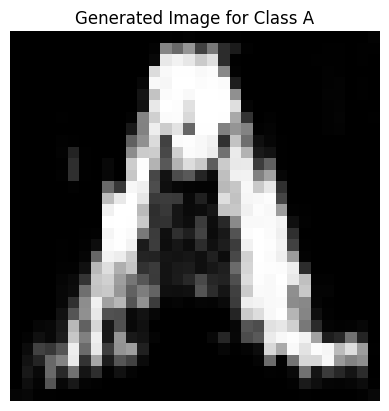

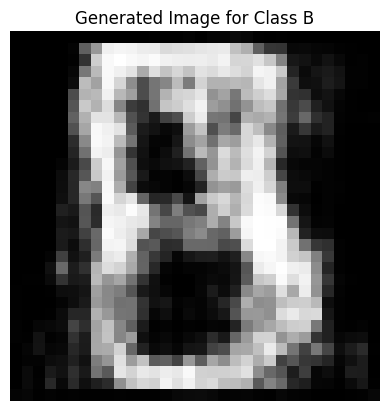

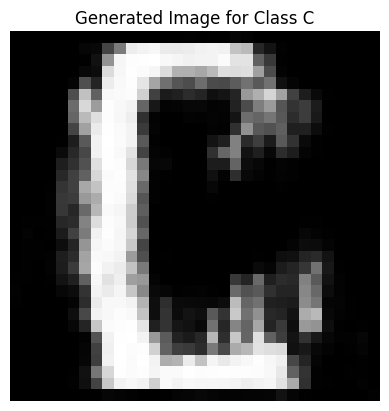

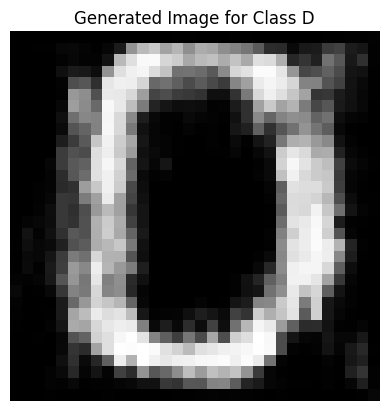

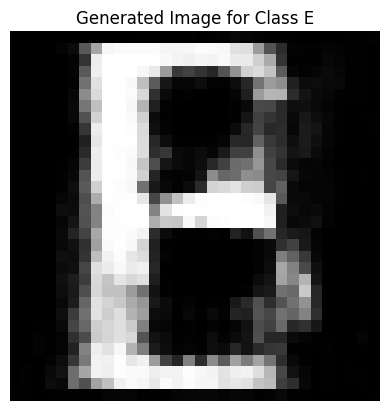

...

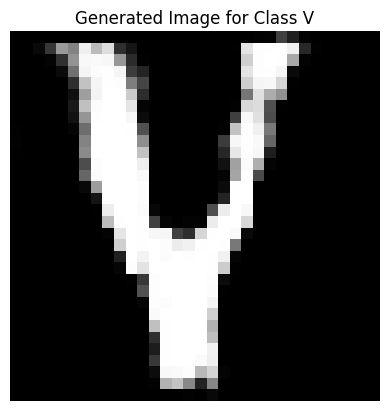

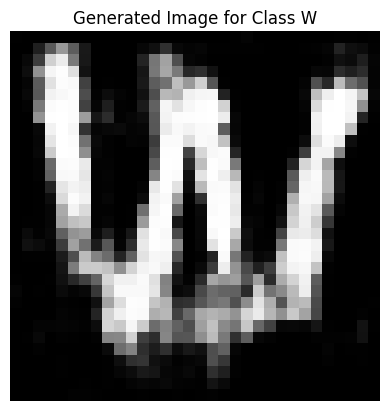

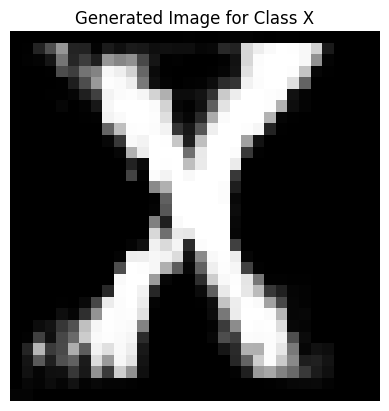

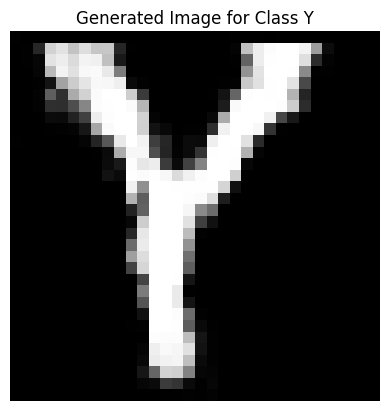

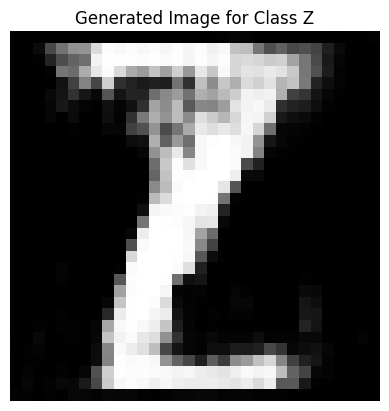

Epoch [2801/5000], D_loss: -9.9070, G_loss: 6.6047
Epoch [2802/5000], D_loss: -9.7790, G_loss: 5.3292
Epoch [2803/5000], D_loss: -10.1900, G_loss: 5.7780
Epoch [2804/5000], D_loss: -10.1996, G_loss: 8.5557
Epoch [2805/5000], D_loss: -10.6198, G_loss: 10.1128
Epoch [2806/5000], D_loss: -11.0024, G_loss: 5.2296
Epoch [2807/5000], D_loss: -11.6708, G_loss: 8.9987
Epoch [2808/5000], D_loss: -10.4437, G_loss: 10.4610
Epoch [2809/5000], D_loss: -10.4154, G_loss: 7.4770
Epoch [2810/5000], D_loss: -9.9359, G_loss: 7.1431
Epoch [2811/5000], D_loss: -9.6845, G_loss: 5.7175
Epoch [2812/5000], D_loss: -10.0125, G_loss: 6.6693
Epoch [2813/5000], D_loss: -10.4274, G_loss: 7.2672
Epoch [2814/5000], D_loss: -10.1664, G_loss: 7.6461
Epoch [2815/5000], D_loss: -10.0045, G_loss: 5.8239
Epoch [2816/5000], D_loss: -9.7096, G_loss: 6.0077
Epoch [2817/5000], D_loss: -10.1649, G_loss: 7.3448
Epoch [2818/5000], D_loss: -10.1618, G_loss: 7.1071
Epoch [2819/5000], D_loss: -9.9222, G_loss: 5.8694
Epoch [2820/5000

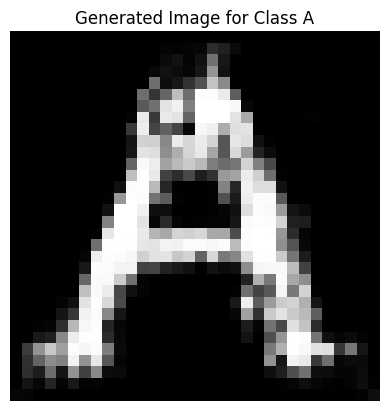

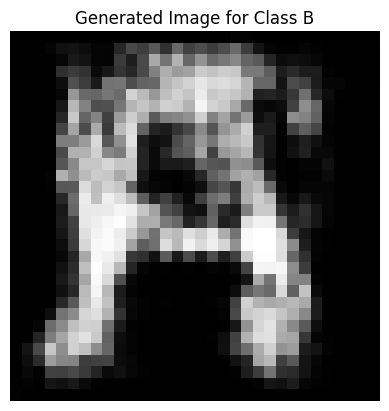

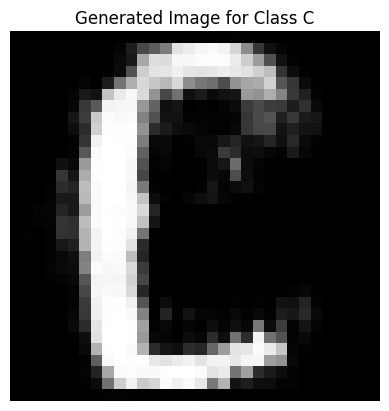

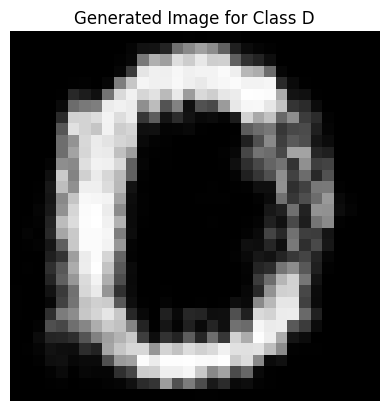

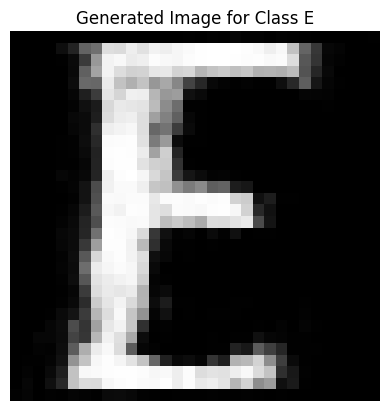

...

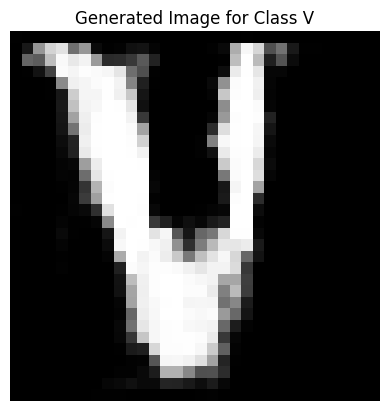

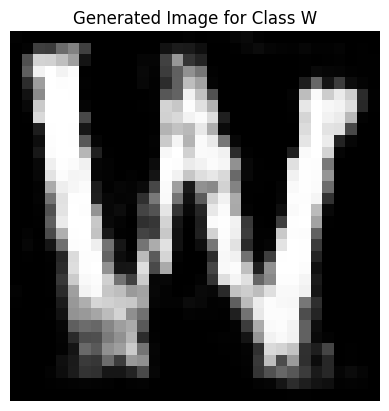

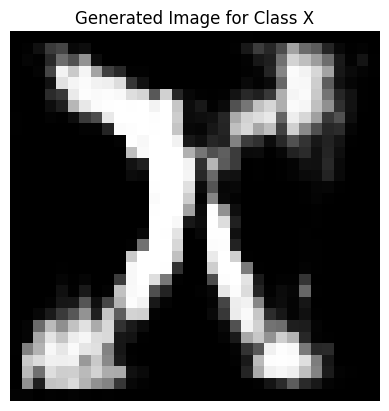

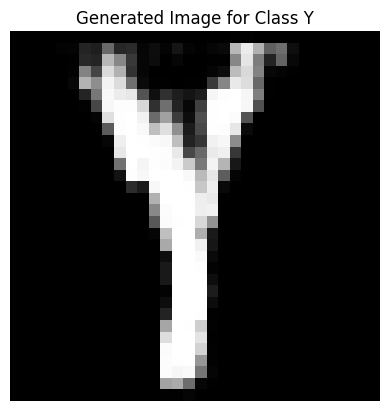

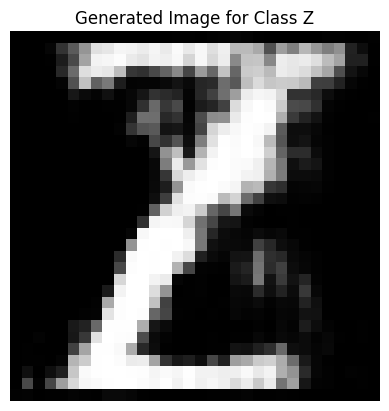

Epoch [3001/5000], D_loss: -10.6727, G_loss: 7.7595
Epoch [3002/5000], D_loss: -10.9711, G_loss: 9.0578
Epoch [3003/5000], D_loss: -10.0154, G_loss: 9.0708
Epoch [3004/5000], D_loss: -9.8660, G_loss: 9.7966
Epoch [3005/5000], D_loss: -10.4054, G_loss: 5.1480
Epoch [3006/5000], D_loss: -10.0683, G_loss: 11.7403
Epoch [3007/5000], D_loss: -10.6607, G_loss: 9.9067
Epoch [3008/5000], D_loss: -10.2840, G_loss: 13.8901
Epoch [3009/5000], D_loss: -10.3051, G_loss: 12.1946
Epoch [3010/5000], D_loss: -10.0879, G_loss: 9.8392
Epoch [3011/5000], D_loss: -9.9297, G_loss: 9.8775
Epoch [3012/5000], D_loss: -10.2936, G_loss: 7.3107
Epoch [3013/5000], D_loss: -10.8899, G_loss: 6.1574
Epoch [3014/5000], D_loss: -10.1634, G_loss: 7.6122
Epoch [3015/5000], D_loss: -10.1758, G_loss: 9.4915
Epoch [3016/5000], D_loss: -10.0485, G_loss: 7.6079
Epoch [3017/5000], D_loss: -9.8027, G_loss: 7.1042
Epoch [3018/5000], D_loss: -10.2545, G_loss: 8.7265
Epoch [3019/5000], D_loss: -10.3233, G_loss: 7.0390
Epoch [3020/

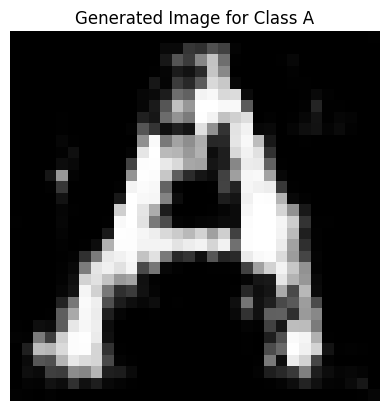

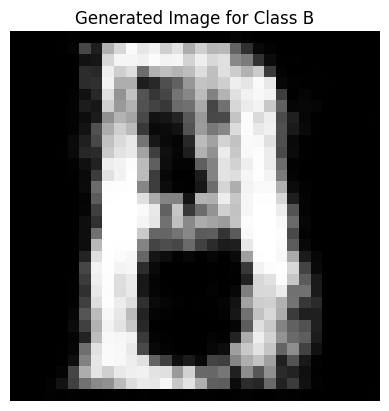

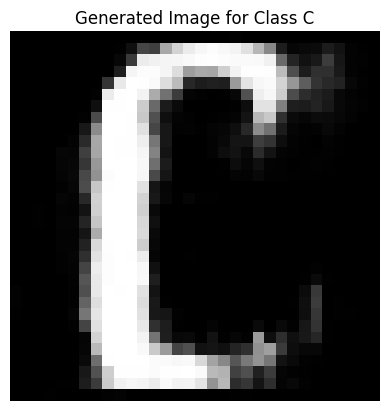

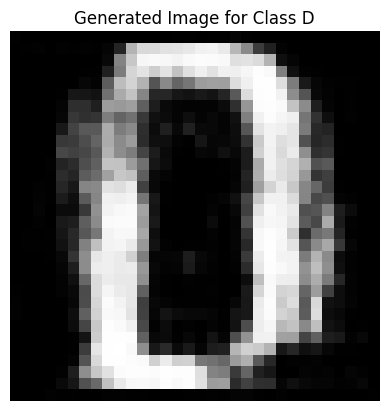

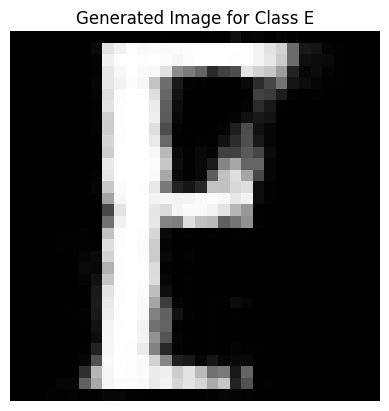

...

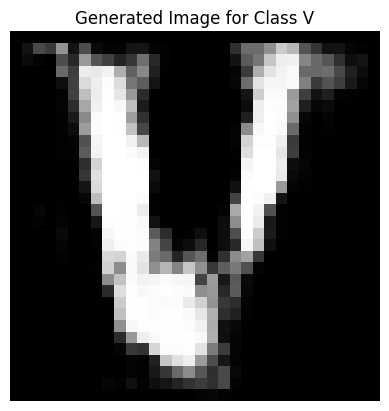

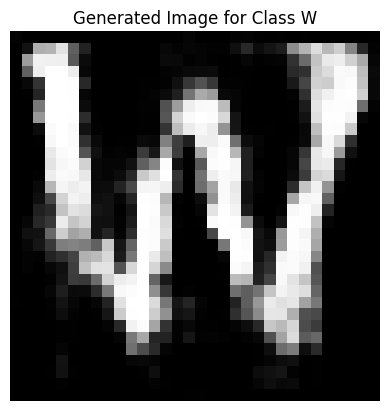

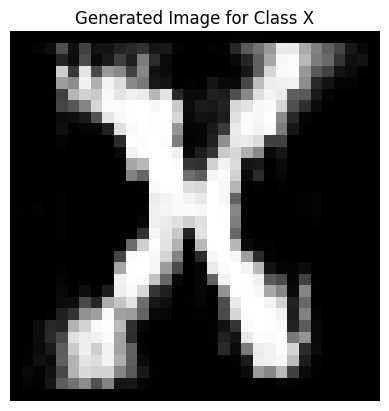

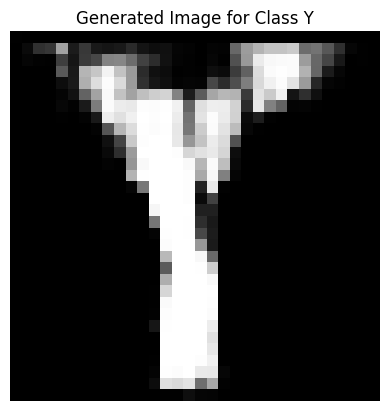

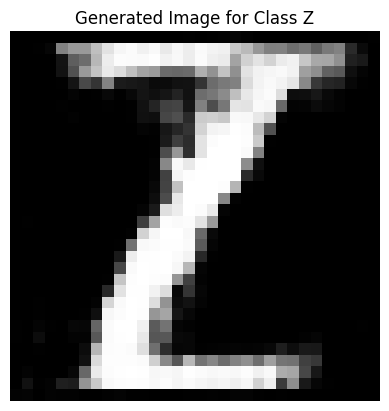

Epoch [3201/5000], D_loss: -9.8083, G_loss: 18.4614
Epoch [3202/5000], D_loss: -9.8508, G_loss: 18.1270
Epoch [3203/5000], D_loss: -10.0688, G_loss: 18.5855
Epoch [3204/5000], D_loss: -9.4500, G_loss: 19.0463
Epoch [3205/5000], D_loss: -10.1519, G_loss: 18.5737
Epoch [3206/5000], D_loss: -9.8793, G_loss: 21.4513
Epoch [3207/5000], D_loss: -10.4849, G_loss: 15.9038
Epoch [3208/5000], D_loss: -10.9108, G_loss: 17.8185
Epoch [3209/5000], D_loss: -10.0764, G_loss: 18.2310
Epoch [3210/5000], D_loss: -10.1364, G_loss: 19.1676
Epoch [3211/5000], D_loss: -9.9741, G_loss: 17.5176
Epoch [3212/5000], D_loss: -9.7153, G_loss: 21.6060
Epoch [3213/5000], D_loss: -9.8482, G_loss: 16.1301
Epoch [3214/5000], D_loss: -9.8368, G_loss: 20.5735
Epoch [3215/5000], D_loss: -10.4068, G_loss: 20.4562
Epoch [3216/5000], D_loss: -9.7783, G_loss: 19.9385
Epoch [3217/5000], D_loss: -10.0660, G_loss: 20.0910
Epoch [3218/5000], D_loss: -9.9076, G_loss: 20.9075
Epoch [3219/5000], D_loss: -9.6741, G_loss: 17.2267
Epoc

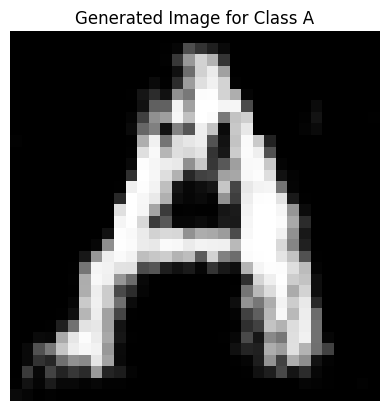

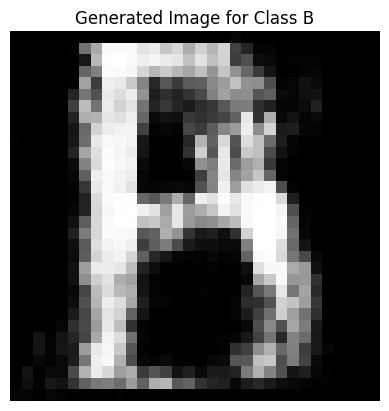

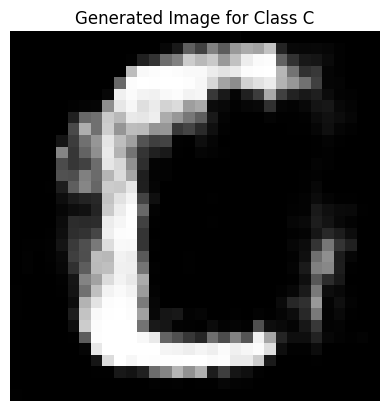

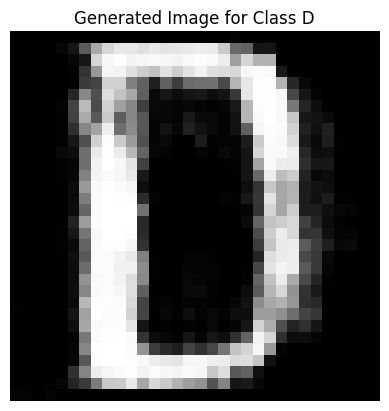

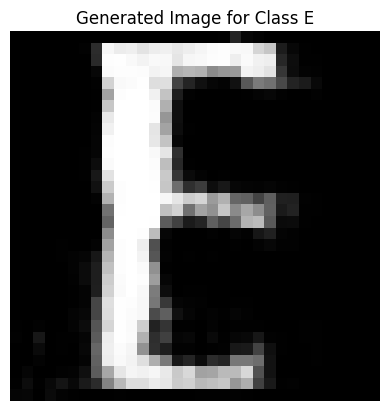

...

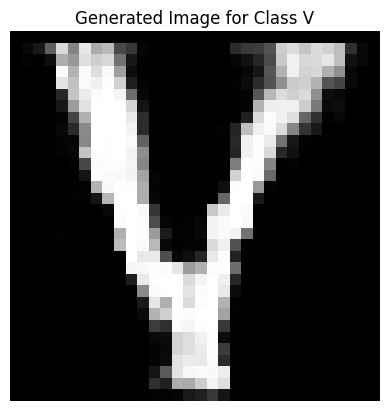

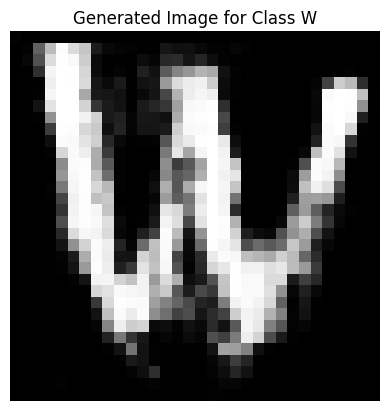

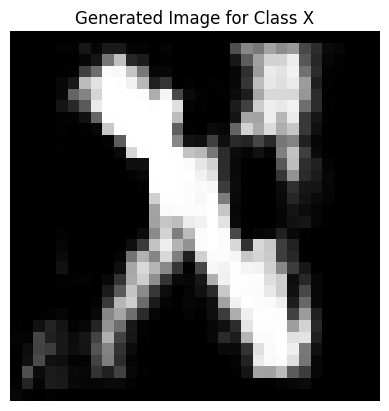

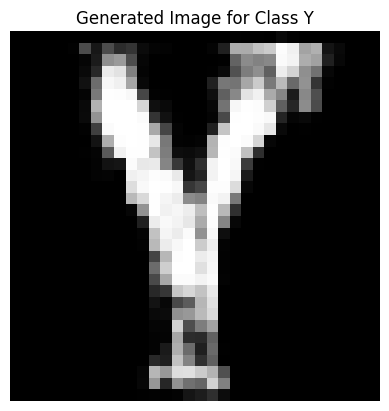

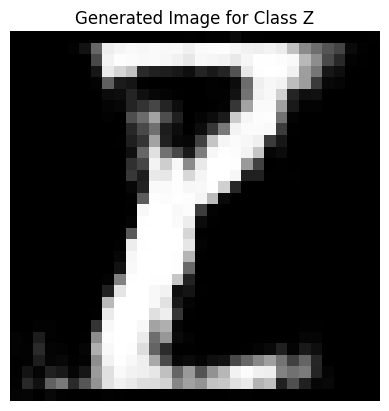

Epoch [3401/5000], D_loss: -9.6957, G_loss: 25.7984
Epoch [3402/5000], D_loss: -10.0812, G_loss: 26.3419
Epoch [3403/5000], D_loss: -10.1360, G_loss: 25.4302
Epoch [3404/5000], D_loss: -9.3391, G_loss: 30.1937
Epoch [3405/5000], D_loss: -10.0640, G_loss: 29.8098
Epoch [3406/5000], D_loss: -9.8944, G_loss: 26.1820
Epoch [3407/5000], D_loss: -9.5044, G_loss: 27.8475
Epoch [3408/5000], D_loss: -9.9796, G_loss: 28.9878
Epoch [3409/5000], D_loss: -9.5138, G_loss: 28.0178
Epoch [3410/5000], D_loss: -9.5694, G_loss: 28.8750
Epoch [3411/5000], D_loss: -9.7067, G_loss: 30.6856
Epoch [3412/5000], D_loss: -9.8241, G_loss: 29.1115
Epoch [3413/5000], D_loss: -9.9156, G_loss: 29.4589
Epoch [3414/5000], D_loss: -10.1258, G_loss: 28.6298
Epoch [3415/5000], D_loss: -9.7413, G_loss: 30.6833
Epoch [3416/5000], D_loss: -9.4207, G_loss: 30.3467
Epoch [3417/5000], D_loss: -9.9955, G_loss: 30.3342
Epoch [3418/5000], D_loss: -9.6546, G_loss: 30.4355
Epoch [3419/5000], D_loss: -9.6789, G_loss: 26.7368
Epoch [3

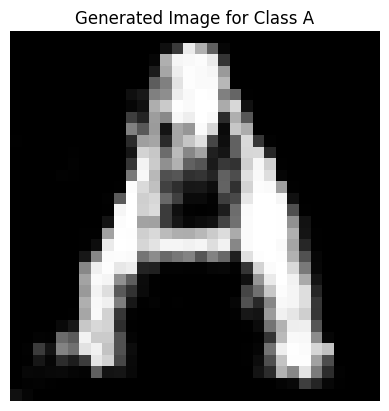

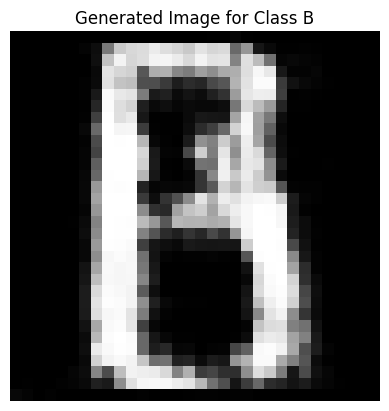

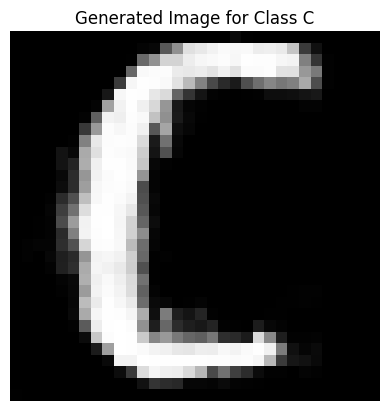

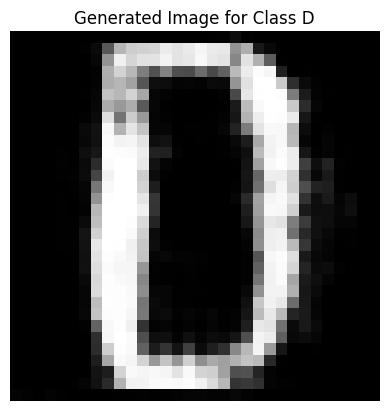

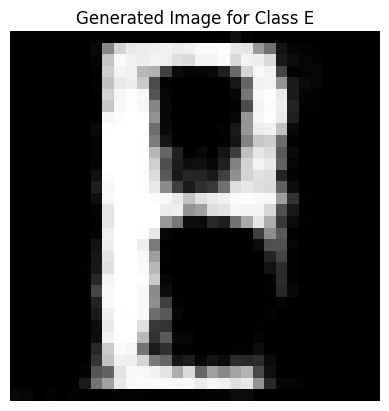

...

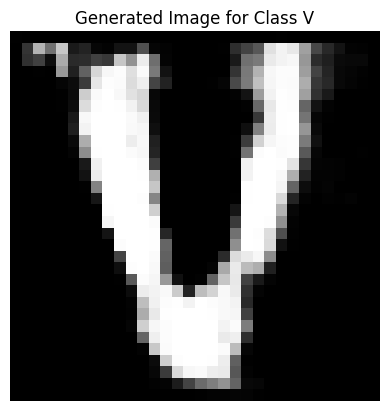

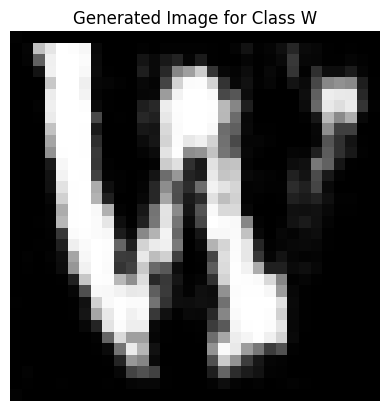

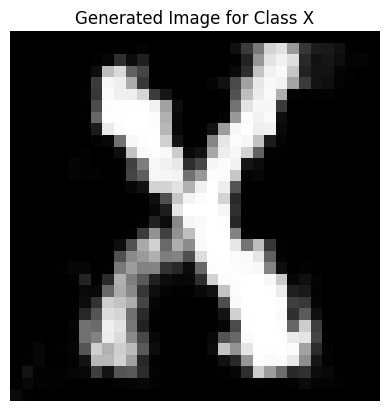

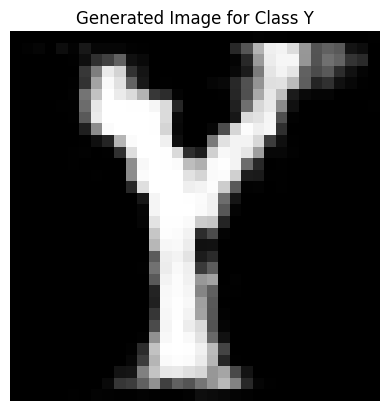

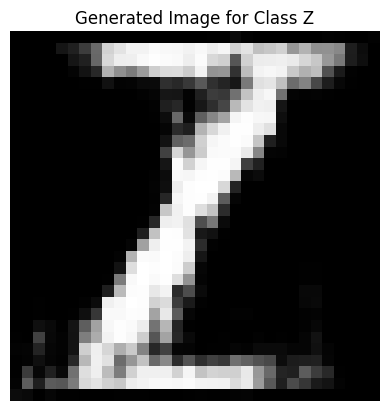

Epoch [3601/5000], D_loss: -9.9712, G_loss: 34.0640
Epoch [3602/5000], D_loss: -9.4207, G_loss: 32.5607
Epoch [3603/5000], D_loss: -10.2165, G_loss: 34.7461
Epoch [3604/5000], D_loss: -9.4798, G_loss: 35.3660
Epoch [3605/5000], D_loss: -10.0974, G_loss: 32.4475
Epoch [3606/5000], D_loss: -10.0071, G_loss: 33.5352
Epoch [3607/5000], D_loss: -9.5267, G_loss: 34.0844
Epoch [3608/5000], D_loss: -10.2454, G_loss: 34.0371
Epoch [3609/5000], D_loss: -9.7136, G_loss: 34.0584
Epoch [3610/5000], D_loss: -9.7878, G_loss: 32.5770
Epoch [3611/5000], D_loss: -9.8542, G_loss: 34.4049
Epoch [3612/5000], D_loss: -9.8793, G_loss: 31.3944
Epoch [3613/5000], D_loss: -9.5034, G_loss: 33.0056
Epoch [3614/5000], D_loss: -10.7036, G_loss: 34.7285
Epoch [3615/5000], D_loss: -9.9327, G_loss: 35.6683
Epoch [3616/5000], D_loss: -10.2532, G_loss: 34.0081
Epoch [3617/5000], D_loss: -9.7937, G_loss: 33.3546
Epoch [3618/5000], D_loss: -9.3928, G_loss: 32.0613
Epoch [3619/5000], D_loss: -9.8113, G_loss: 35.2561
Epoch 

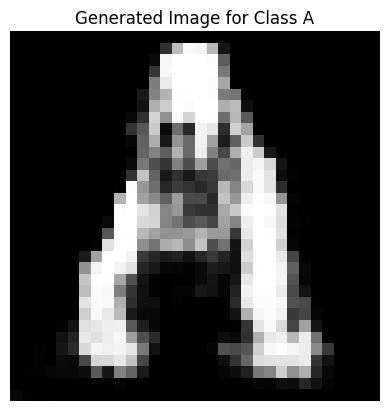

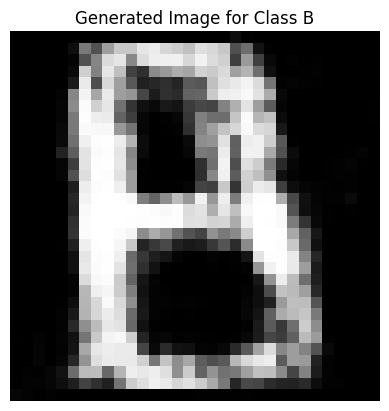

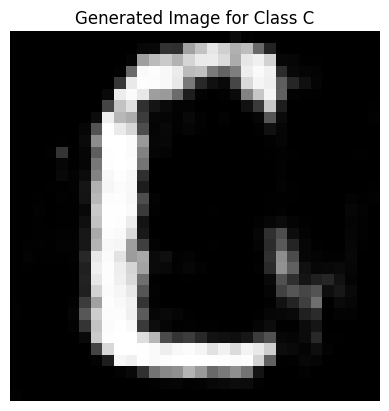

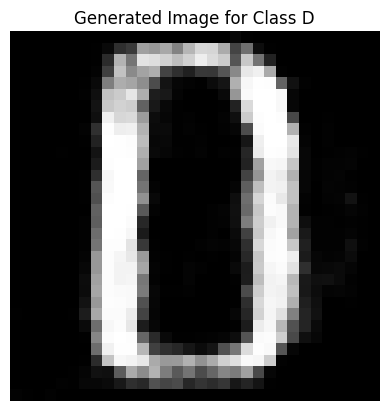

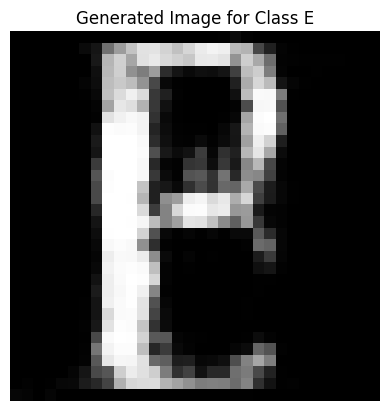

...

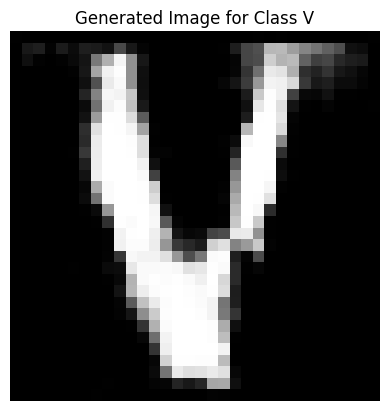

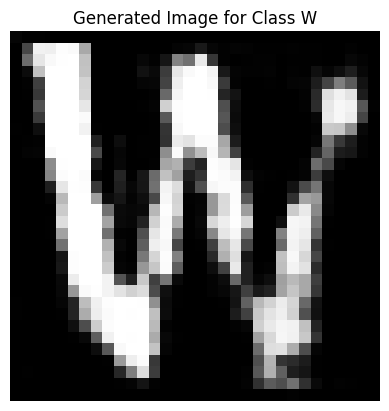

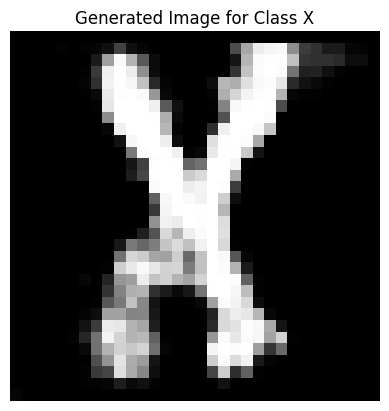

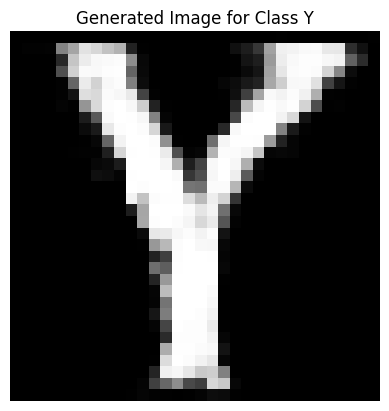

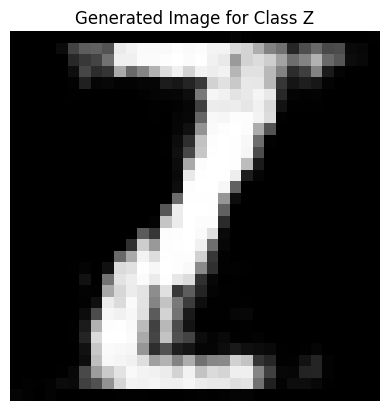

Epoch [3801/5000], D_loss: -9.3742, G_loss: 40.5067
Epoch [3802/5000], D_loss: -10.0088, G_loss: 37.7072
Epoch [3803/5000], D_loss: -9.0884, G_loss: 39.3613
Epoch [3804/5000], D_loss: -9.8212, G_loss: 39.1629
Epoch [3805/5000], D_loss: -9.7873, G_loss: 40.1194
Epoch [3806/5000], D_loss: -9.9099, G_loss: 39.1749
Epoch [3807/5000], D_loss: -9.2006, G_loss: 36.3892
Epoch [3808/5000], D_loss: -10.1700, G_loss: 41.2927
Epoch [3809/5000], D_loss: -9.9301, G_loss: 40.6623
Epoch [3810/5000], D_loss: -10.0853, G_loss: 40.5302
Epoch [3811/5000], D_loss: -9.6895, G_loss: 39.5438
Epoch [3812/5000], D_loss: -9.4350, G_loss: 43.8122
Epoch [3813/5000], D_loss: -9.2532, G_loss: 39.3967
Epoch [3814/5000], D_loss: -10.3724, G_loss: 35.4739
Epoch [3815/5000], D_loss: -9.3703, G_loss: 39.1902
Epoch [3816/5000], D_loss: -9.8815, G_loss: 38.0743
Epoch [3817/5000], D_loss: -10.1092, G_loss: 34.5427
Epoch [3818/5000], D_loss: -9.5383, G_loss: 38.5443
Epoch [3819/5000], D_loss: -9.6577, G_loss: 39.5217
Epoch [

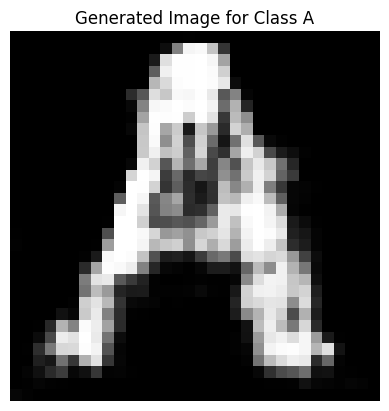

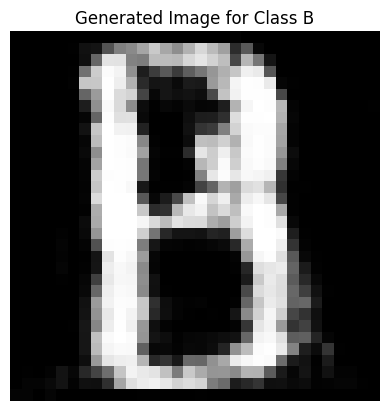

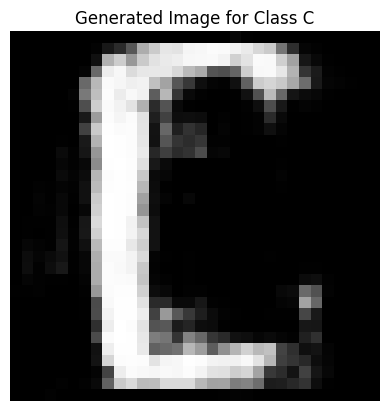

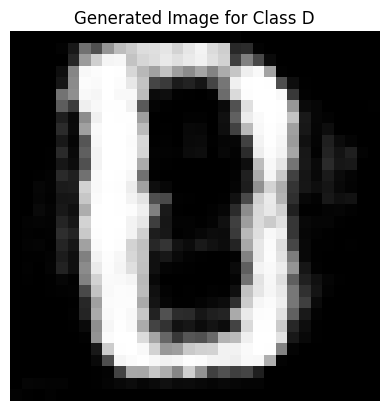

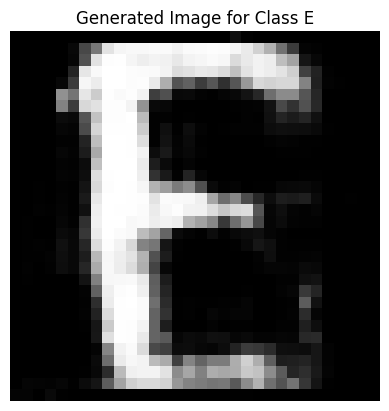

...

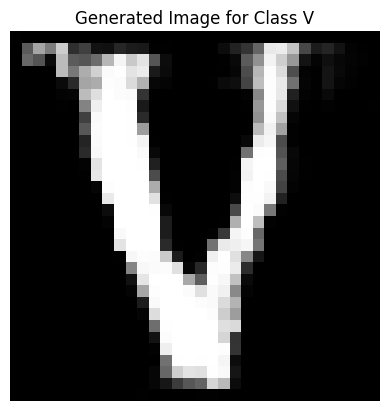

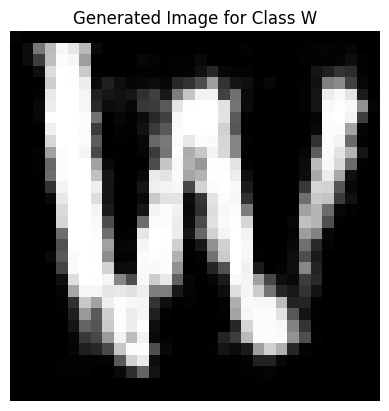

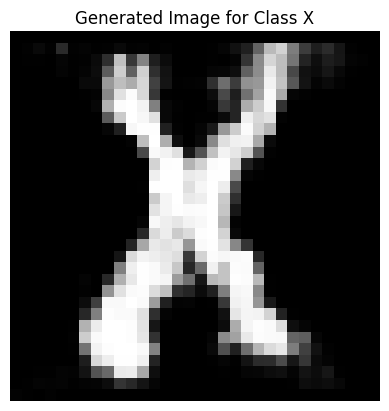

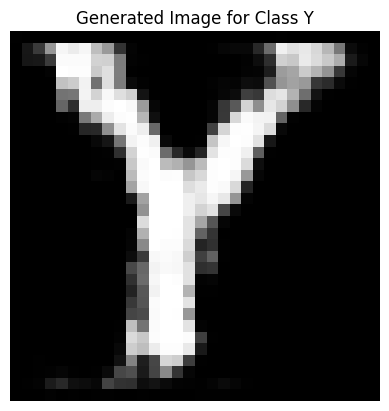

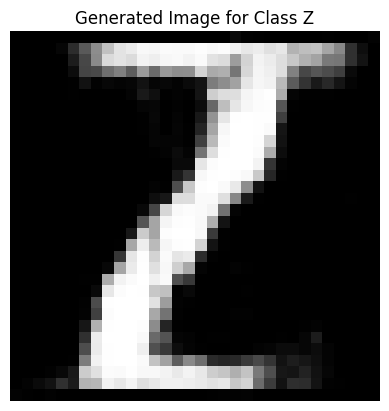

Epoch [4001/5000], D_loss: -9.1332, G_loss: 43.0154
Epoch [4002/5000], D_loss: -9.9105, G_loss: 47.5081
Epoch [4003/5000], D_loss: -9.2464, G_loss: 43.1969
Epoch [4004/5000], D_loss: -9.3754, G_loss: 43.5222
Epoch [4005/5000], D_loss: -10.0385, G_loss: 43.6423
Epoch [4006/5000], D_loss: -9.7258, G_loss: 39.8474
Epoch [4007/5000], D_loss: -9.5021, G_loss: 43.1746
Epoch [4008/5000], D_loss: -9.8559, G_loss: 40.6658
Epoch [4009/5000], D_loss: -9.6641, G_loss: 39.5377
Epoch [4010/5000], D_loss: -9.5829, G_loss: 45.8146
Epoch [4011/5000], D_loss: -9.3888, G_loss: 44.1024
Epoch [4012/5000], D_loss: -10.0855, G_loss: 41.2774
Epoch [4013/5000], D_loss: -9.9379, G_loss: 43.4536
Epoch [4014/5000], D_loss: -9.0772, G_loss: 43.6693
Epoch [4015/5000], D_loss: -10.0282, G_loss: 43.9829
Epoch [4016/5000], D_loss: -9.3689, G_loss: 45.3544
Epoch [4017/5000], D_loss: -9.0902, G_loss: 45.3684
Epoch [4018/5000], D_loss: -9.4960, G_loss: 44.5961
Epoch [4019/5000], D_loss: -9.3000, G_loss: 43.6384
Epoch [40

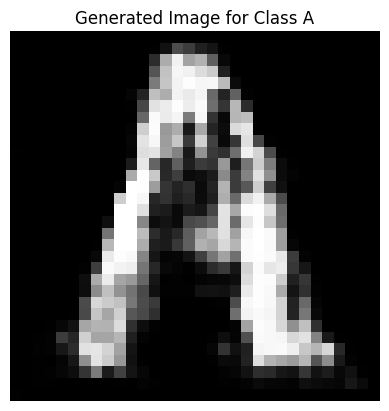

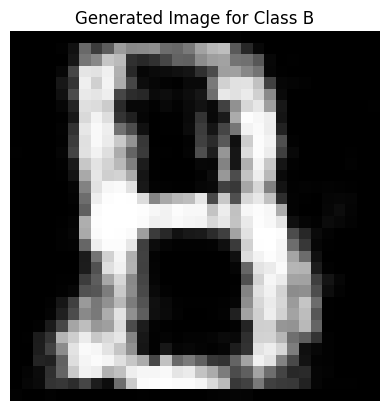

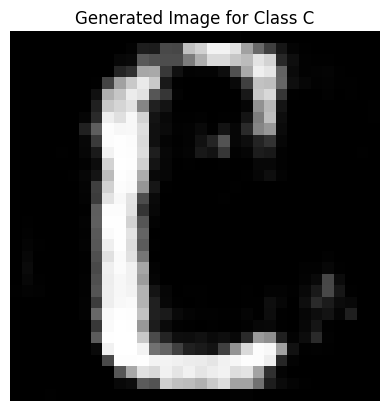

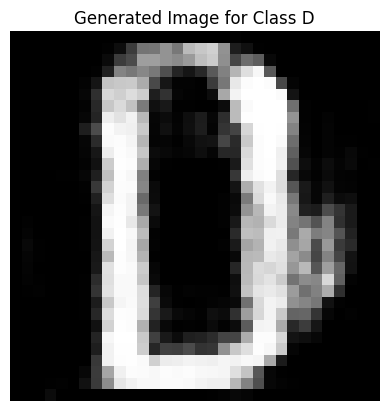

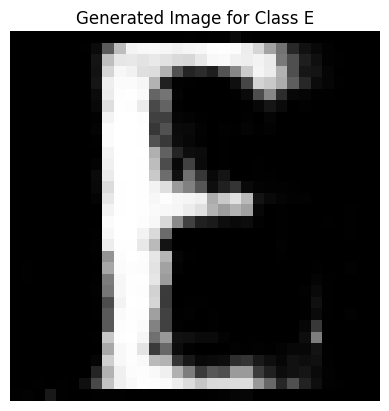

...

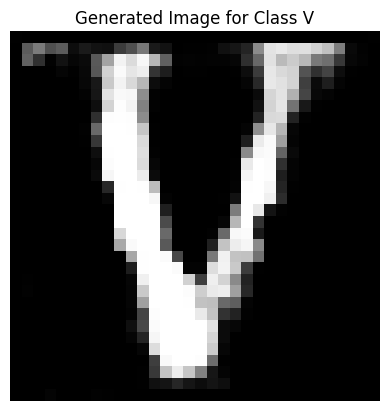

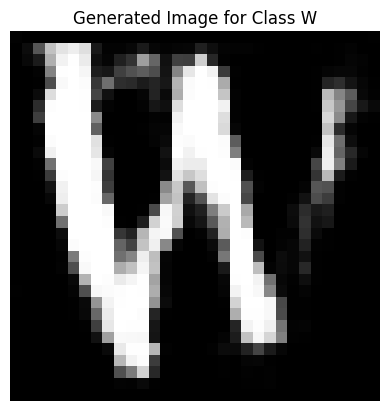

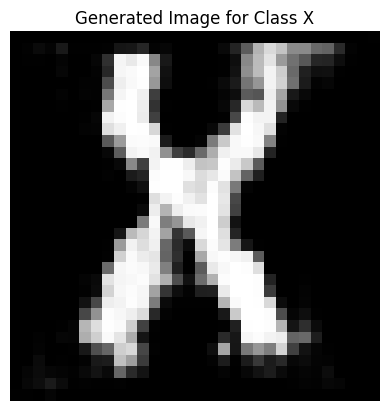

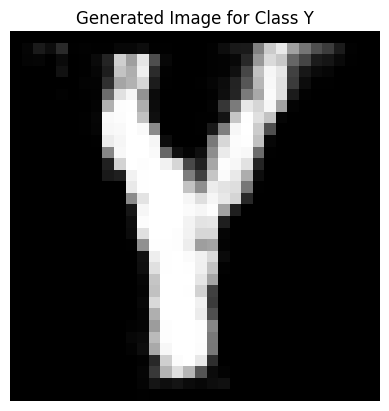

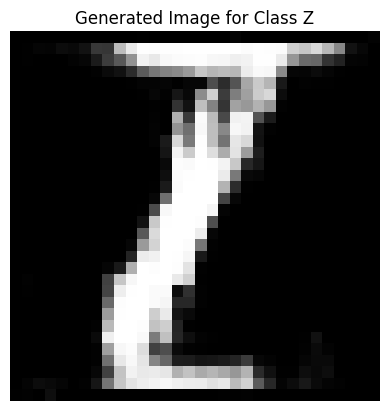

Epoch [4201/5000], D_loss: -9.4877, G_loss: 50.1363
Epoch [4202/5000], D_loss: -9.7550, G_loss: 52.0066
Epoch [4203/5000], D_loss: -8.8875, G_loss: 48.2609
Epoch [4204/5000], D_loss: -9.5807, G_loss: 48.3954
Epoch [4205/5000], D_loss: -9.2947, G_loss: 46.8085
Epoch [4206/5000], D_loss: -9.7957, G_loss: 46.3421
Epoch [4207/5000], D_loss: -9.2890, G_loss: 47.4335
Epoch [4208/5000], D_loss: -9.5289, G_loss: 49.9370
Epoch [4209/5000], D_loss: -9.0624, G_loss: 46.9995
Epoch [4210/5000], D_loss: -9.3848, G_loss: 47.6256
Epoch [4211/5000], D_loss: -10.3920, G_loss: 47.3008
Epoch [4212/5000], D_loss: -9.2386, G_loss: 48.1265
Epoch [4213/5000], D_loss: -10.5162, G_loss: 45.9153
Epoch [4214/5000], D_loss: -10.5089, G_loss: 48.5078
Epoch [4215/5000], D_loss: -9.9398, G_loss: 52.5584
Epoch [4216/5000], D_loss: -8.9961, G_loss: 50.2740
Epoch [4217/5000], D_loss: -9.5702, G_loss: 48.1888
Epoch [4218/5000], D_loss: -9.8185, G_loss: 52.0545
Epoch [4219/5000], D_loss: -9.1564, G_loss: 49.8844
Epoch [42

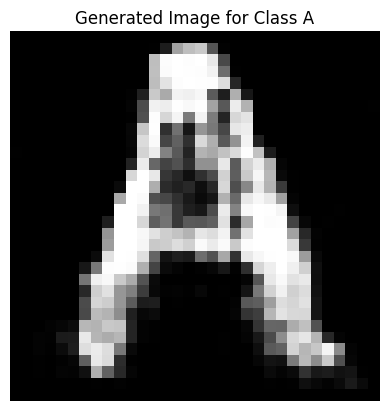

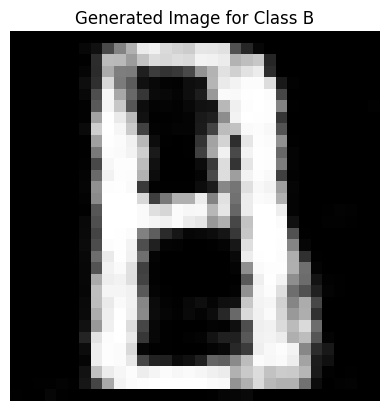

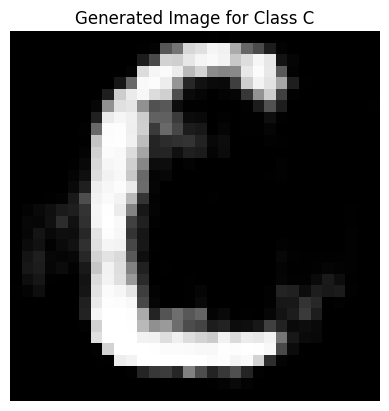

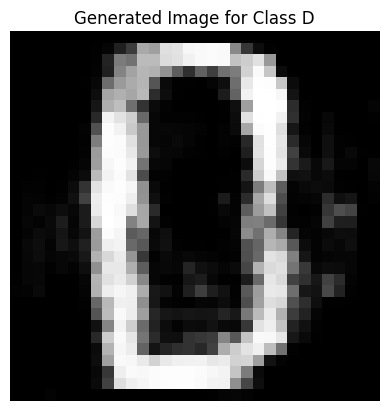

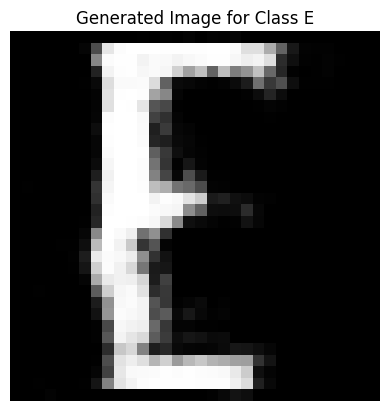

...

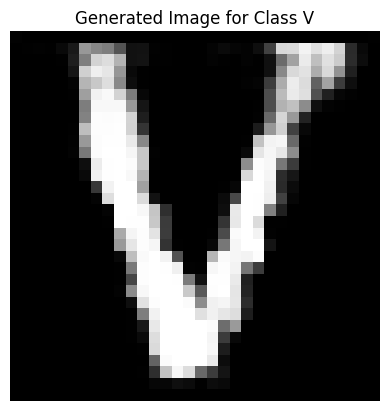

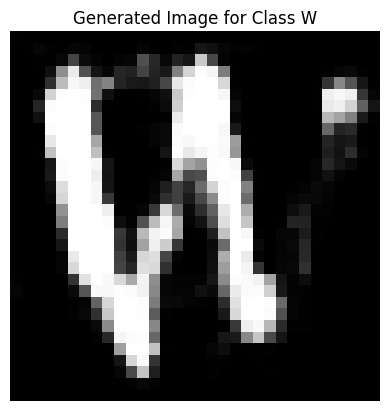

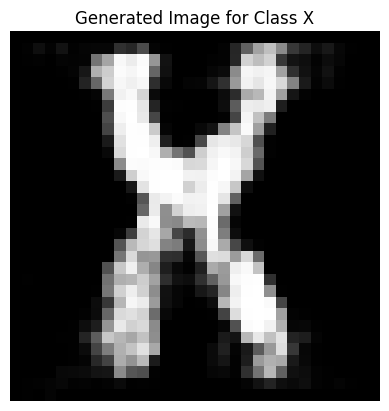

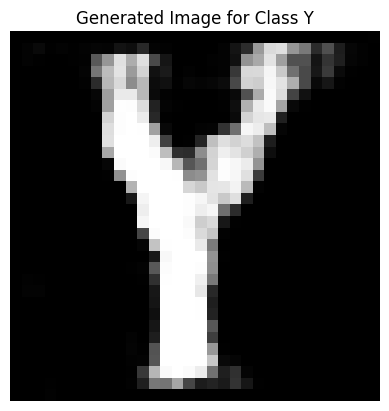

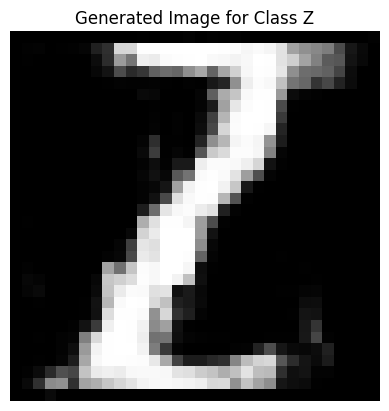

Epoch [4401/5000], D_loss: -9.3824, G_loss: 49.9434
Epoch [4402/5000], D_loss: -9.3195, G_loss: 51.1189
Epoch [4403/5000], D_loss: -9.3057, G_loss: 49.6065
Epoch [4404/5000], D_loss: -8.7166, G_loss: 48.7775
Epoch [4405/5000], D_loss: -9.2904, G_loss: 50.0943
Epoch [4406/5000], D_loss: -8.9487, G_loss: 50.0340
Epoch [4407/5000], D_loss: -9.6009, G_loss: 52.6318
Epoch [4408/5000], D_loss: -10.3884, G_loss: 51.1819
Epoch [4409/5000], D_loss: -10.2369, G_loss: 51.1243
Epoch [4410/5000], D_loss: -8.9067, G_loss: 52.1940
Epoch [4411/5000], D_loss: -9.5919, G_loss: 53.3864
Epoch [4412/5000], D_loss: -9.7039, G_loss: 55.3406
Epoch [4413/5000], D_loss: -10.0382, G_loss: 51.4494
Epoch [4414/5000], D_loss: -8.9530, G_loss: 50.1475
Epoch [4415/5000], D_loss: -9.4584, G_loss: 51.7373
Epoch [4416/5000], D_loss: -9.3054, G_loss: 51.7775
Epoch [4417/5000], D_loss: -8.9486, G_loss: 50.8288
Epoch [4418/5000], D_loss: -9.8325, G_loss: 53.2037
Epoch [4419/5000], D_loss: -9.1630, G_loss: 53.0520
Epoch [44

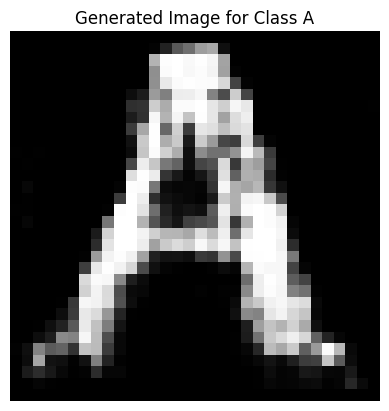

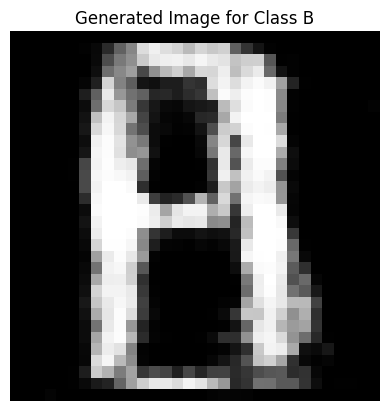

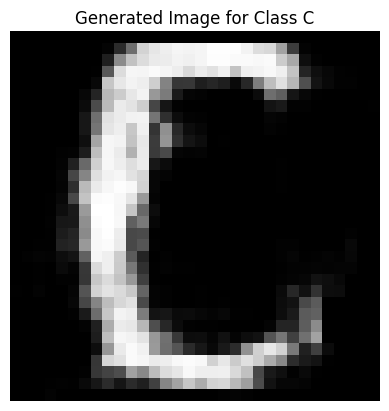

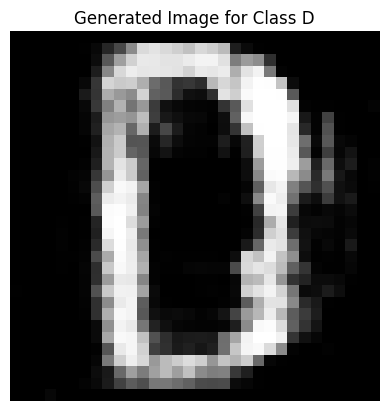

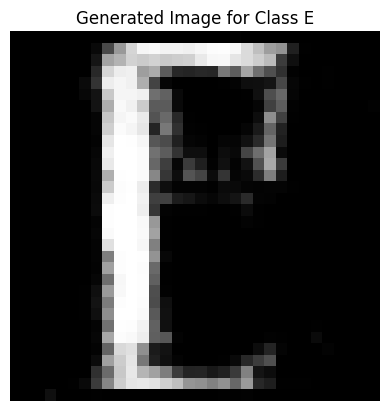

...

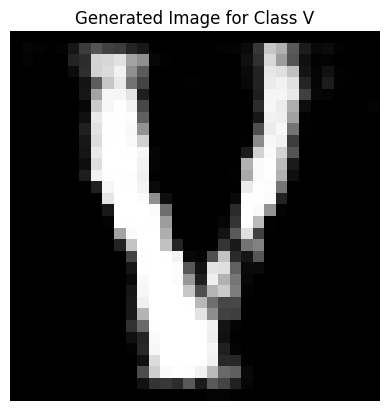

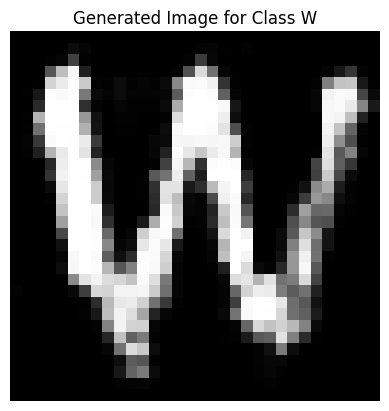

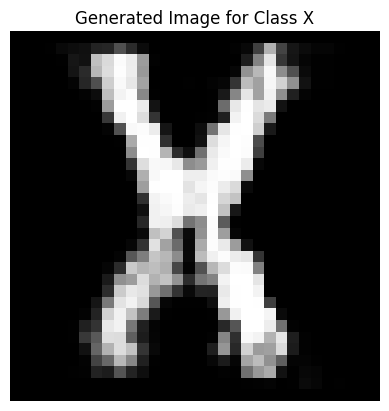

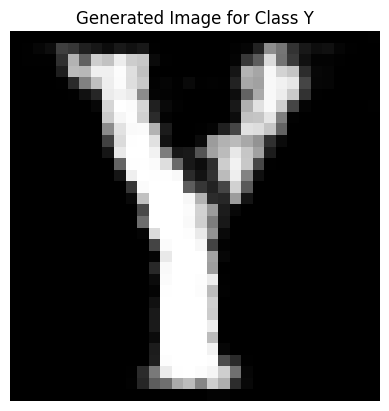

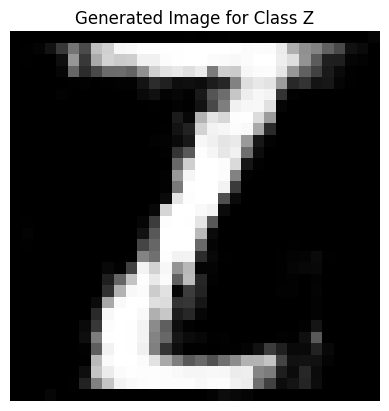

Epoch [4601/5000], D_loss: -9.0535, G_loss: 49.2582
Epoch [4602/5000], D_loss: -8.5525, G_loss: 52.9020
Epoch [4603/5000], D_loss: -9.3820, G_loss: 52.7365
Epoch [4604/5000], D_loss: -9.6069, G_loss: 54.1327
Epoch [4605/5000], D_loss: -8.8774, G_loss: 56.5530
Epoch [4606/5000], D_loss: -9.6128, G_loss: 53.0567
Epoch [4607/5000], D_loss: -9.6188, G_loss: 52.9179
Epoch [4608/5000], D_loss: -9.4743, G_loss: 53.2974
Epoch [4609/5000], D_loss: -9.1520, G_loss: 52.7498
Epoch [4610/5000], D_loss: -9.5207, G_loss: 52.9321
Epoch [4611/5000], D_loss: -9.5165, G_loss: 54.2060
Epoch [4612/5000], D_loss: -9.1934, G_loss: 51.9949
Epoch [4613/5000], D_loss: -9.5456, G_loss: 54.8465
Epoch [4614/5000], D_loss: -9.0195, G_loss: 50.4439
Epoch [4615/5000], D_loss: -9.6177, G_loss: 53.4849
Epoch [4616/5000], D_loss: -9.0759, G_loss: 55.6719
Epoch [4617/5000], D_loss: -9.3123, G_loss: 53.3745
Epoch [4618/5000], D_loss: -9.6238, G_loss: 54.5908
Epoch [4619/5000], D_loss: -9.2917, G_loss: 54.9027
Epoch [4620/

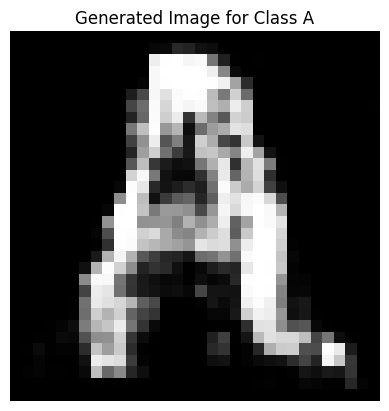

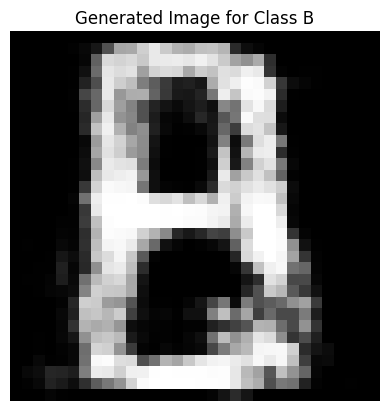

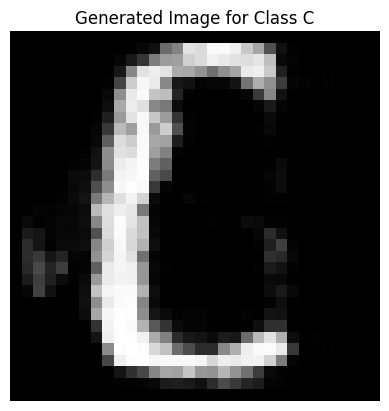

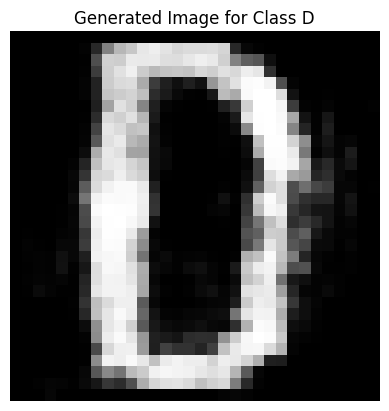

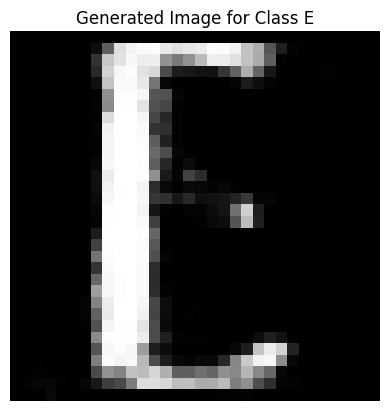

...

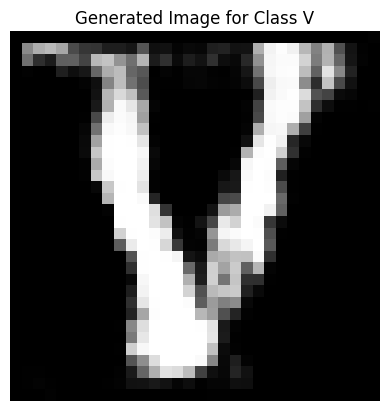

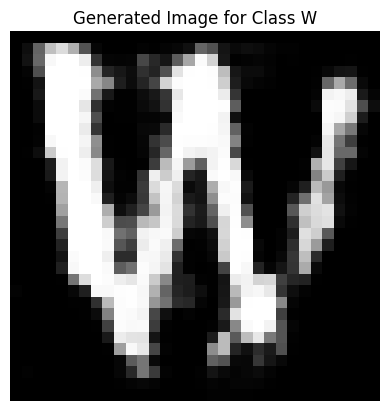

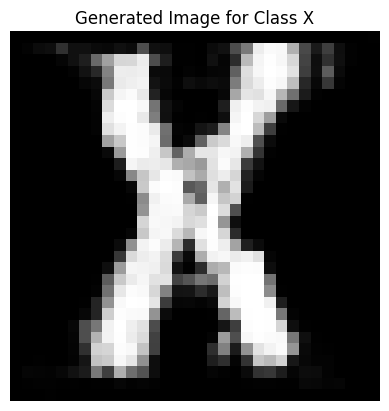

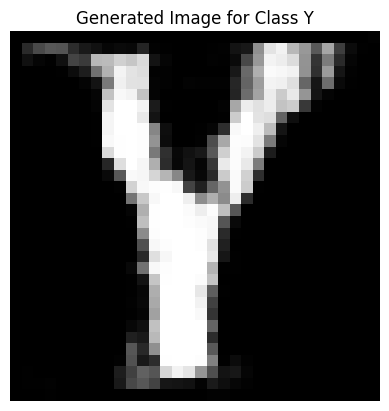

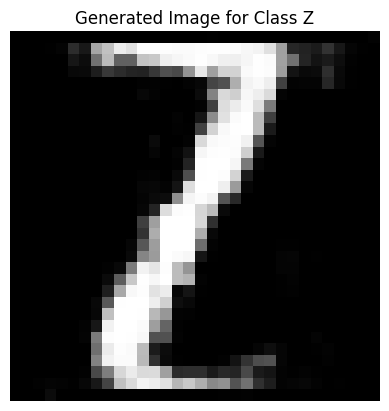

Epoch [4801/5000], D_loss: -9.6409, G_loss: 54.6835
Epoch [4802/5000], D_loss: -9.2401, G_loss: 53.2380
Epoch [4803/5000], D_loss: -9.7656, G_loss: 53.1368
Epoch [4804/5000], D_loss: -8.2816, G_loss: 54.0923
Epoch [4805/5000], D_loss: -10.0363, G_loss: 52.4841
Epoch [4806/5000], D_loss: -9.3449, G_loss: 53.8587
Epoch [4807/5000], D_loss: -9.2295, G_loss: 54.6238
Epoch [4808/5000], D_loss: -9.6776, G_loss: 51.4337
Epoch [4809/5000], D_loss: -9.6814, G_loss: 49.7692
Epoch [4810/5000], D_loss: -9.8805, G_loss: 51.7837
Epoch [4811/5000], D_loss: -9.4123, G_loss: 50.9662
Epoch [4812/5000], D_loss: -9.4640, G_loss: 51.7402
Epoch [4813/5000], D_loss: -8.7818, G_loss: 52.9576
Epoch [4814/5000], D_loss: -9.7585, G_loss: 53.1247
Epoch [4815/5000], D_loss: -9.2670, G_loss: 51.3583
Epoch [4816/5000], D_loss: -10.3753, G_loss: 53.6126
Epoch [4817/5000], D_loss: -9.5181, G_loss: 51.5700
Epoch [4818/5000], D_loss: -9.7647, G_loss: 52.3495
Epoch [4819/5000], D_loss: -9.3564, G_loss: 53.6570
Epoch [482

In [106]:

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Initialize models
latent_dim = 100  # Dimension of the latent vector z
style_dim = 1  # Dimension of the font style vector
img_size = 32  # Image size
num_classes = 26  # Number of character classes (A-Z)
z_dim = 126
epochs = 2500*2
n_critic = 3
zc_weight =  1

generator = Generator3(z_dim, style_dim, img_size).to(device)
discriminator = Discriminator3(nc=1, ndf=32).to(device)
encoder = FontStyleEncoder(img_size, style_dim).to(device)

# Optimizers
optimizer_G = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.9))
optimizer_D = optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.9))

# Training Loop
for epoch in range(epochs):
    for letter in range(num_classes):
        dataloader = grouped_dataloaders[letter]
        for i, (real_imgs, condition_imgs, labels) in enumerate(dataloader):
            real_imgs = real_imgs.to(device)
            condition_imgs = condition_imgs.to(device)

            labels = labels.to(device)
            current_size = labels.size(0)

            real_imgs = real_imgs.permute(0, 2, 3, 1).cuda()

            condition_imgs = condition_imgs.permute(0, 2, 3, 1).cuda()



            # Extract font style features from conditional images
            #font_style_features = encoder(condition_imgs) this is now done in the generator

            # Train Discriminator
            z_s = torch.randn( current_size, latent_dim).to(device)  # Latent vector
            z_c = torch.zeros( current_size, num_classes).to(device)  # One-hot class vector
            z_c[torch.arange( current_size), labels] = 1
            z = torch.cat((z_s, z_c * zc_weight), dim=1)  # Combine latent vector and one hot
            fake_imgs = generator(z, condition_imgs)  # Generate fake images
            noisy_condition_imgs = add_noise(condition_imgs, noise_level=0.05)
            smooth_fake_imgs = F.avg_pool2d(fake_imgs, kernel_size=2, stride=1, padding=0)  # Smooth outputs
            real_validity = discriminator(real_imgs,  noisy_condition_imgs)  # Include condition image
            real_validity = real_validity - 0.1
            fake_validity = discriminator(fake_imgs.detach(),  noisy_condition_imgs)  # Include con
            gradient_penalty = compute_gradient_penalty(
                discriminator,
                real_samples=real_imgs,
                fake_samples=fake_imgs,
                condition_samples= noisy_condition_imgs,  # Pass condition for gradient penalty
                device=device
            )

            d_loss = -torch.mean(real_validity) + torch.mean(fake_validity) + lambda_gp * gradient_penalty

            optimizer_D.zero_grad()
            d_loss.backward()
            optimizer_D.step()

            # Train Generator
            if i % n_critic == 0:
                z_s = torch.randn (current_size, latent_dim).to(device)
                z = torch.cat((z_s, z_c), dim=1)
                fake_imgs = generator(z, condition_imgs)
                fake_validity = discriminator(fake_imgs,  noisy_condition_imgs)
                g_loss = -torch.mean(fake_validity)

                optimizer_G.zero_grad()
                g_loss.backward()
                optimizer_G.step()

            #Display generated sample periodically
            if epoch % 200 == 0 and i == 0:
                displayGeneratedSample(generator, z_s, condition_imgs, labels, num_classes, class_index=0, device=device)

    # Print training progress
    print(f"Epoch [{epoch+1}/{epochs}], D_loss: {d_loss.item():.4f}, G_loss: {g_loss.item():.4f}")

    # Save models periodically
    if epoch % 10 == 0:
        torch.save(generator.state_dict(), "/content/gdrive/My Drive/generator.pth")
        torch.save(discriminator.state_dict(), "/content/gdrive/My Drive/discriminator.pth")


In [109]:
test_data = NPZDataset(npz_file, font_range=(100,110),transform=transform)

In [110]:
display_data = DataLoader(test_data, batch_size=1, shuffle=False)

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch




In [ ]:
z_s = torch.randn(1, z_dim, device='cuda')
z_c = torch.zeros(1, num_classes, device='cuda')
z_c[0, 0] = 1  # Class index 0 (A)
condition_image = torch.randn(1, 1, 32, 32, device='cuda')  # Random condition
z = torch.cat((z_s, z_c), dim=1)
with torch.no_grad():
    output = generator(z, condition_image)
    print("Generated image range:", output.min().item(), output.max().item())
    plt.imshow(output.cpu().numpy()[0, 0], cmap='gray')
    plt.show()

In [ ]:
def plot_condition_and_real_images(condition_imgs, real_imgs, batch_index):
    """
    Plot all condition images alongside their corresponding real images in the batch.

    Args:
        condition_imgs (torch.Tensor): Batch of condition images (B, C, H, W).
        real_imgs (torch.Tensor): Batch of real images (B, C, H, W).
        batch_index (int): Index of the current batch.
    """
    condition_imgs = condition_imgs.cpu().numpy()  # Convert to NumPy for plotting
    real_imgs = real_imgs.cpu().numpy()  # Convert to NumPy for plotting

    # Determine batch size
    batch_size = condition_imgs.shape[0]

    # Create a figure for all condition-real image pairs
    fig, axes = plt.subplots(2, batch_size, figsize=(15, 5))
    fig.suptitle(f"Condition and Real Images for Batch {batch_index}", fontsize=16)

    # Handle the case where batch_size == 1
    if batch_size == 1:
        axes = np.expand_dims(axes, axis=1)  # Ensure axes is 2D

    for i in range(batch_size):
        # Rescale the condition image from [-1, 1] to [0, 1]
        condition_img = (condition_imgs[i, 0] + 1) / 2  # Assuming grayscale
        real_img = (real_imgs[i, 0] + 1) / 2  # Rescale the real image as well

        # Plot condition image
        axes[0, i].imshow(condition_img, cmap='gray')
        axes[0, i].set_title(f"Condition Image {i}", fontsize=10)
        axes[0, i].axis('off')

        # Plot real image
        axes[1, i].imshow(real_img, cmap='gray')
        axes[1, i].set_title(f"Real Image {i}", fontsize=10)
        axes[1, i].axis('off')

    plt.tight_layout()
    plt.show()

In [ ]:
import os
import matplotlib.pyplot as plt
import numpy as np
import torch


def saveGridOfGeneratedImages(generator, z_s, condition_image, num_classes, output_file, condition_folder,j, device='cuda'):
    """
    Generates a grid of images for all classes and saves it as a single image file.
    Also saves the condition image in a separate folder.
    """
    # Ensure condition_image has the correct dimensions
    if condition_image.ndim == 5:
        condition_image = condition_image.squeeze(0)  # Remove unnecessary batch dimension
    print("Condition Image Shape After Squeeze:", condition_image.shape)

    # Save the conditional image
    condition_img_rescaled = np.uint8(np.interp(condition_image.cpu().numpy()[0, 0], (-1, 1), (0, 255)))
    condition_file = os.path.join(condition_folder, f"condition_image{j//26}.png")
    plt.imsave(condition_file, condition_img_rescaled, cmap='gray')
    print(f"Conditional image saved to {condition_file}")

    # Create a grid for displaying images
    fig, axes = plt.subplots(2, 13, figsize=(20, 8))

    for class_index in range(num_classes):
        # Create the one-hot vector for the class
        z_c = torch.zeros(1, num_classes, device=device)
        z_c[0, class_index] = 1  # Set the desired class

        # Concatenate the style and class vectors
        z = torch.cat((z_s, z_c), dim=1)

        # Generate the image
        with torch.no_grad():
            generated_img = generator(z, condition_image).cpu().numpy()[0, 0]  # Extract the first batch and first channel

        # Rescale the image from [-1, 1] to [0, 255]
        generated_img = np.uint8(np.interp(generated_img, (-1, 1), (0, 255)))

        # Plot the image in the appropriate subplot
        row = class_index // 13
        col = class_index % 13
        ax = axes[row, col]
        ax.imshow(generated_img, cmap='gray')
        ax.axis("off")
        ax.set_title(chr(65 + class_index), fontsize=12)  # Display A-Z above images

    # Adjust layout and save the figure as a single image
    plt.tight_layout()
    plt.savefig(output_file, bbox_inches='tight')
    plt.close(fig)

    print(f"Grid image saved to {output_file}")



# Mount Google Drive
#drive.mount('/content/drive')

# Define output folders
output_folder = "/content/gdrive/My Drive/cGAN_overfit_working"
condition_folder = "/content/gdrive/My Drive/cGAN_conditions_working"
os.makedirs(output_folder, exist_ok=True)
os.makedirs(condition_folder, exist_ok=True)

# Example conditional image (e.g., the "A" image)
for j, (real_imgs, condition_imgs, labels) in enumerate(display_data):
            real_imgs = real_imgs.cuda()
            condition_imgs = condition_imgs.cuda()
            labels = labels.cuda()
            #batch_size = labels.size(0)
            real_imgs = real_imgs.permute(0, 2, 3, 1).cuda()
            condition_imgs = condition_imgs.permute(0, 2, 3, 1).cuda()
            #condition_imgs = condition_imgs.cuda()
            #plot_condition_and_real_images(condition_imgs,real_imgs, batch_index=j)


            # Loop to generate and save 10 grids
            #num_classes = 26  # A-Z
            # Generate a new random style vector for each grid
            #z_dim = 100  # Adjust based on your generator's style vector dimension
            z_s = torch.randn(1, 100, device='cuda')

            fig, axes = plt.subplots(2, 13, figsize=(20, 8))
            #axes = np.expand_dims(axes, axis=1)  # Ensure axes is 2D

            for class_index in range(num_classes):
                # Create the one-hot vector for the class
                z_c = torch.zeros(1, num_classes, device=device)
                z_c[0, class_index] = 1  # Set the desired class

                # Concatenate the style and class vectors
                z = torch.cat((z_s, z_c), dim=1)

                # Generate the image
                with torch.no_grad():
                    generated_img = generator(z, condition_imgs).cpu().numpy()[0, 0]  # Extract the first batch and first channel

                # Rescale the image from [-1, 1] to [0, 255]
                generated_img = np.uint8(np.interp(generated_img, (-1, 1), (0, 255)))

                # Plot the image in the appropriate subplot
                row = class_index // 13
                col = class_index % 13
                ax = axes[row, col]
                ax.imshow(generated_img, cmap='gray')
                ax.axis("off")
                ax.set_title(chr(65 + class_index), fontsize=12)  # Display A-Z above images

            # Adjust layout and save the figure as a single image
            plt.tight_layout()
            #plt.savefig(output_file, bbox_inches='tight')
            #plt.close(fig)

            # Define the output file paths
            #saveGridOfGeneratedImages(generator=generator,z_s=z_s,condition_image=condition_imgs,num_classes=26,output_file=os.path.join(output_folder, f"grid_{j%26,j//26}.png"),condition_folder=condition_folder,j=j)
print("All 10 grids and conditional images saved successfully!")


<ipython-input-77-0151f720c1fe>:76: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image = torch.tensor(image, dtype=torch.float32)
<ipython-input-77-0151f720c1fe>:77: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  condition_image = torch.tensor(condition_image, dtype=torch.float32)


torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


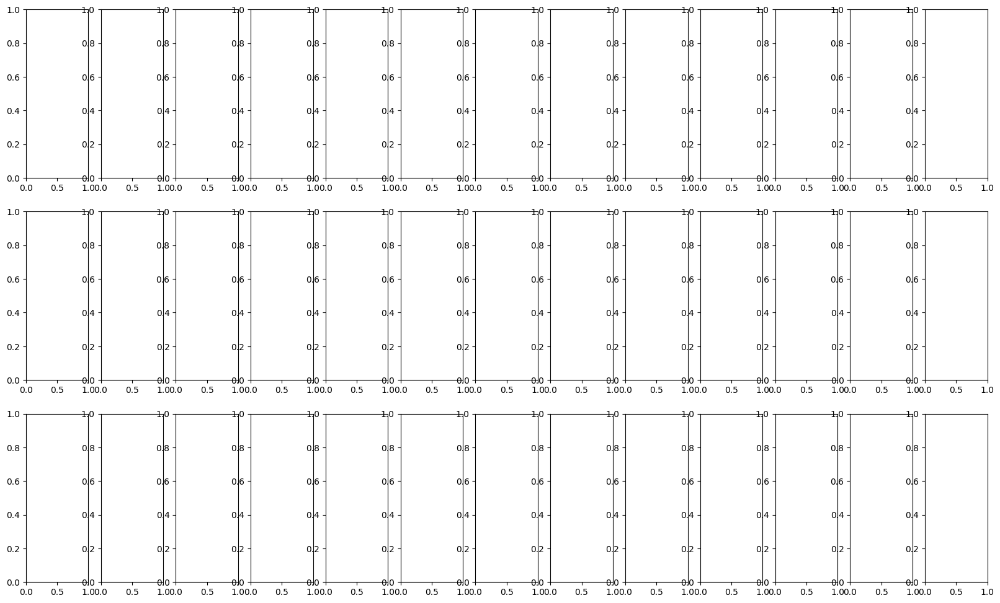

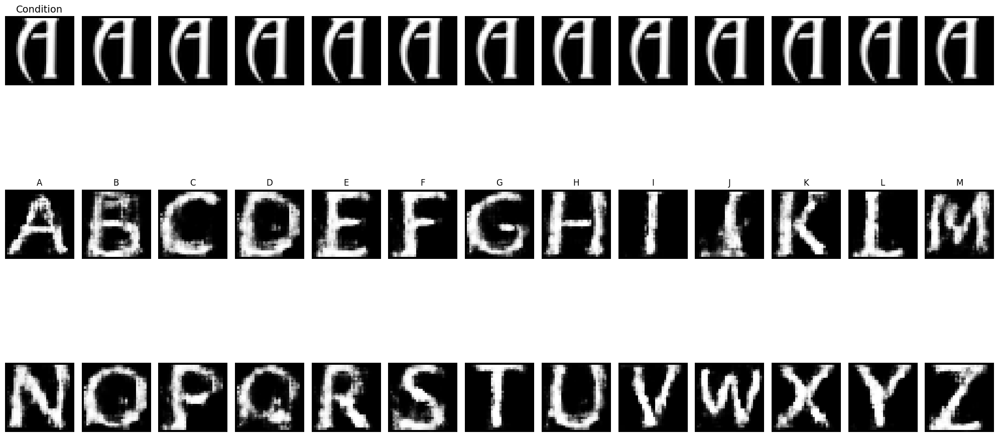

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


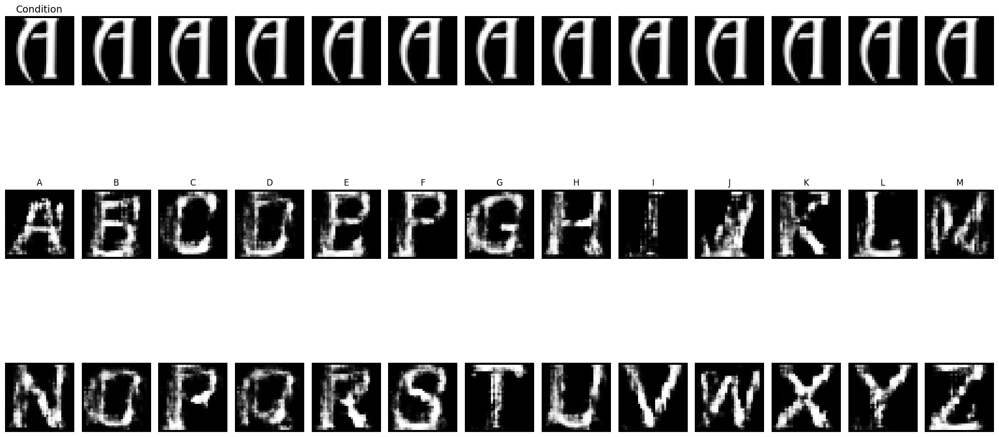

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


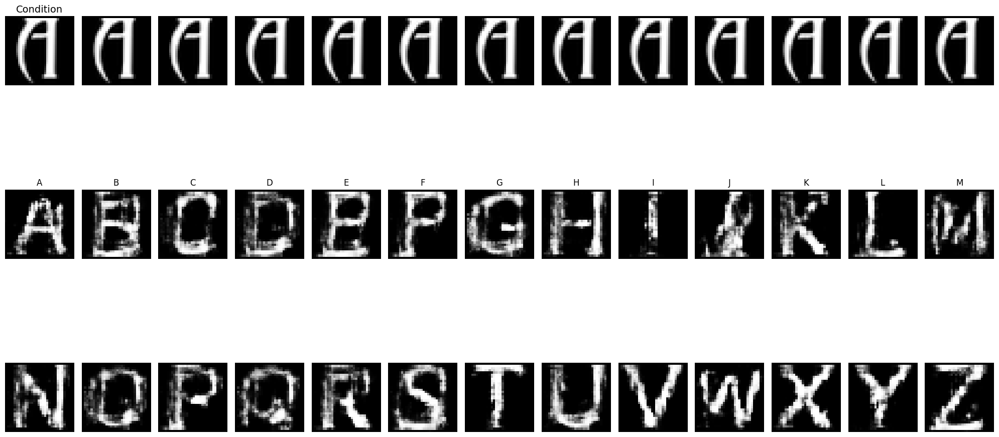

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


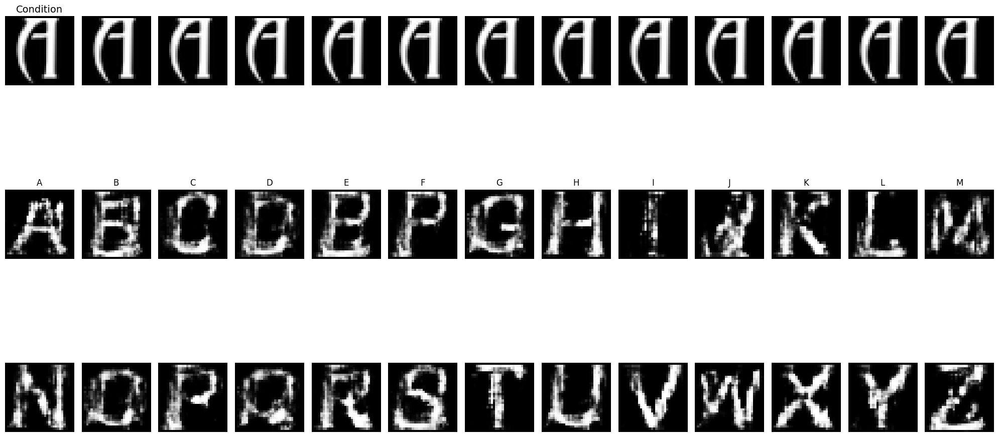

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


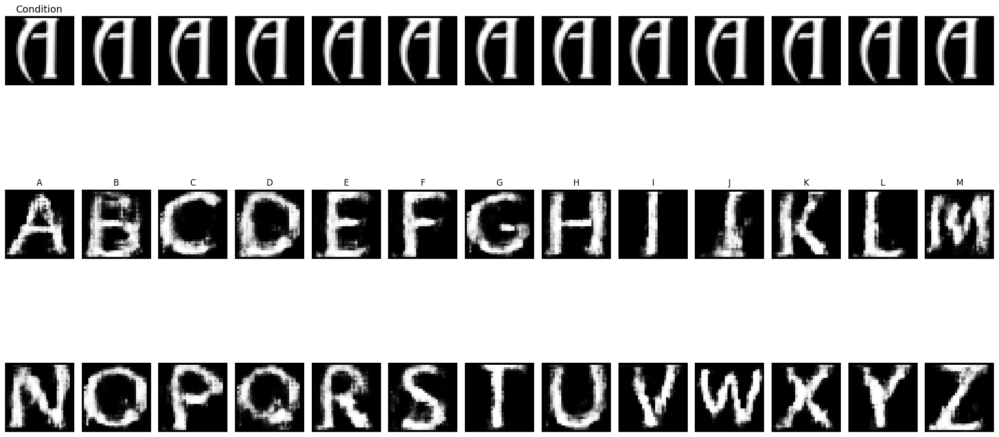

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


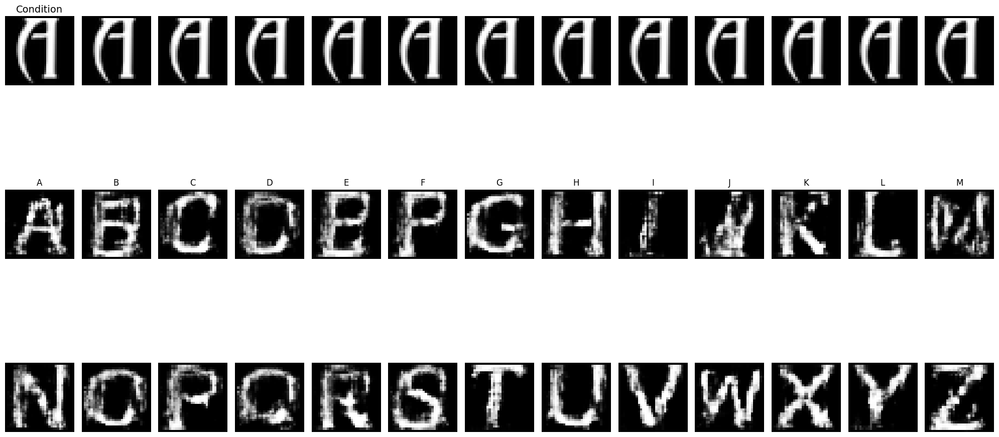

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


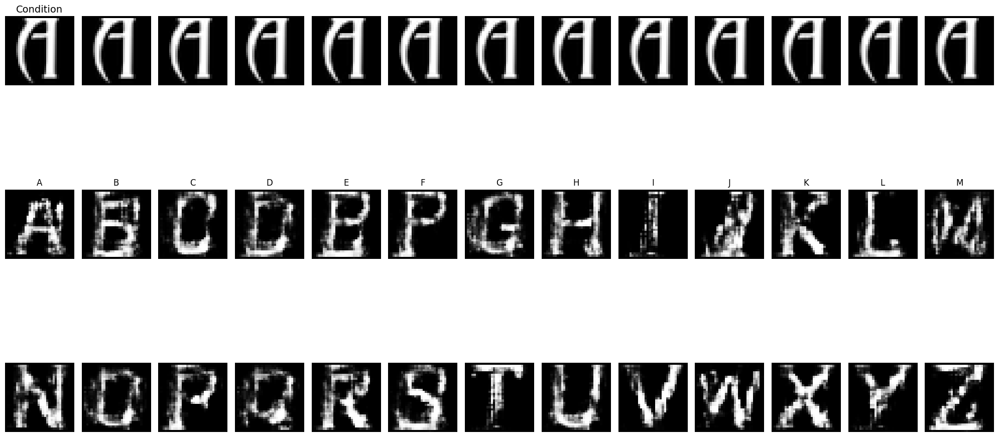

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


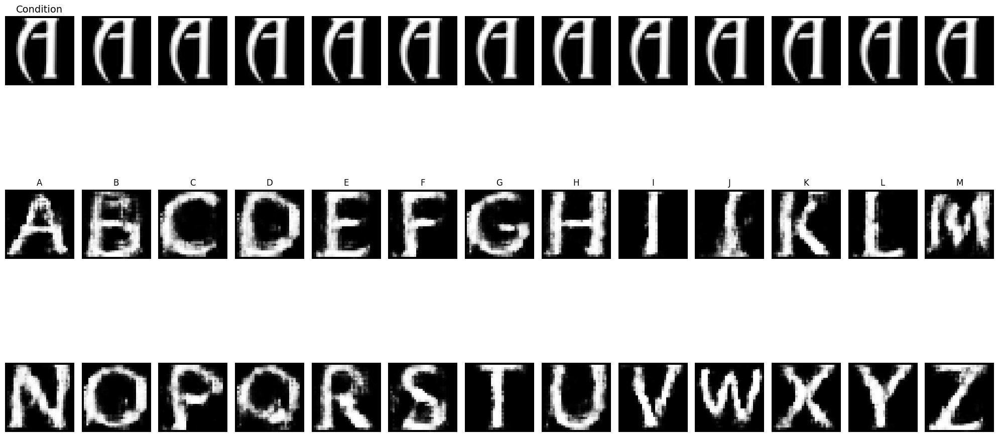

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


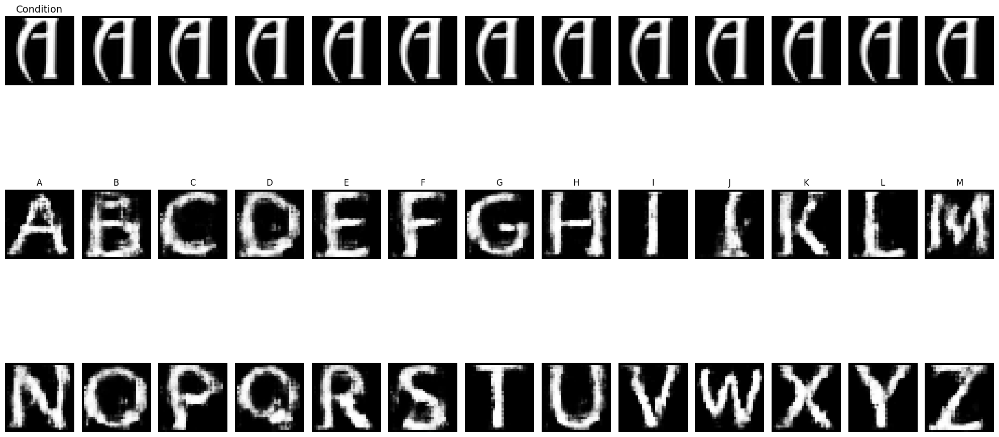

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


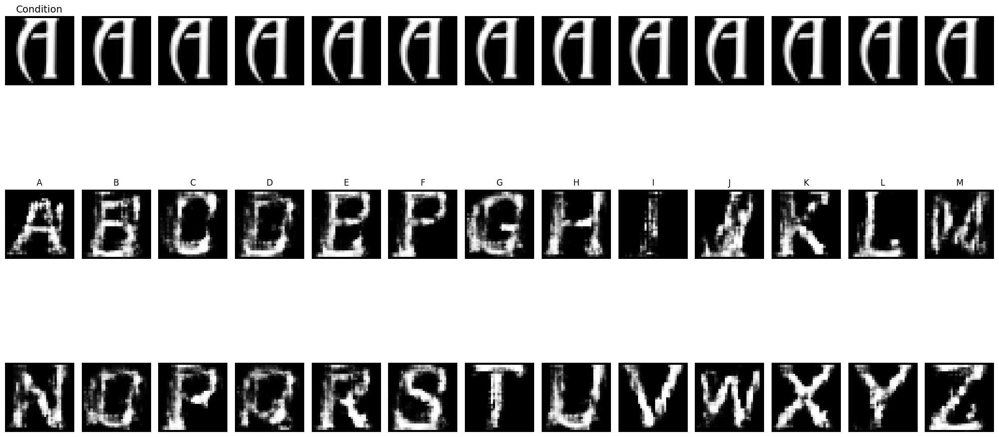

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


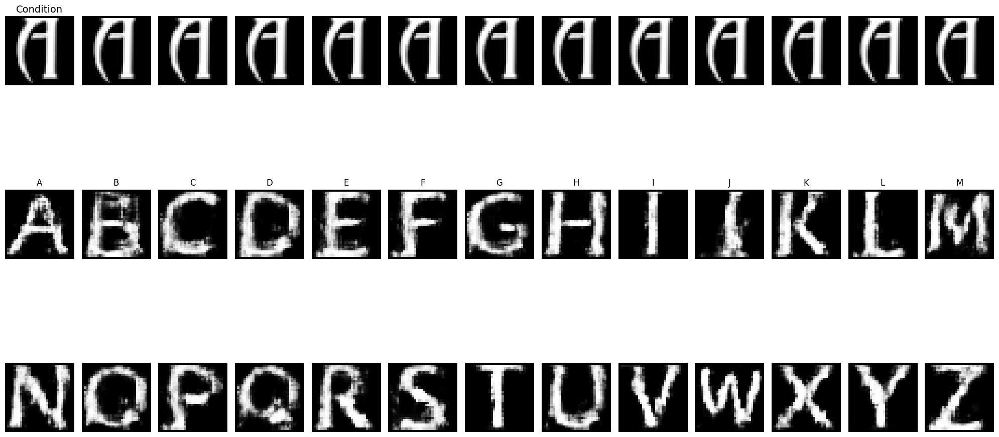

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


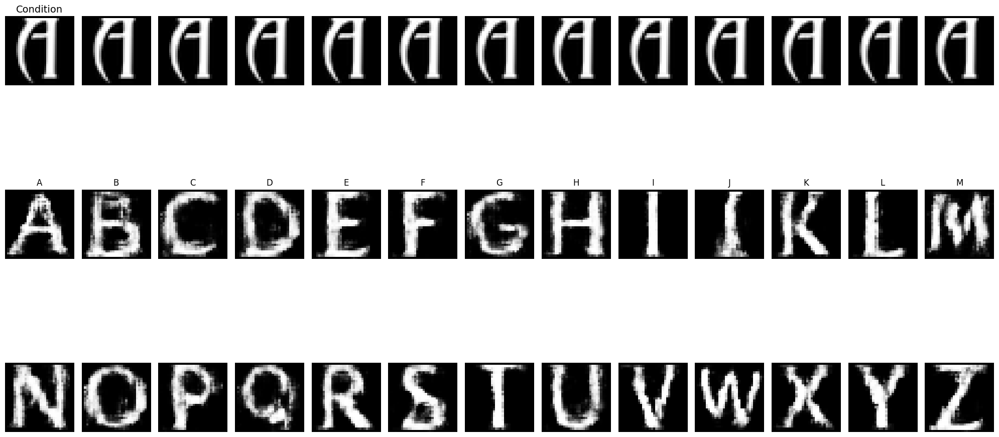

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


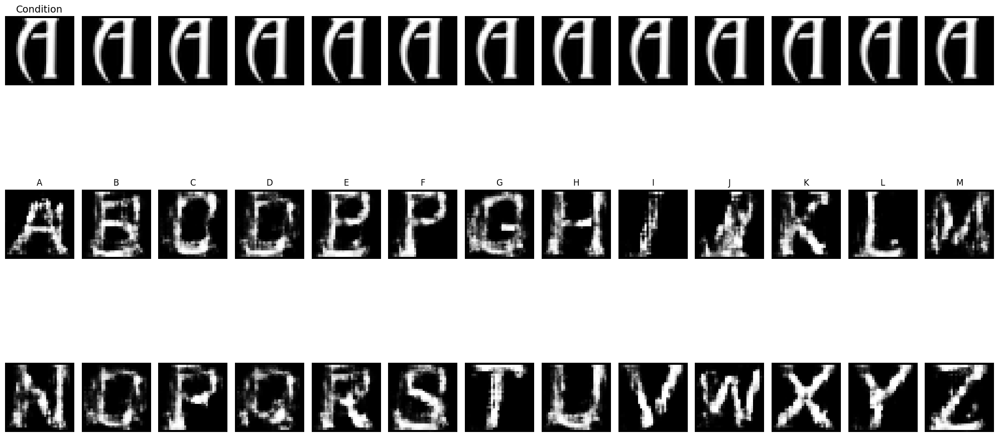

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


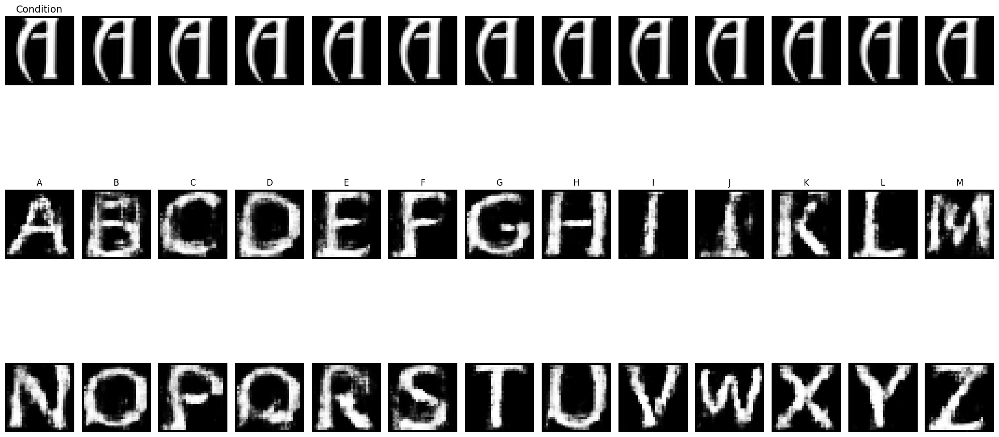

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


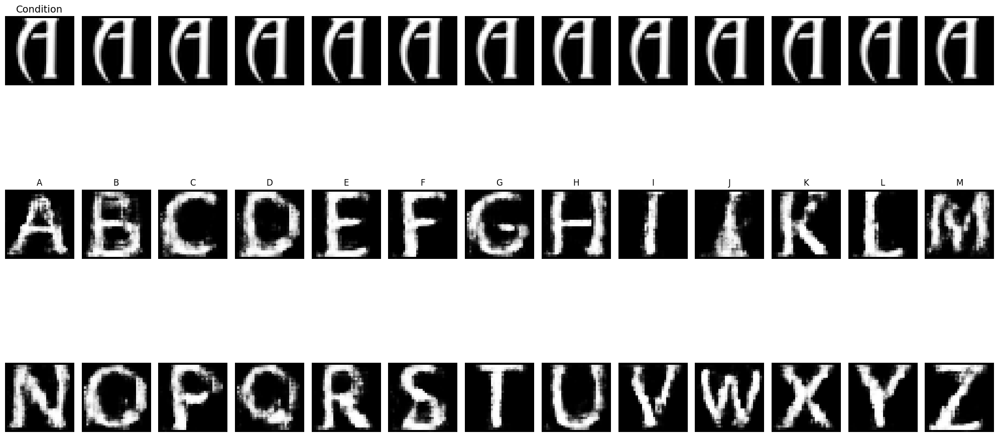

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


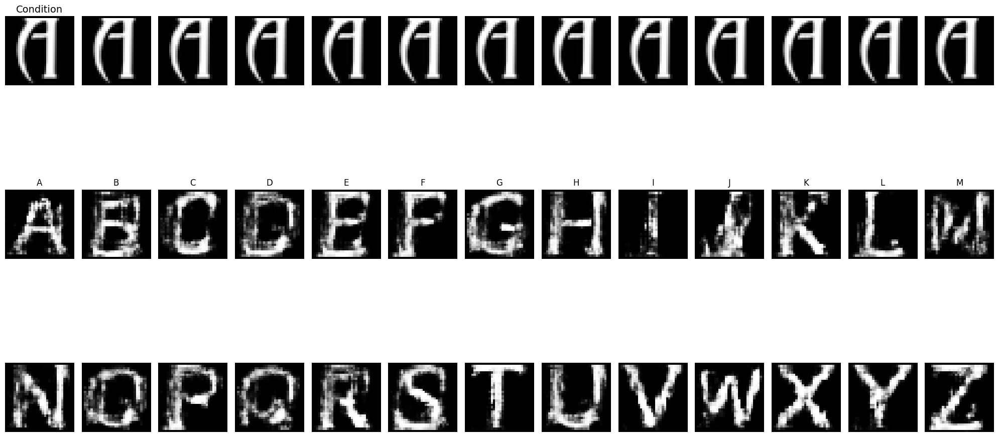

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


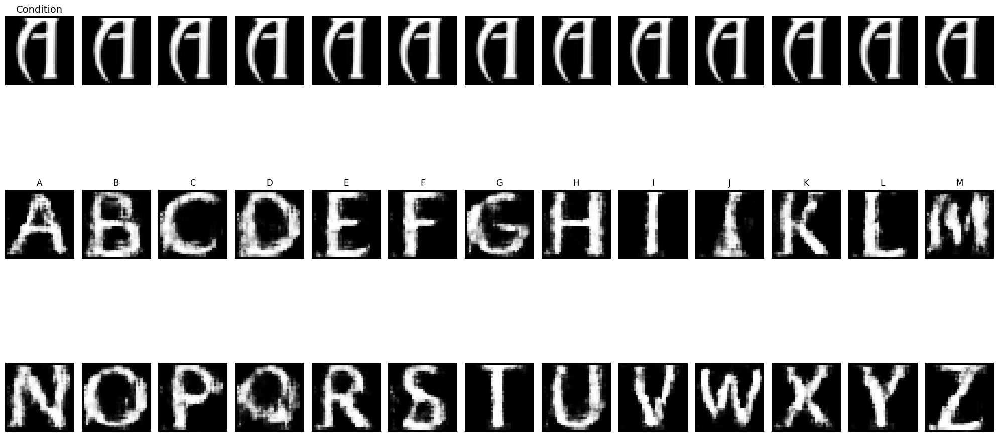

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


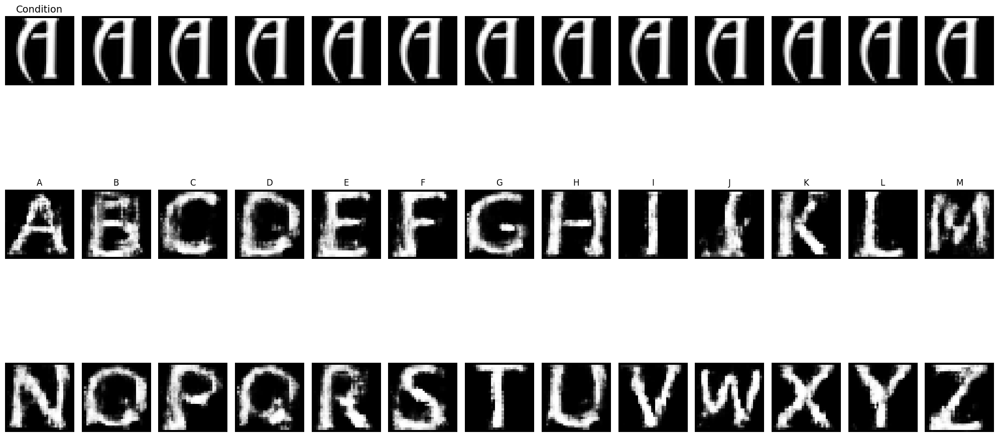

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


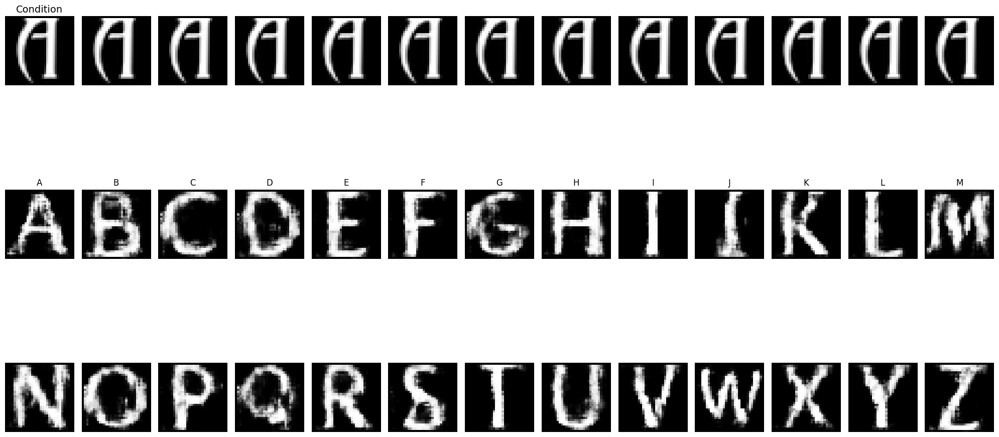

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


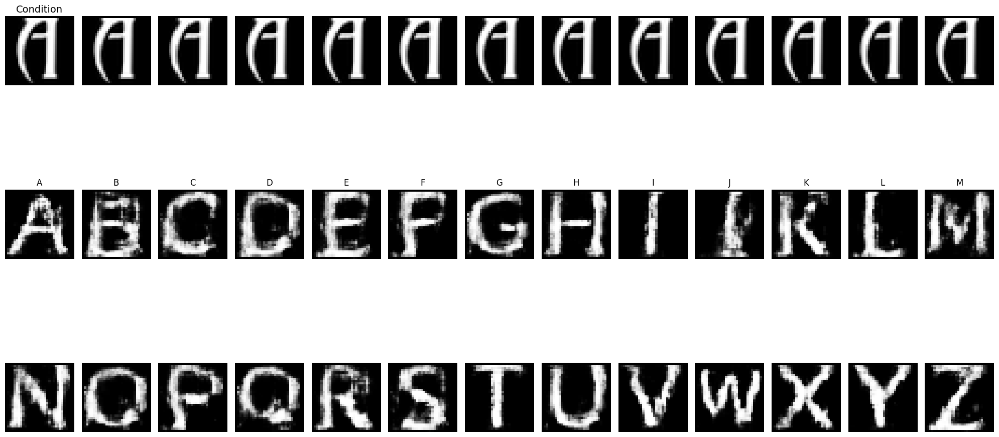

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


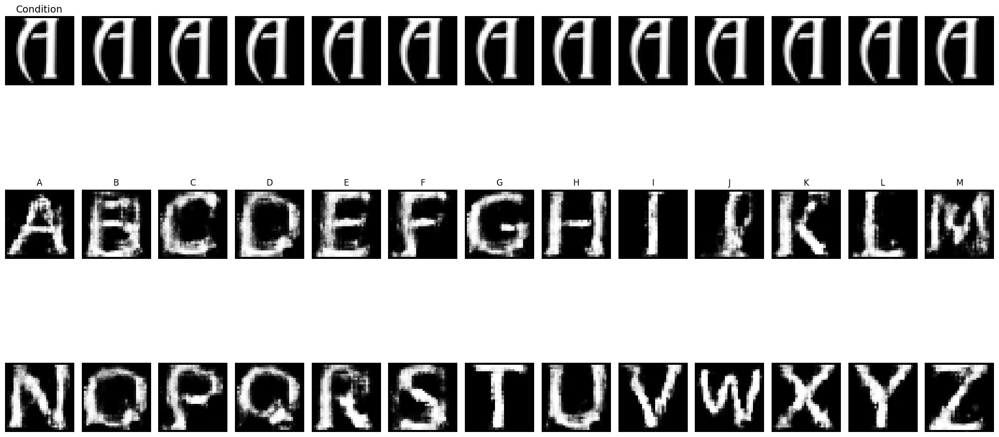

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


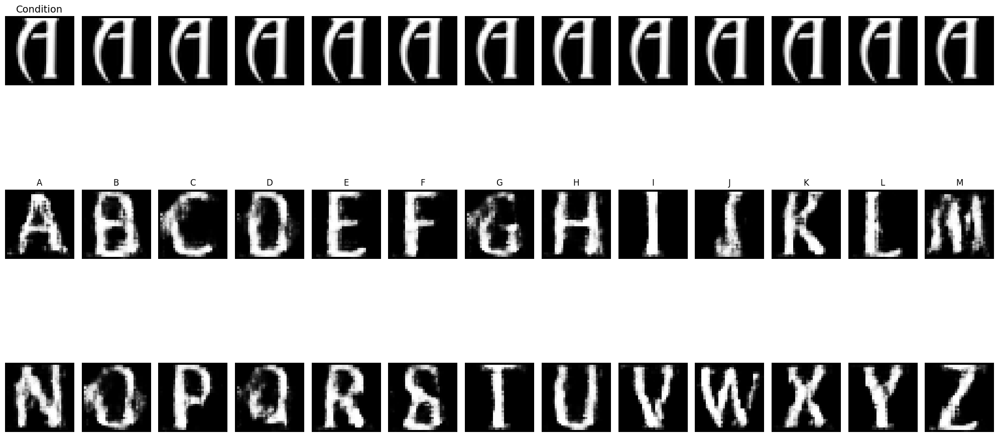

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


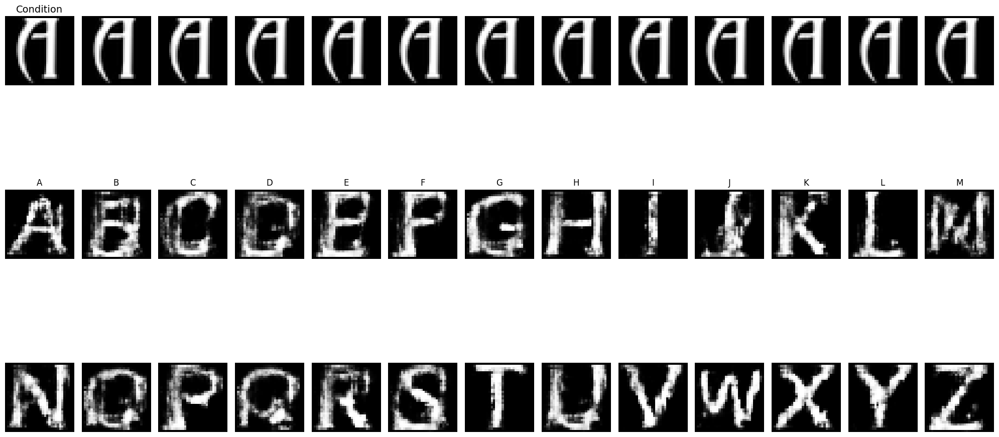

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


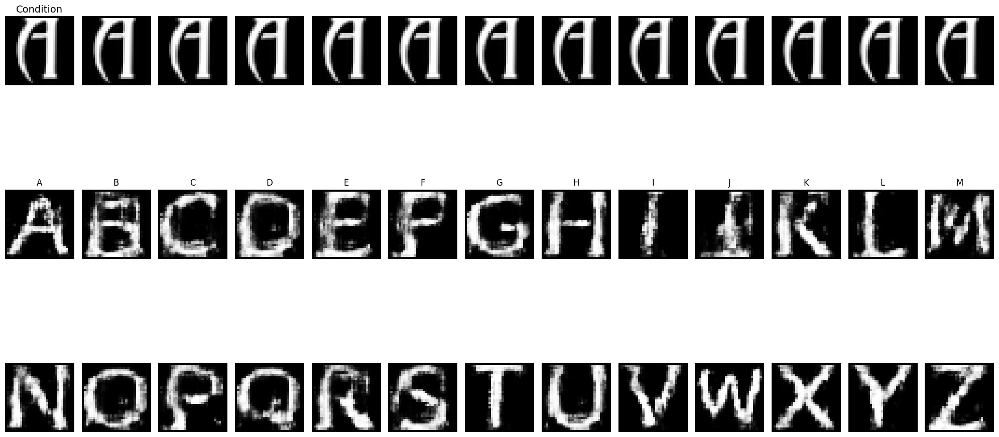

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


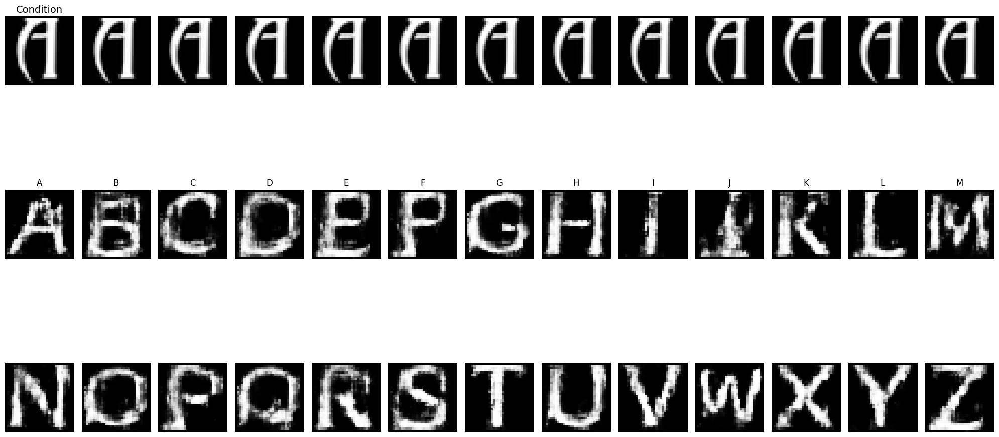

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


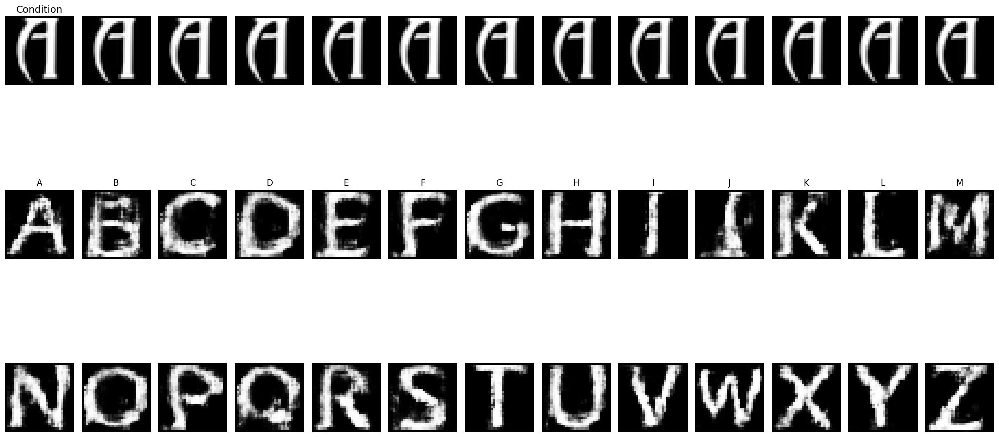

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


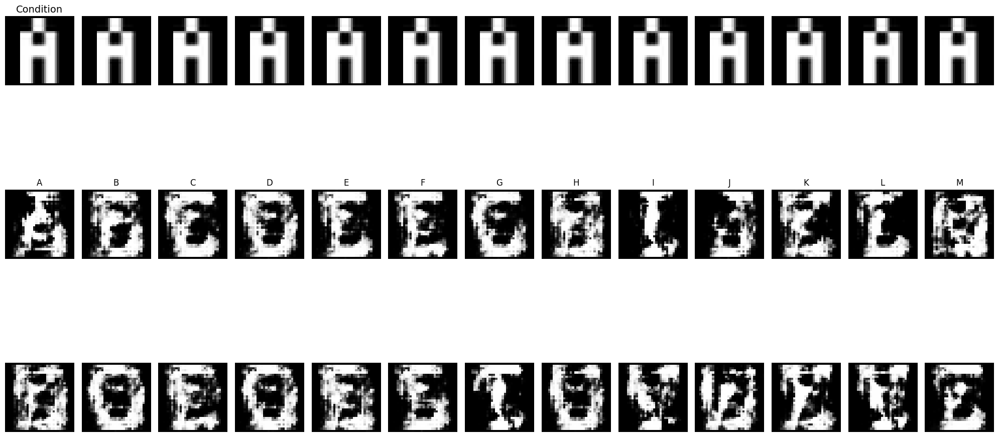

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


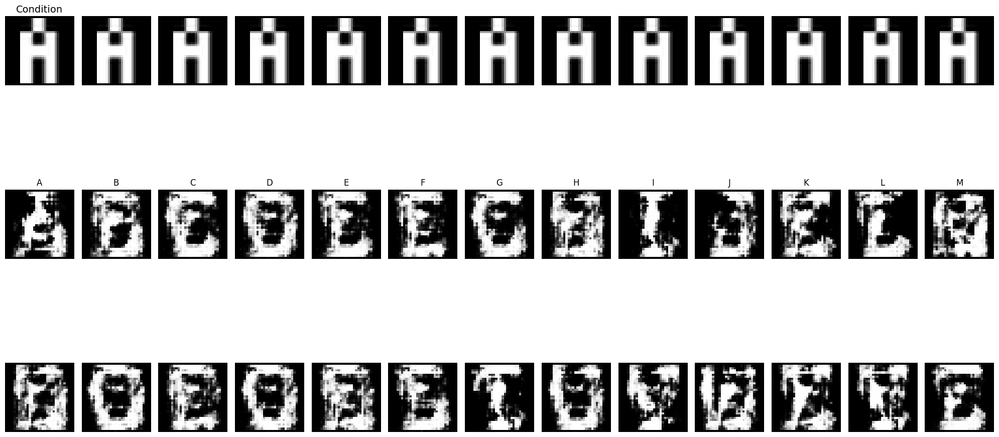

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


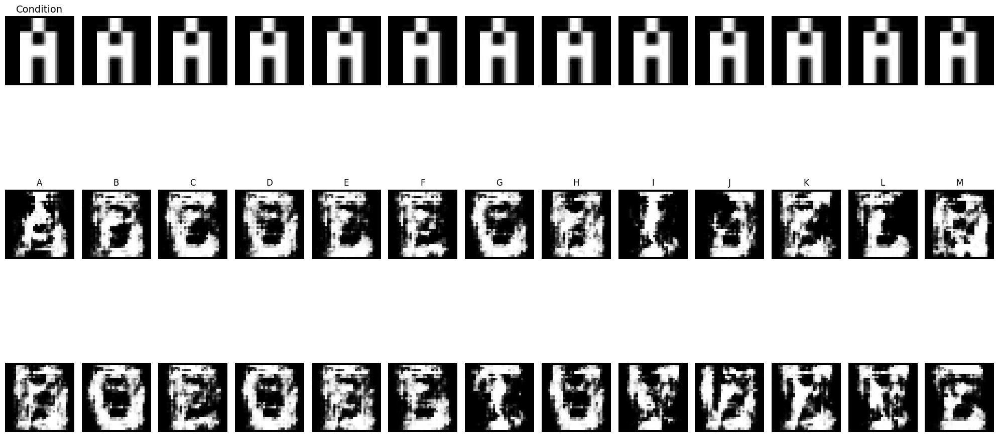

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


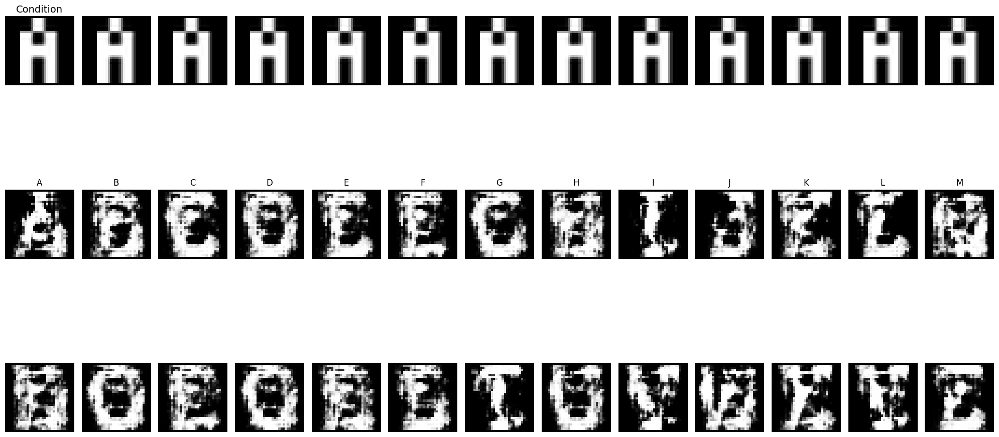

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


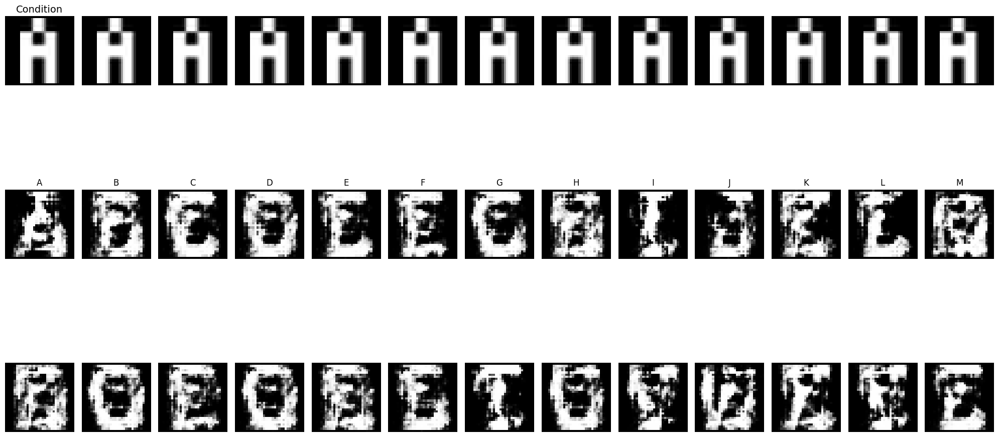

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


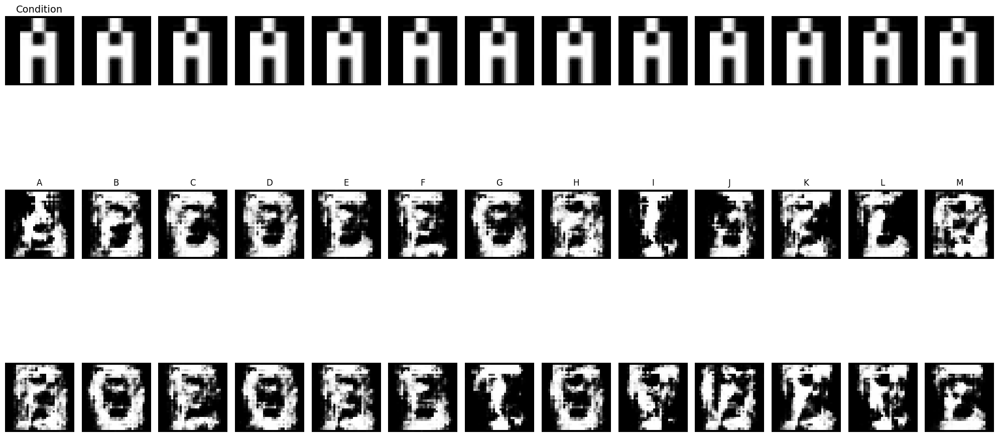

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


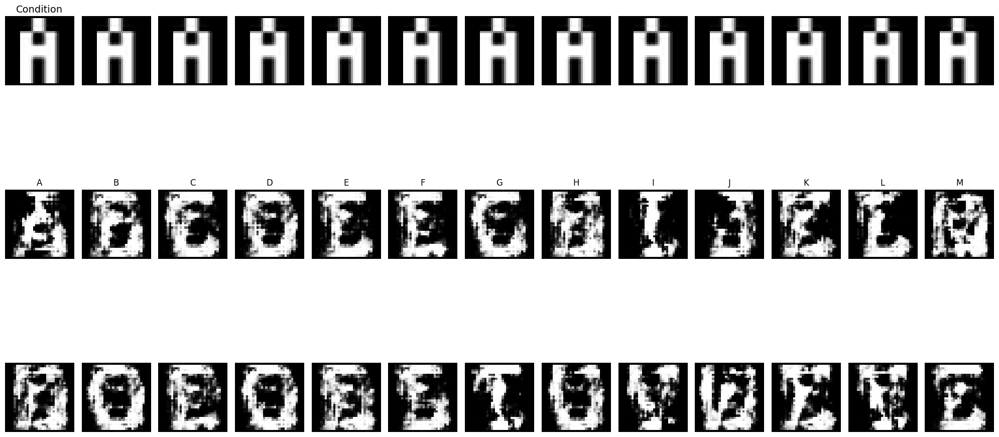

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


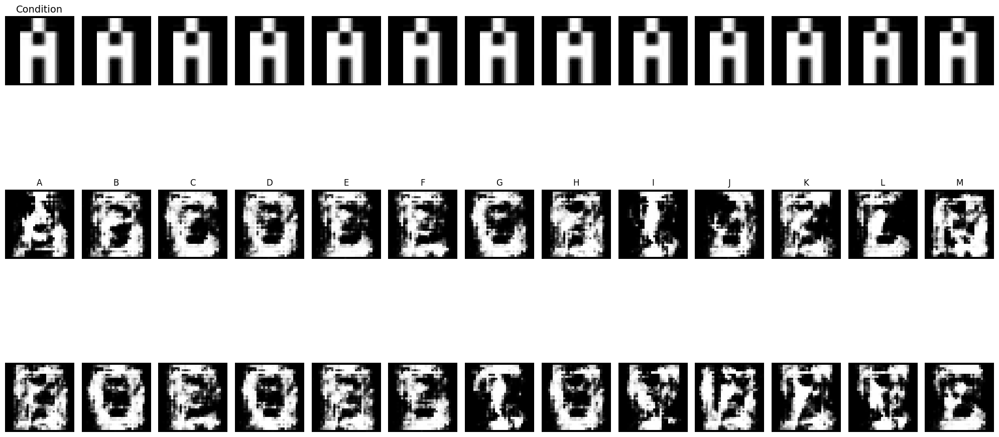

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


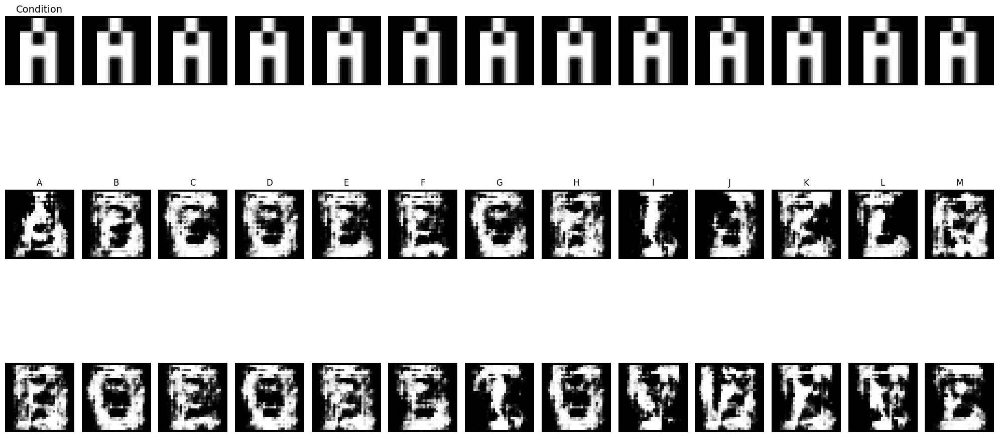

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


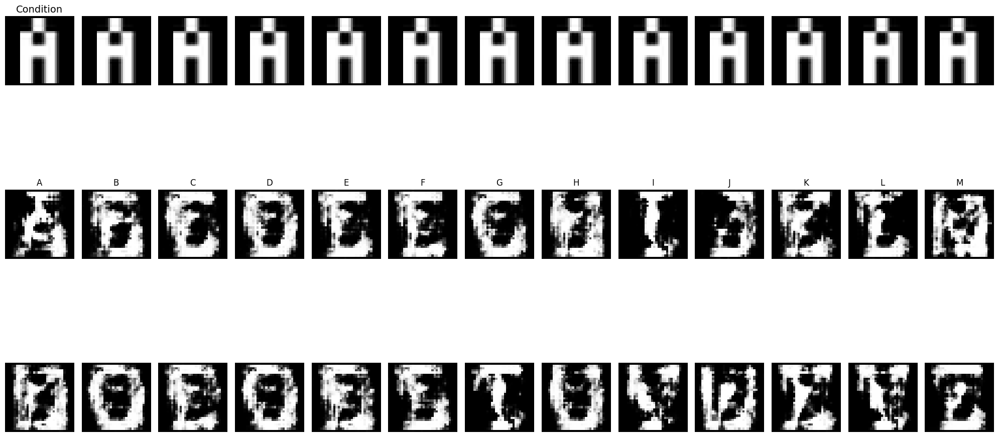

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


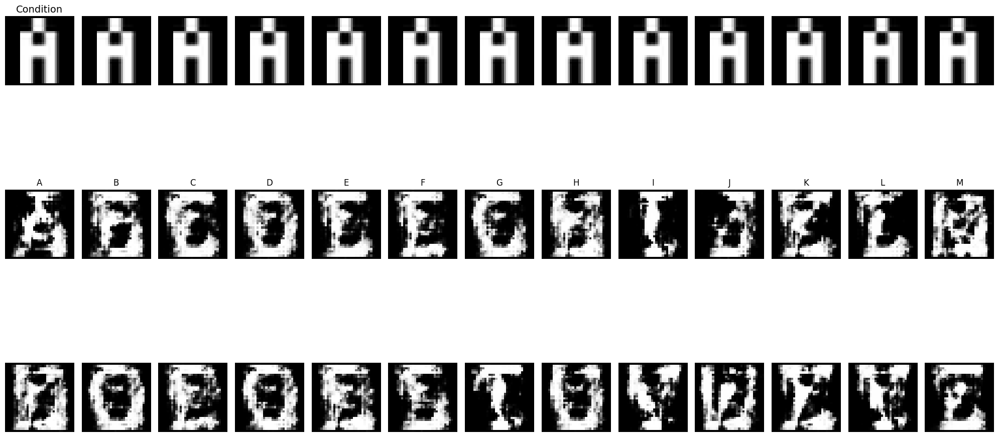

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


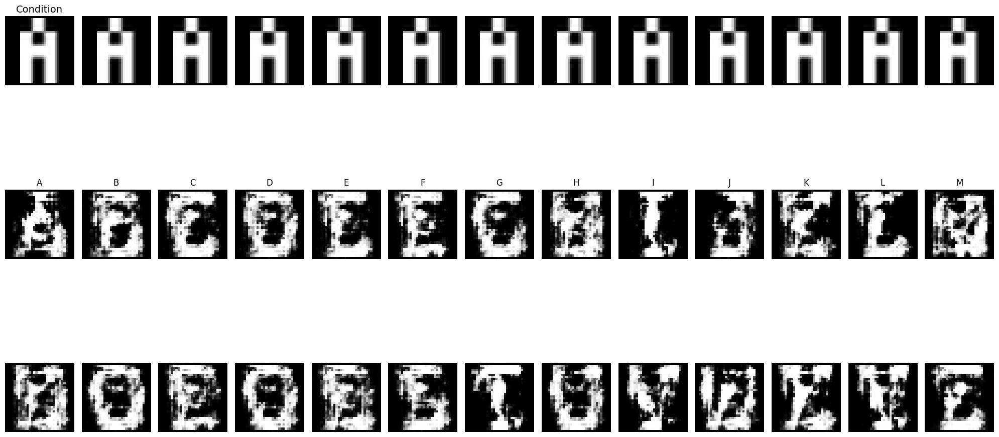

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


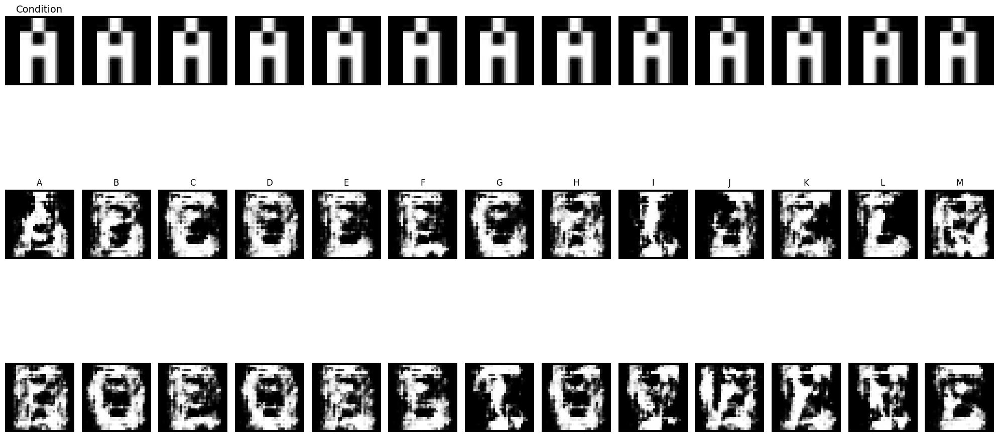

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


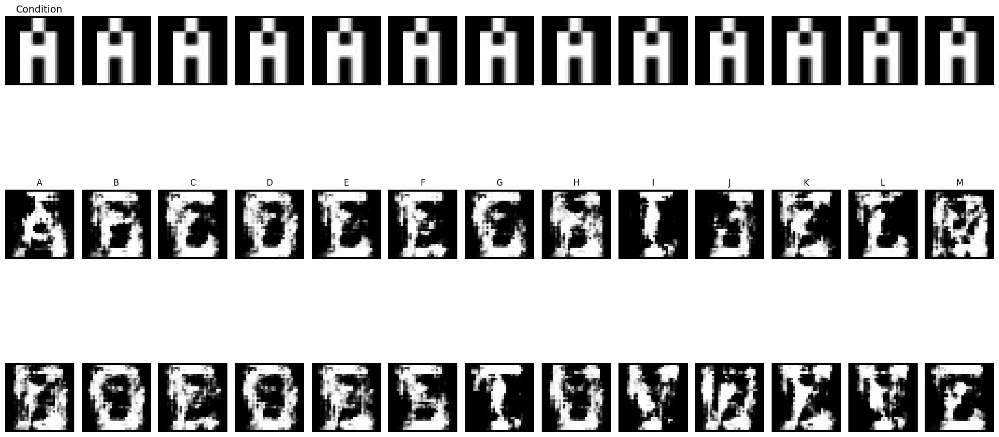

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


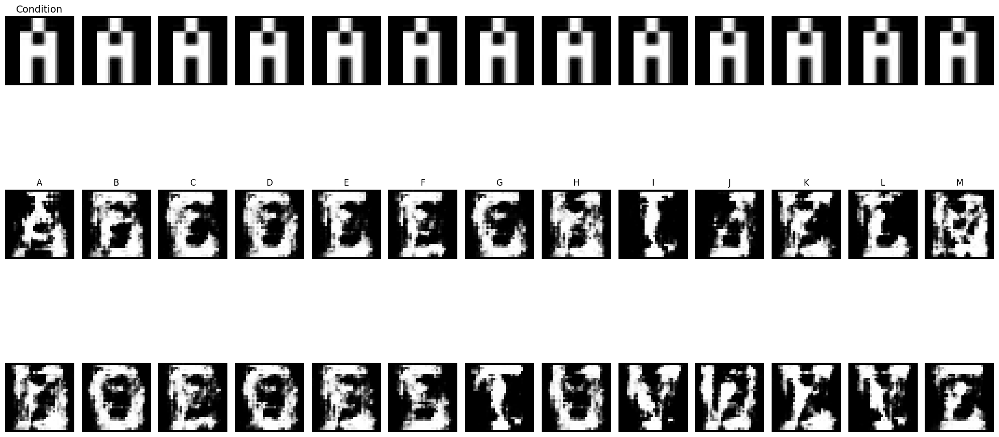

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


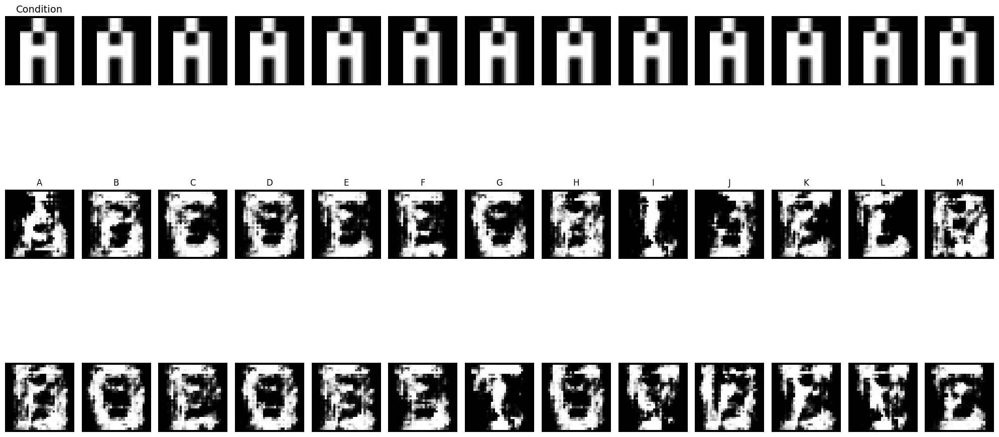

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


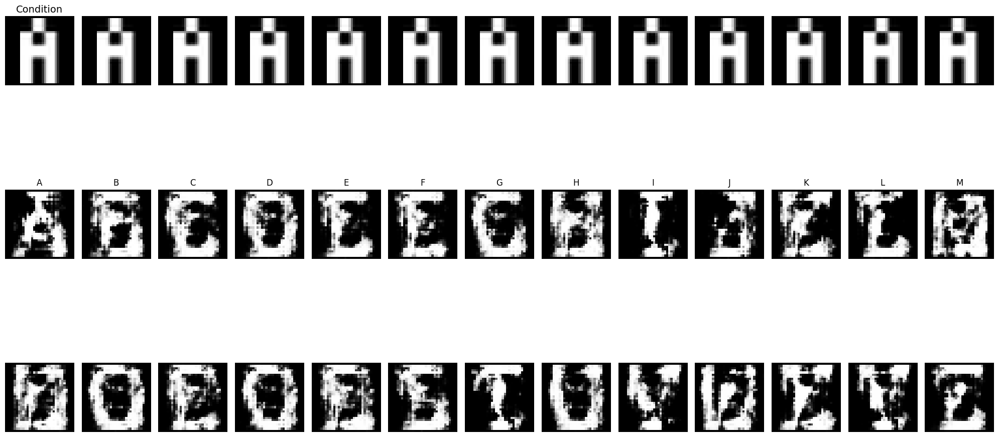

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


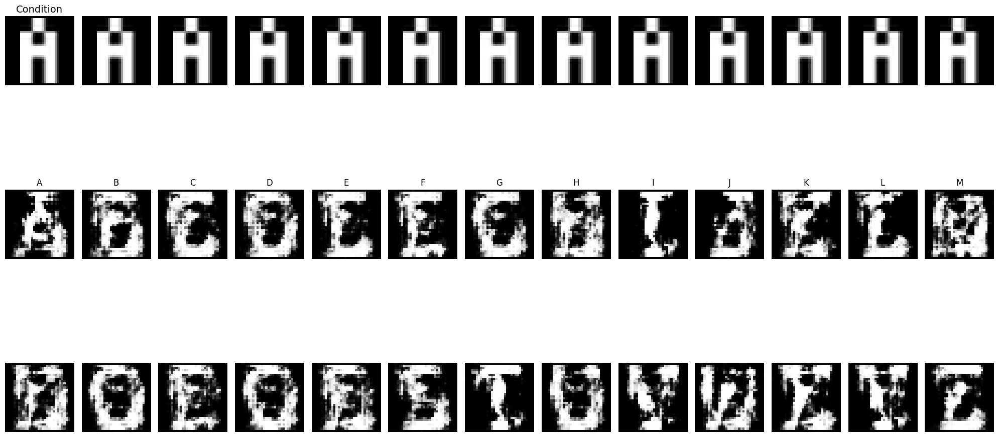

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


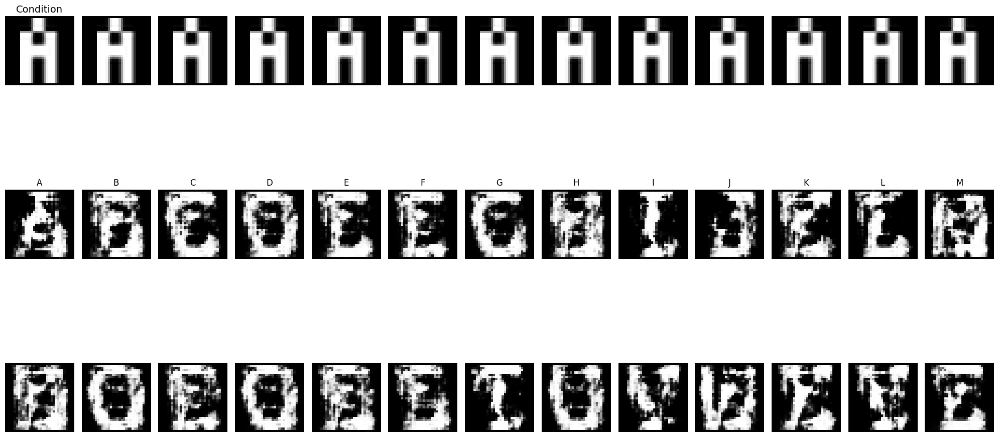

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


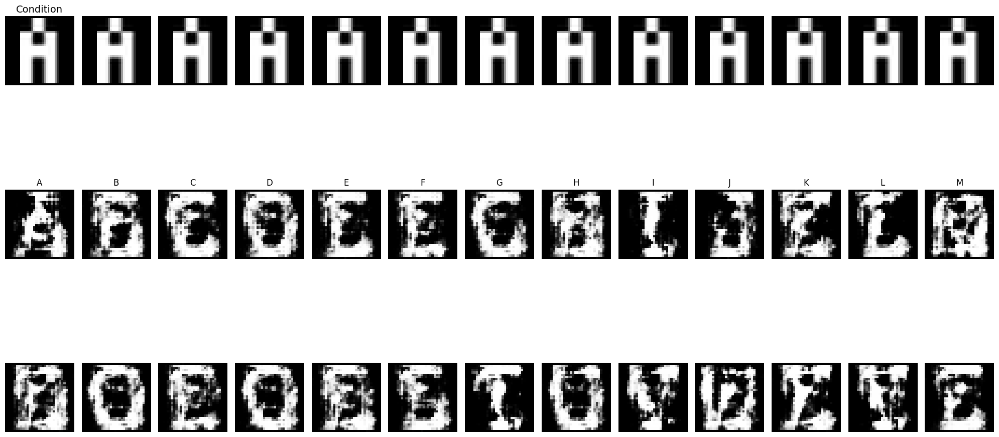

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


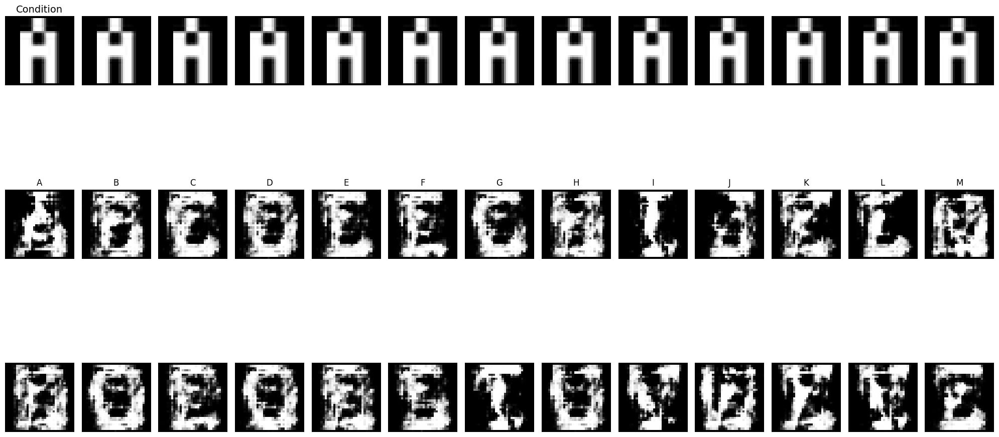

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


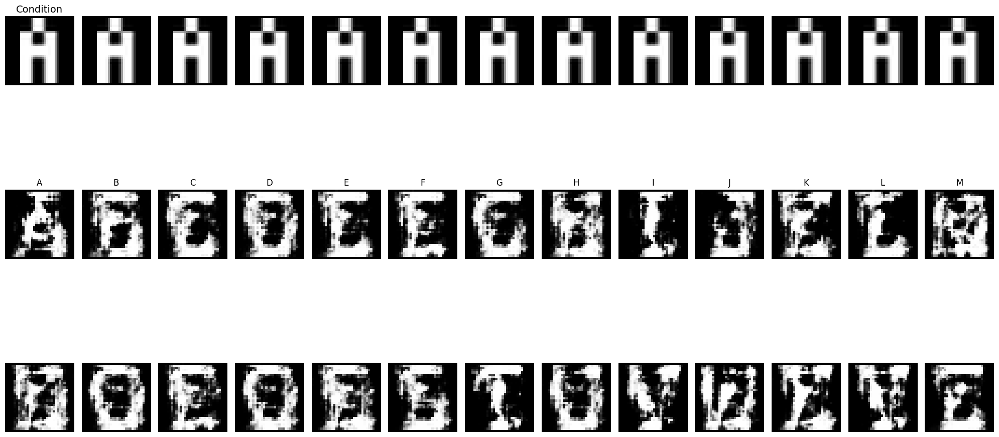

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


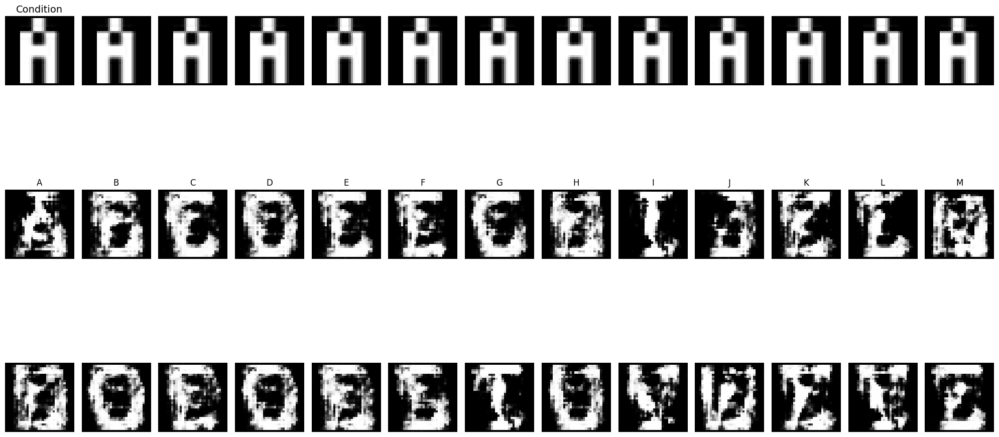

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


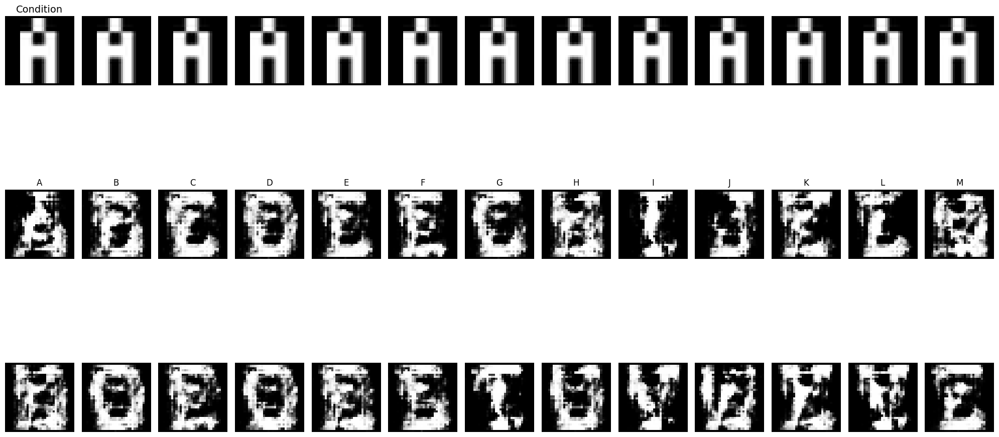

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


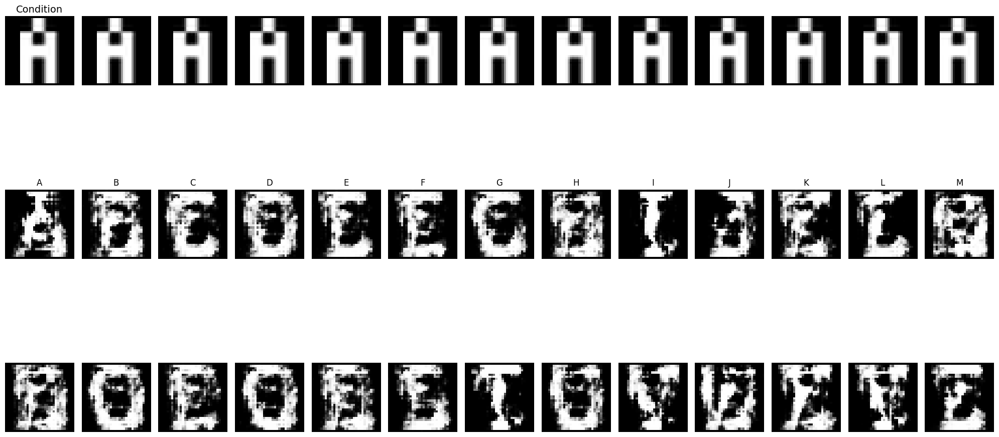

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


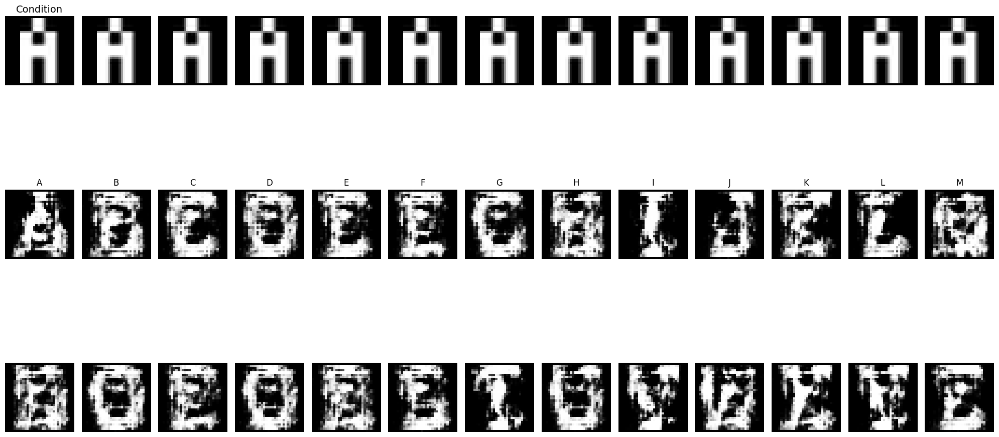

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


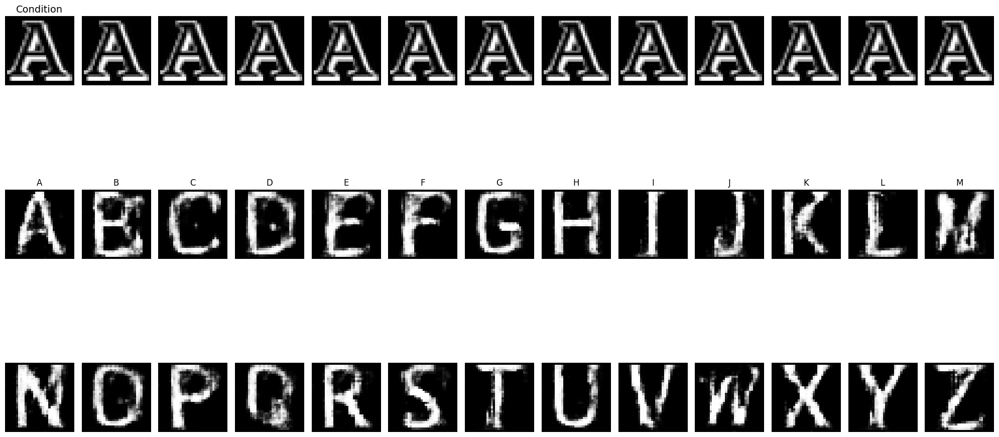

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


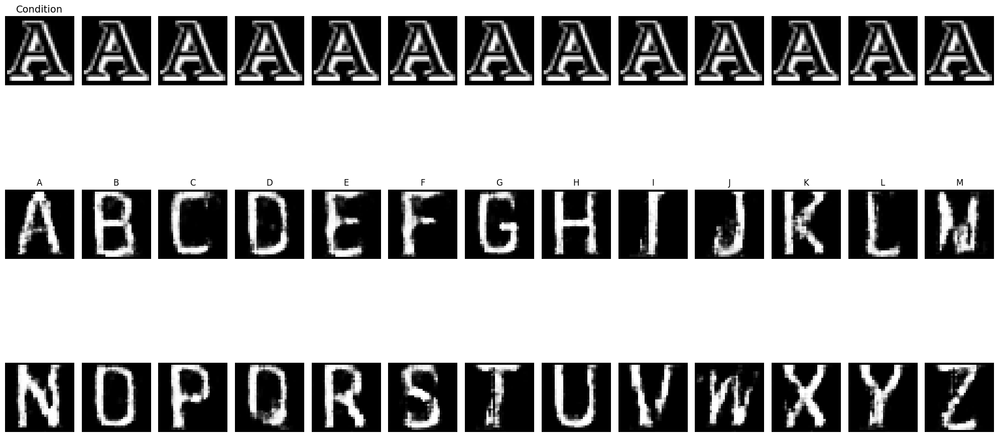

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


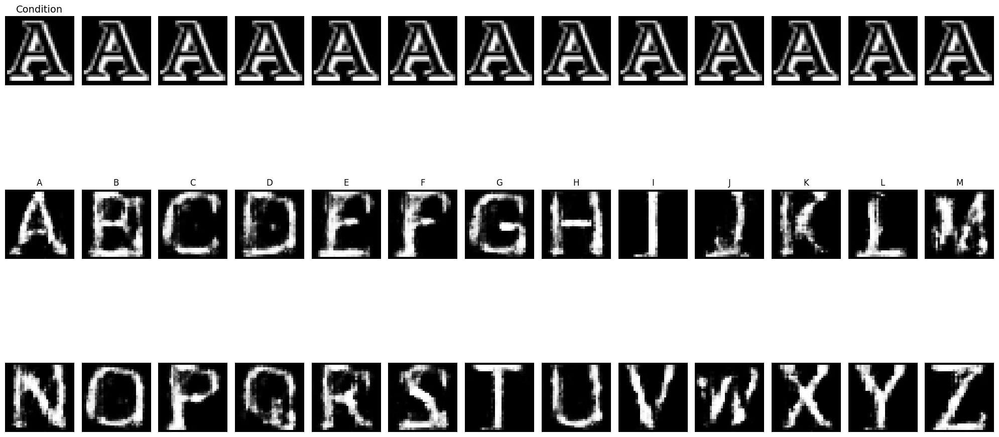

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


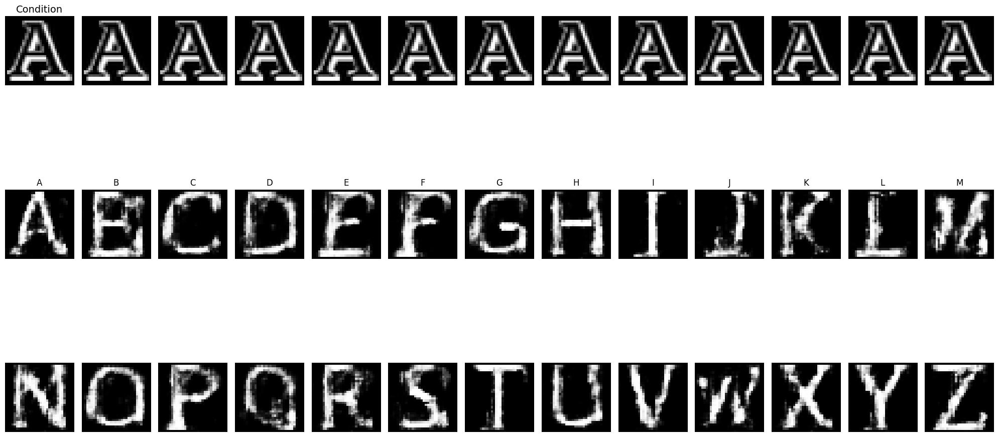

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


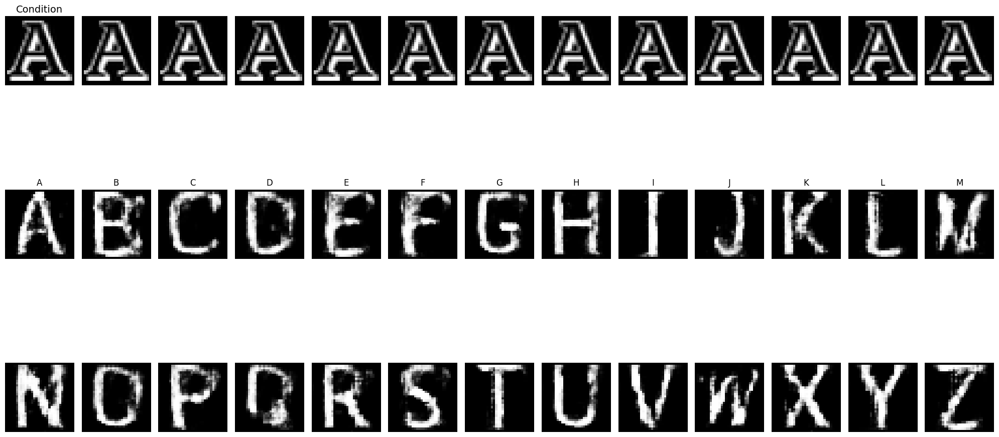

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


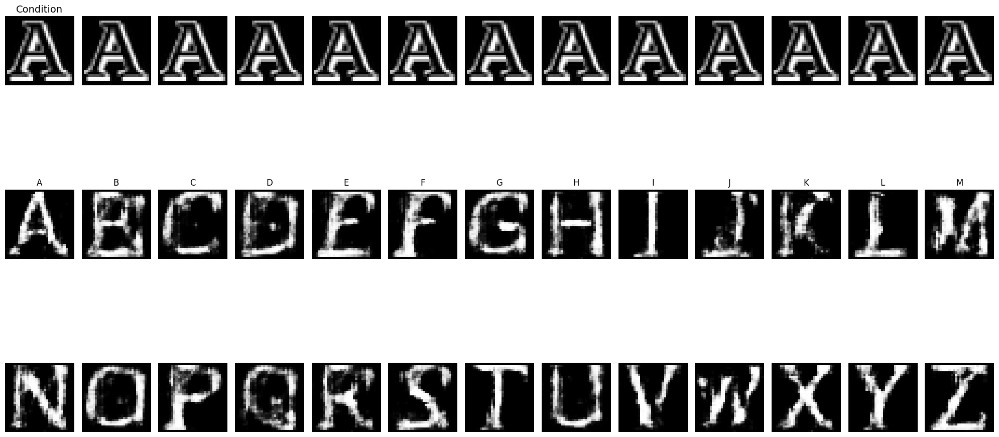

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


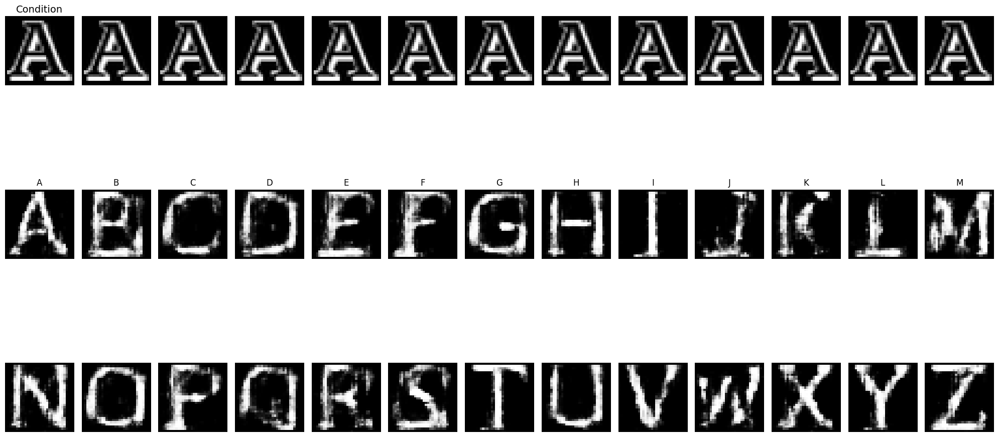

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


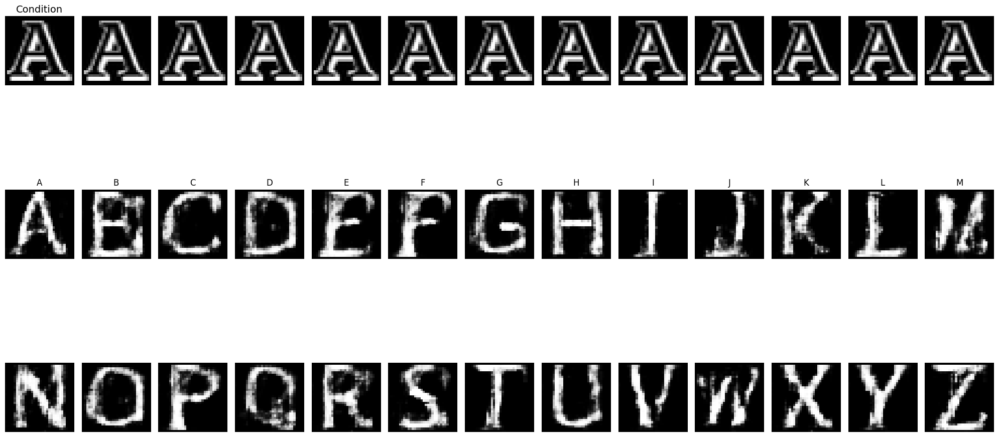

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


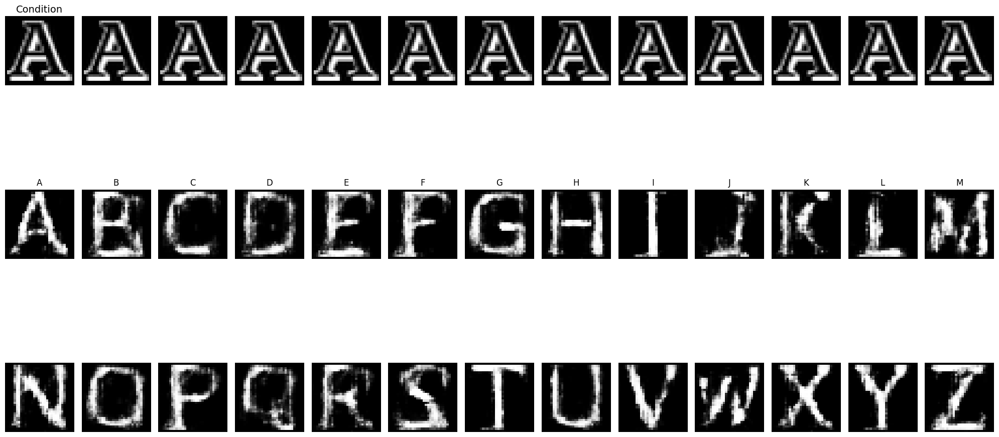

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


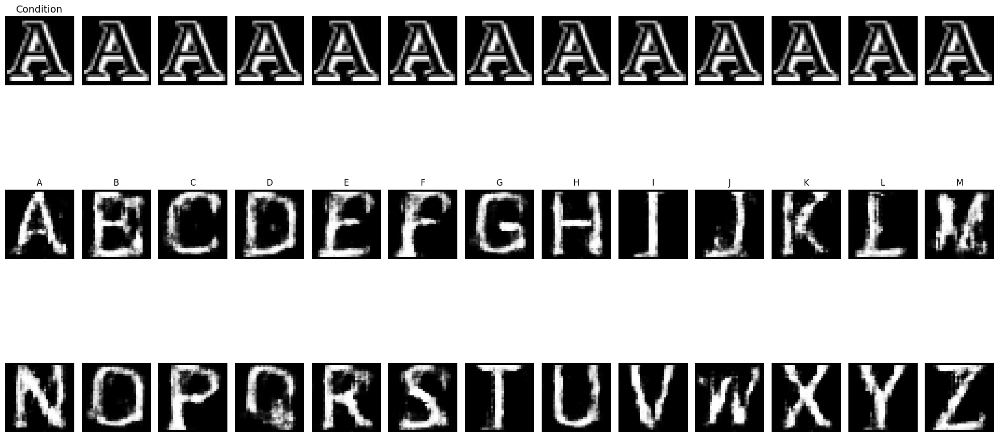

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


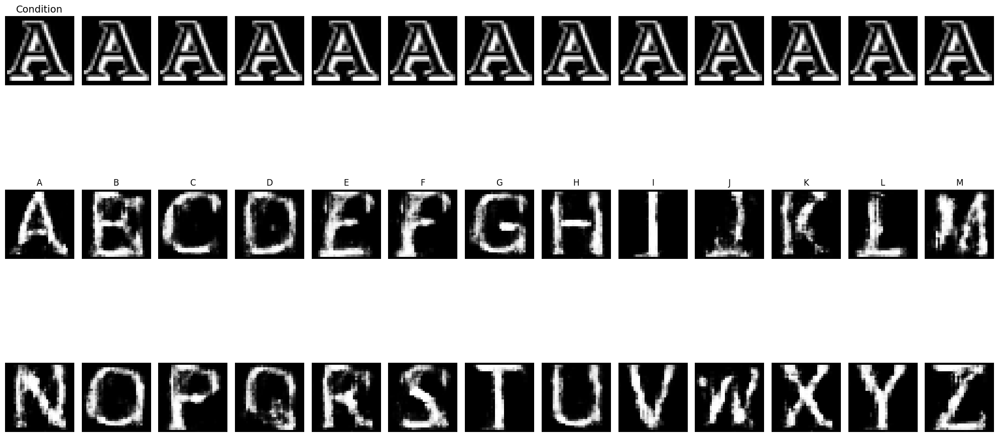

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


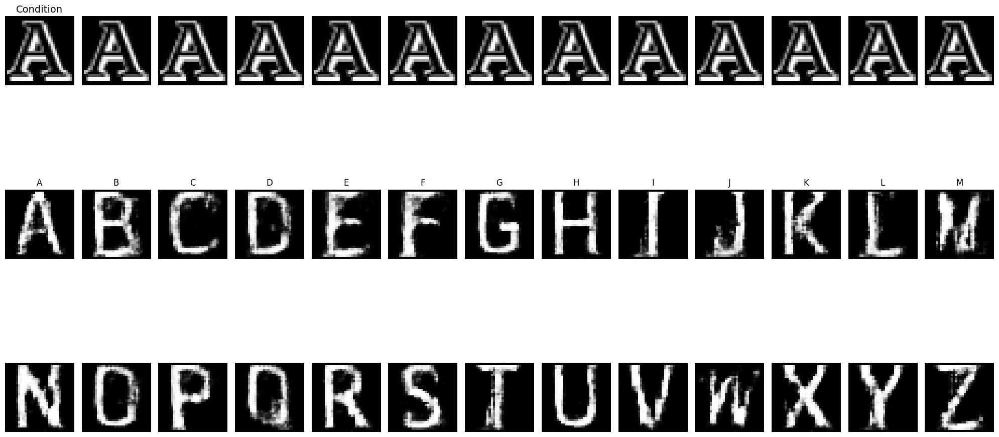

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


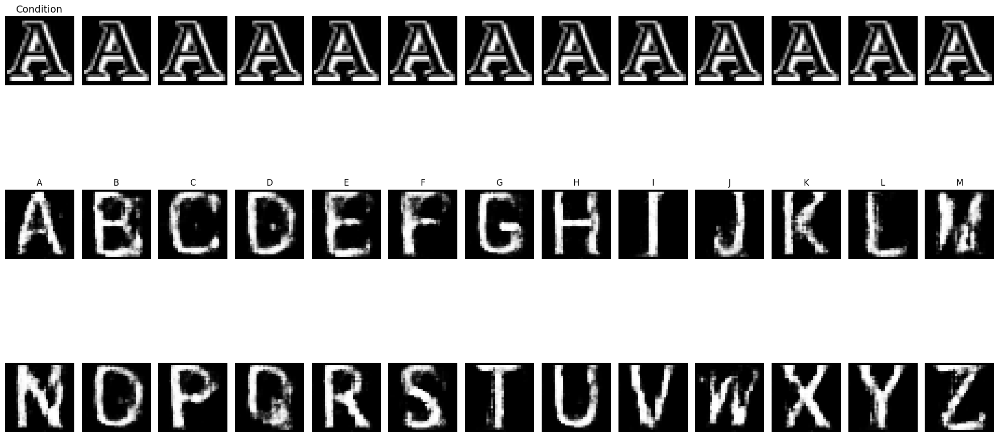

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


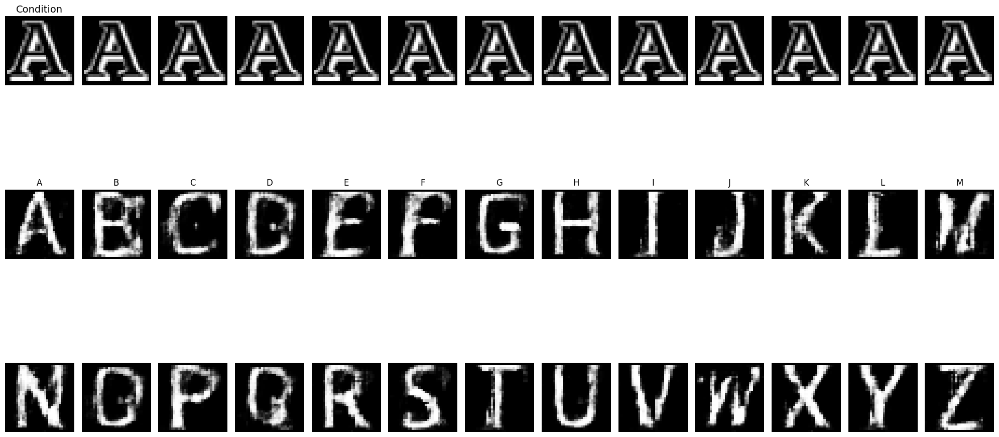

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


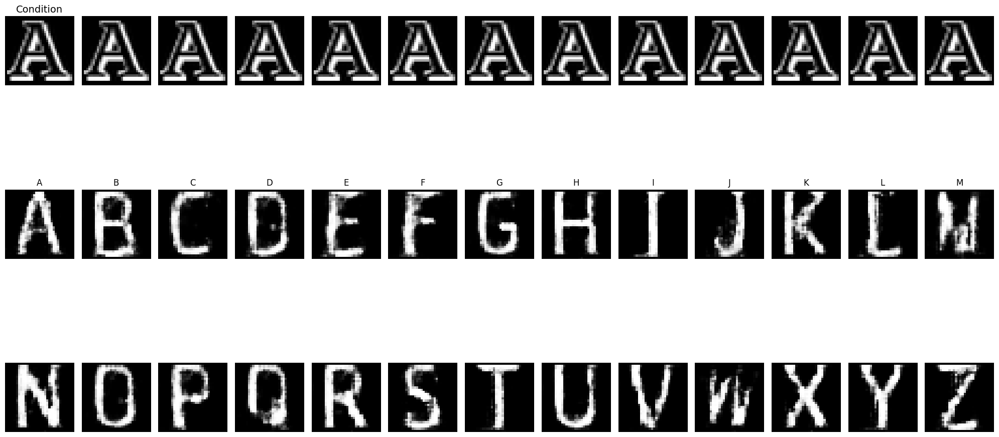

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


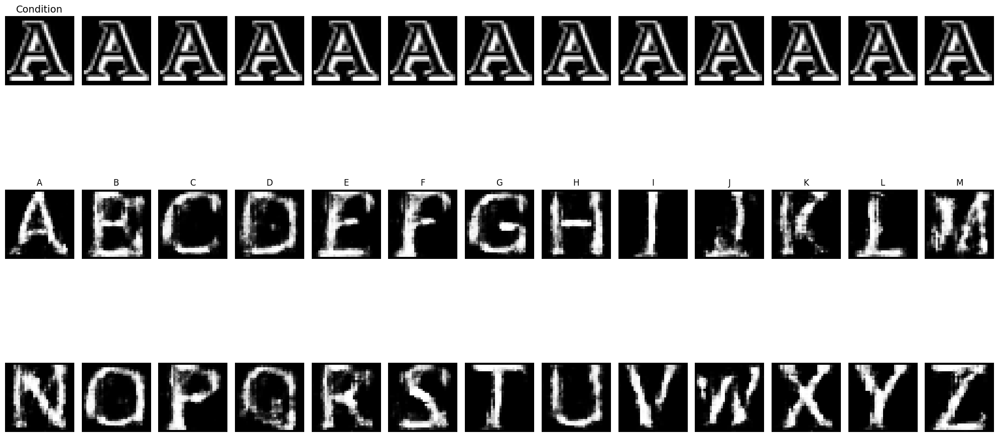

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


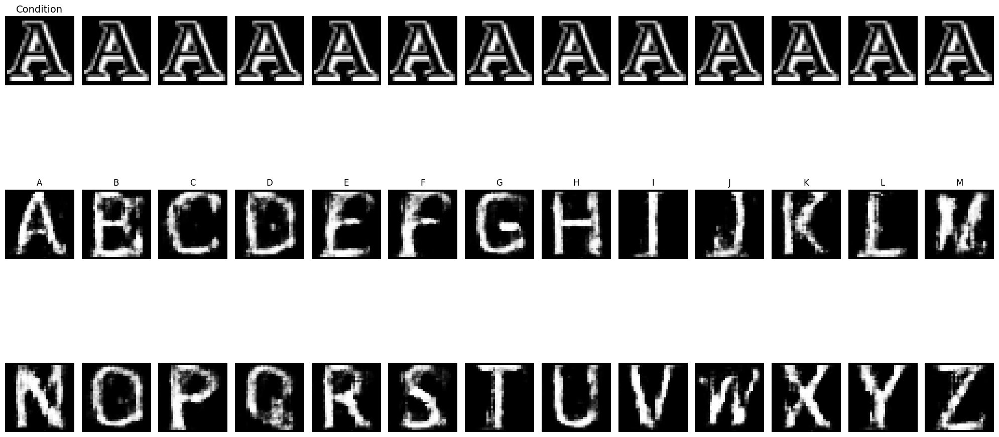

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


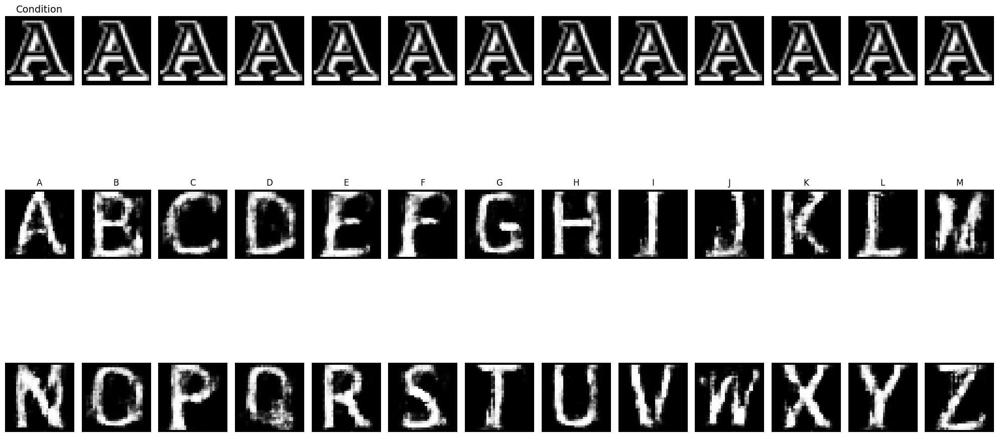

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


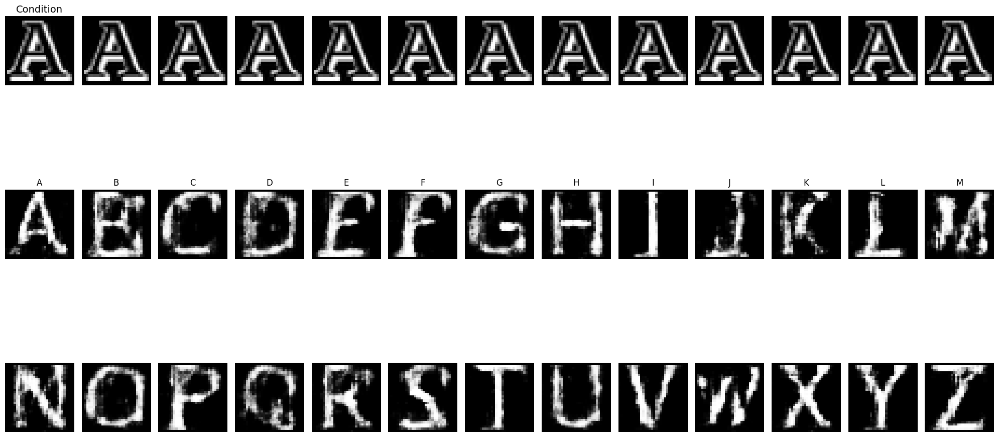

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


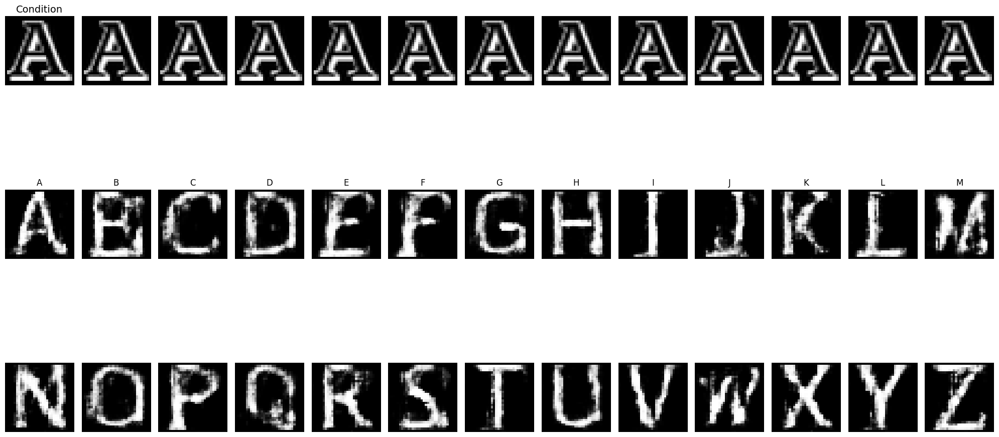

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


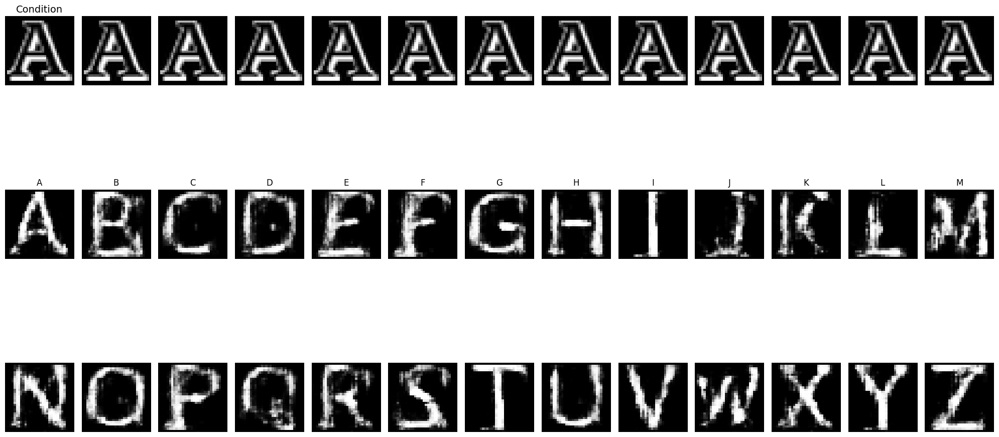

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


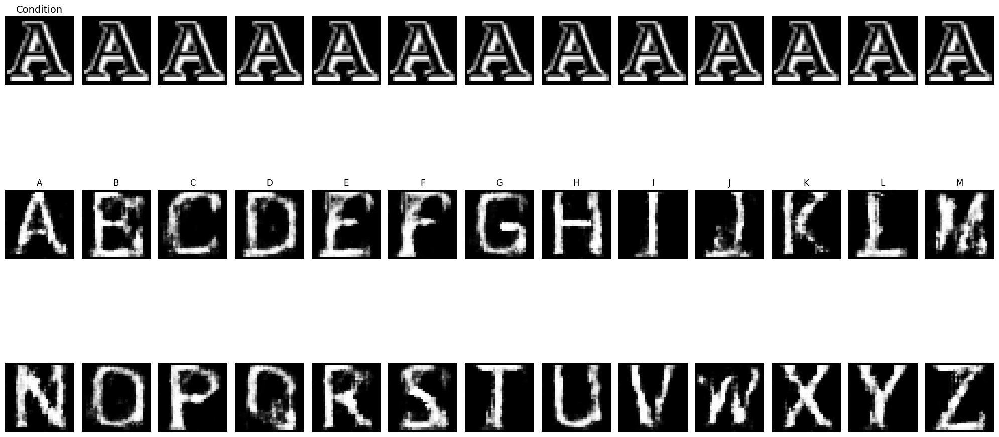

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


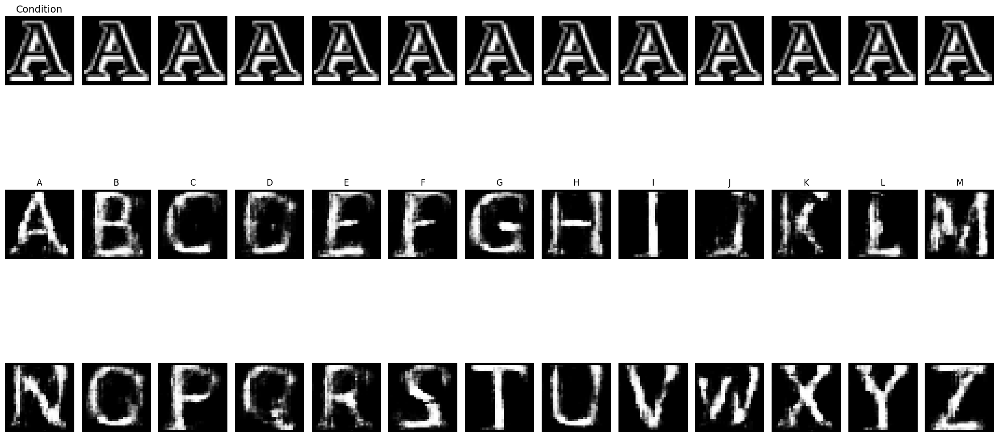

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


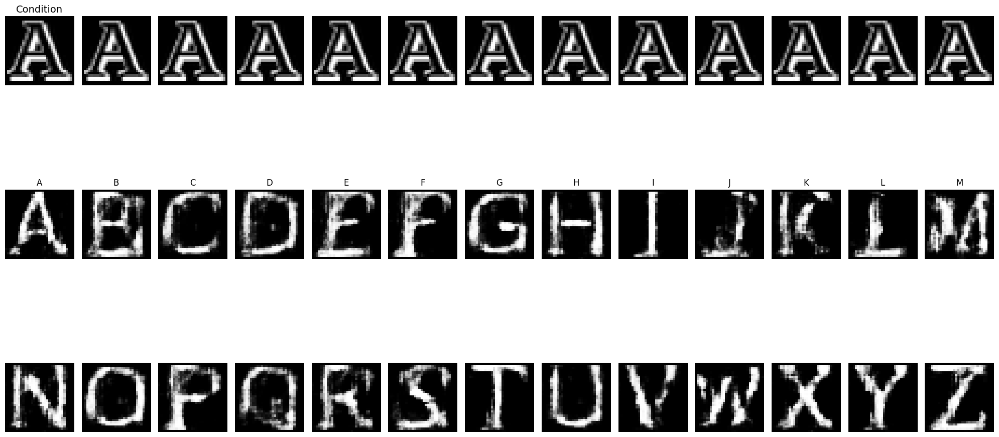

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


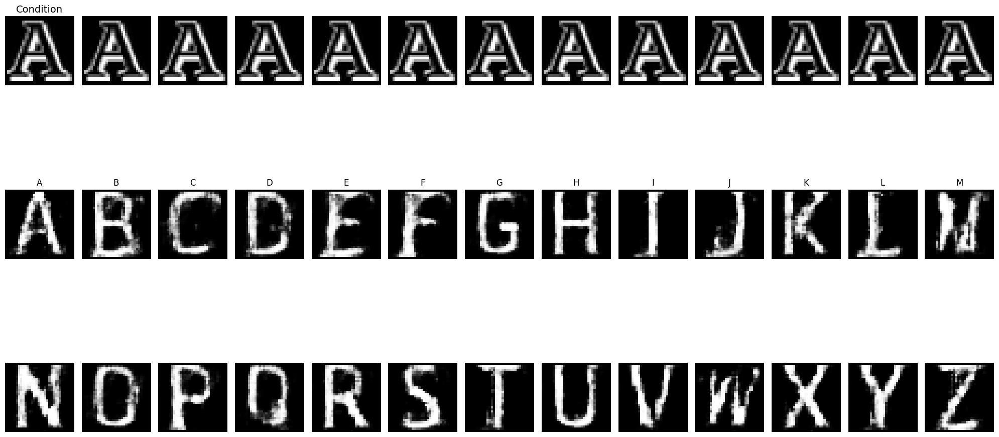

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


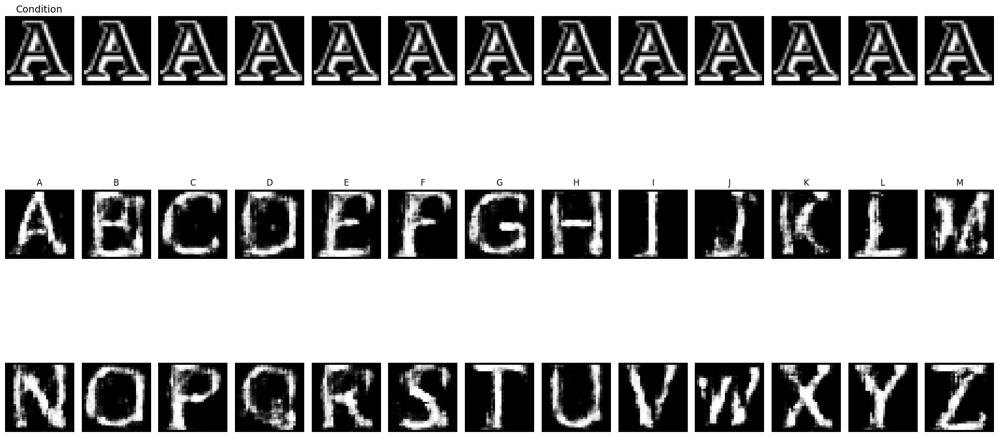

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


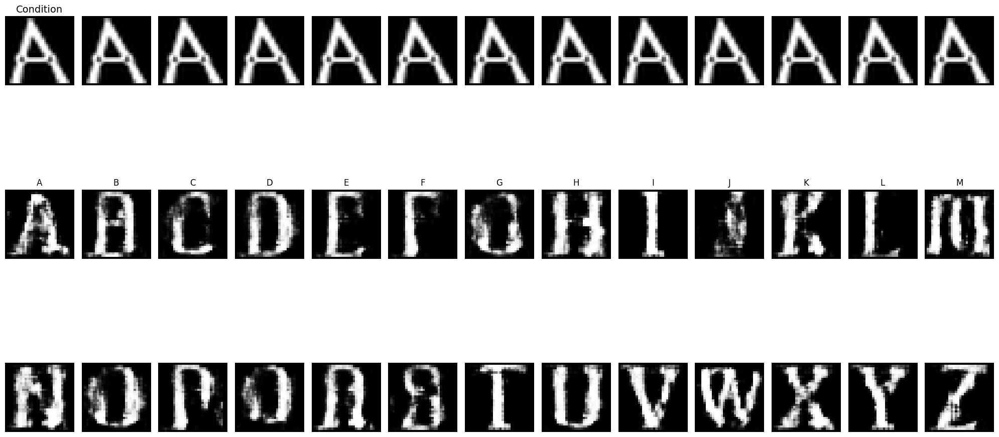

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


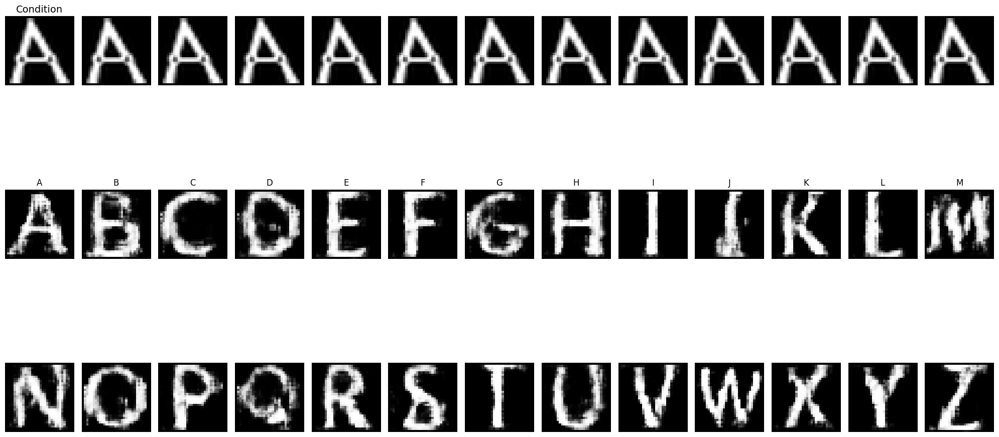

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


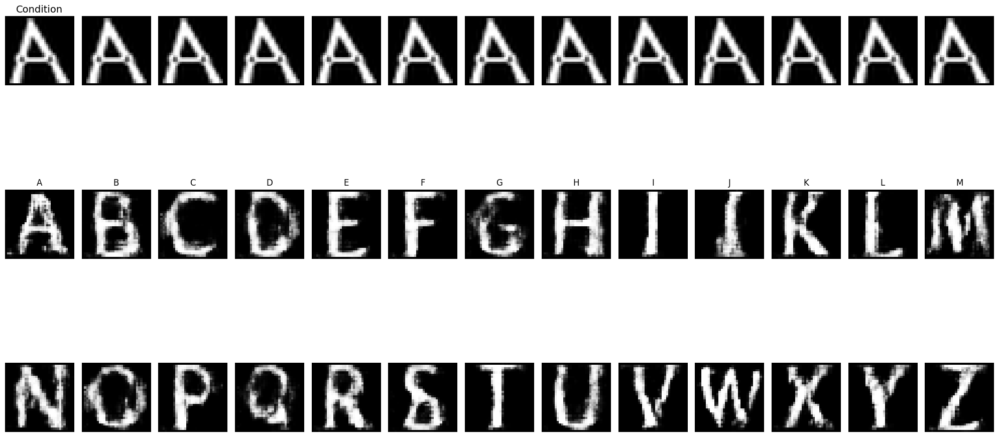

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


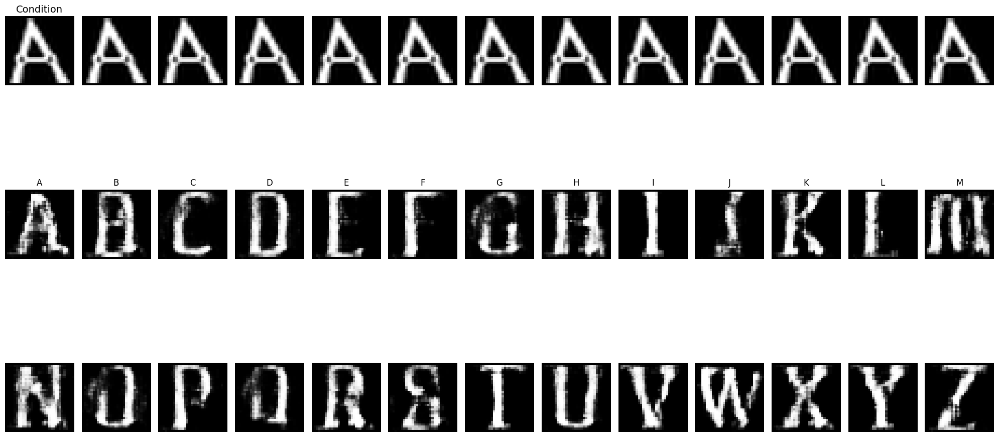

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


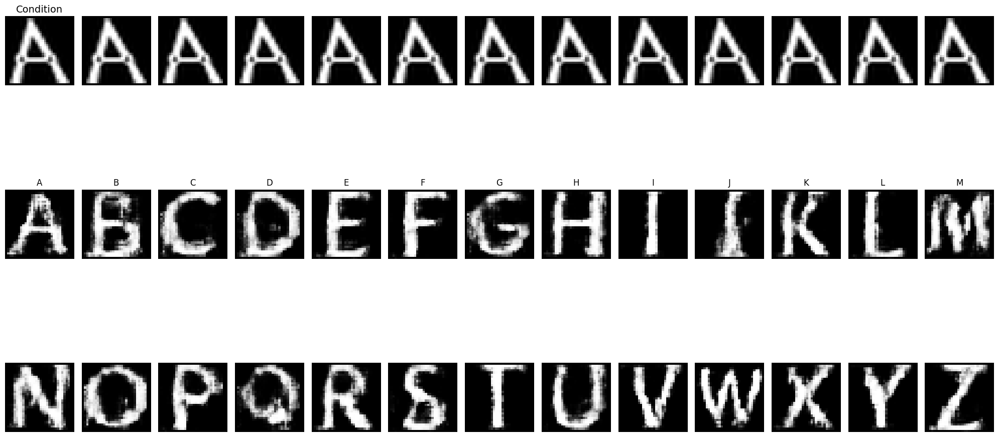

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


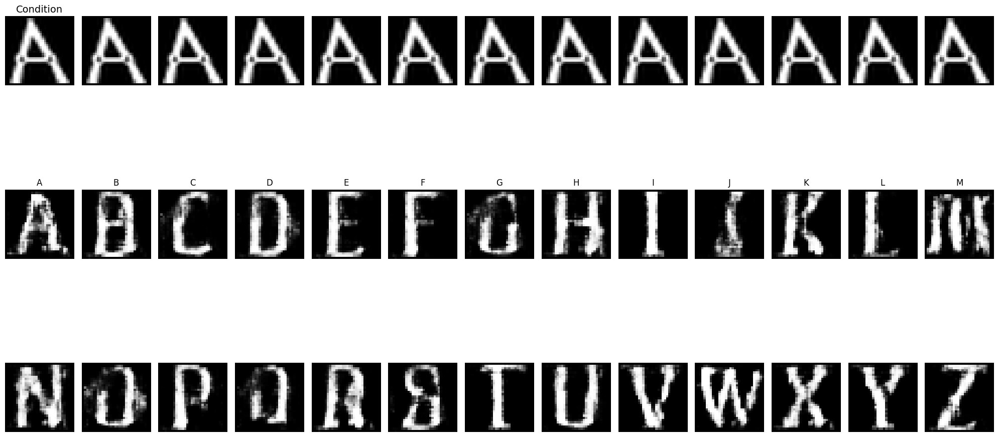

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


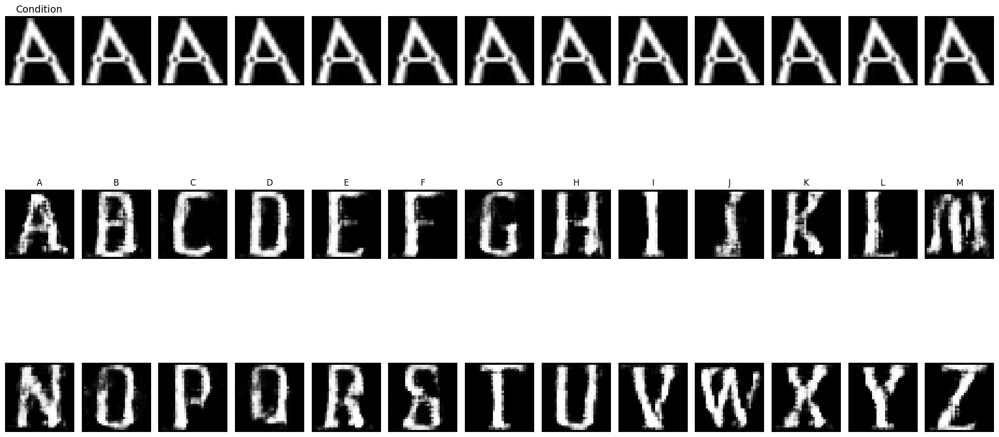

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


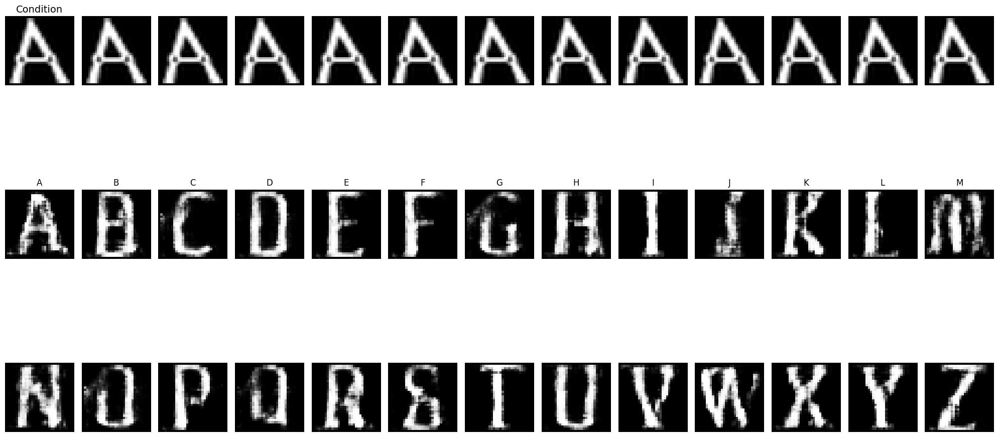

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


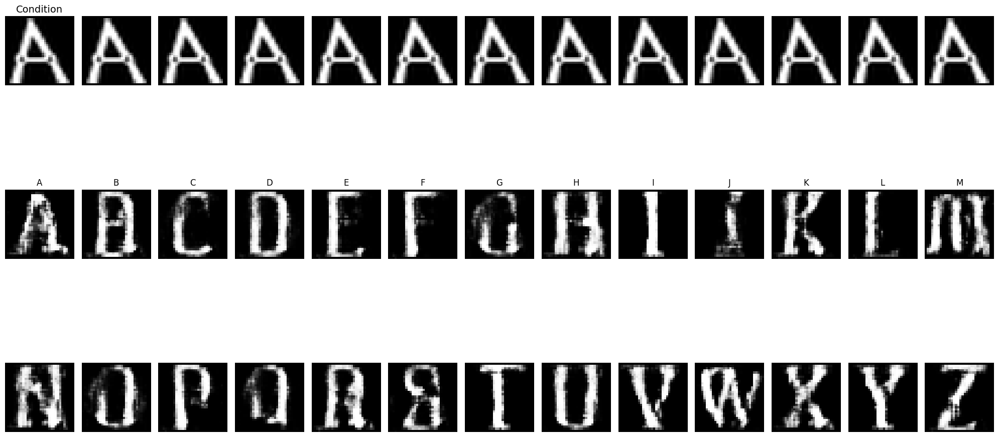

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


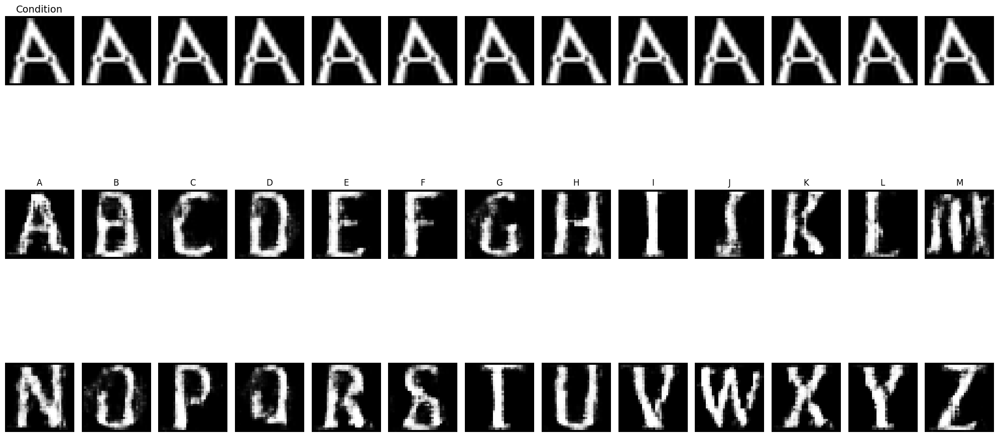

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


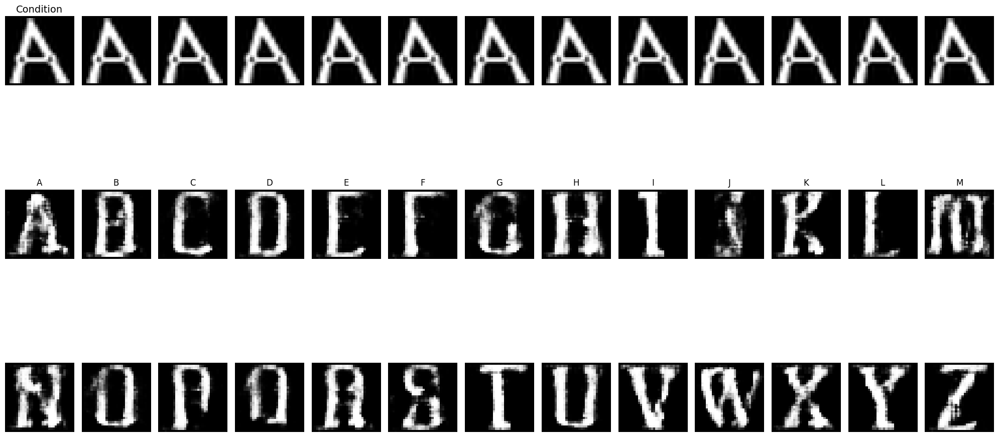

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


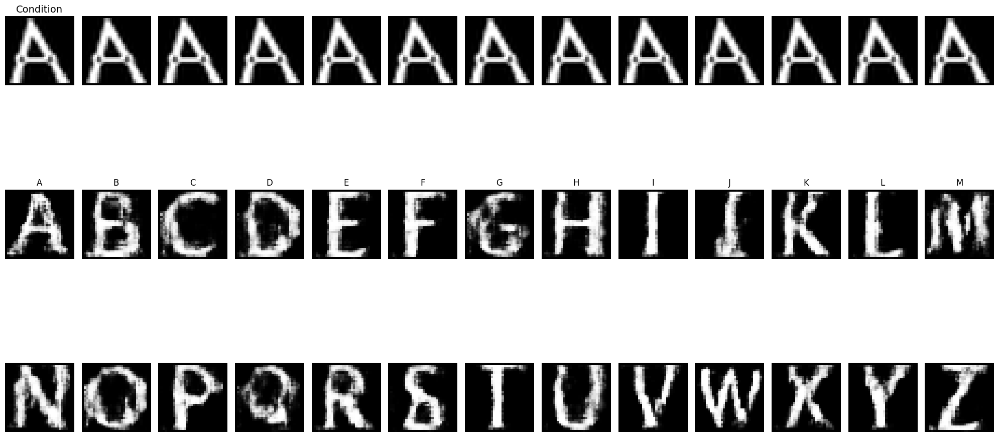

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


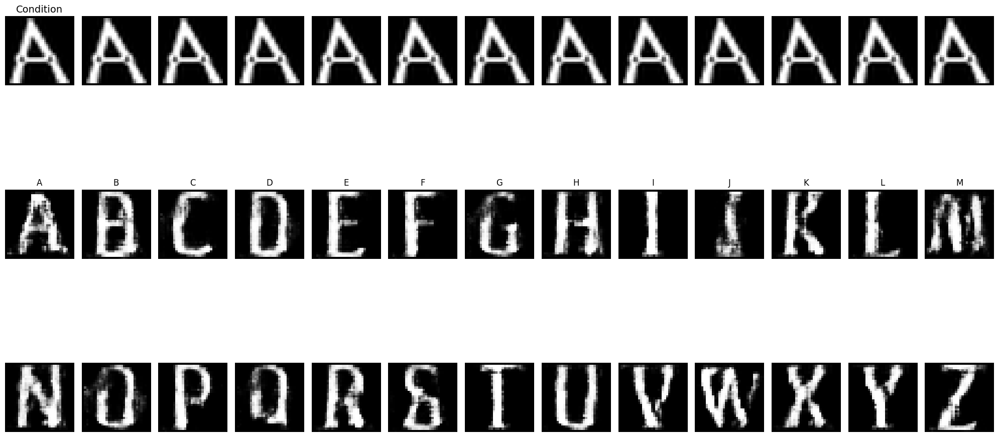

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


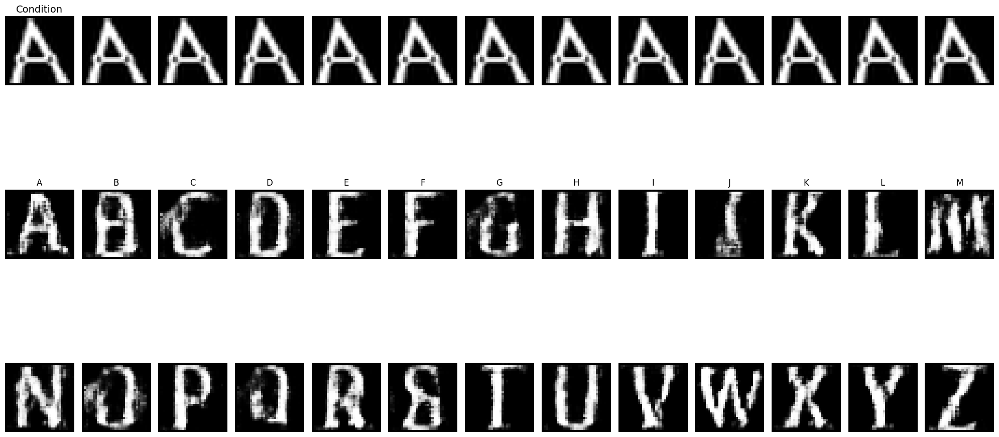

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


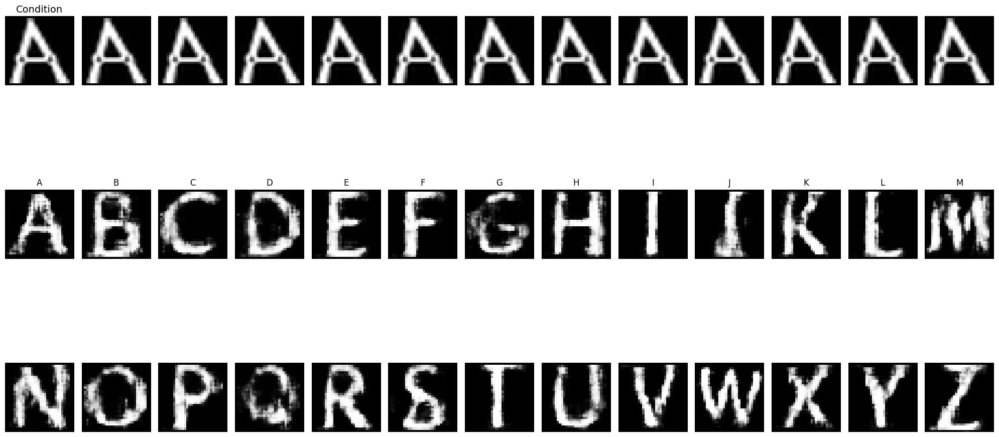

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


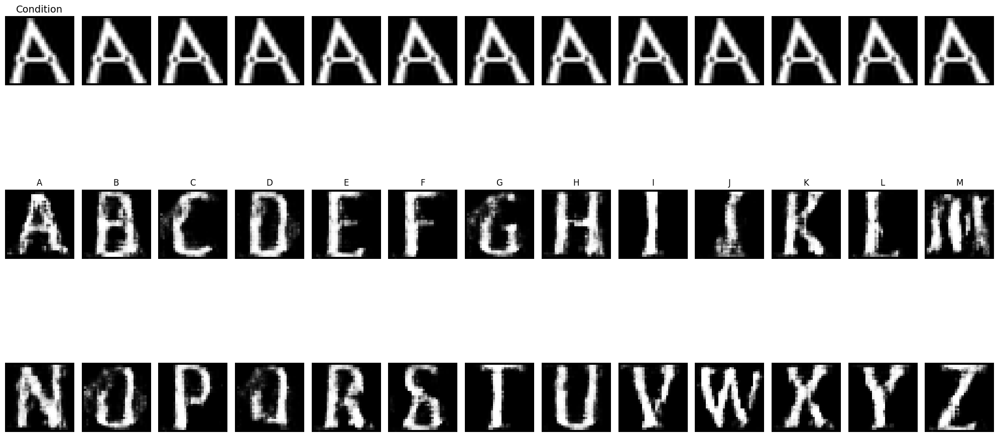

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


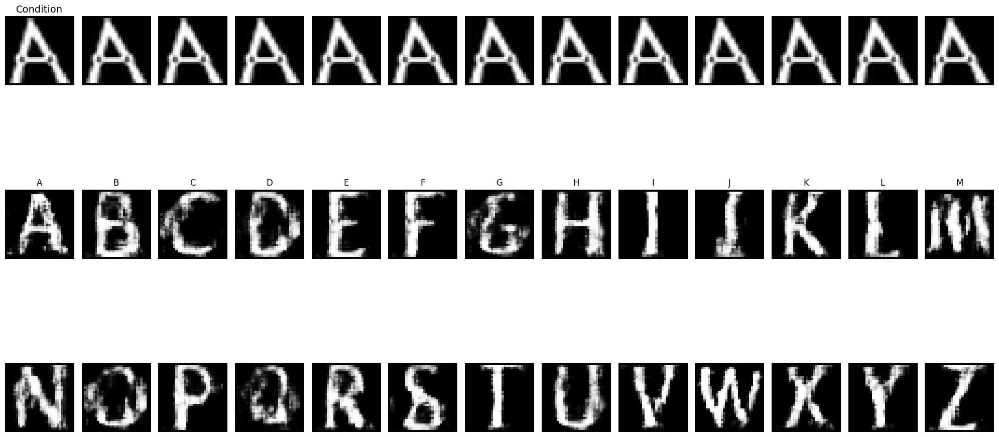

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


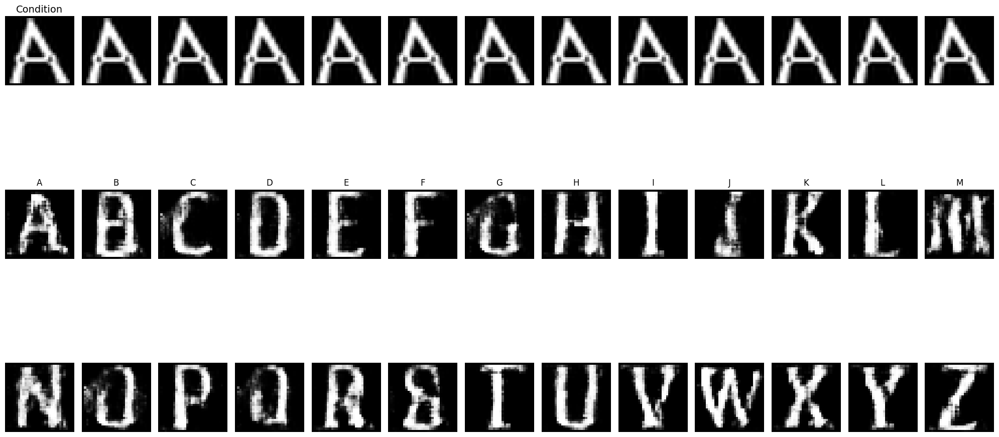

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


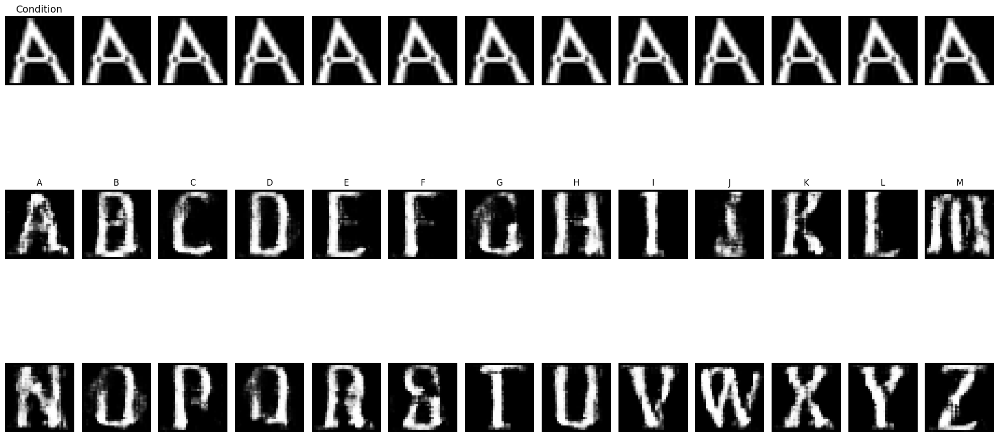

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


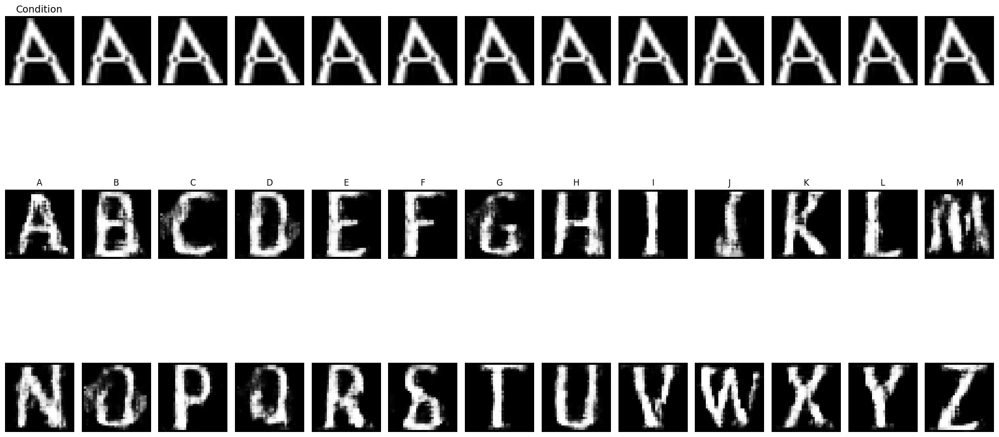

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


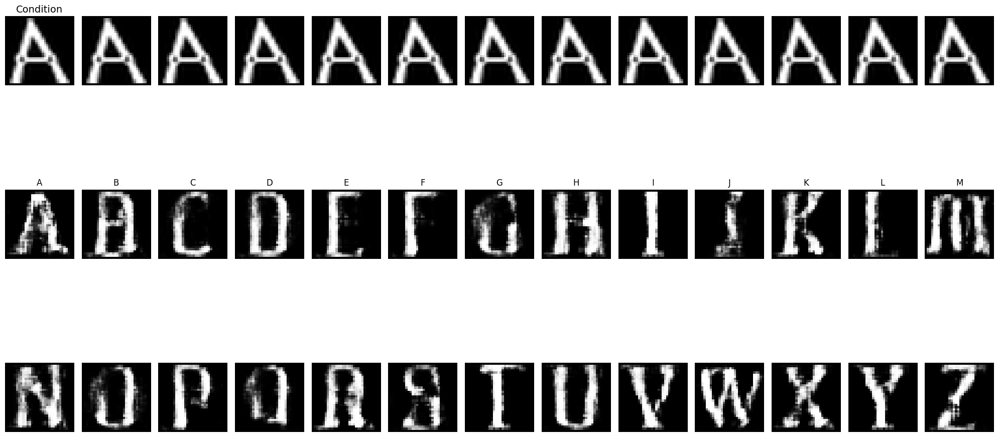

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


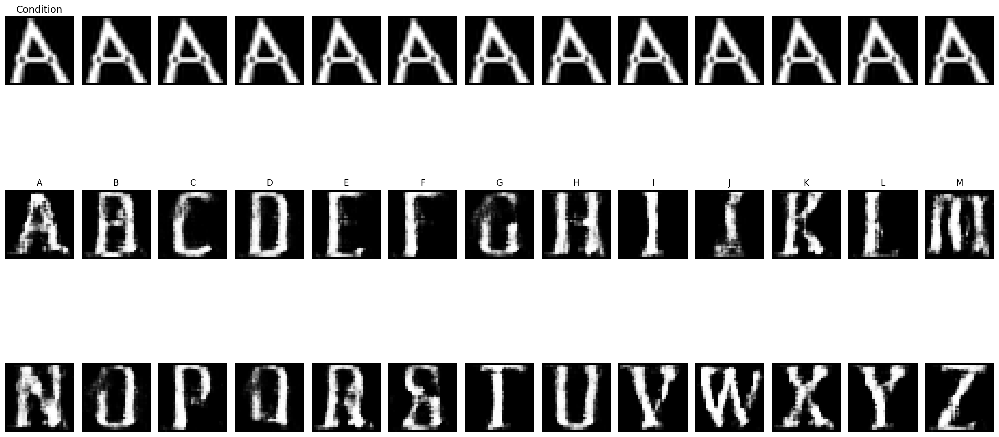

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


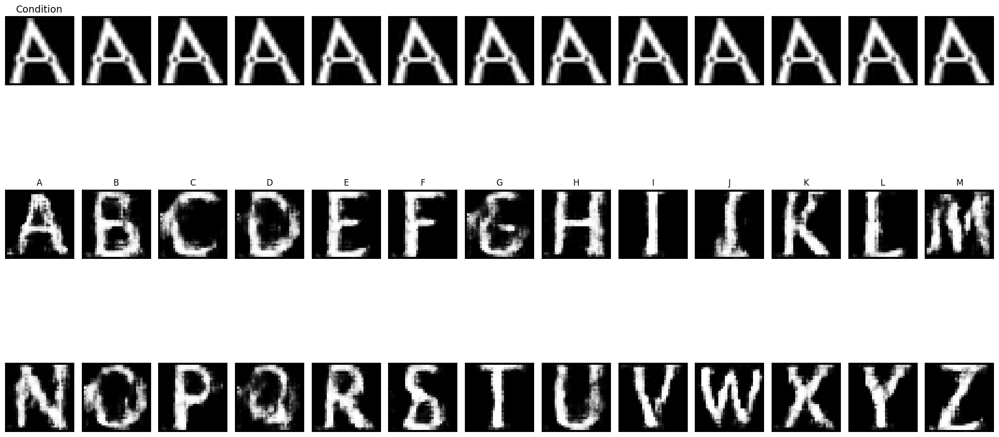

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


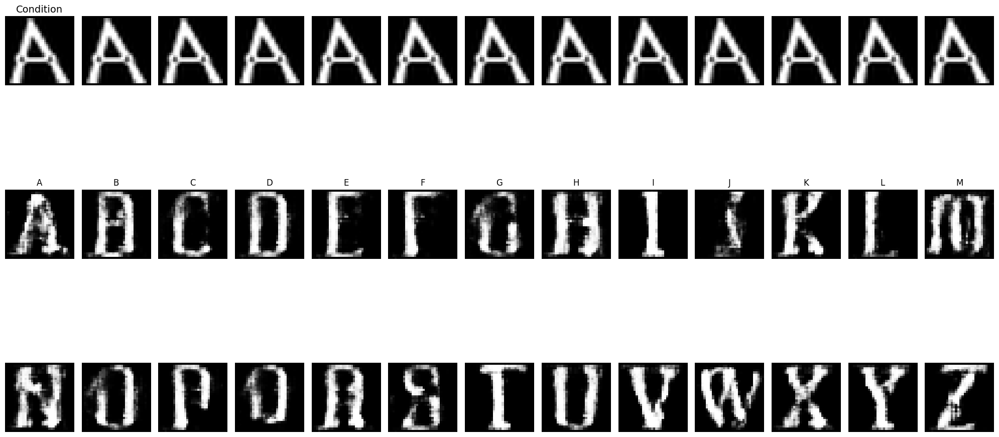

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


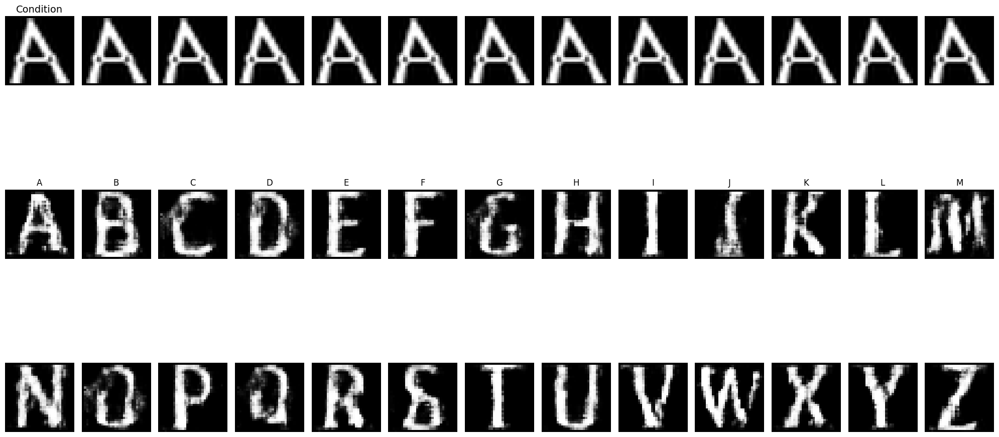

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


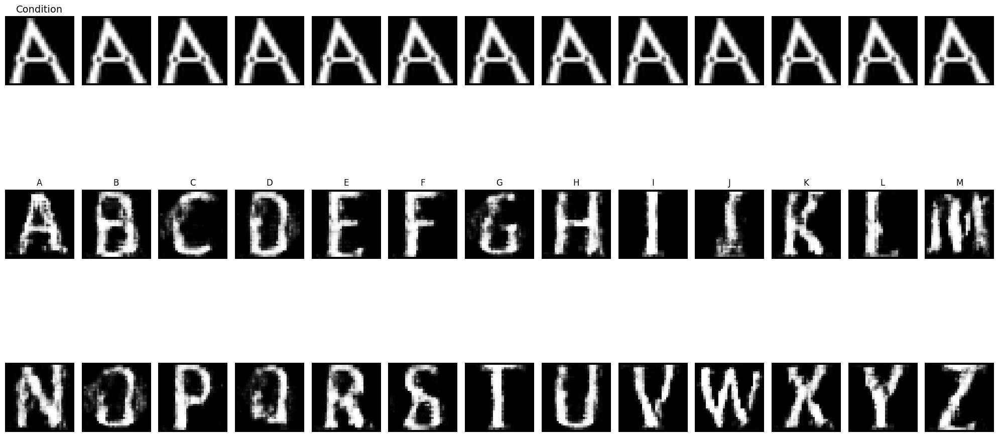

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


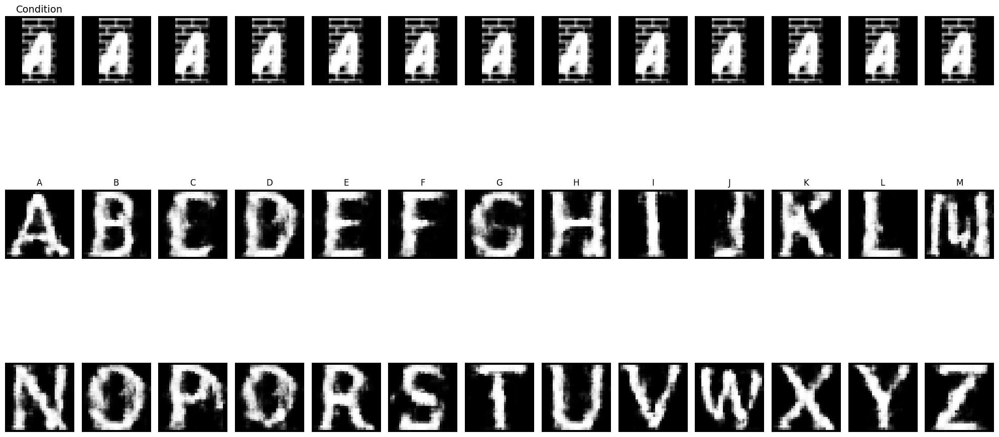

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


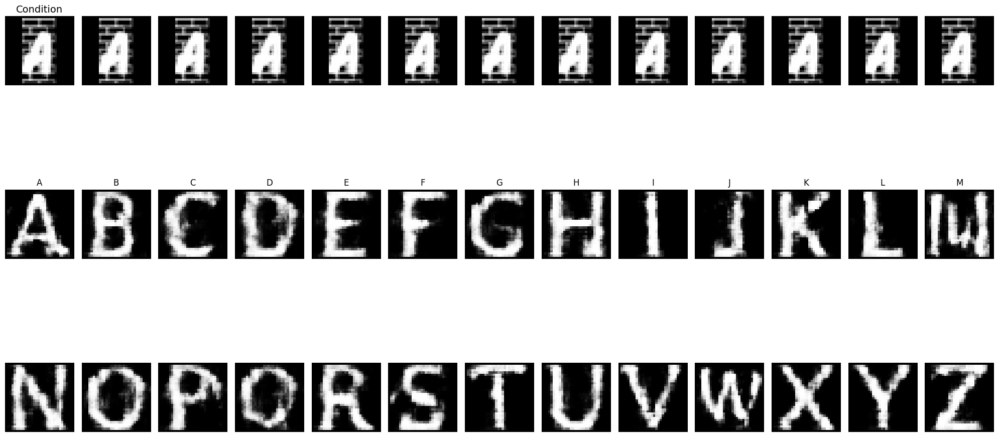

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


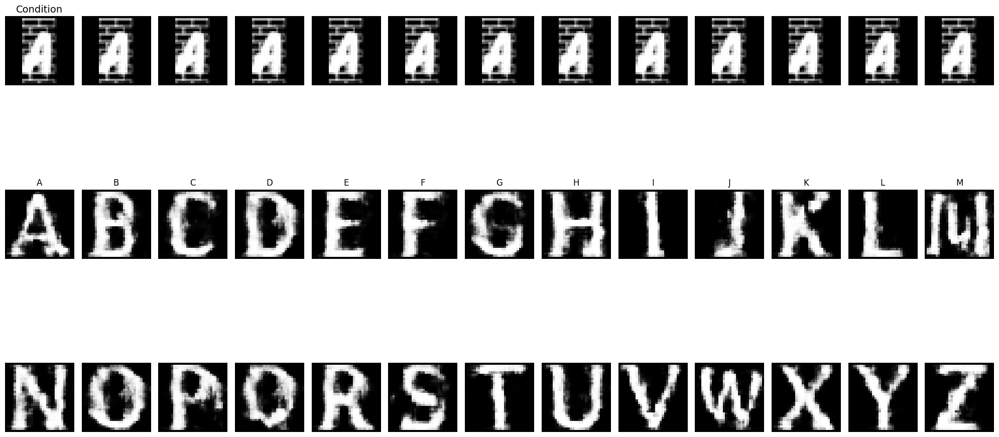

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


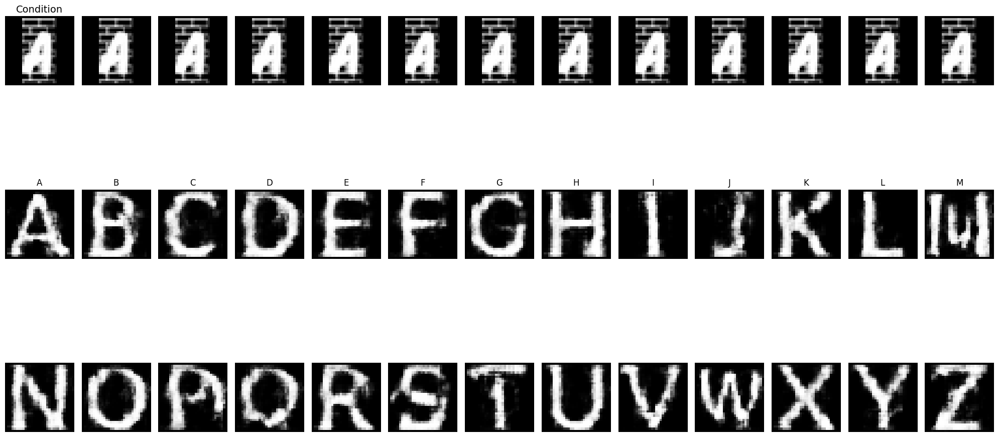

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


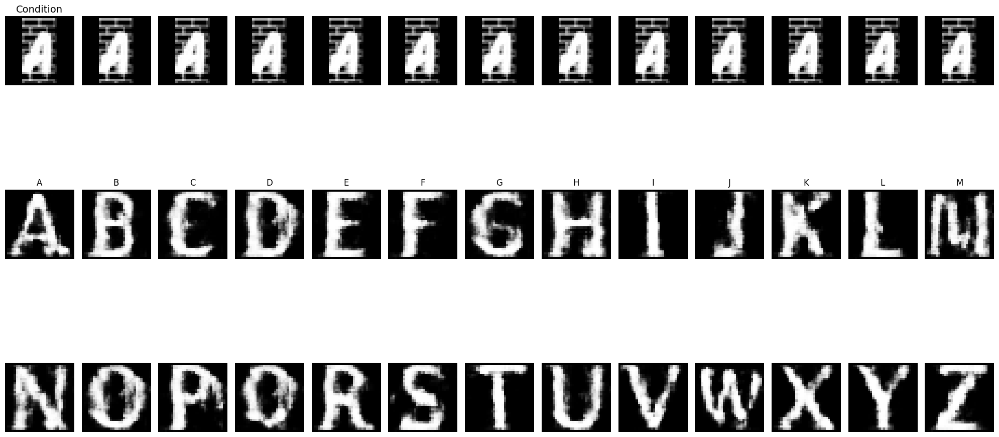

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


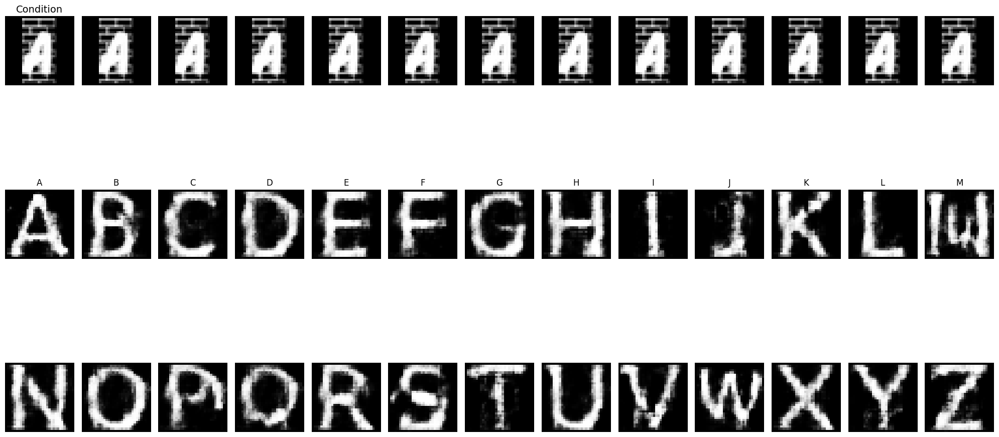

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


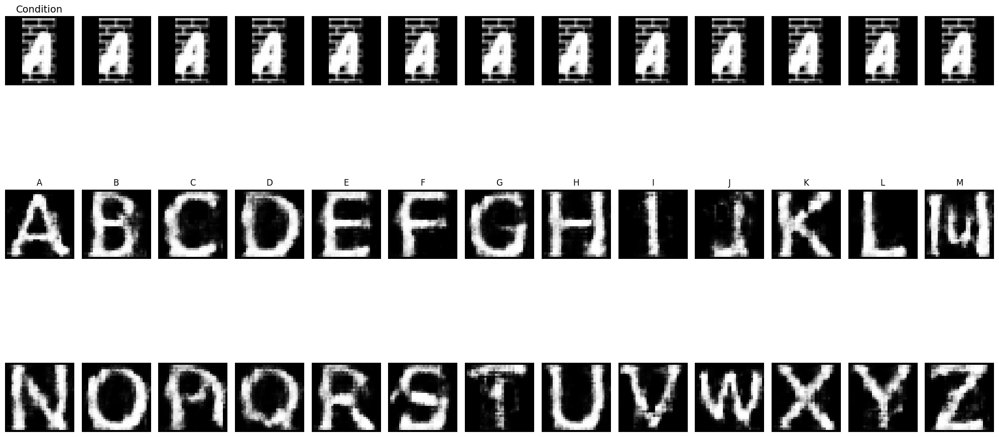

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


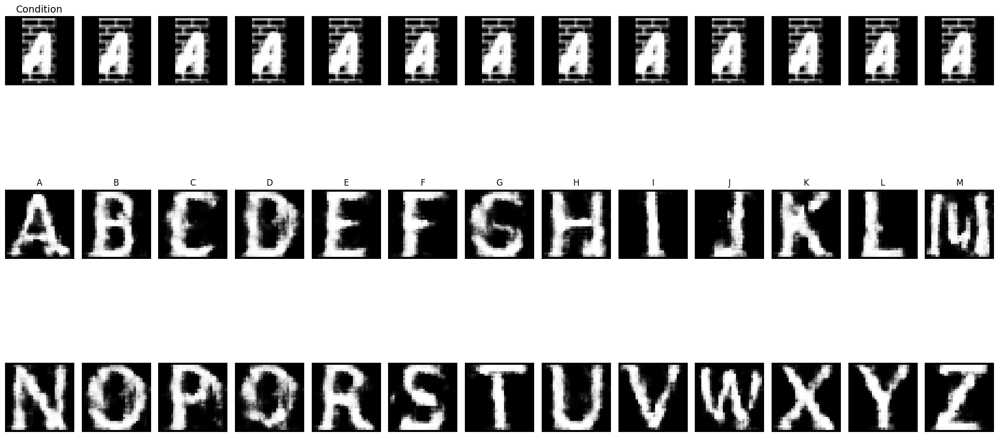

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


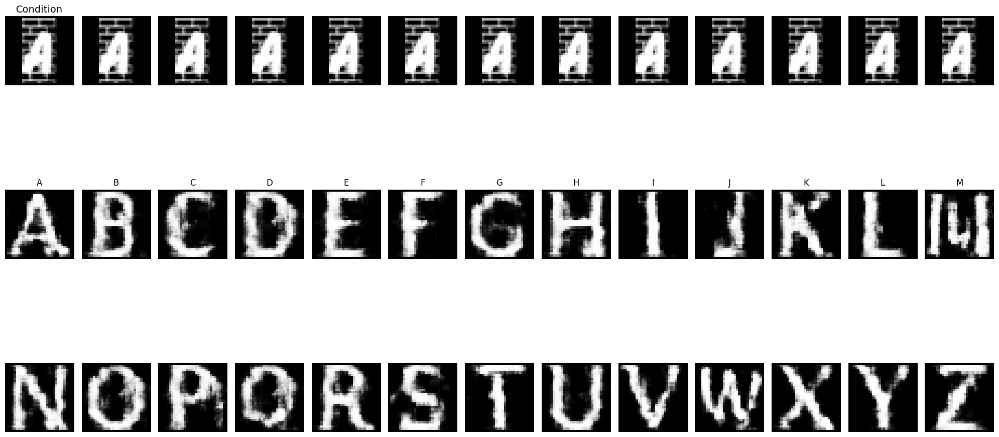

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


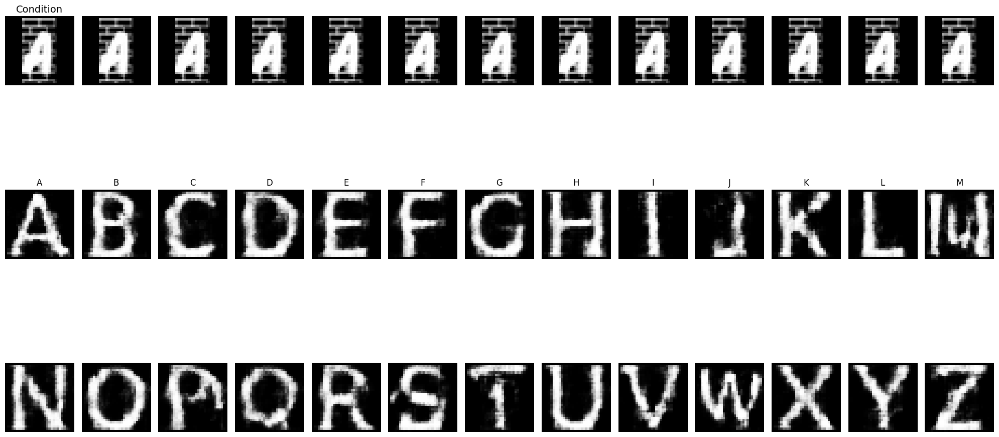

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


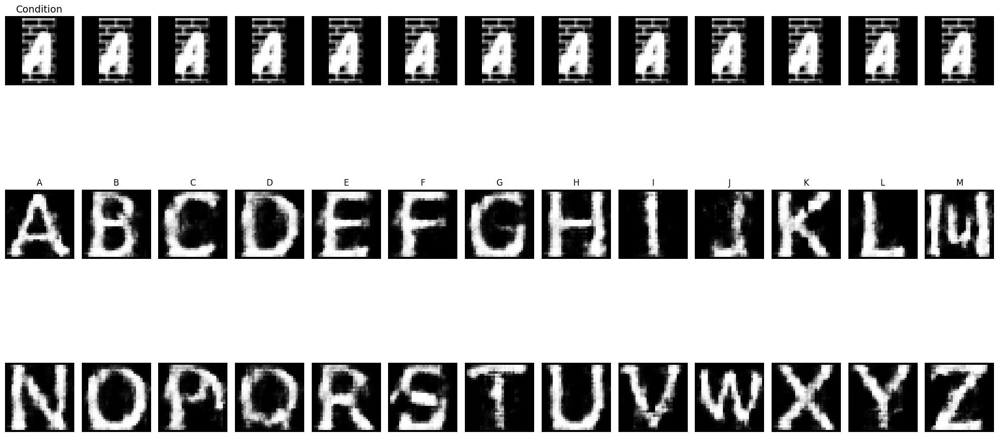

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


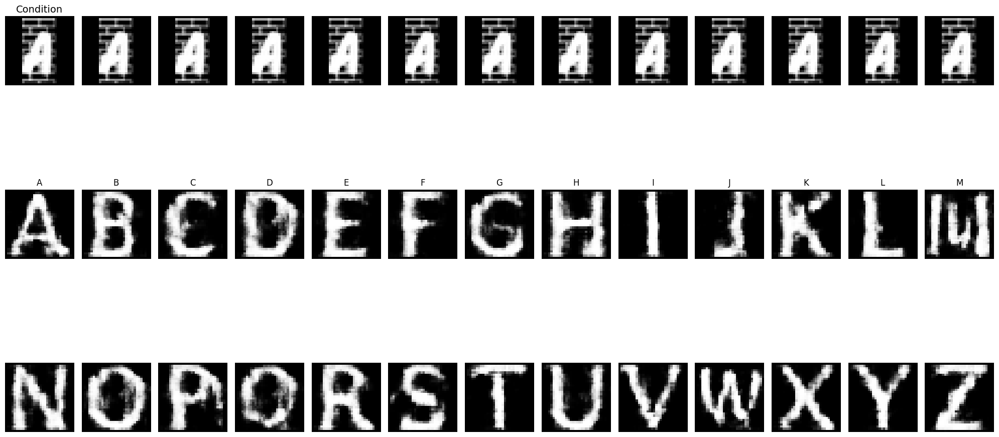

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


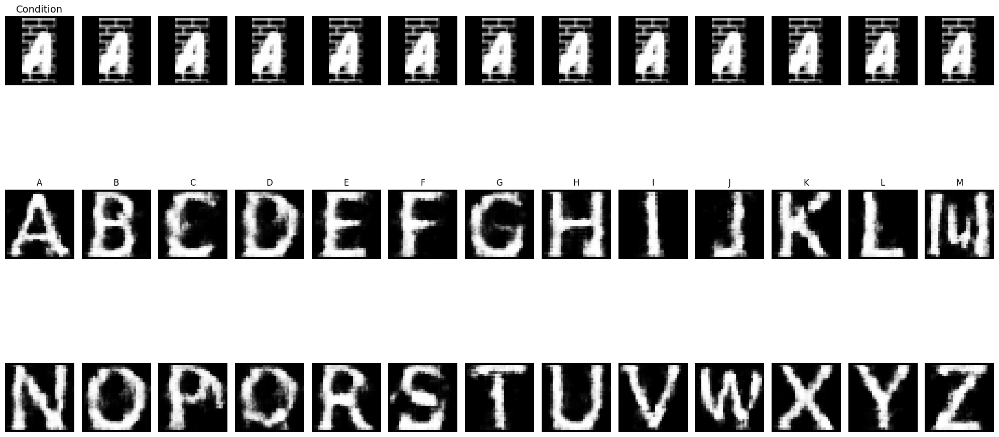

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


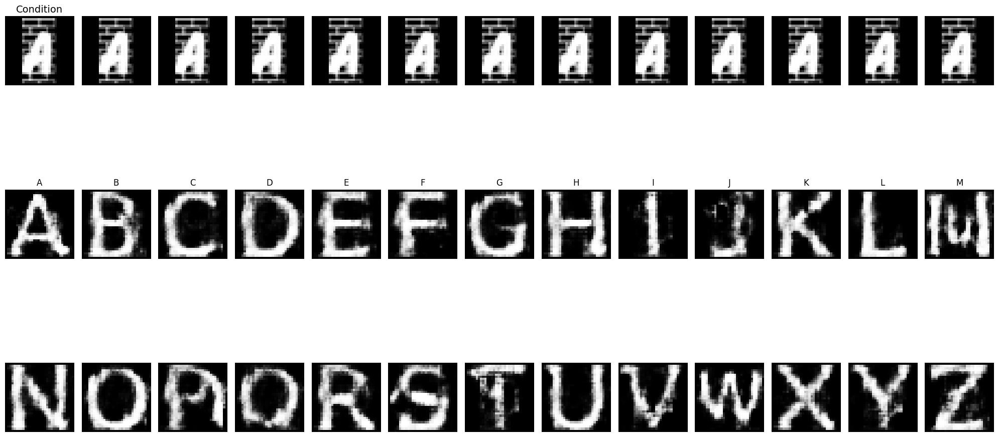

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


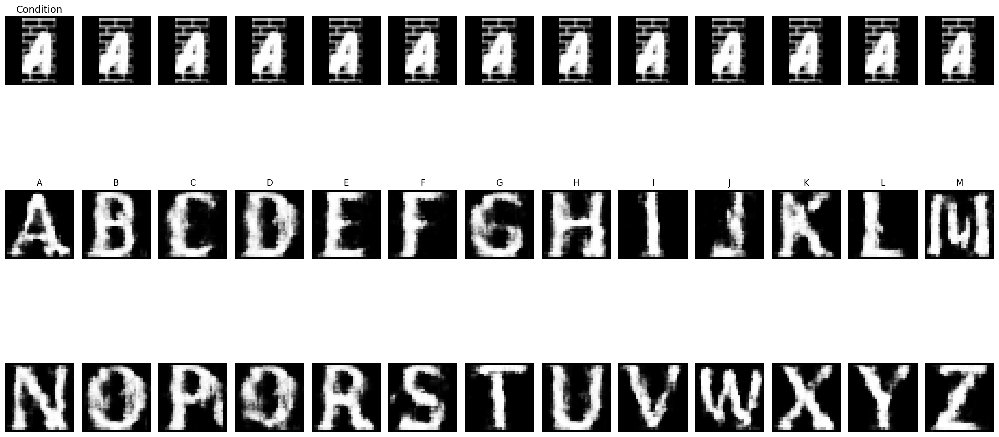

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


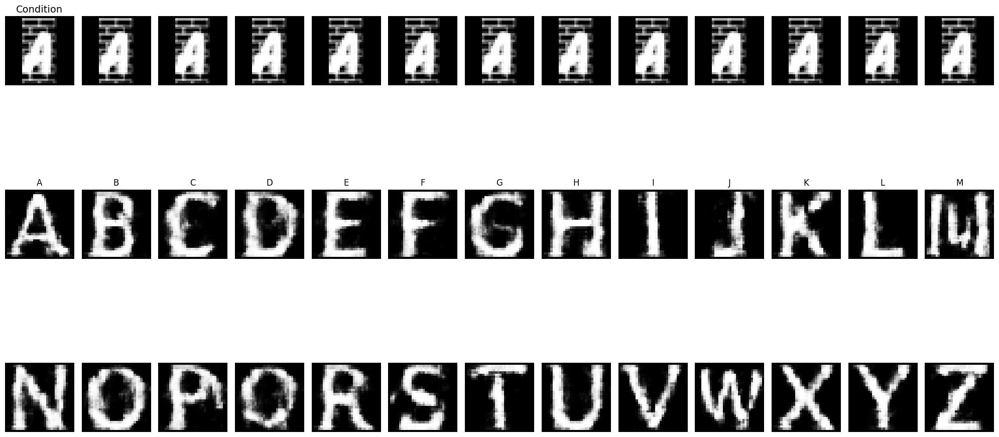

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


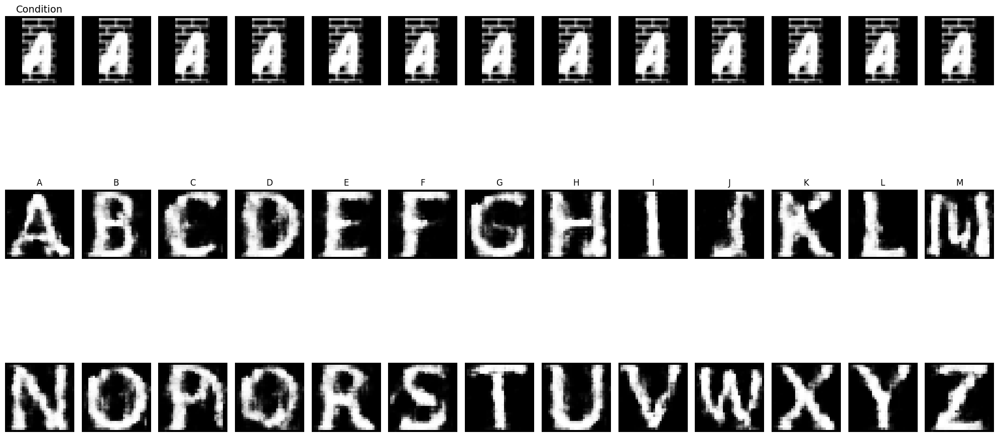

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


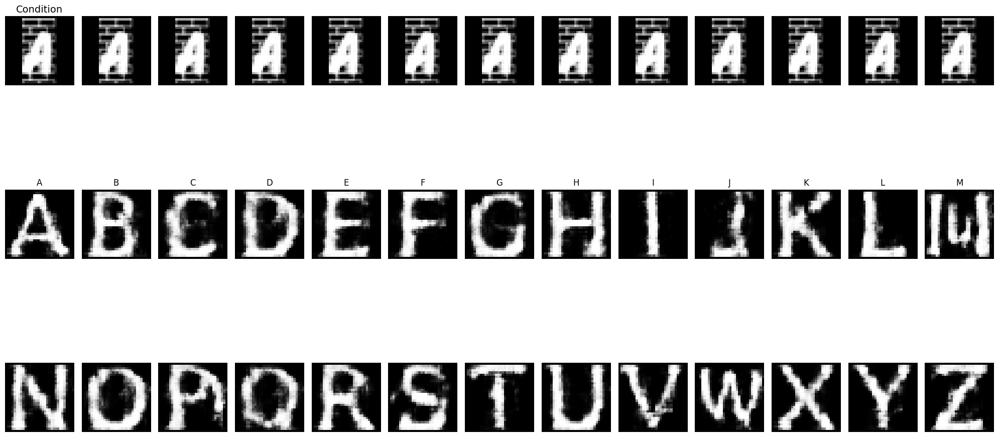

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


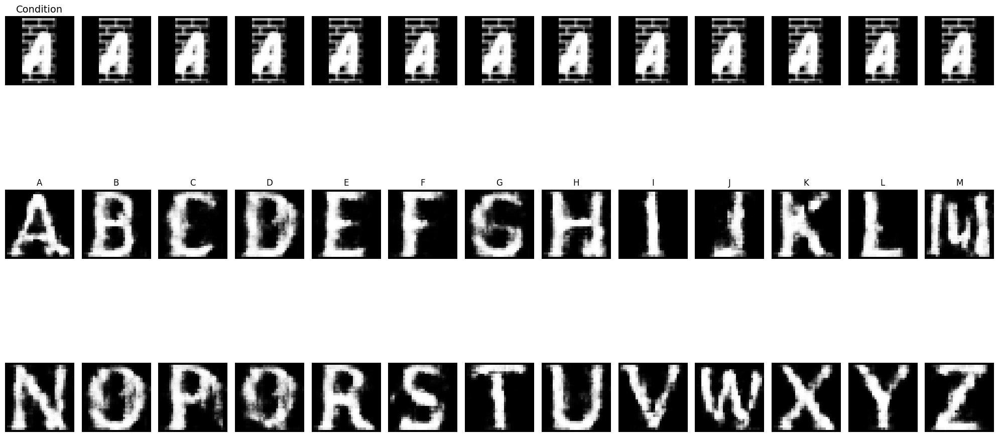

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


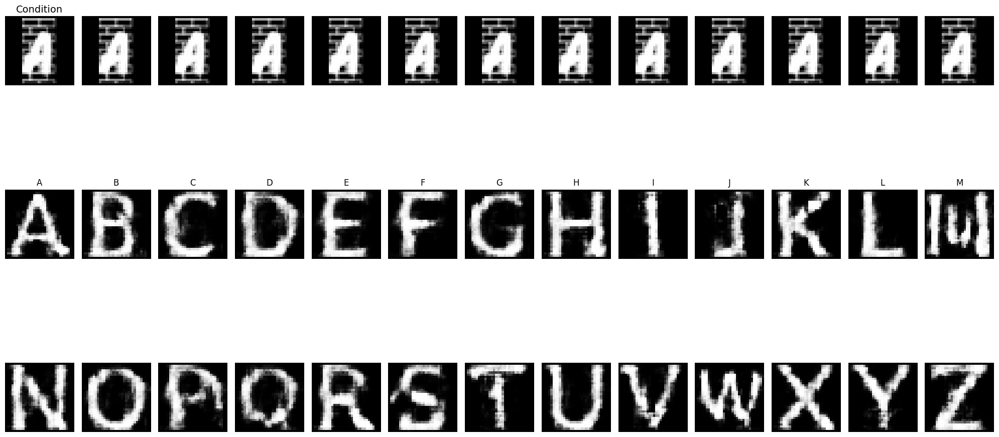

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


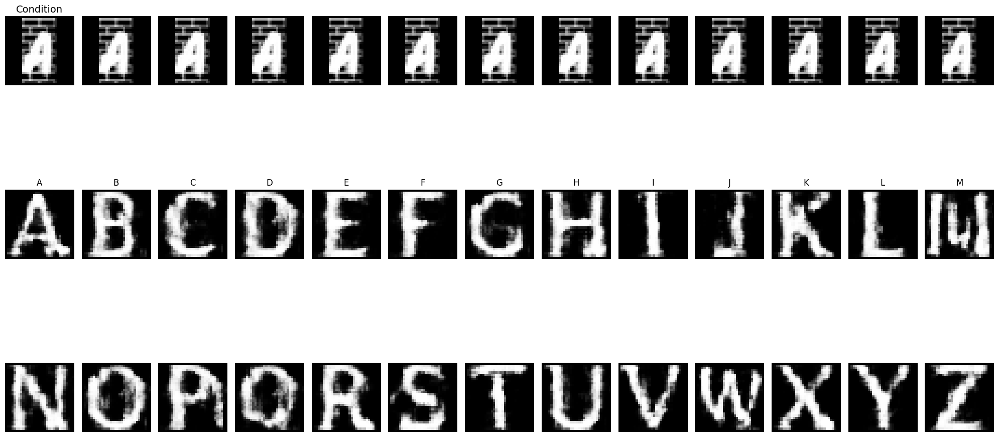

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


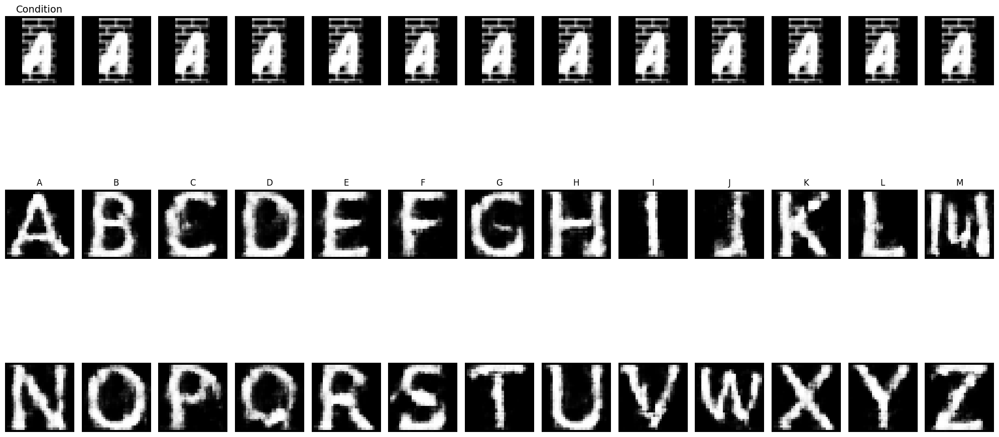

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


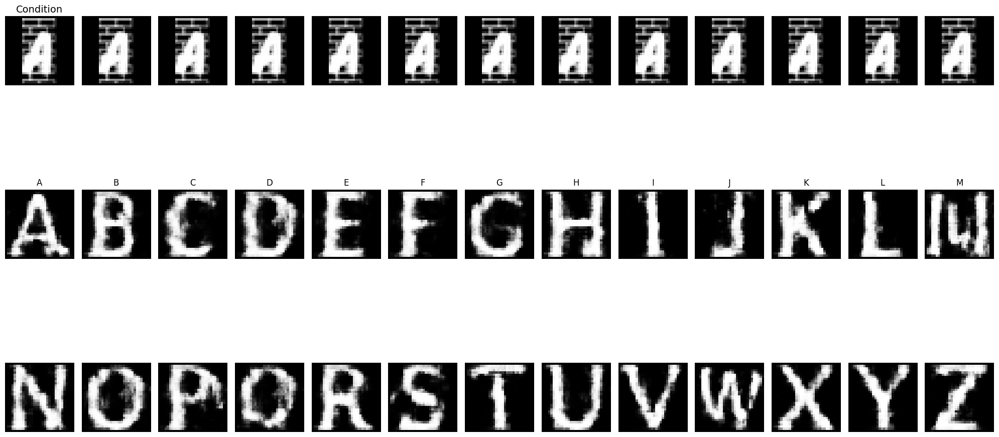

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


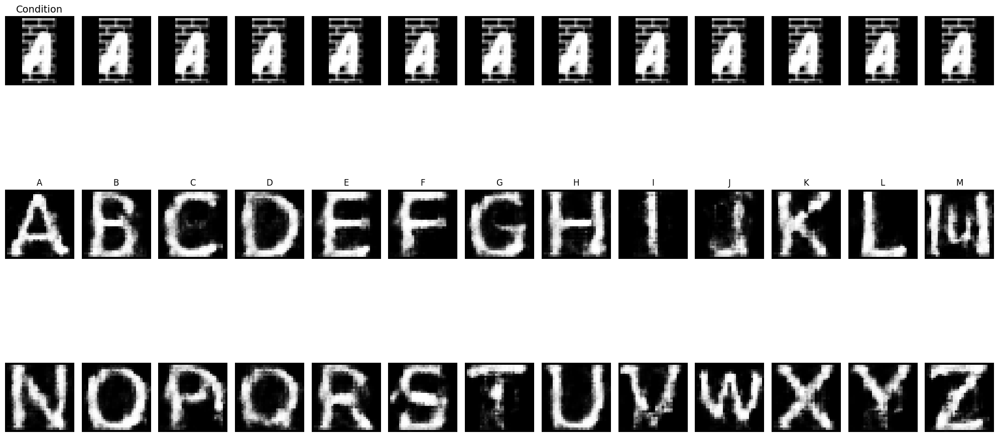

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


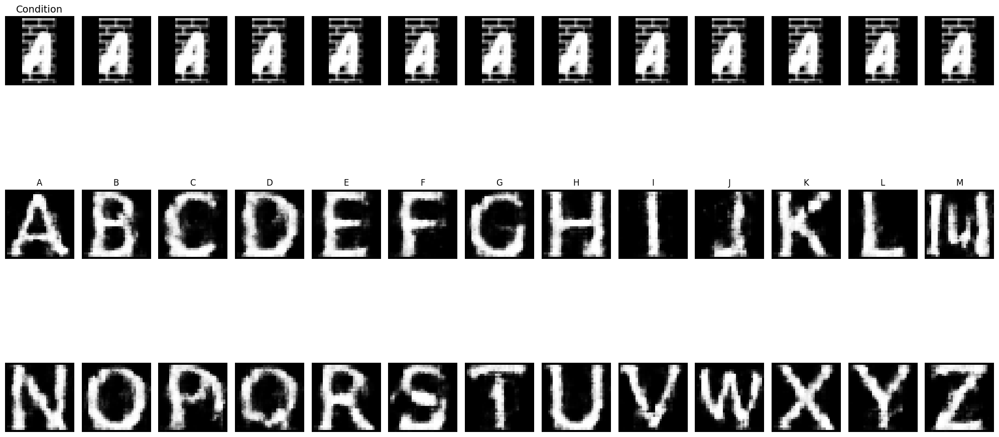

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


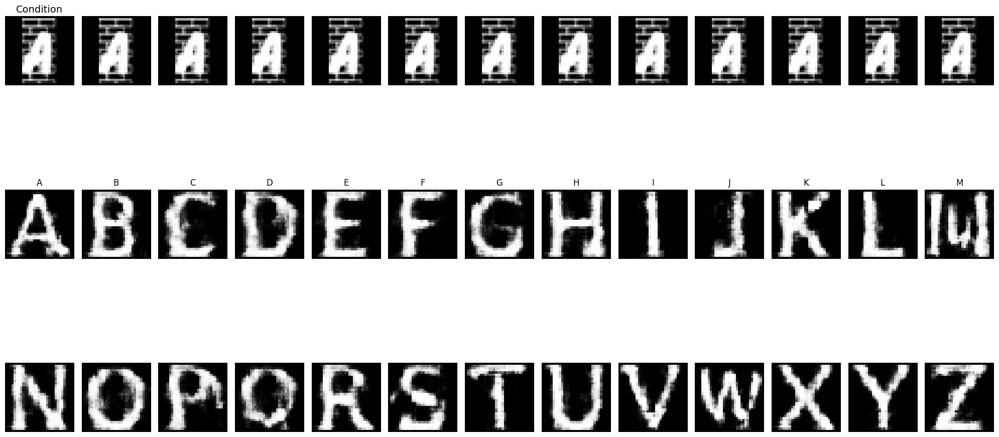

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


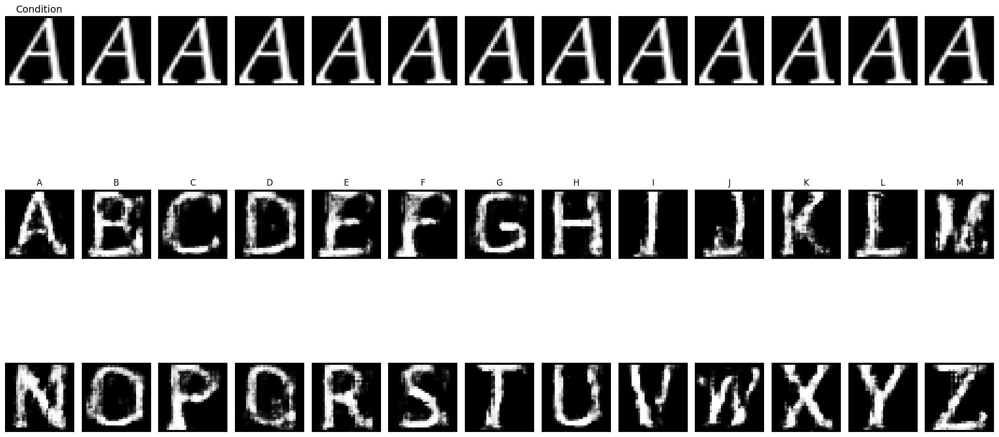

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


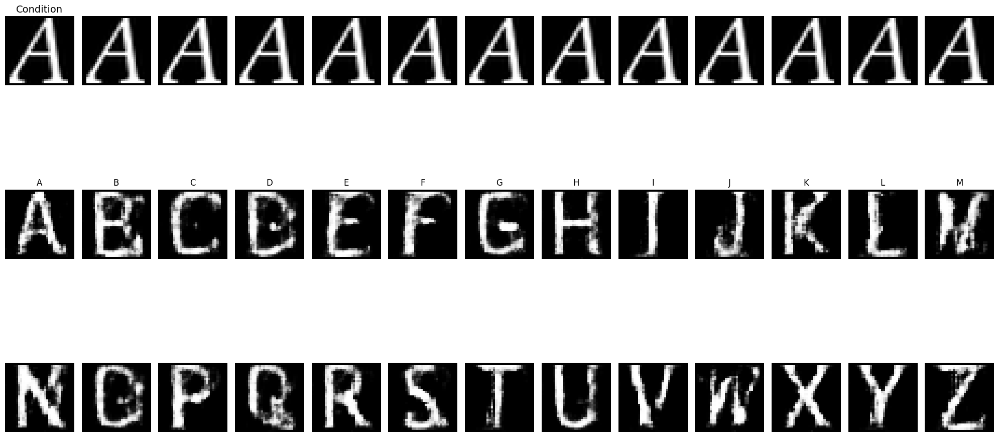

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


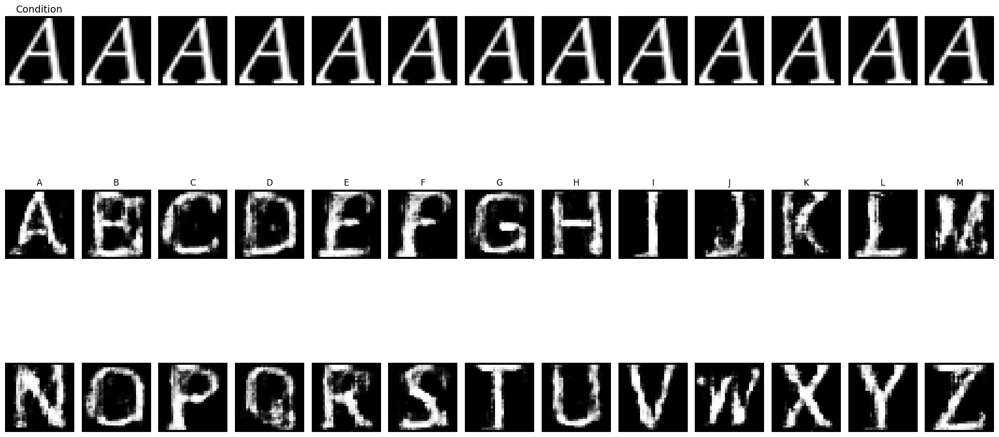

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


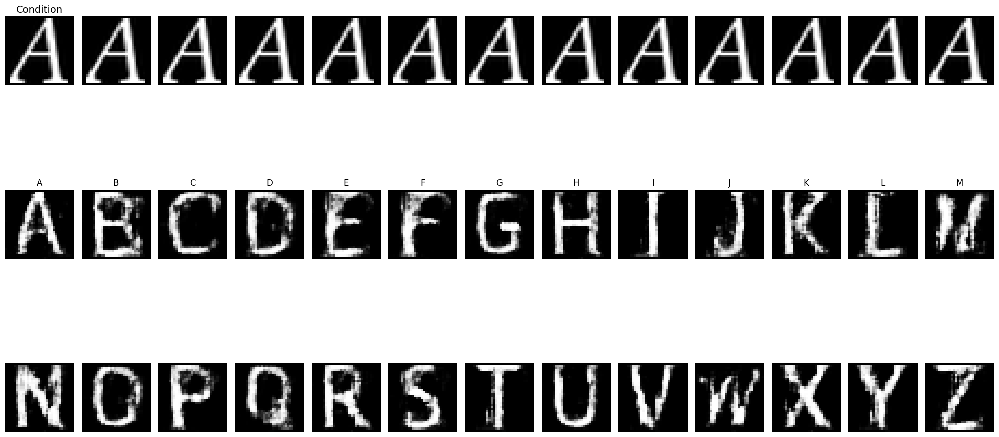

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


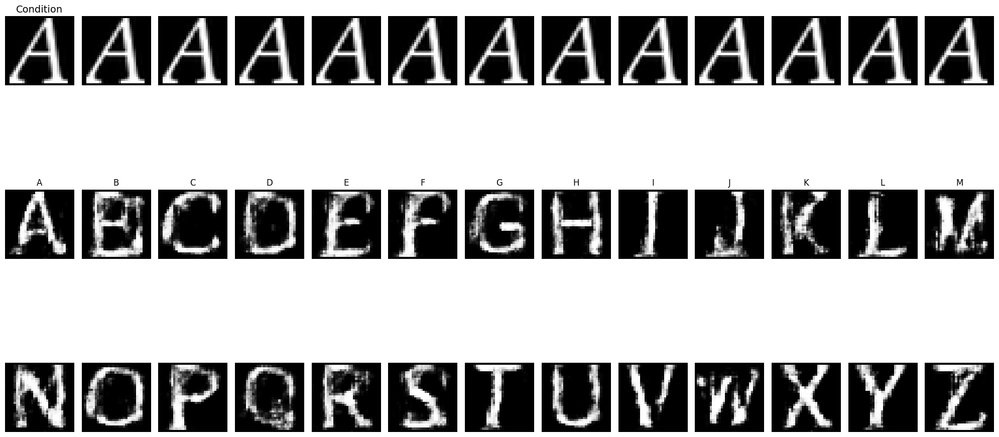

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


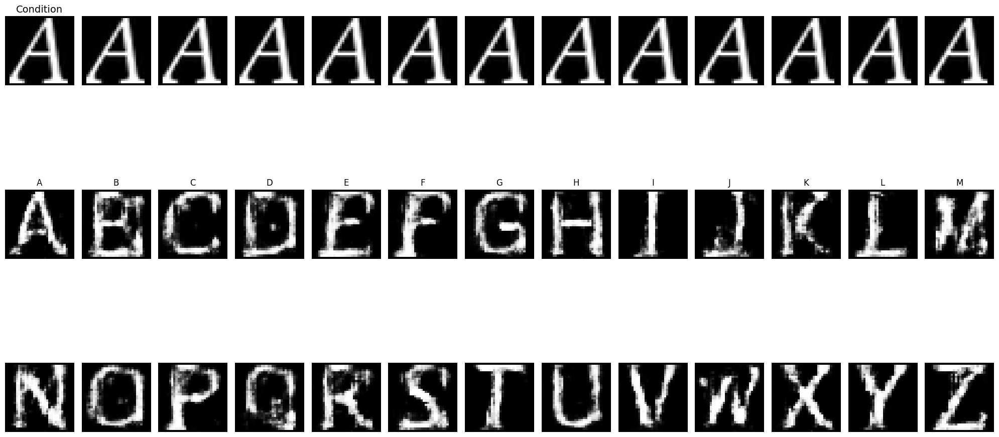

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


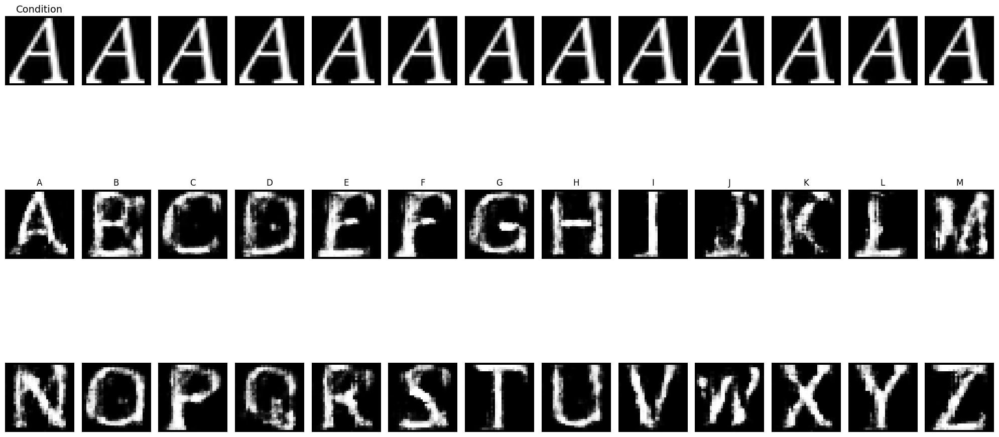

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


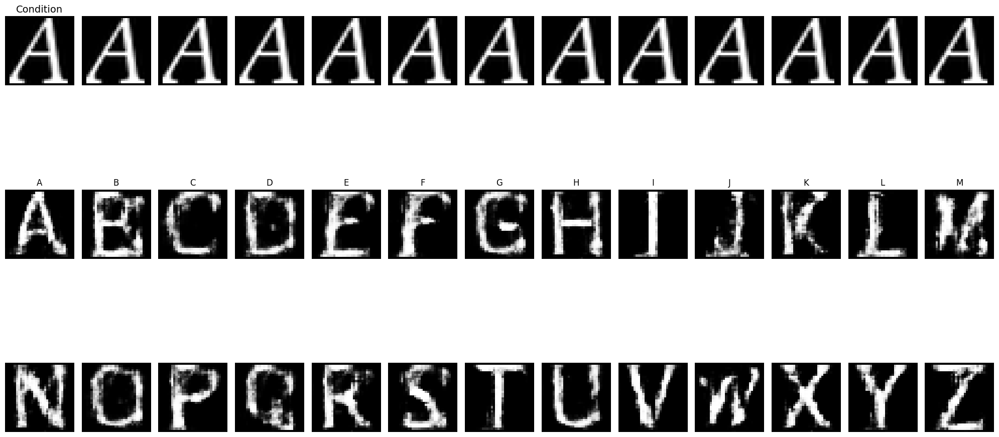

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


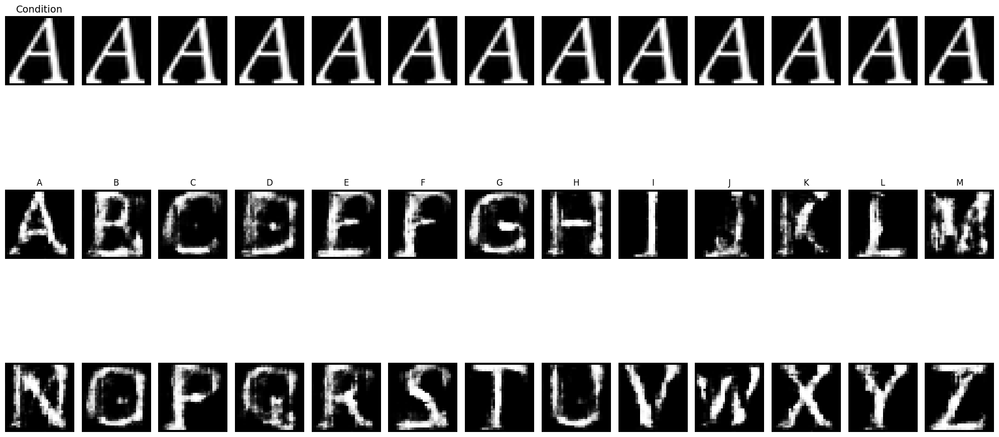

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


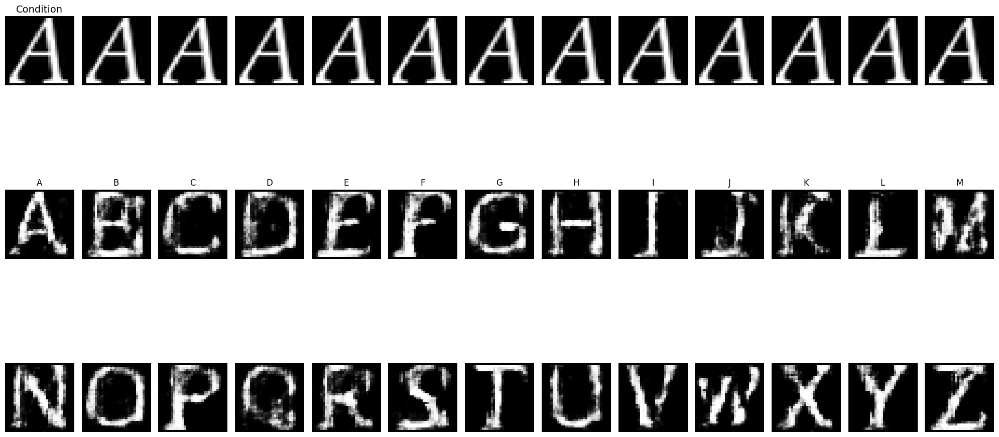

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


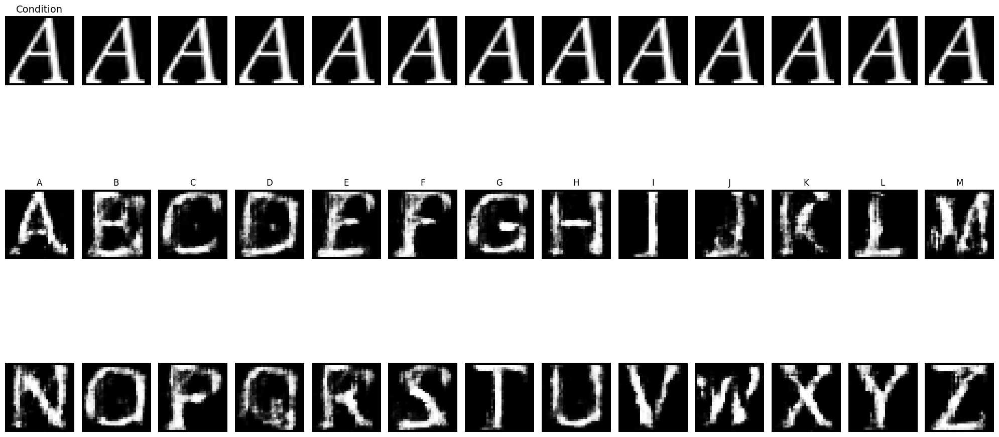

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


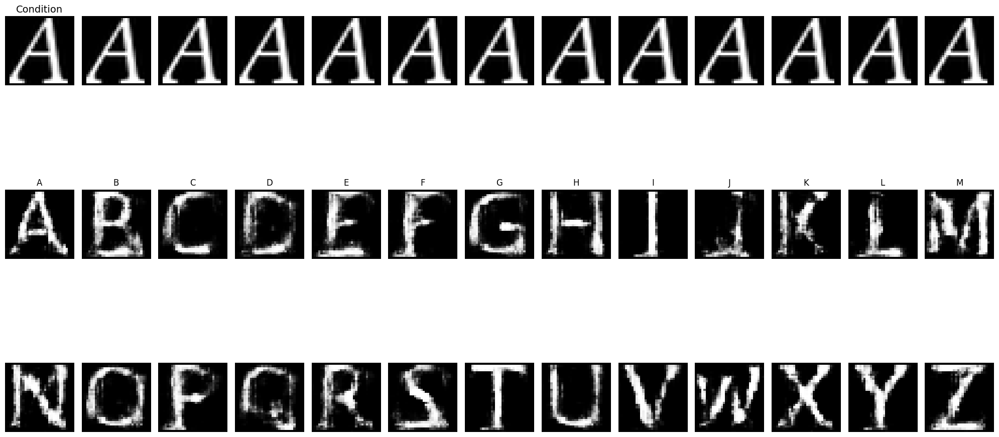

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


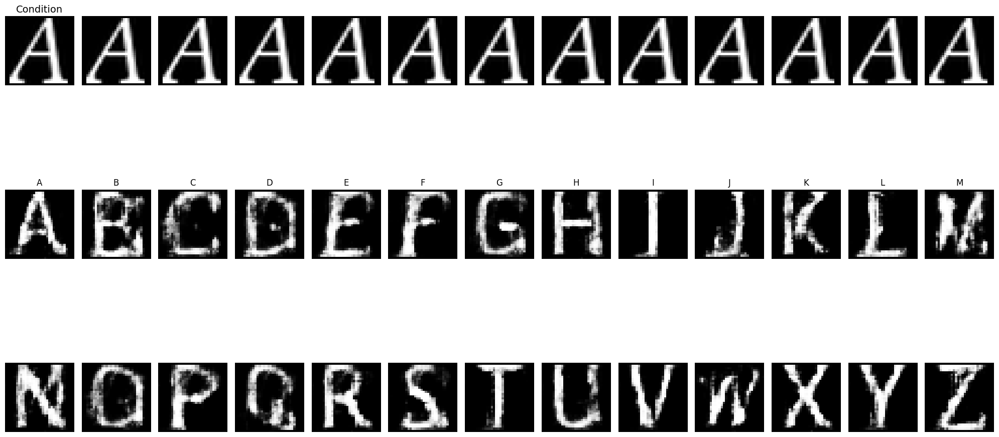

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


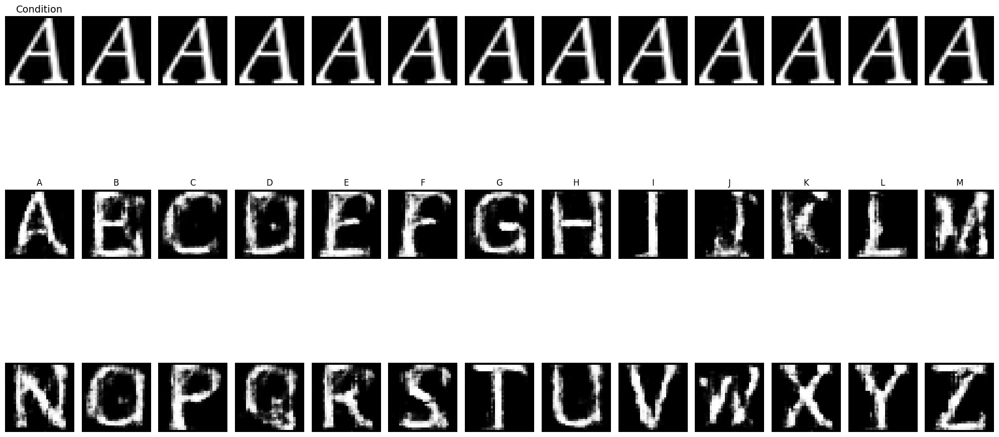

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


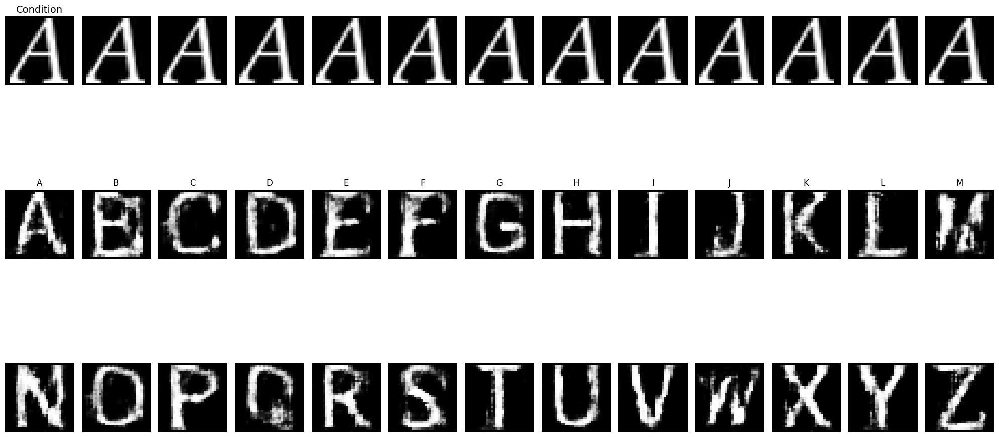

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


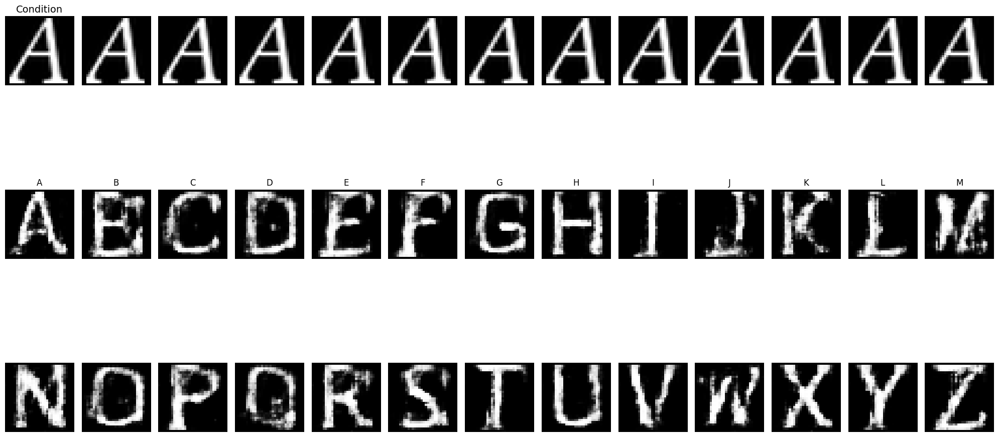

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


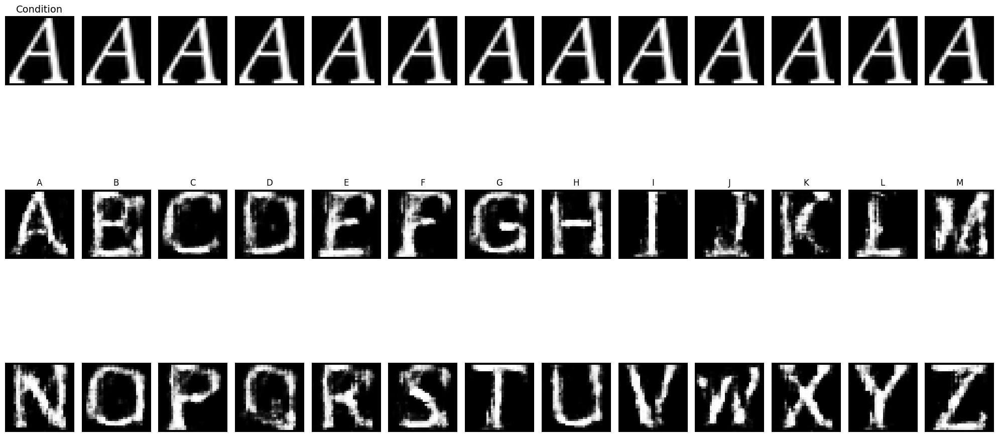

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


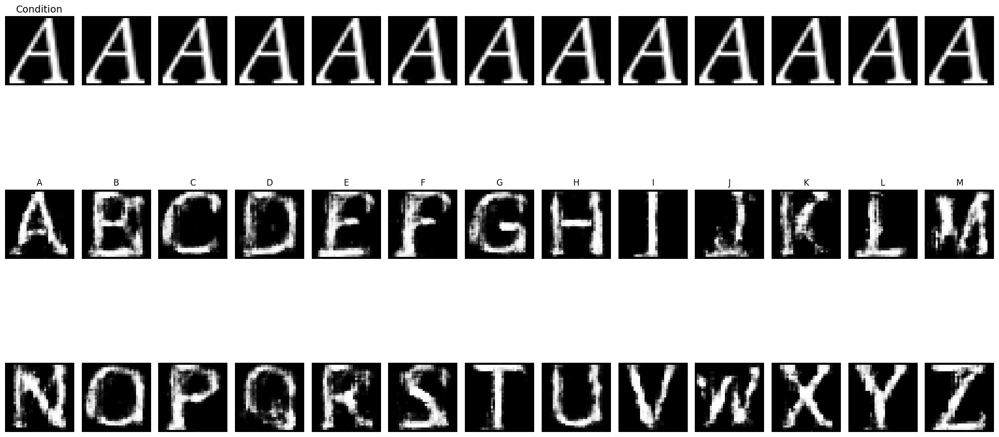

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


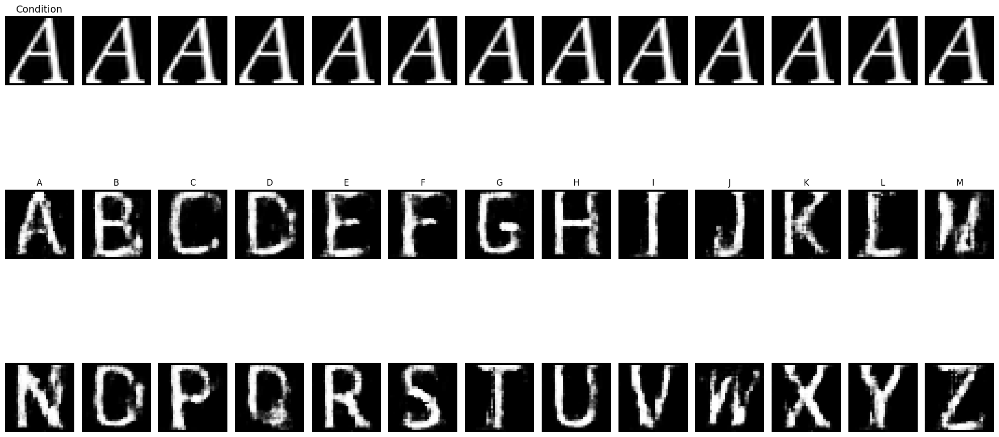

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


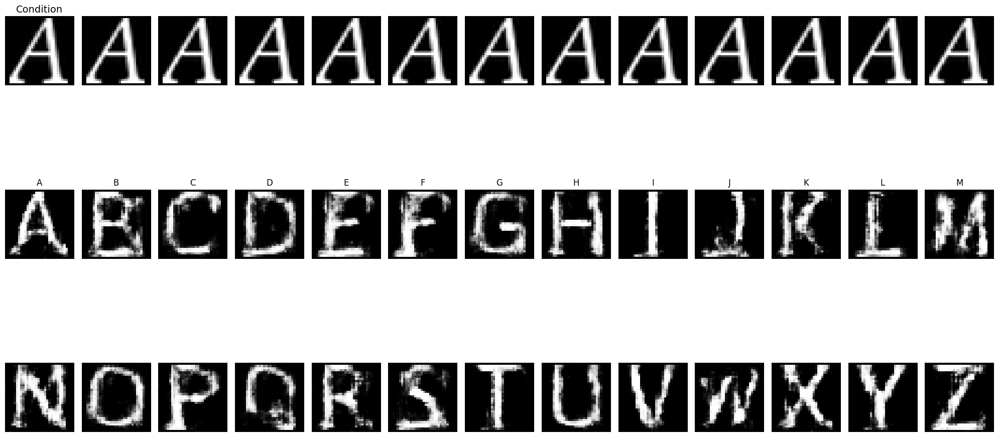

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


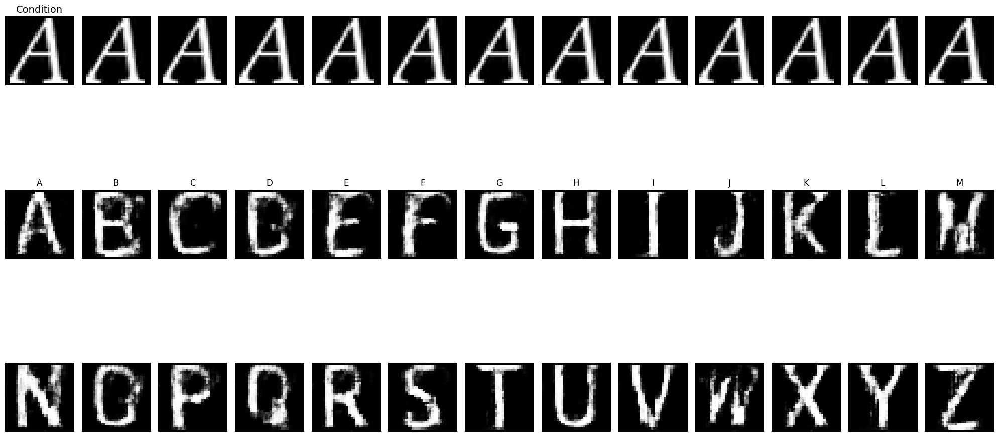

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


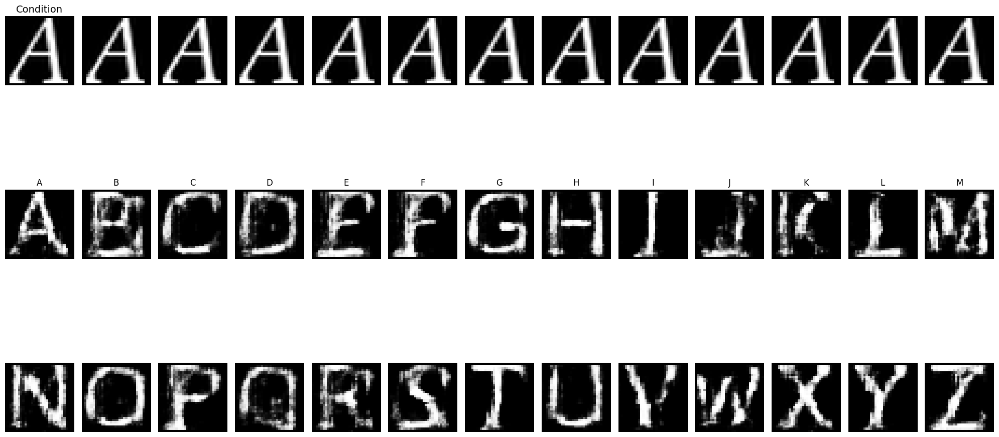

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


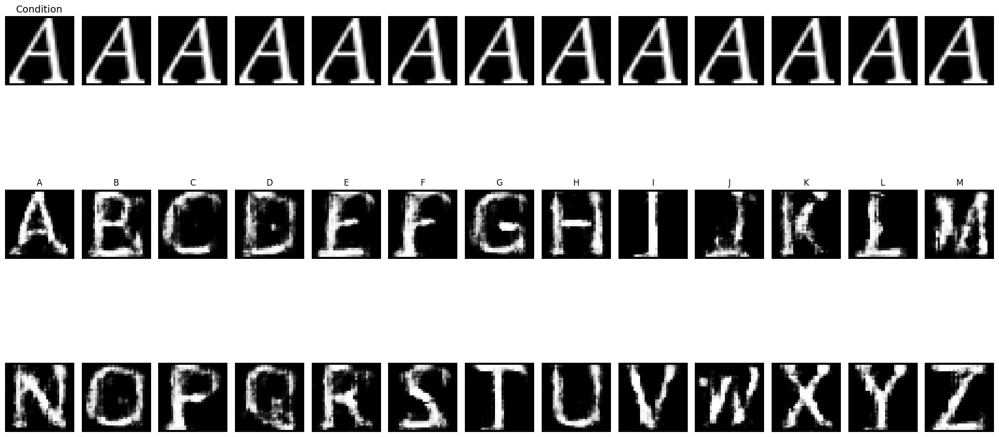

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


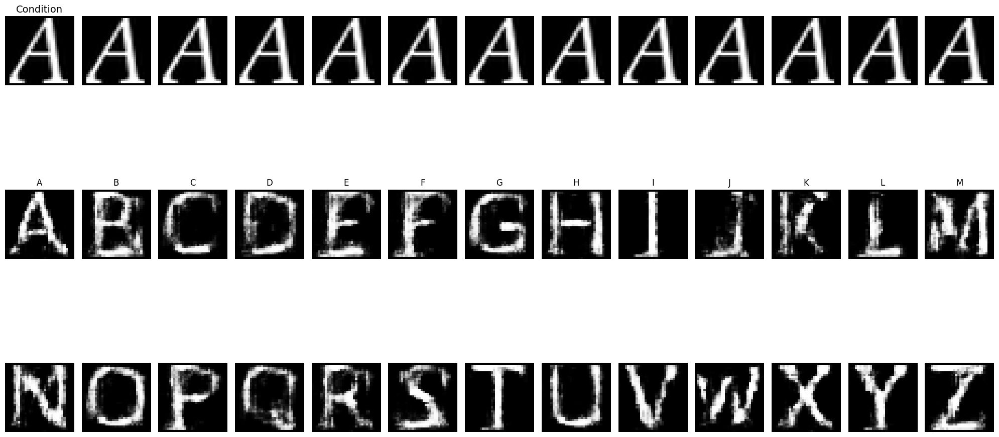

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


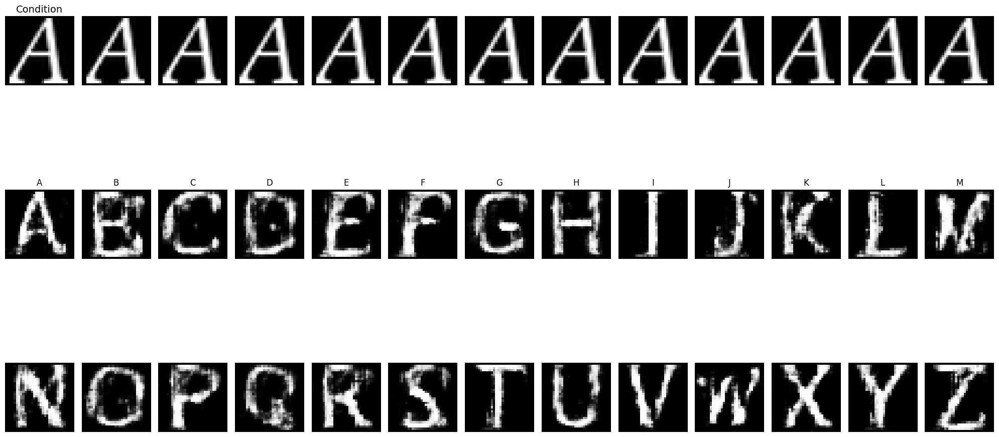

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


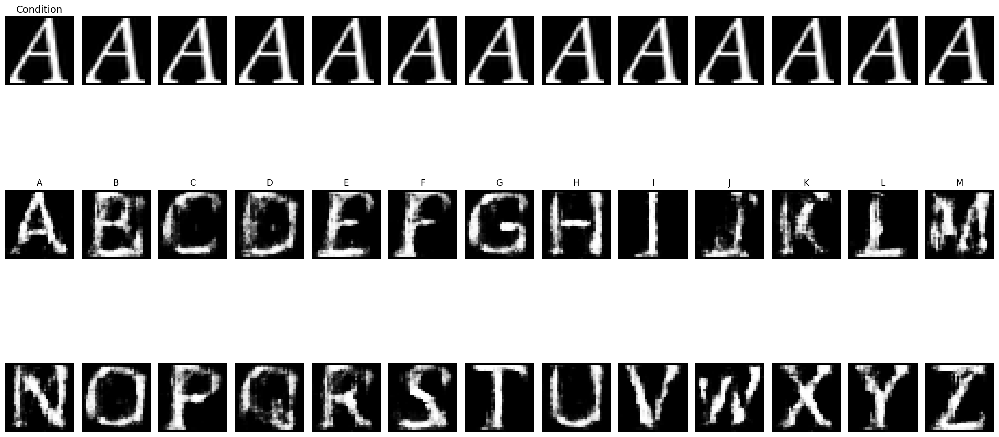

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


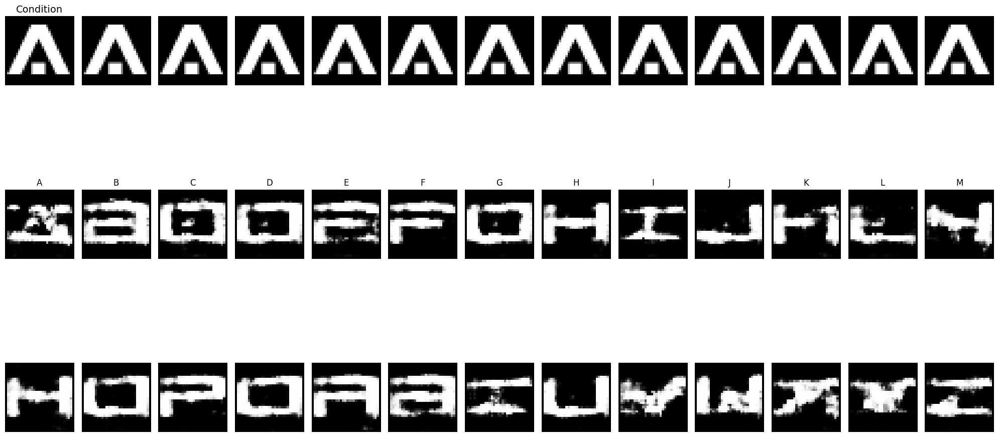

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


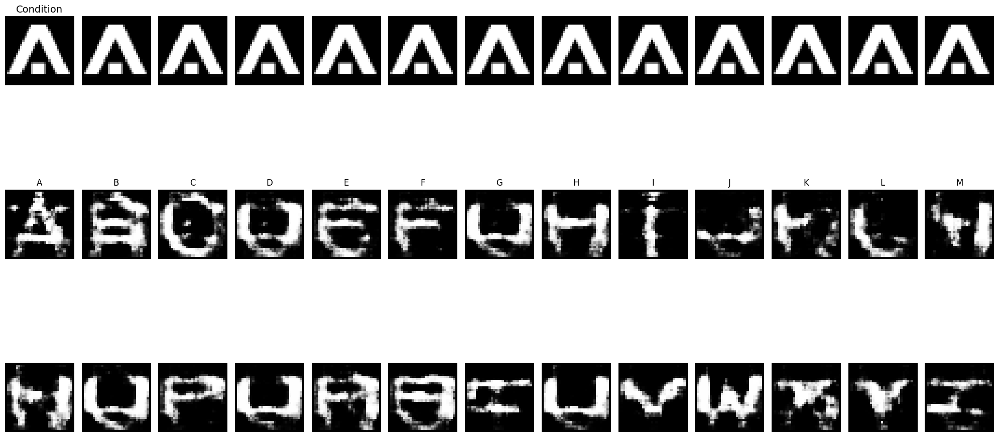

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


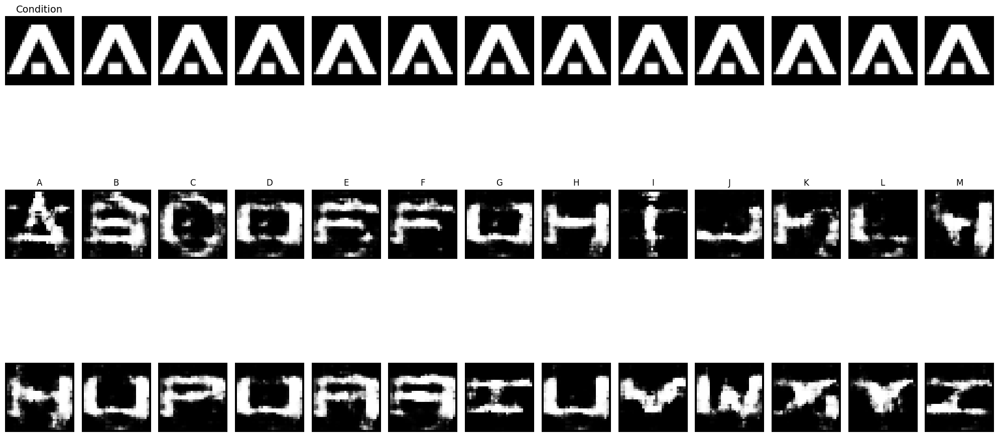

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


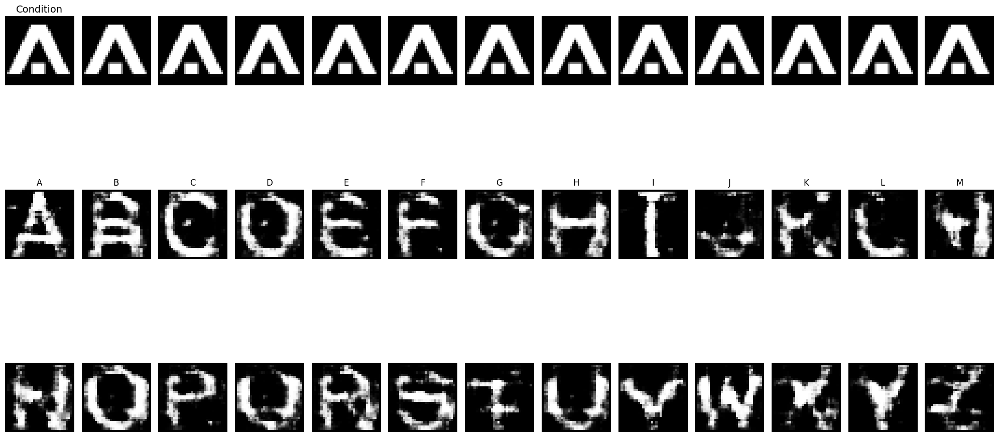

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


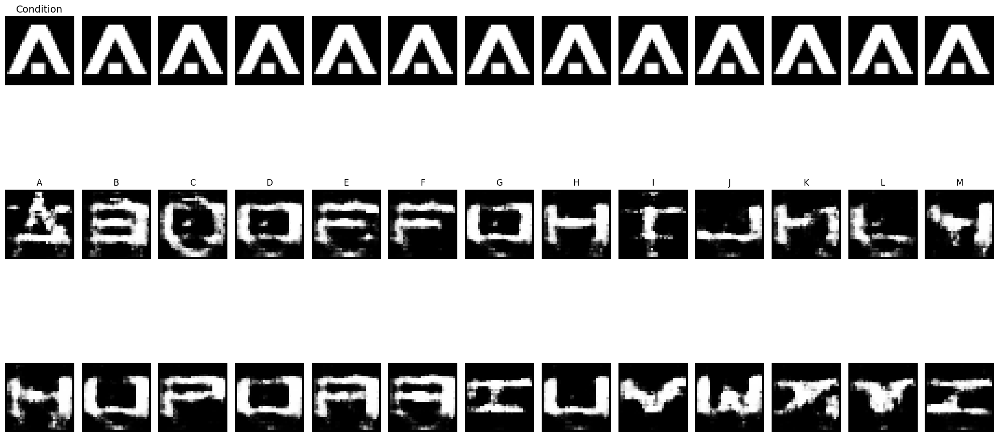

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


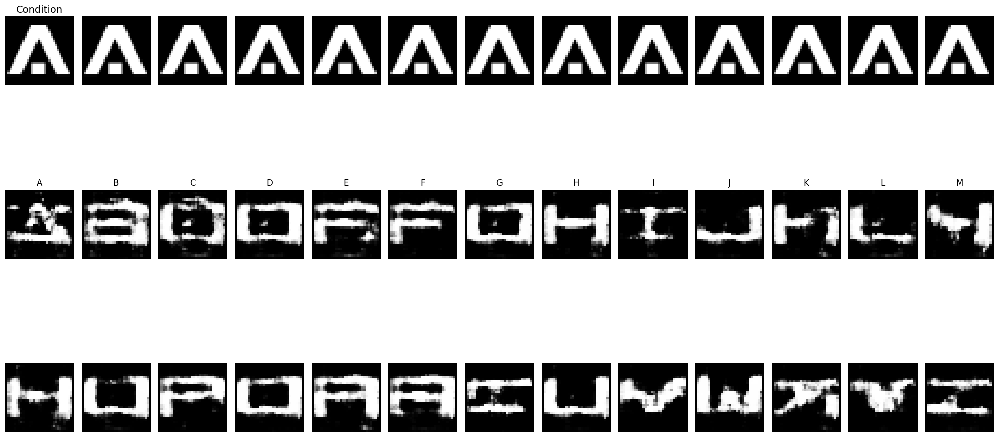

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


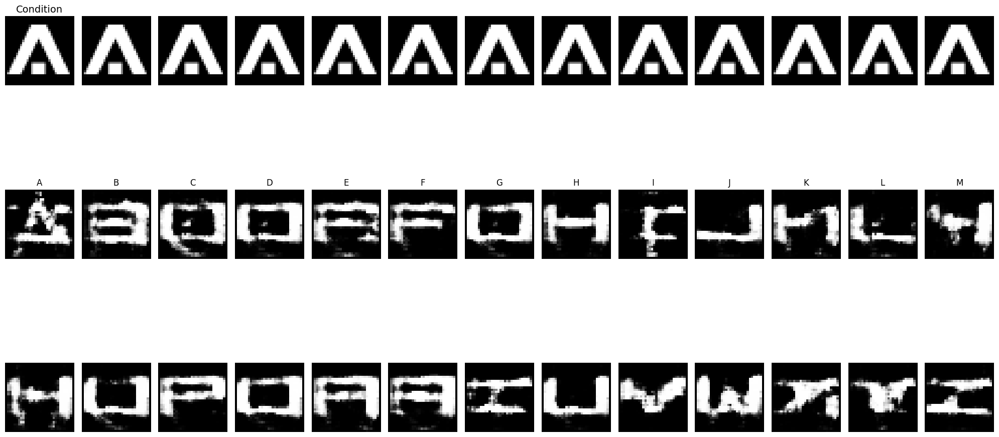

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


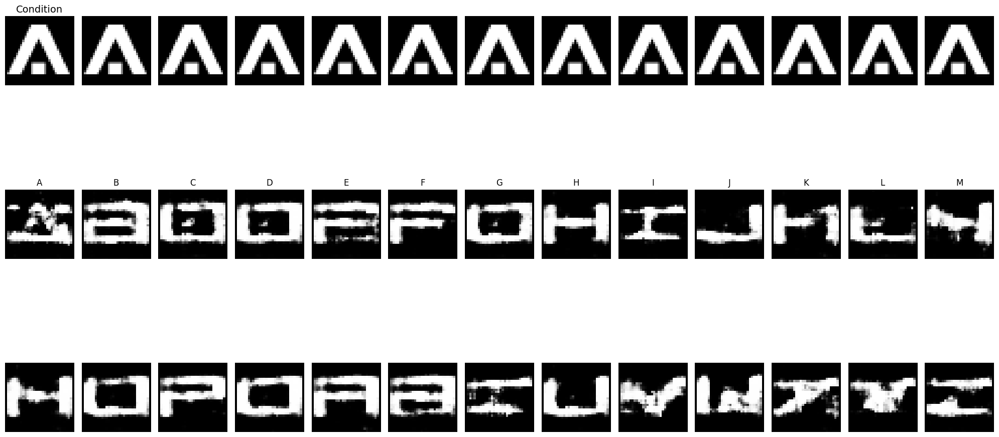

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


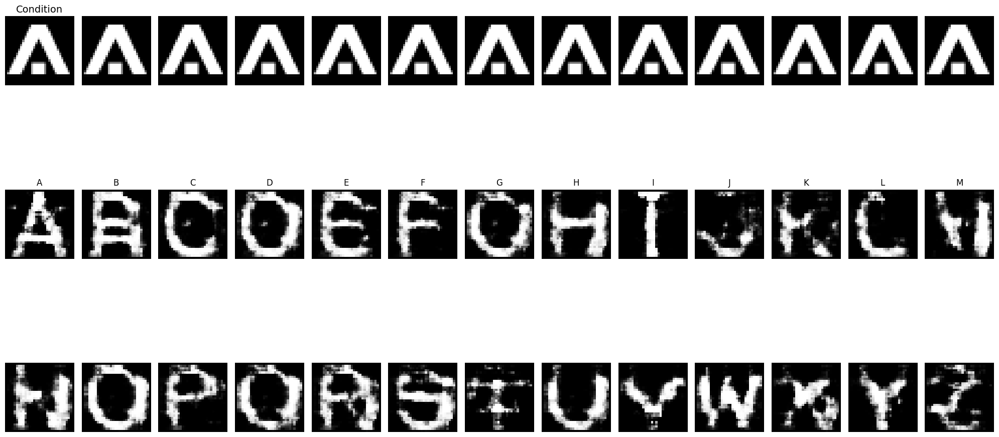

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


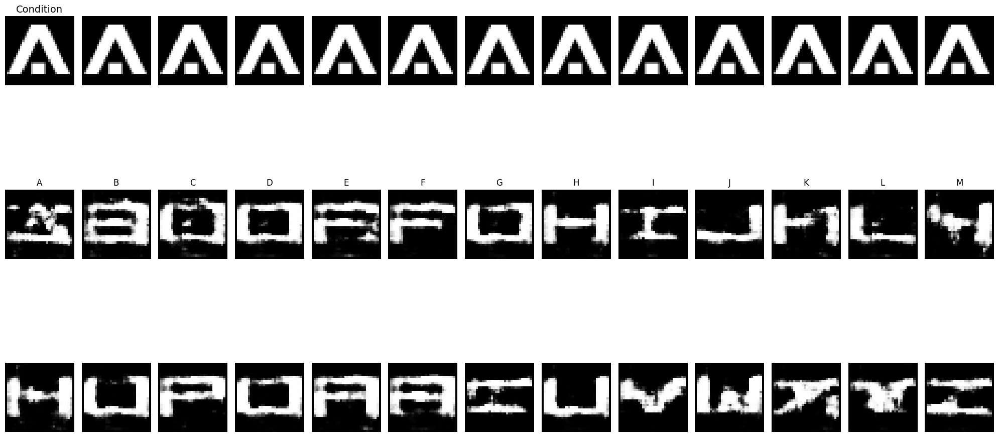

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


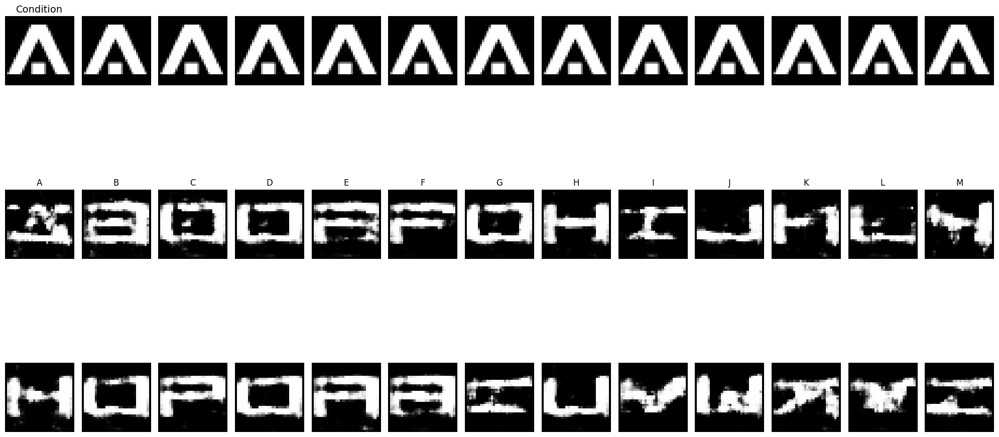

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


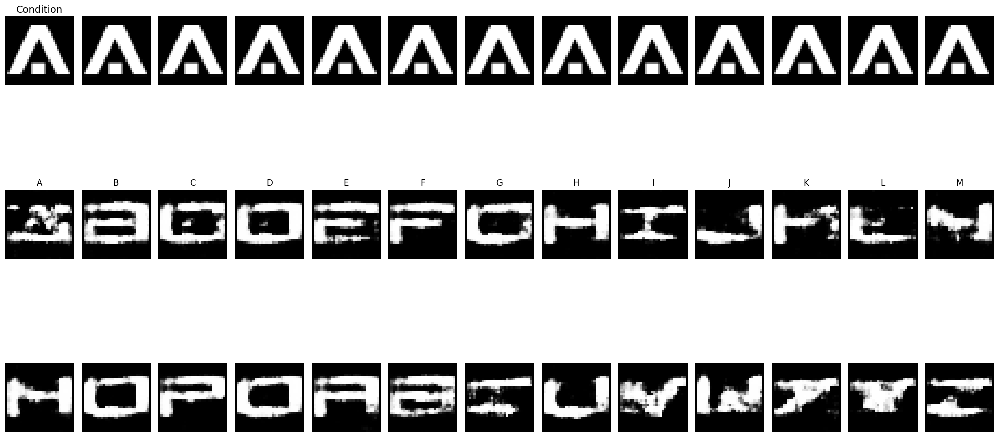

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


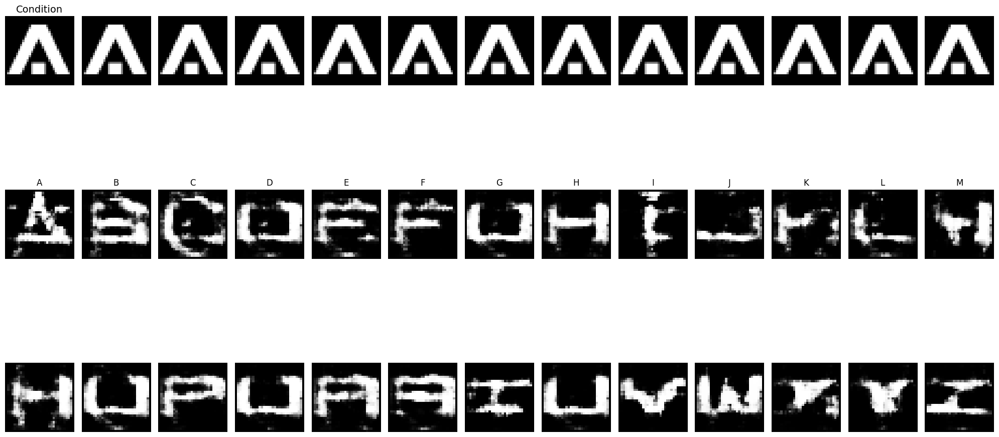

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


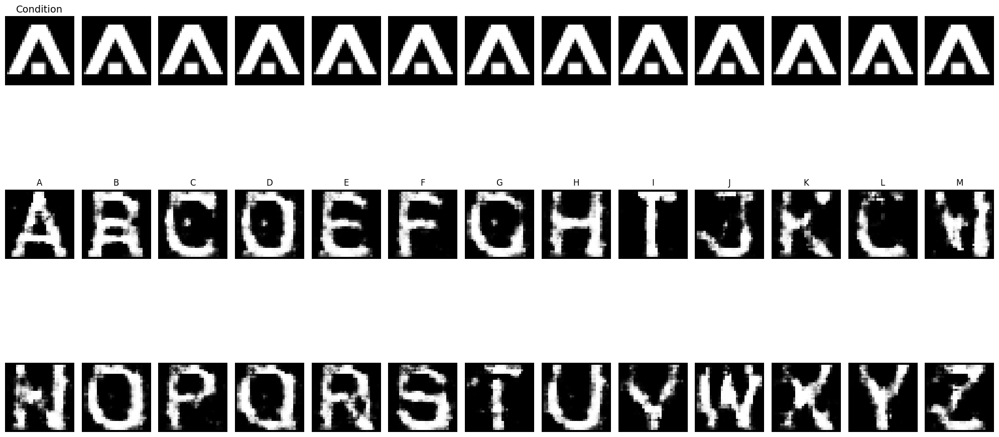

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


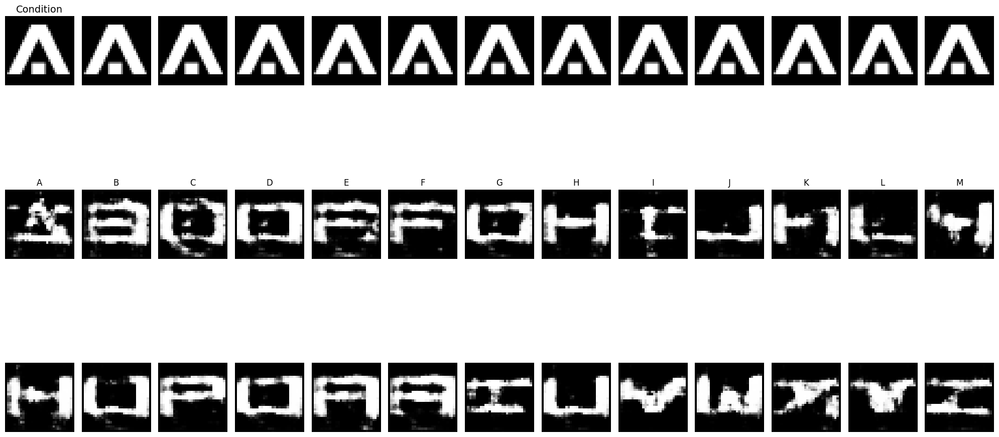

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


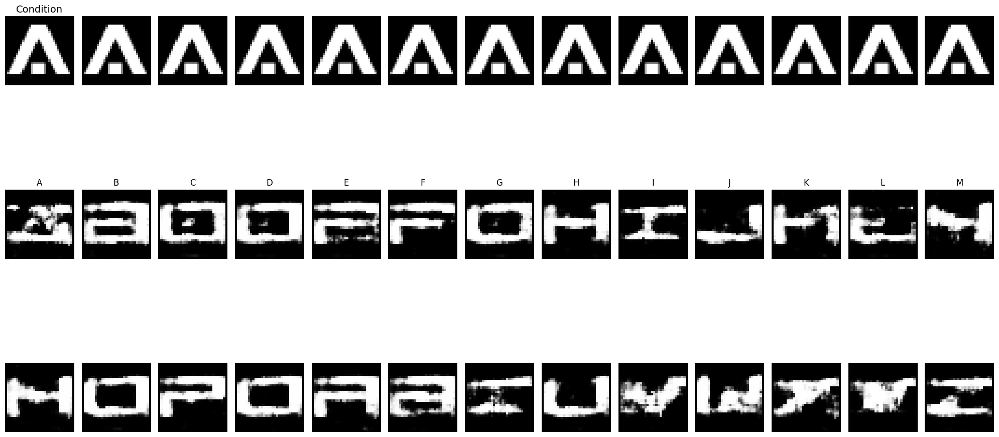

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


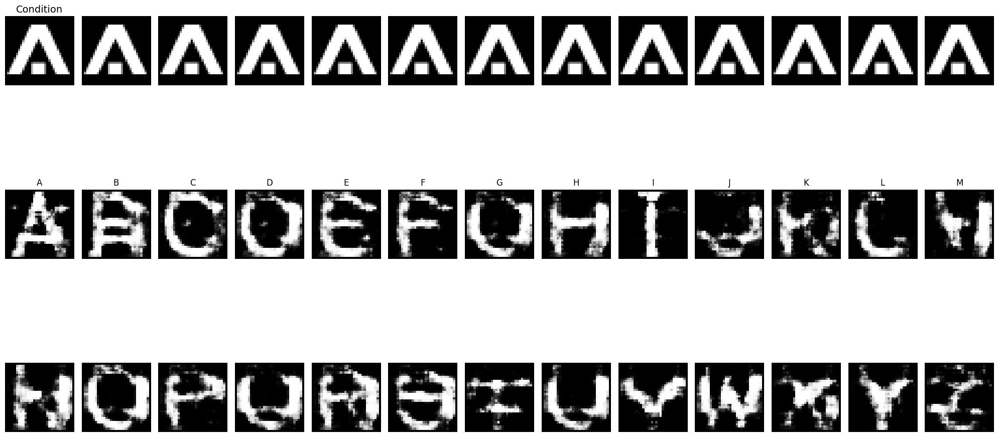

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


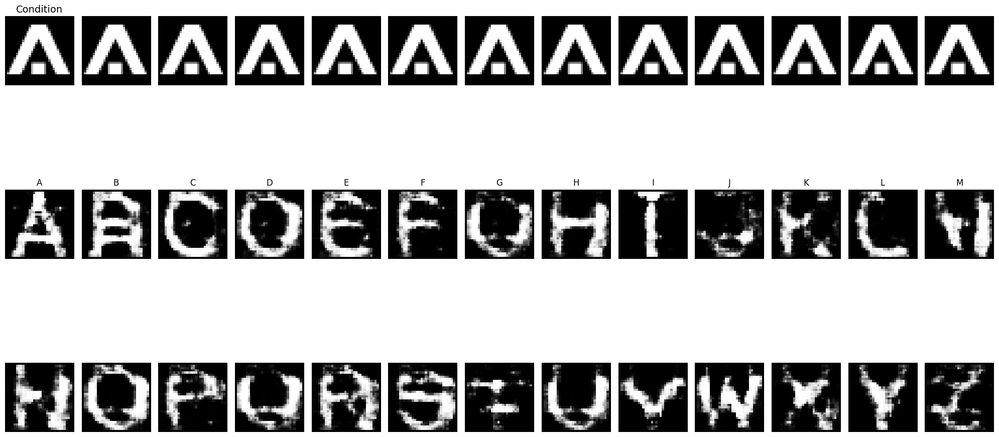

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


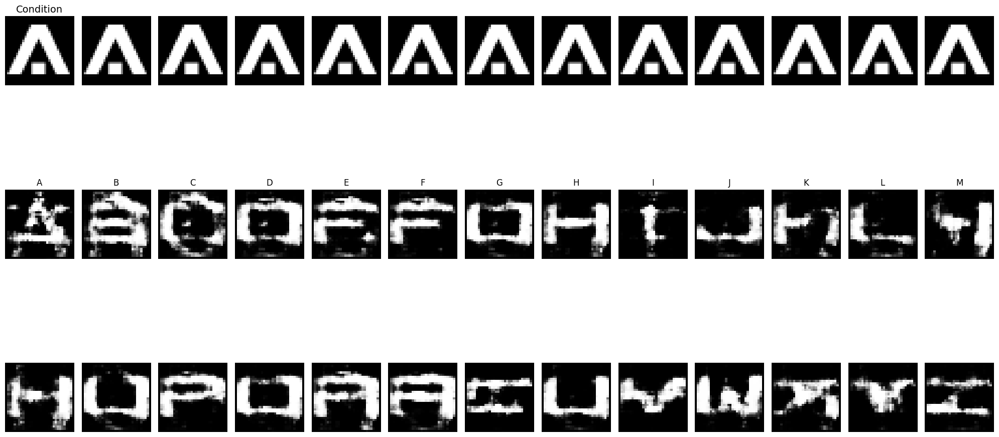

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


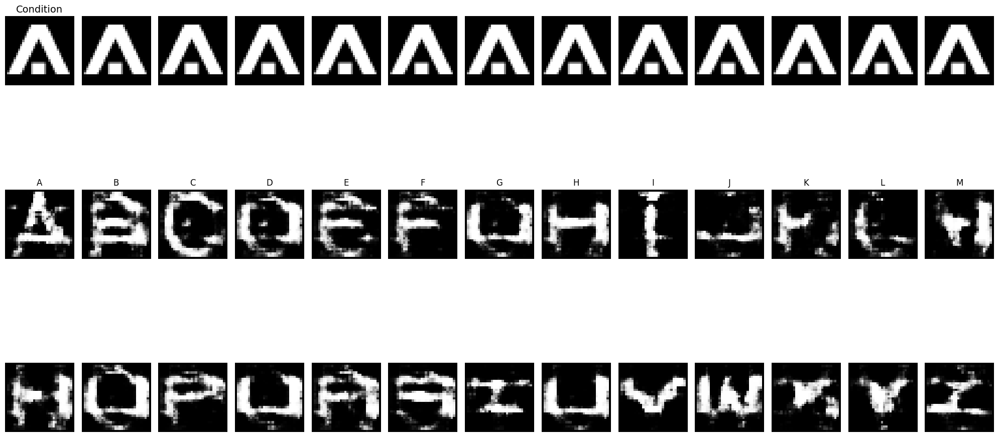

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


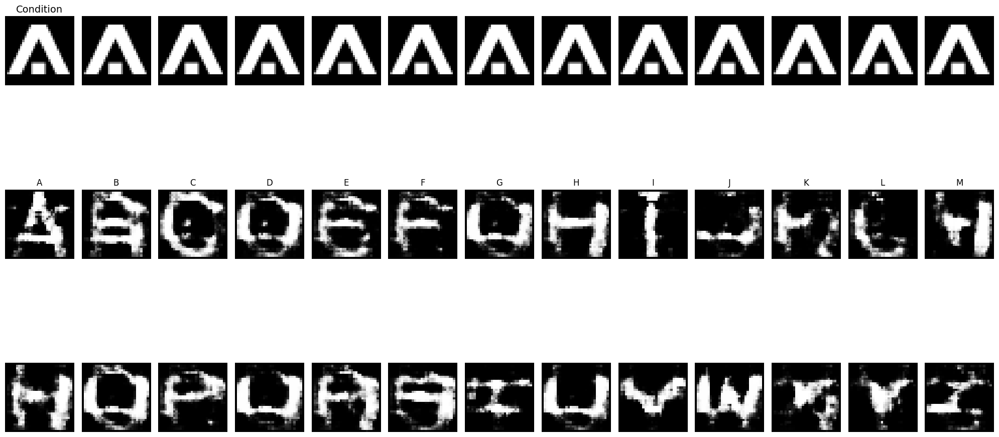

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


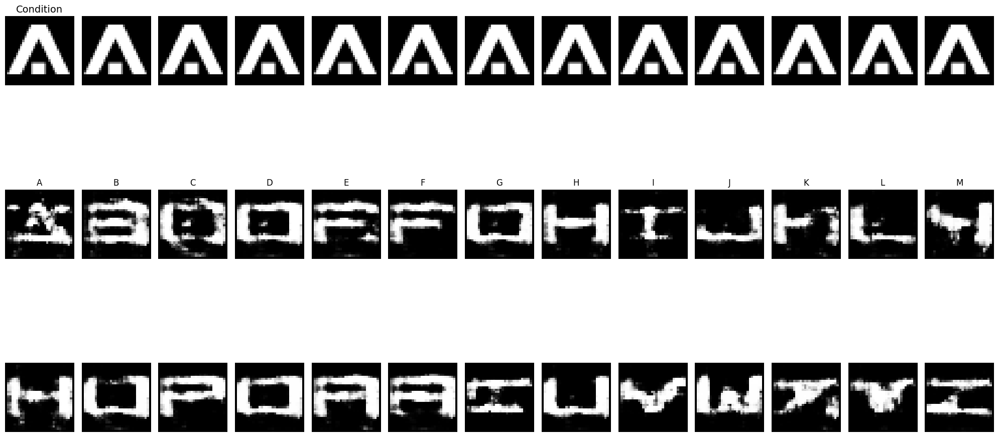

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


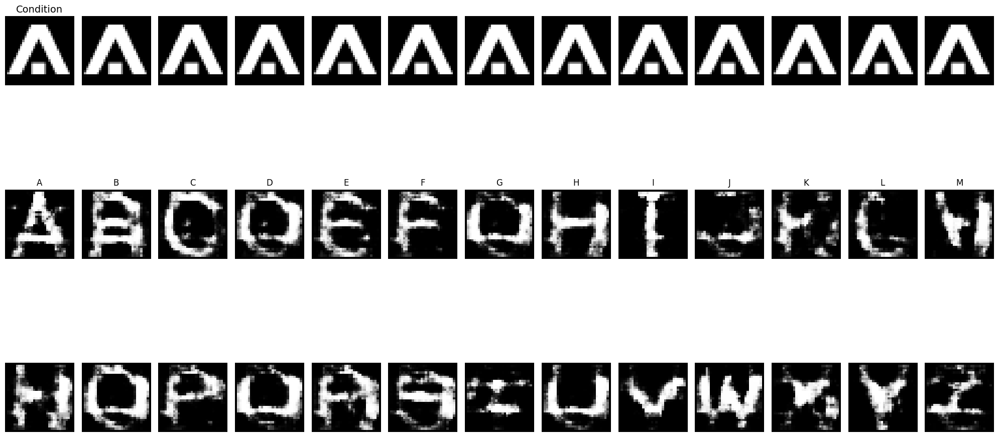

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


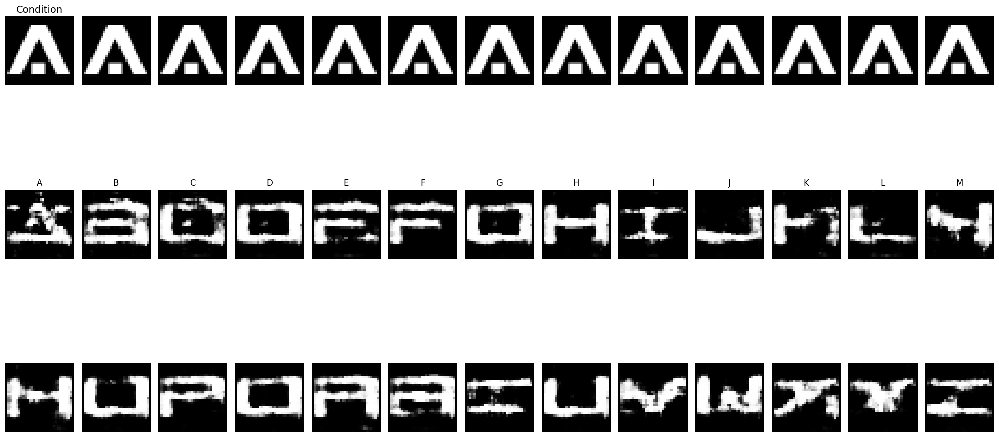

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


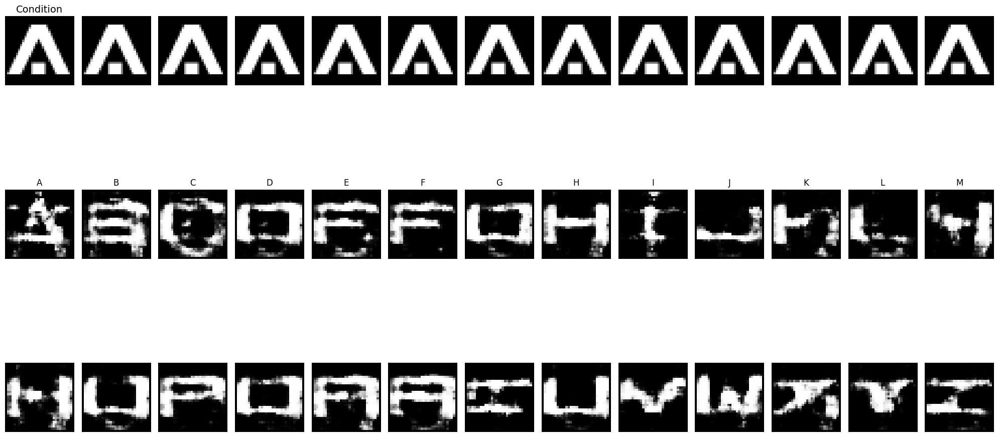

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


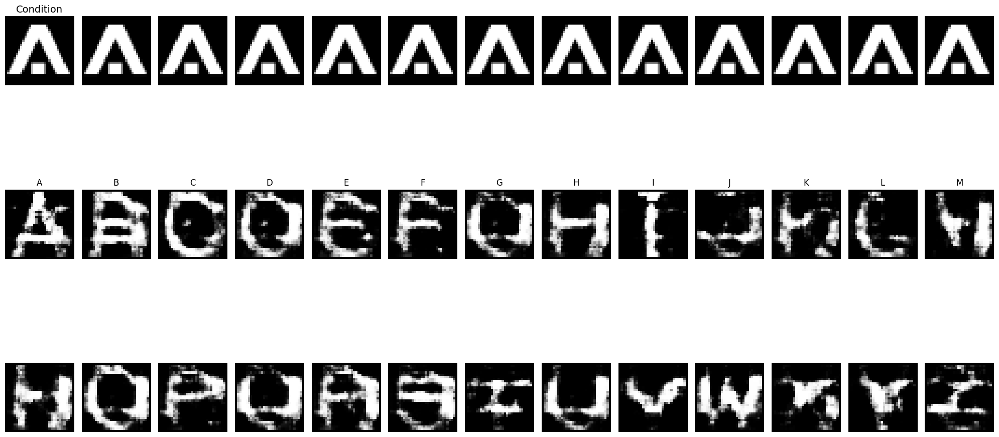

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


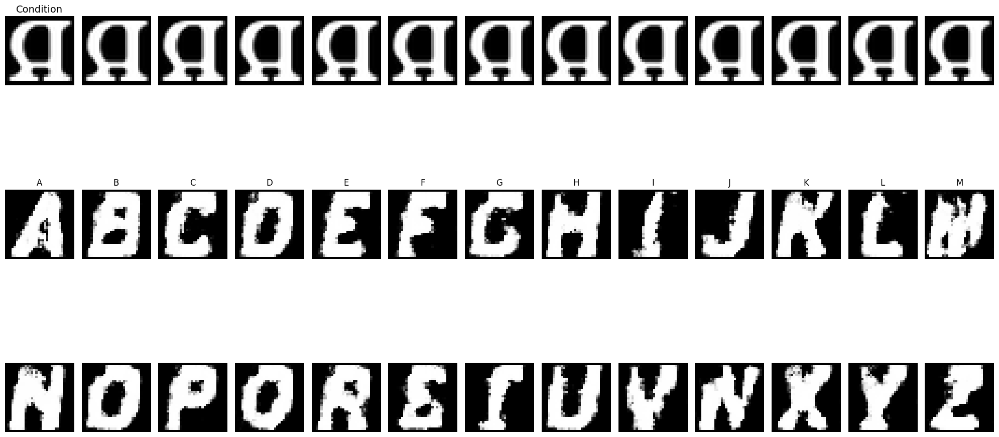

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


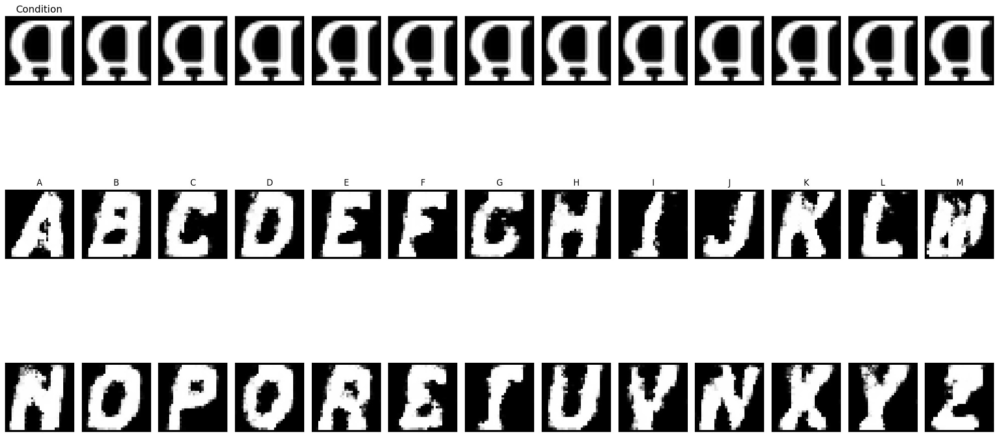

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


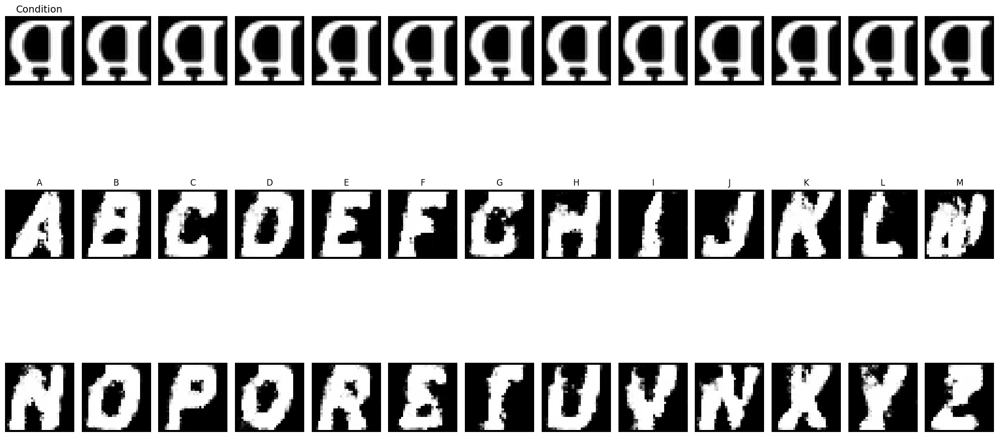

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


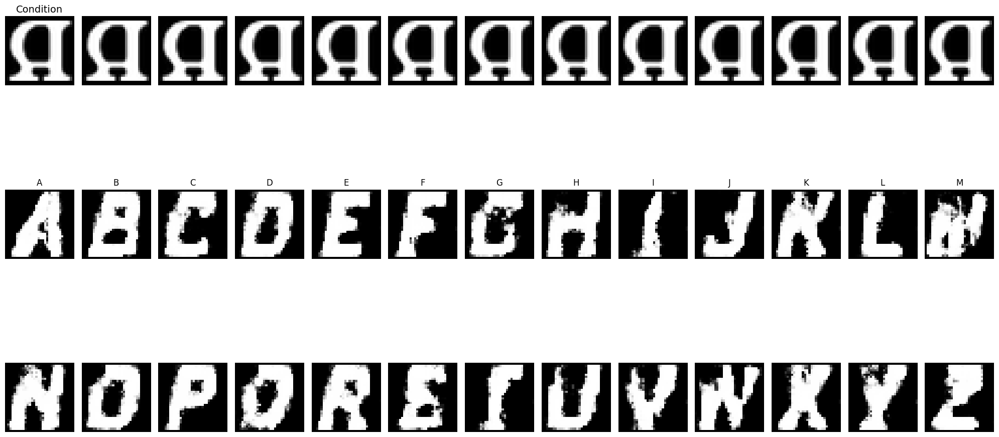

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


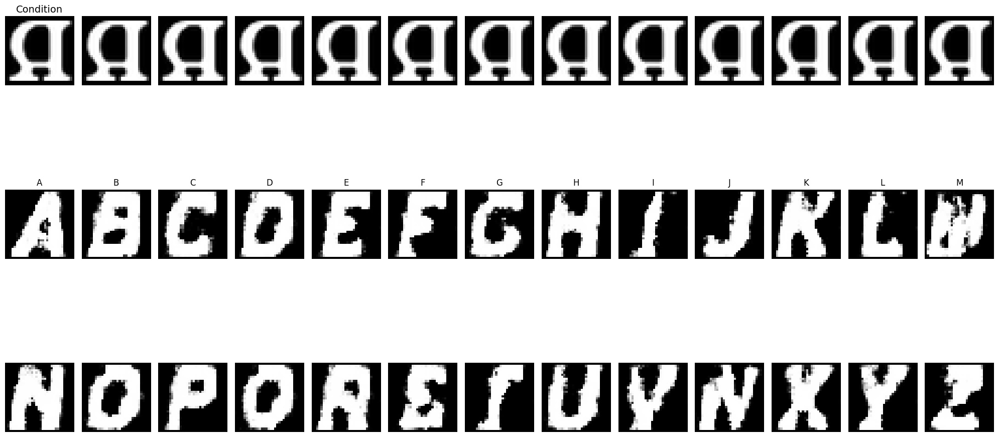

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


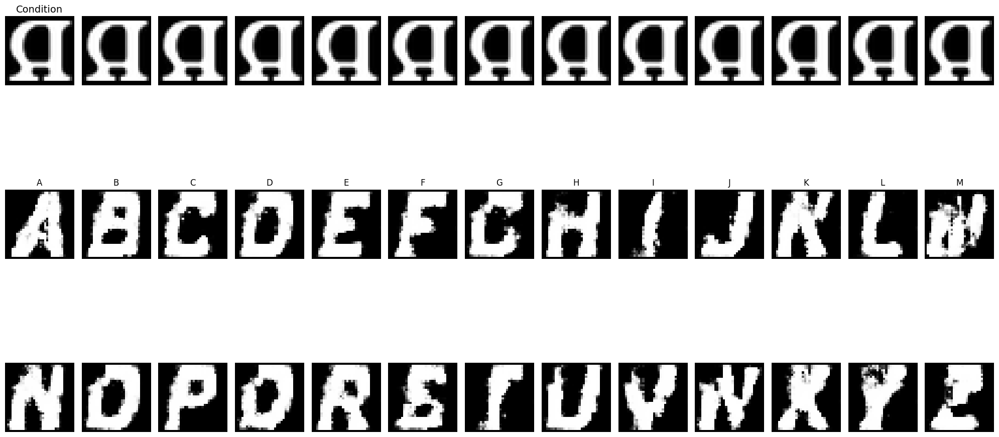

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


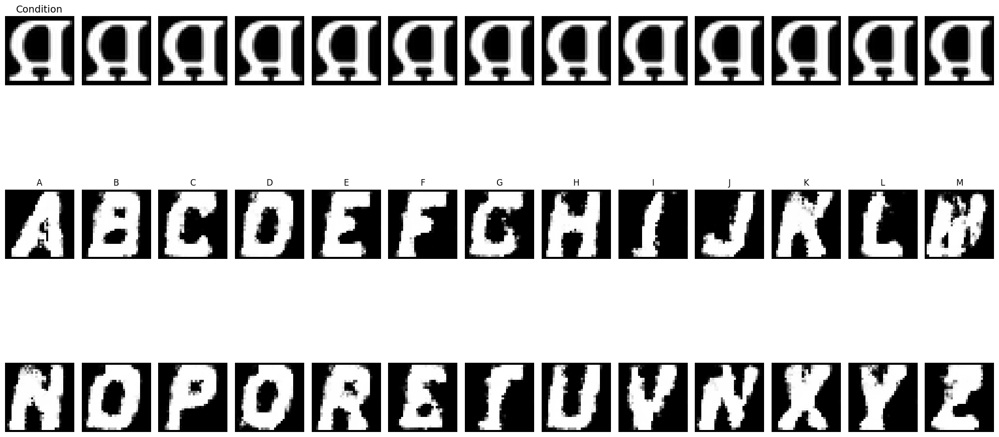

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


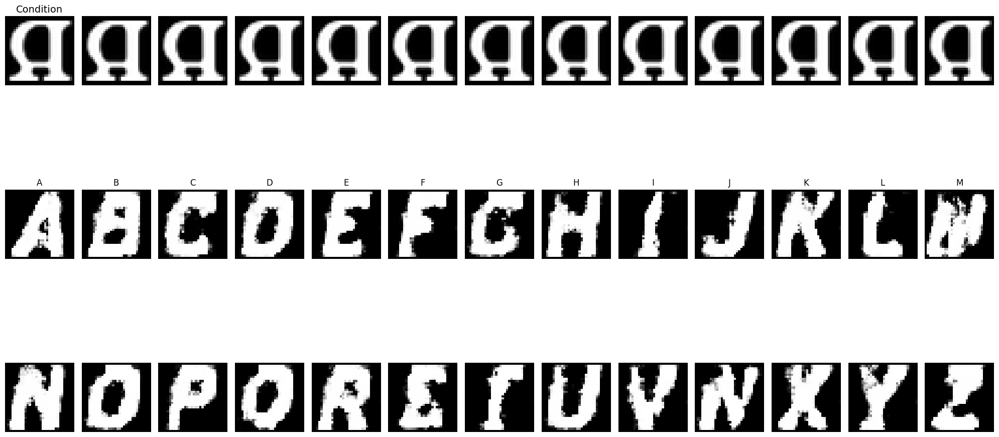

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


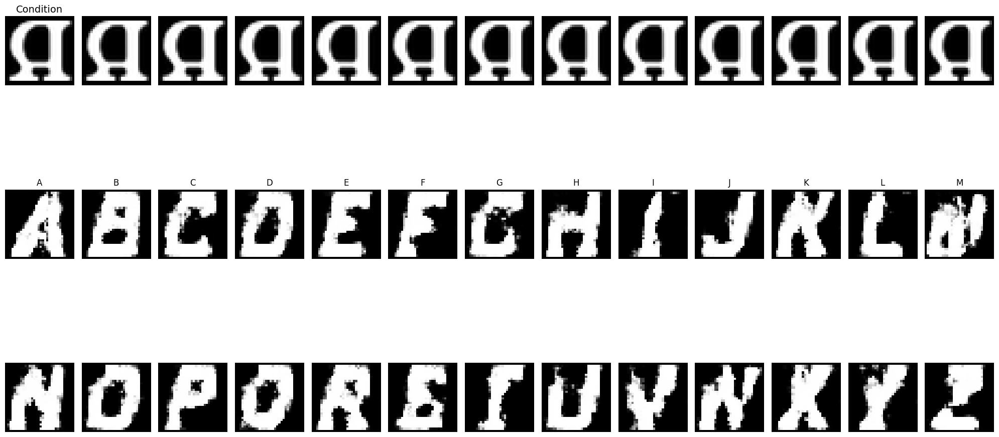

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


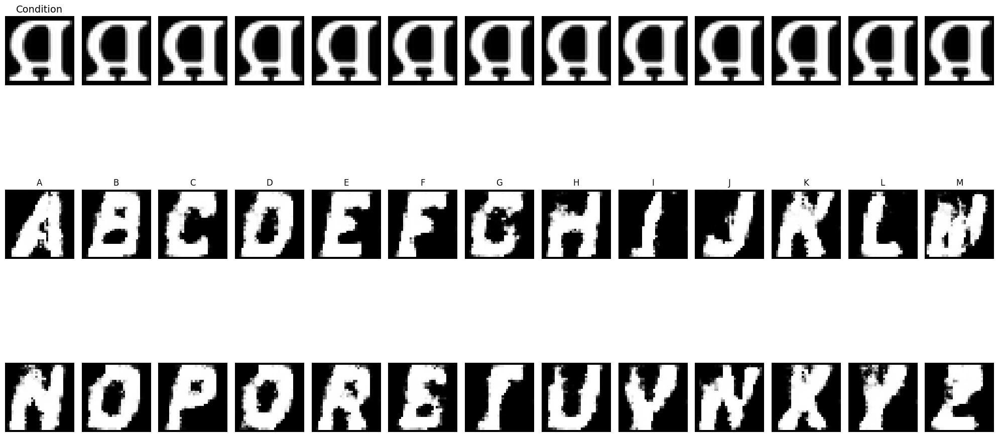

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


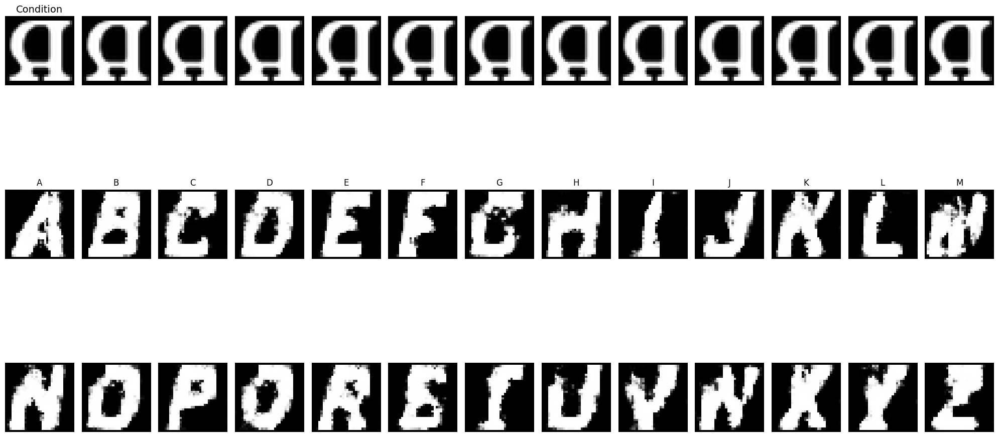

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


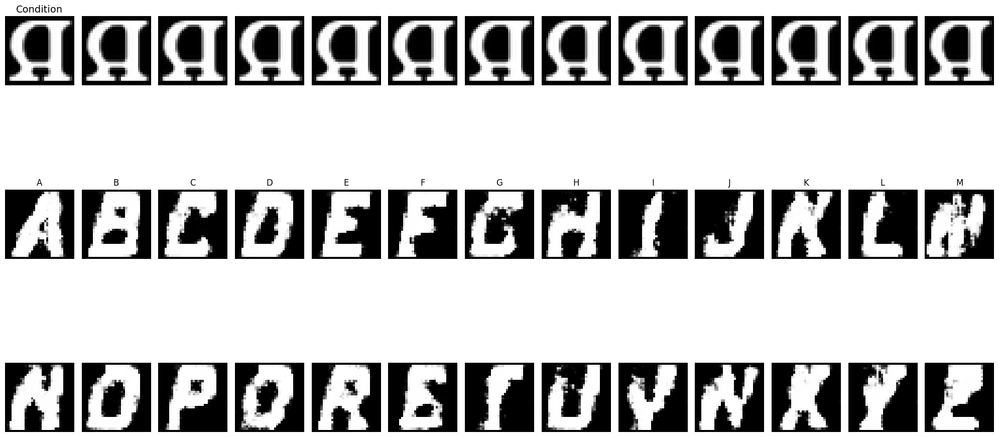

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


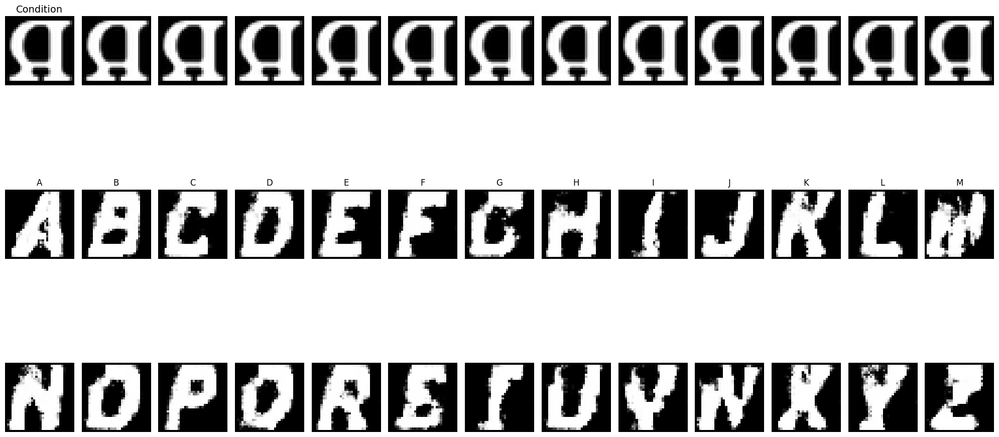

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


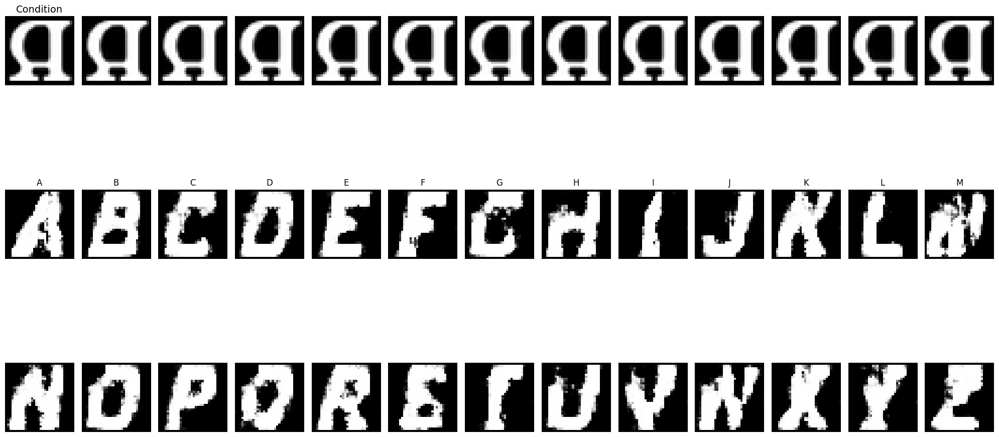

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


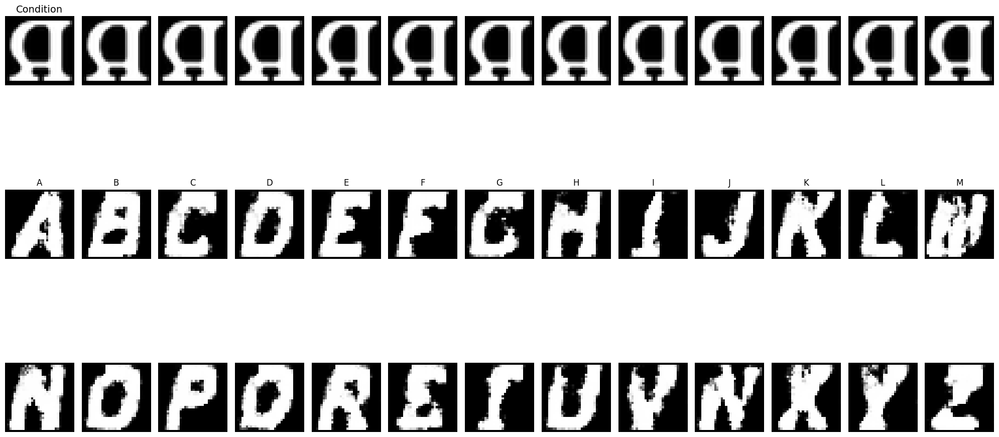

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


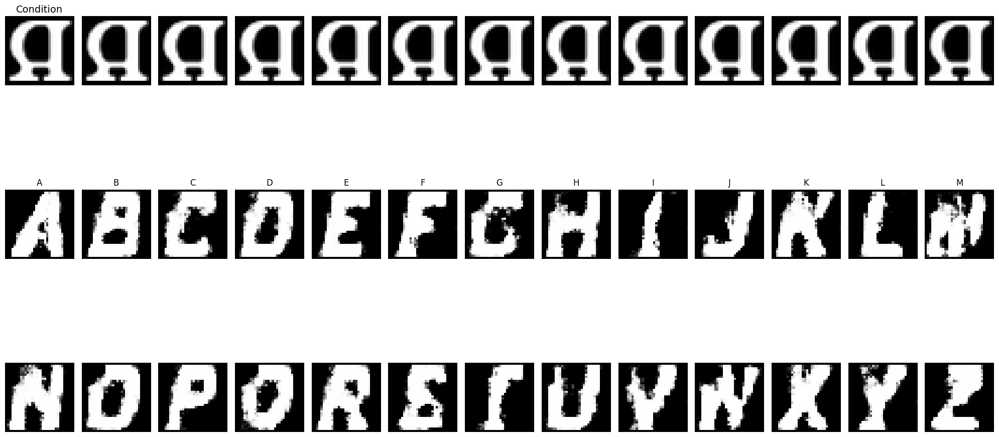

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


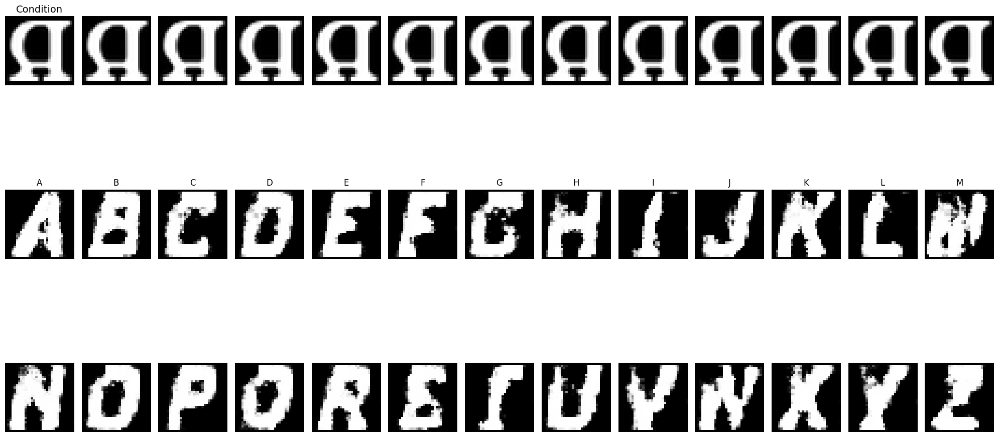

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


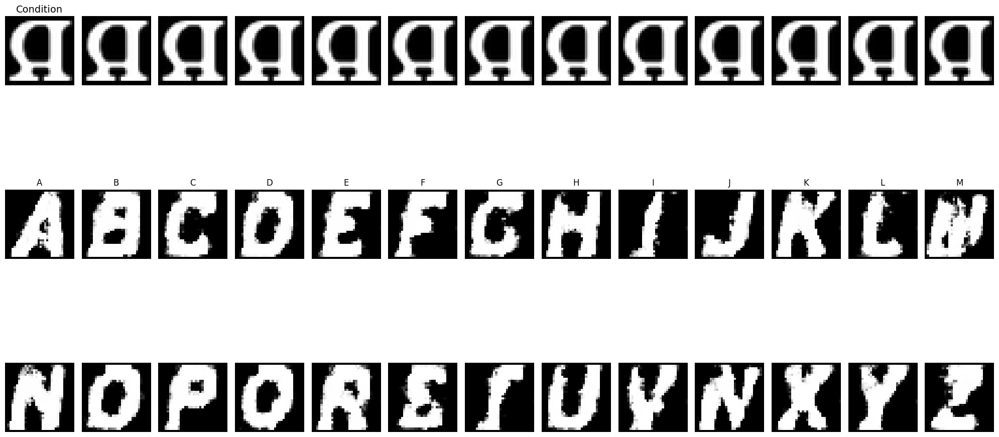

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


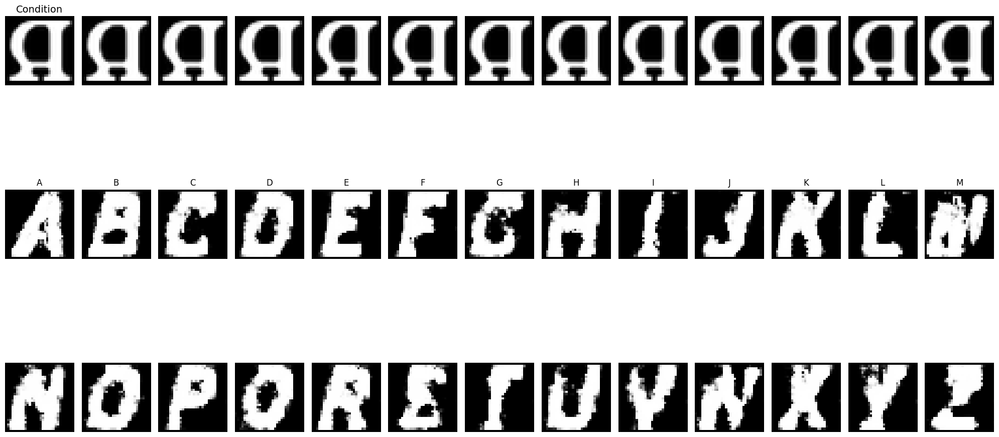

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


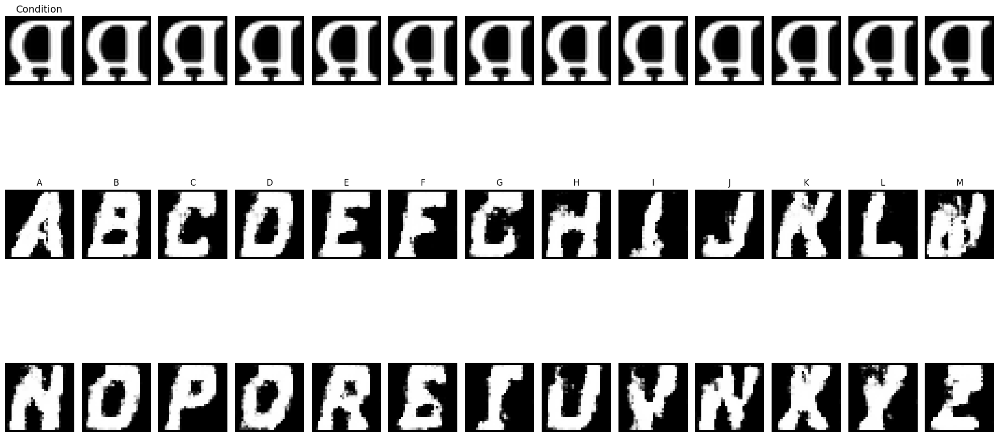

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


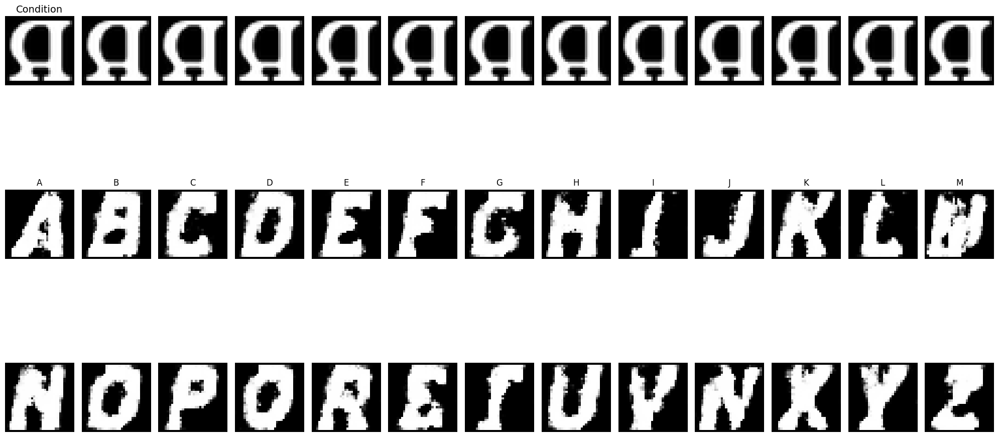

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


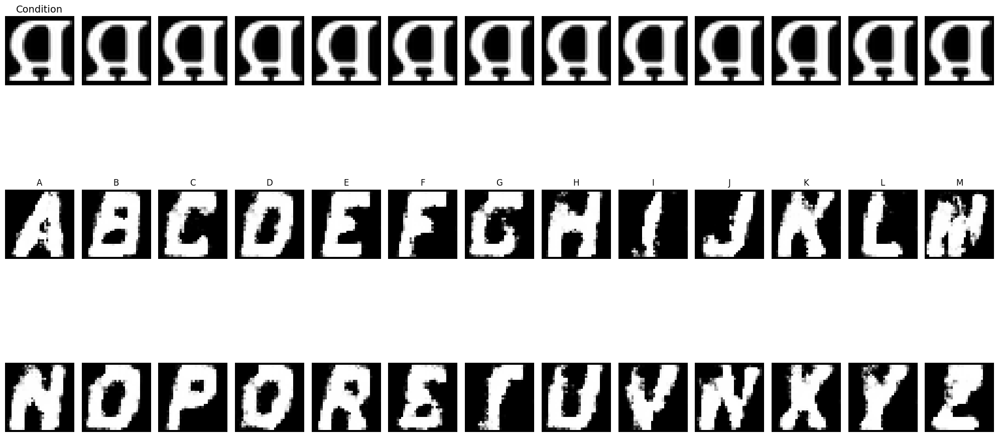

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


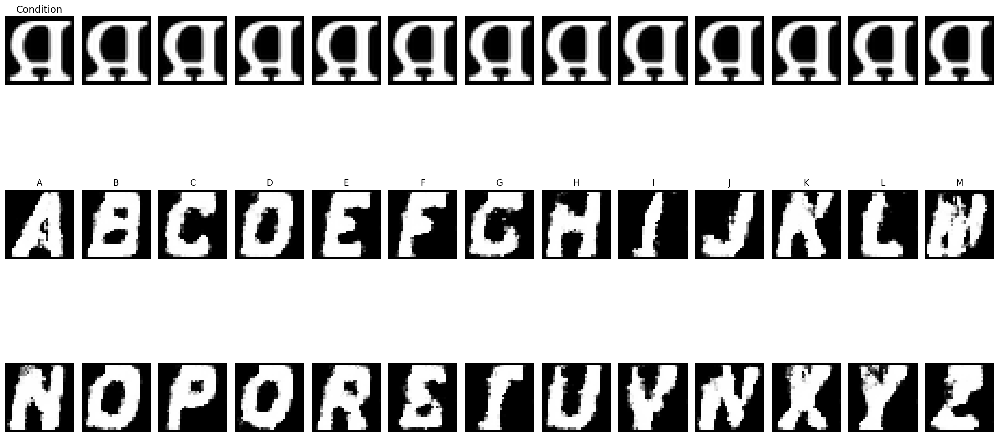

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


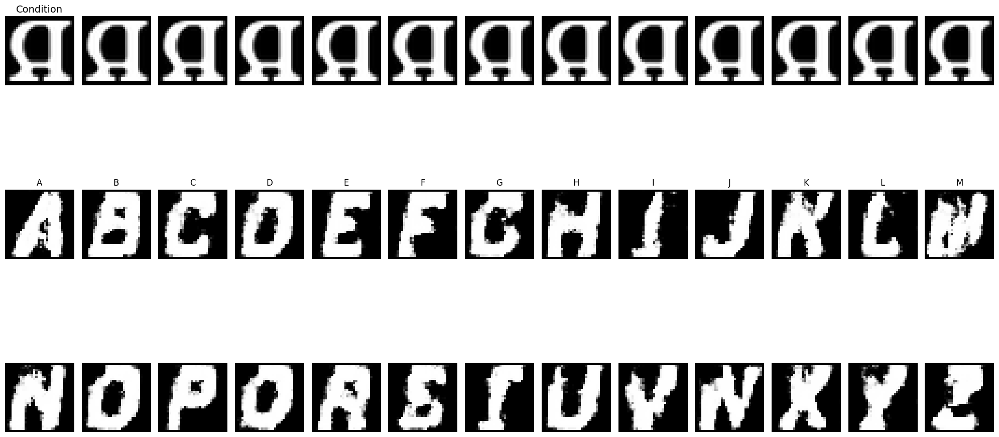

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


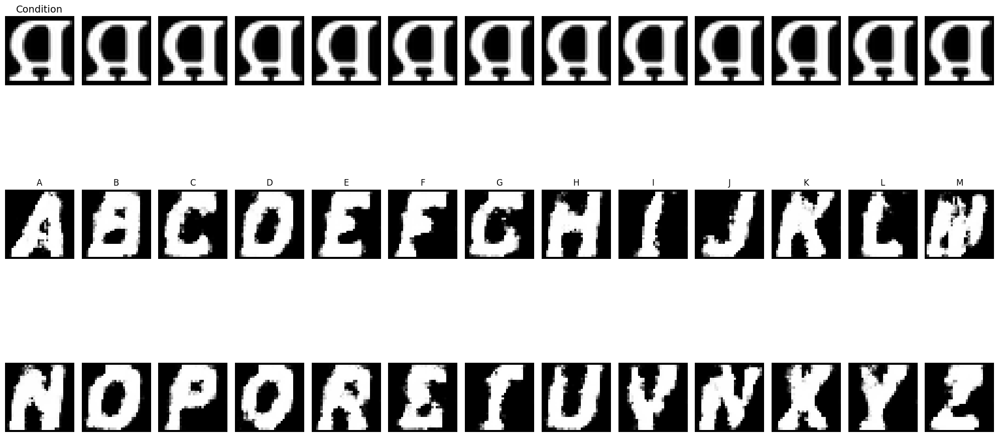

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


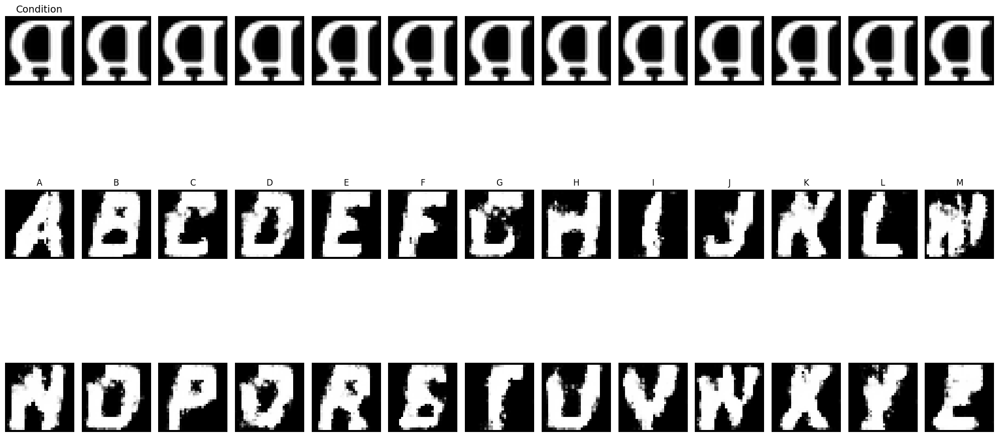

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


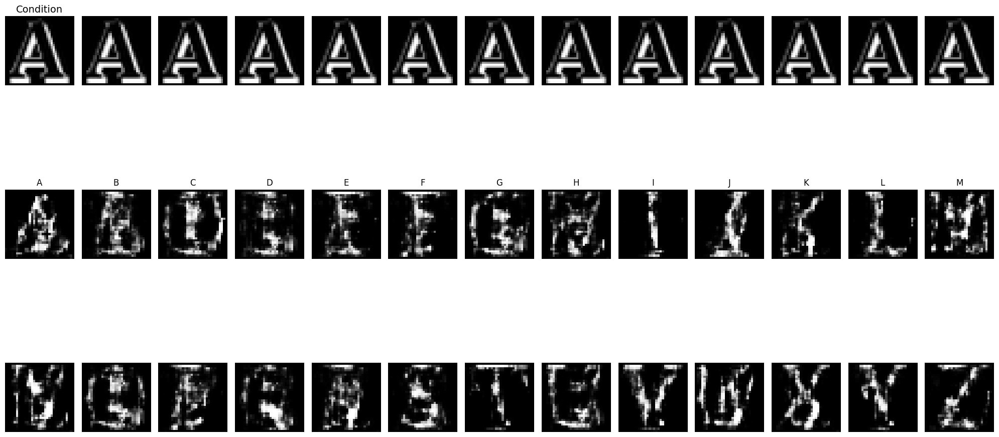

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


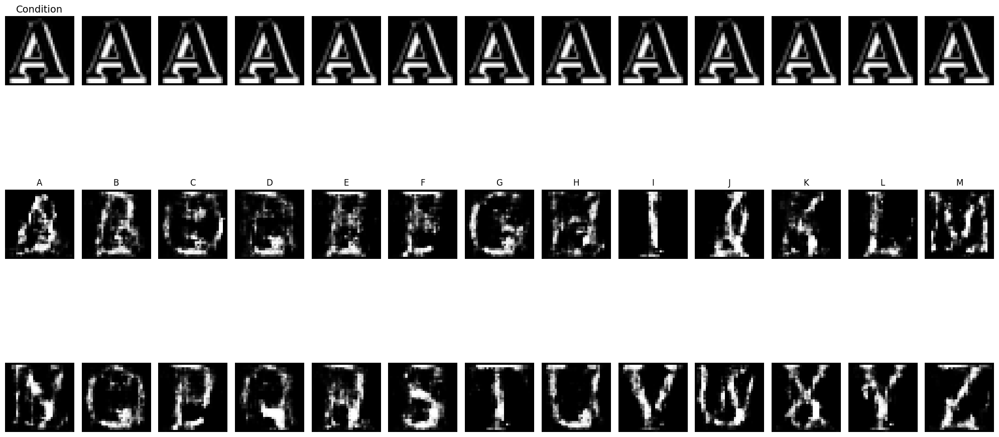

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


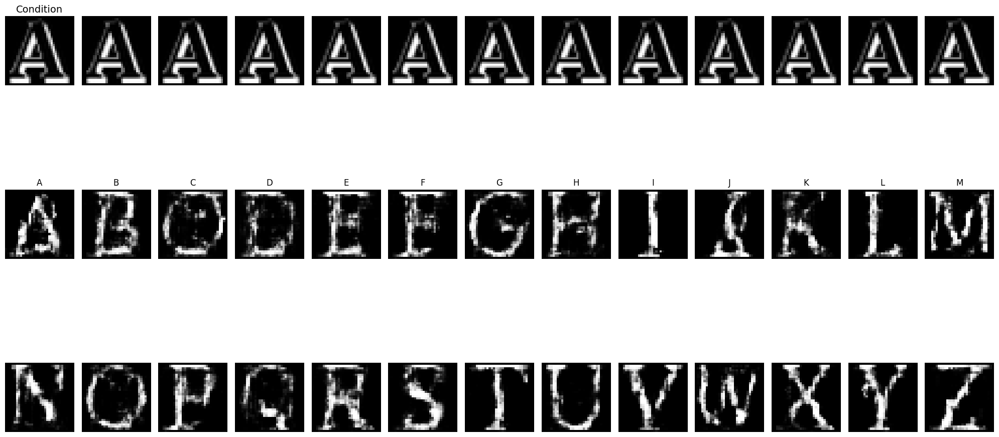

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


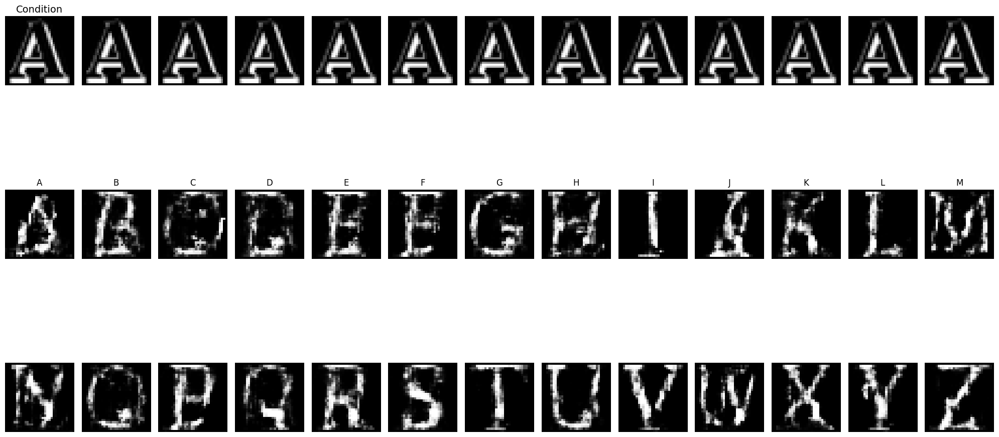

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


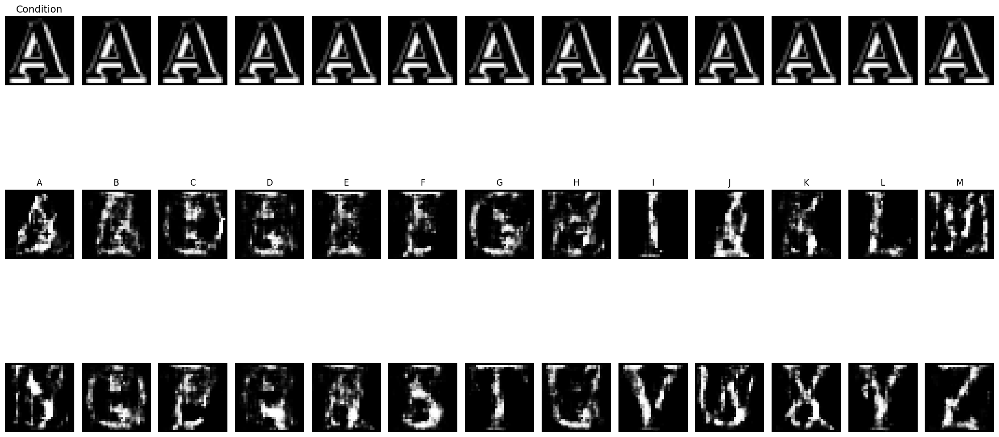

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


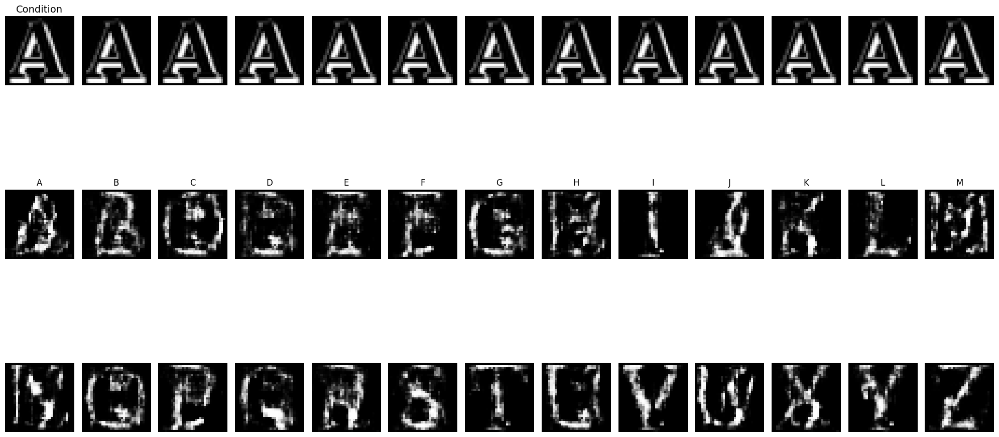

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


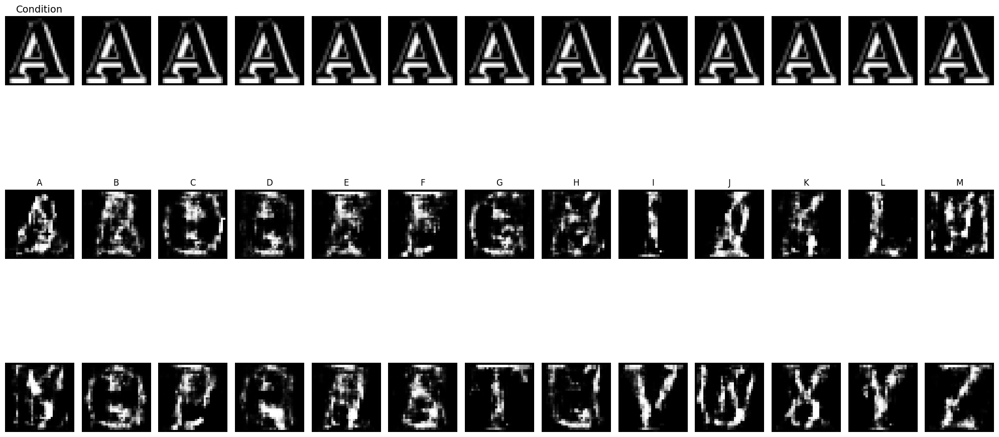

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


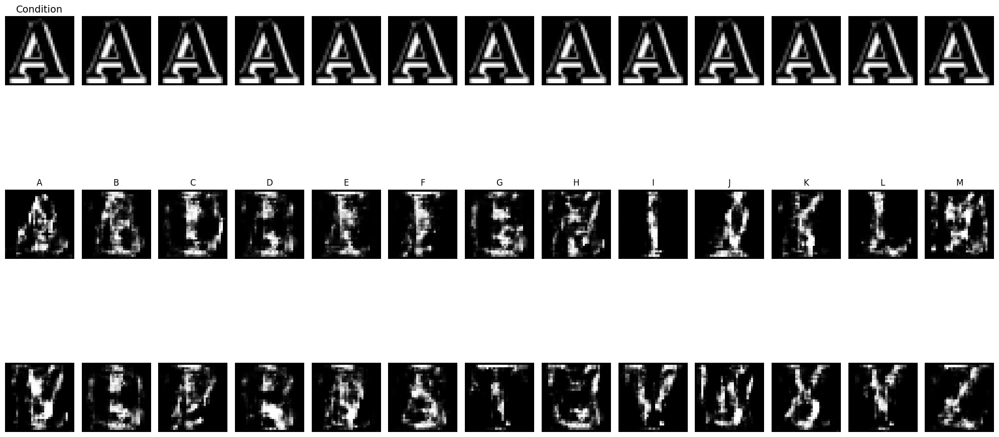

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


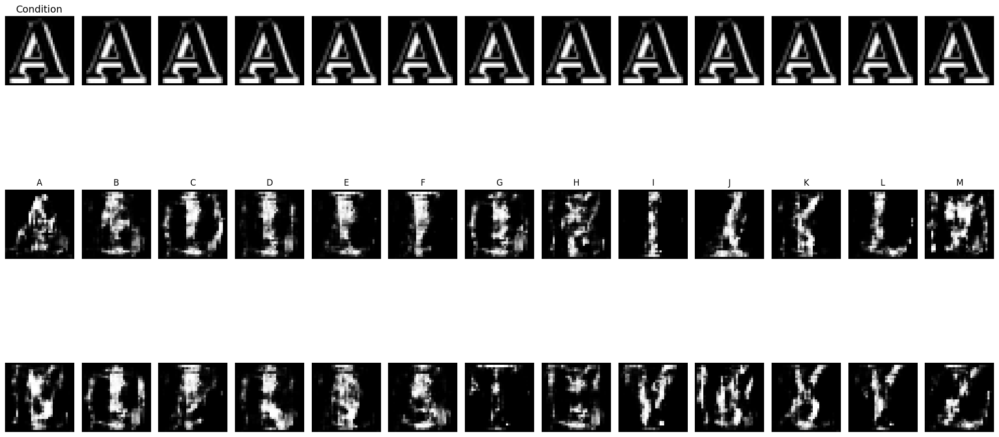

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


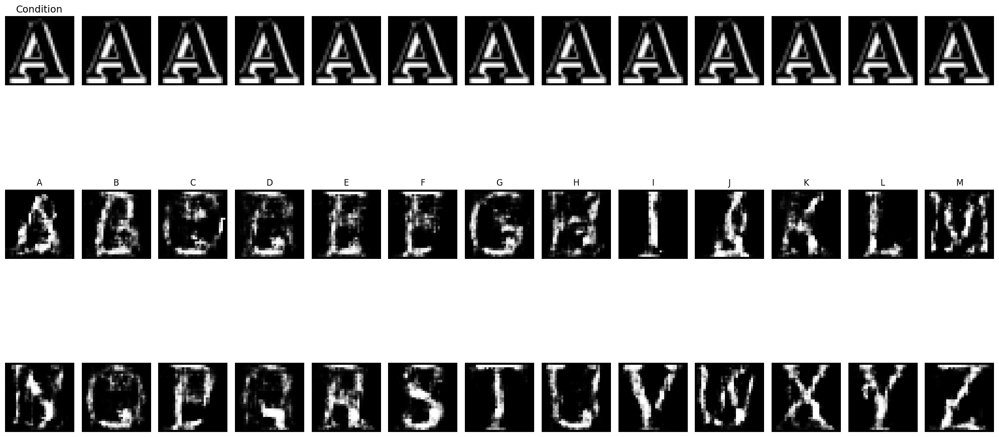

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


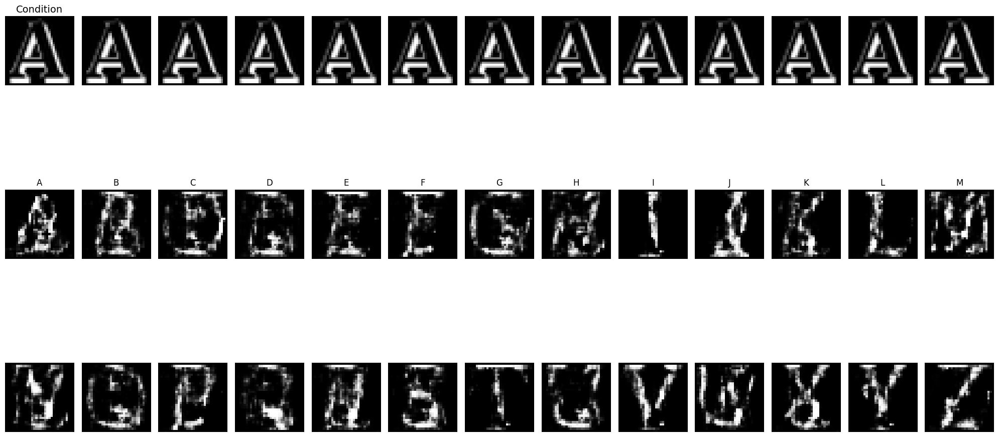

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


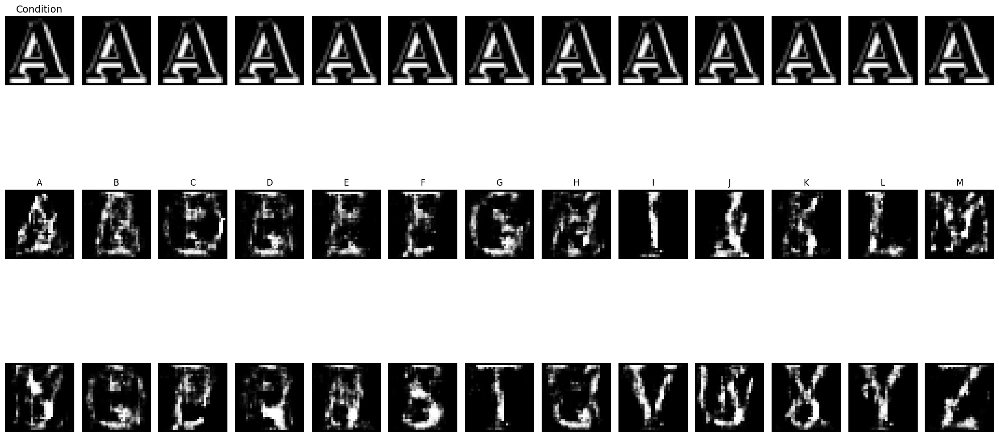

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


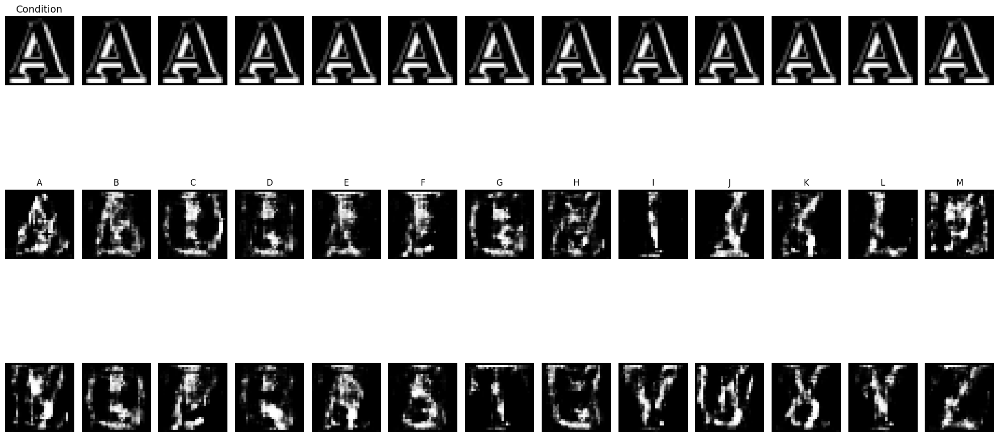

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


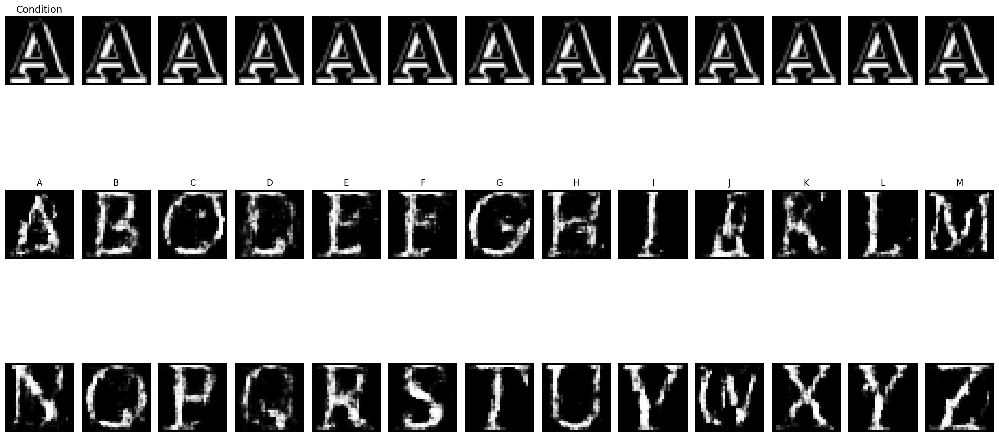

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


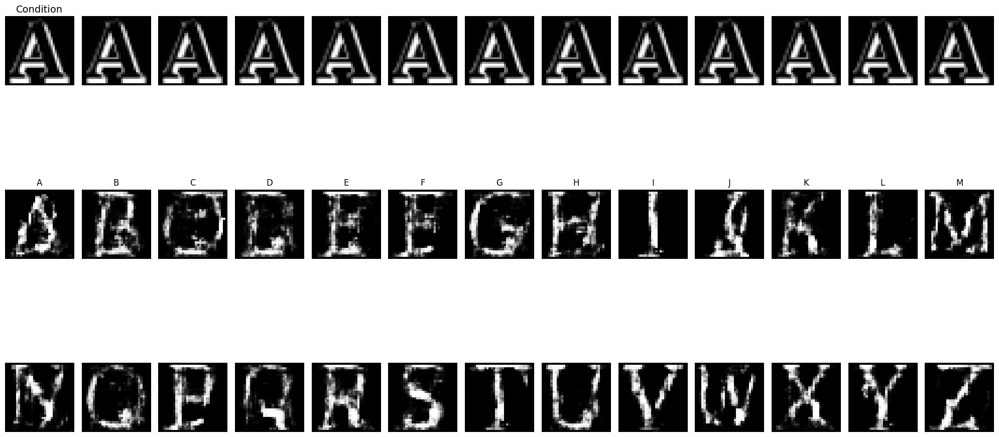

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


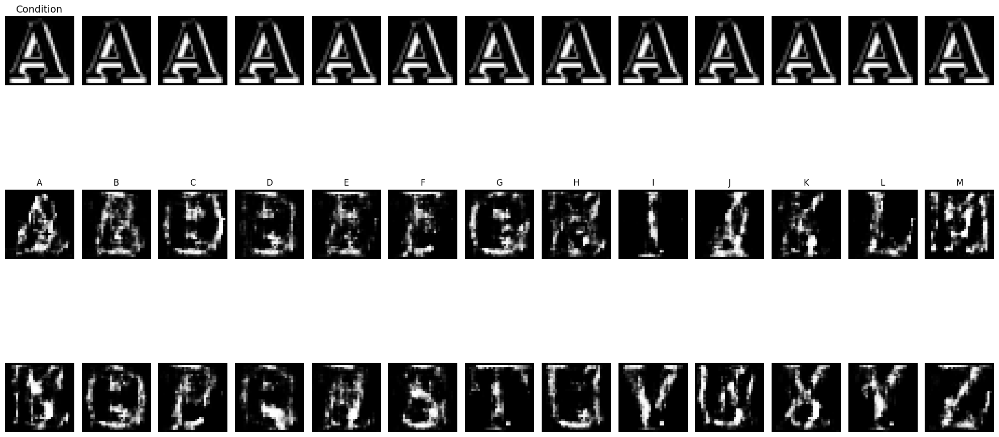

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


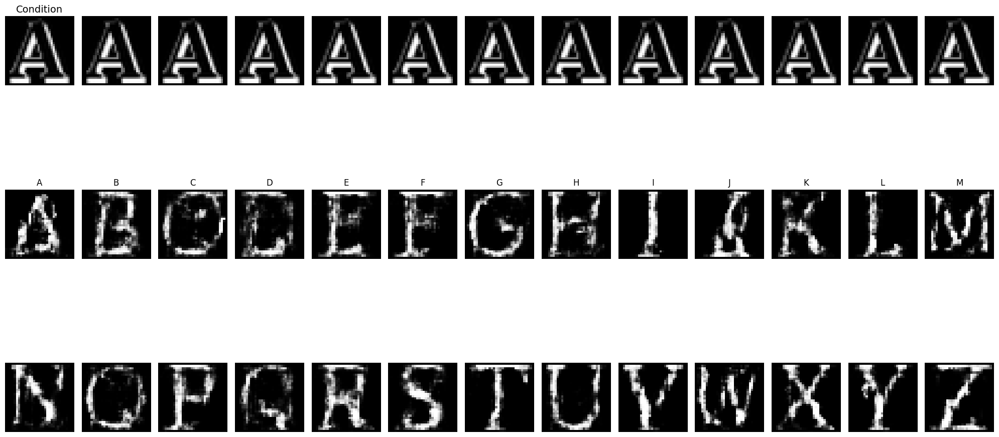

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


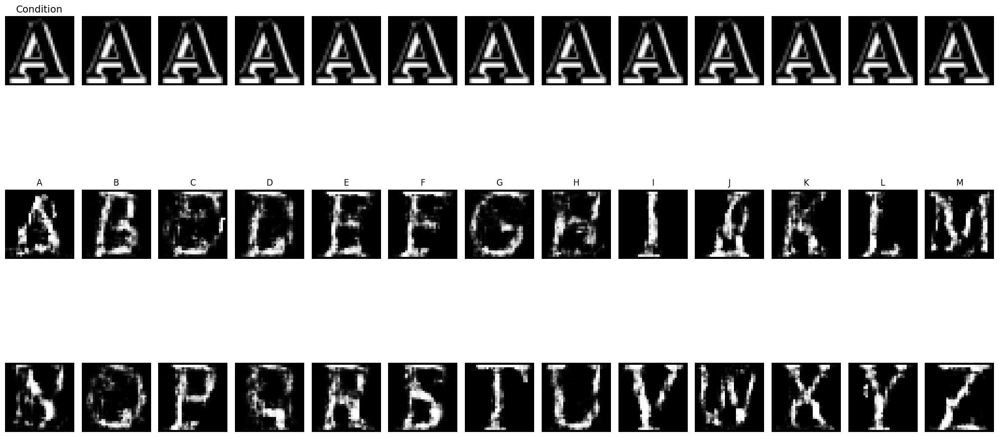

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


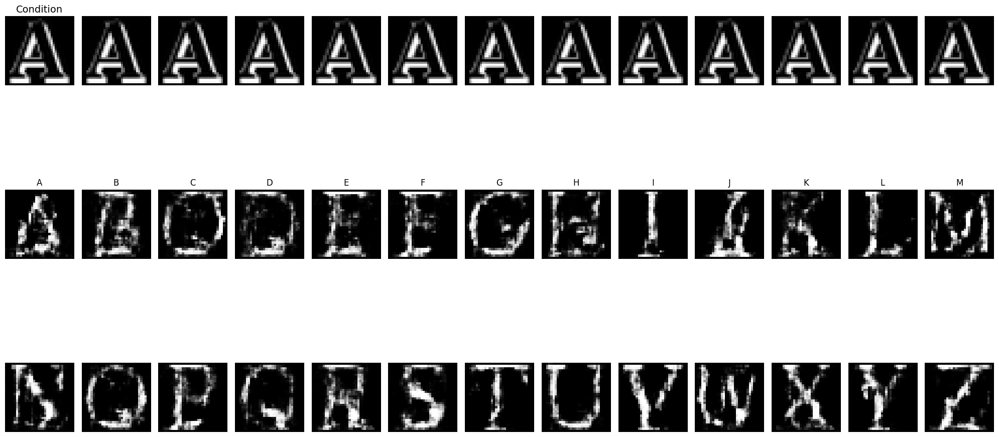

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


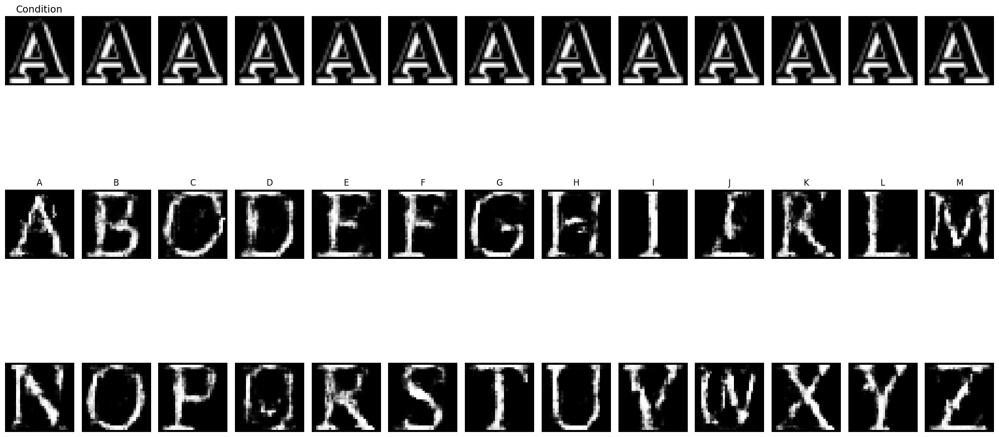

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


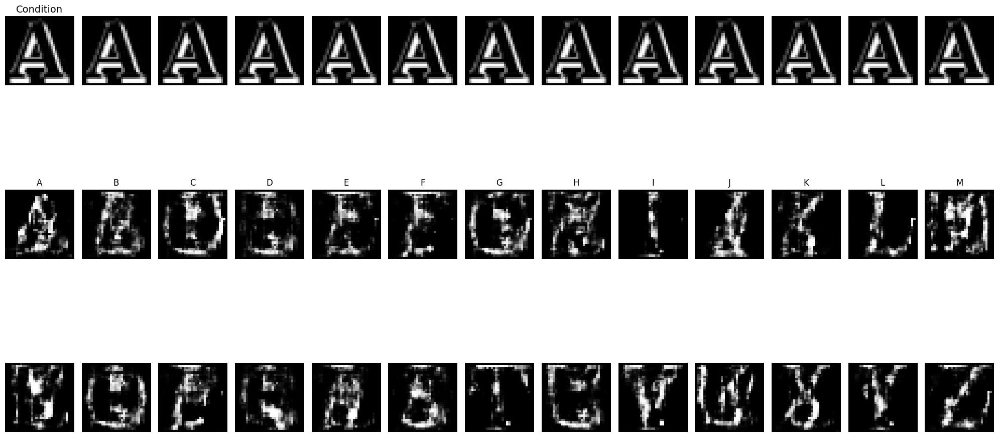

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


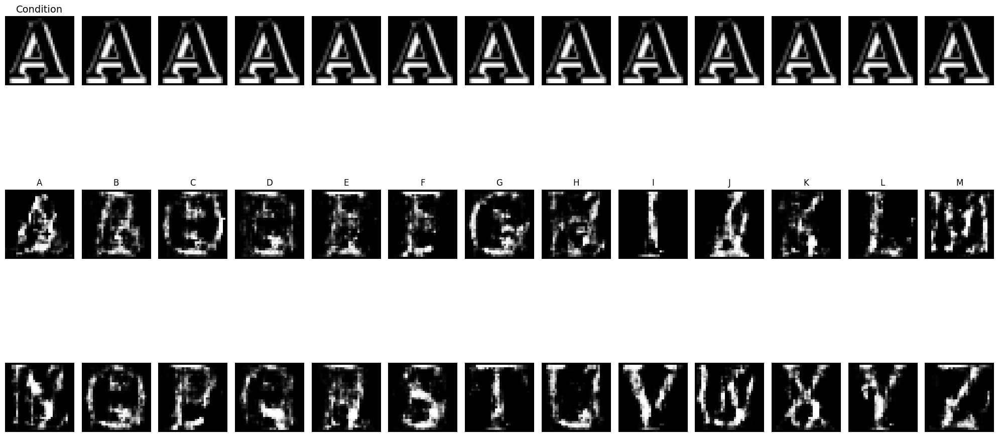

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


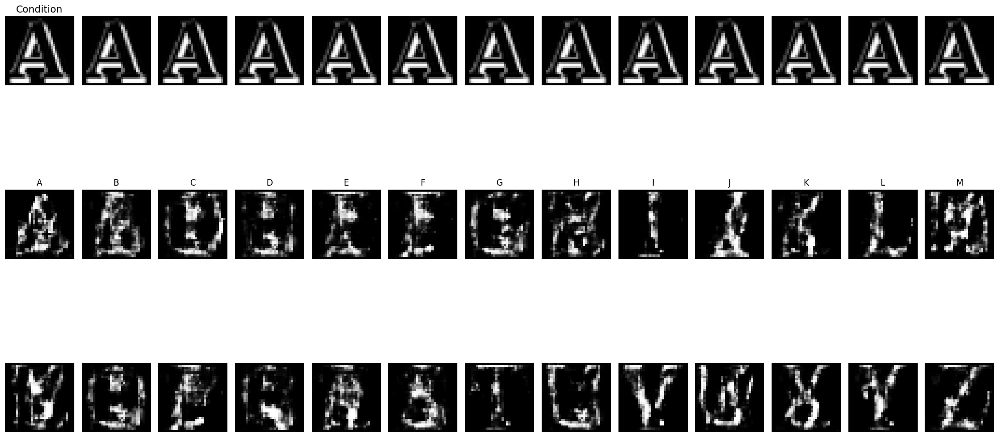

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


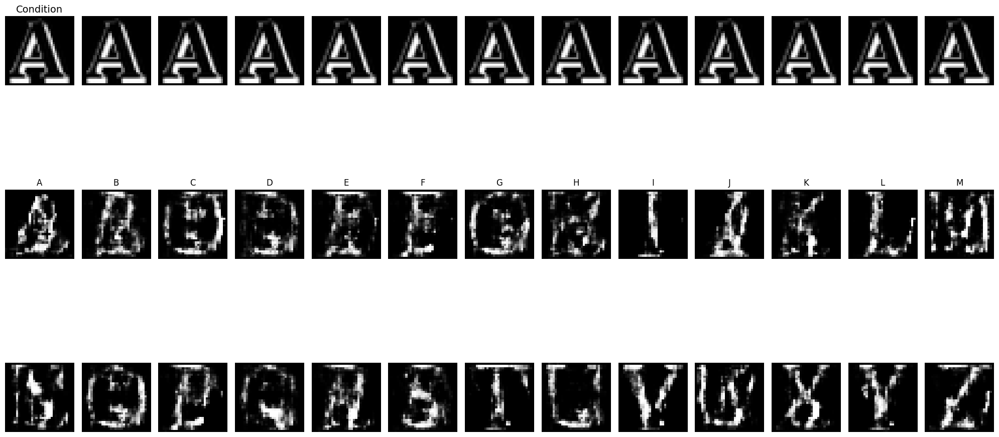

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


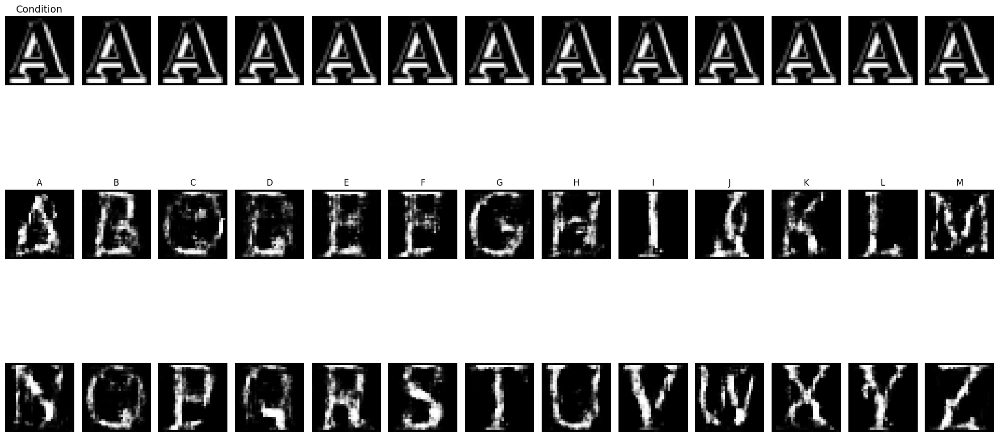

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


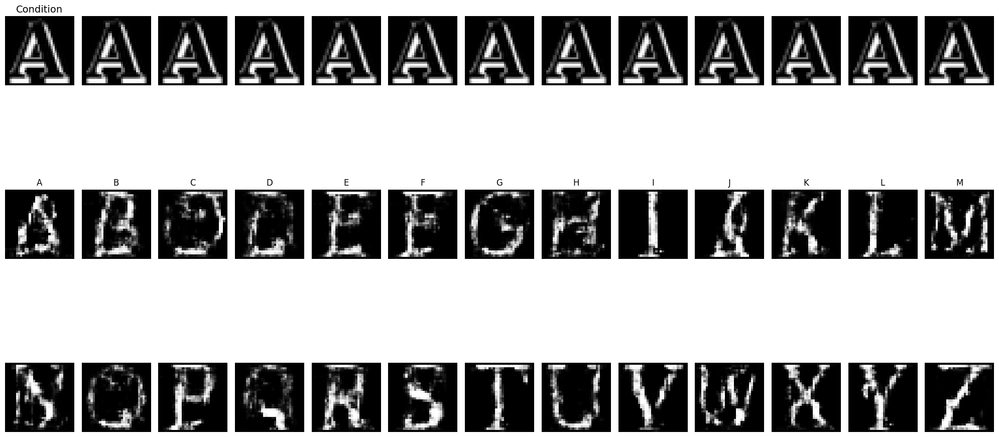

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


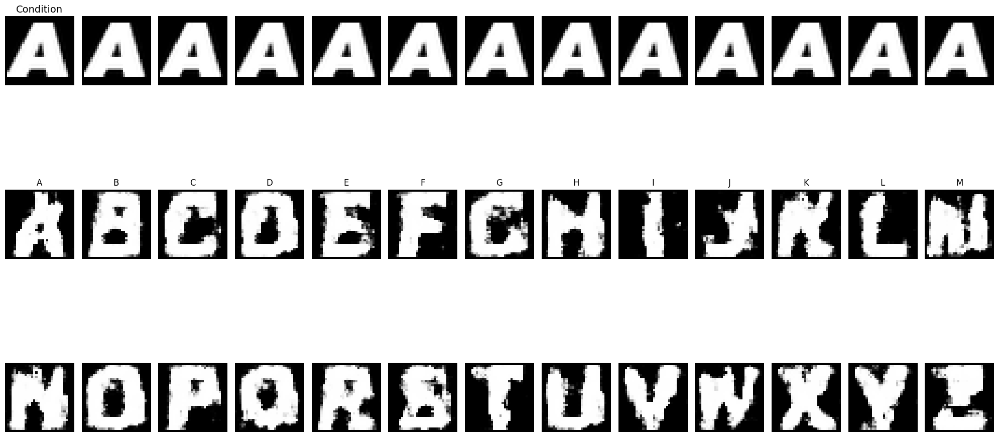

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


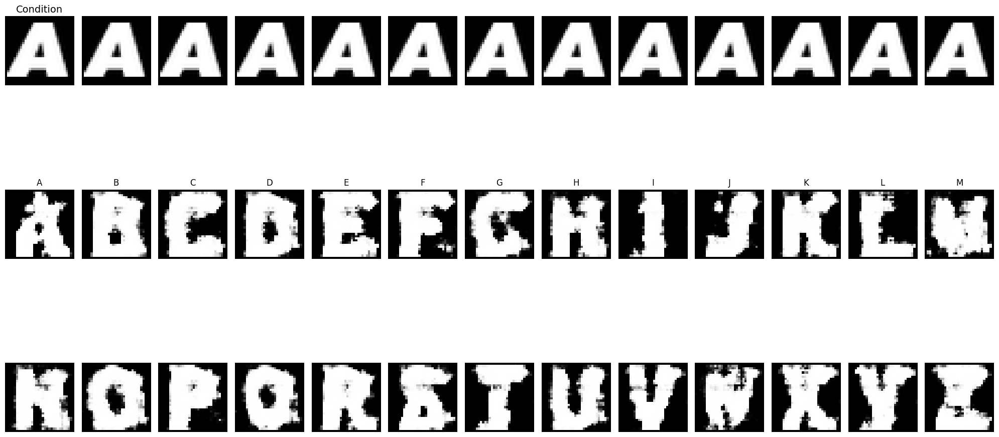

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


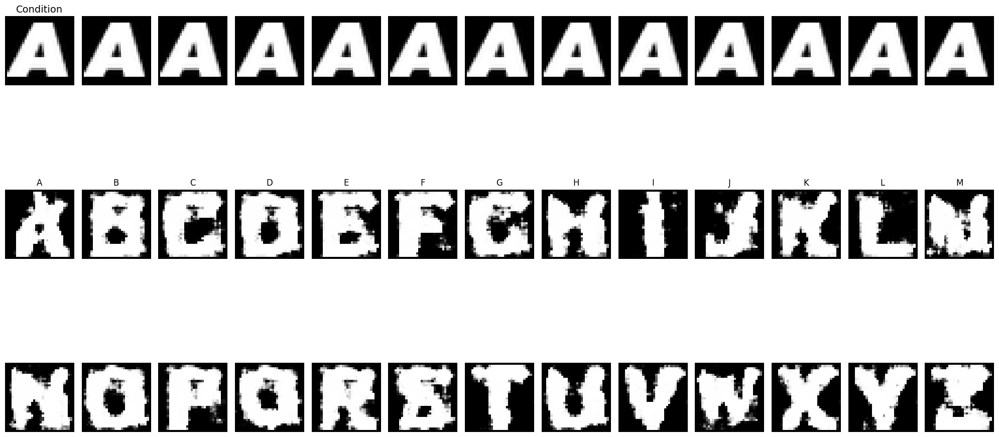

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


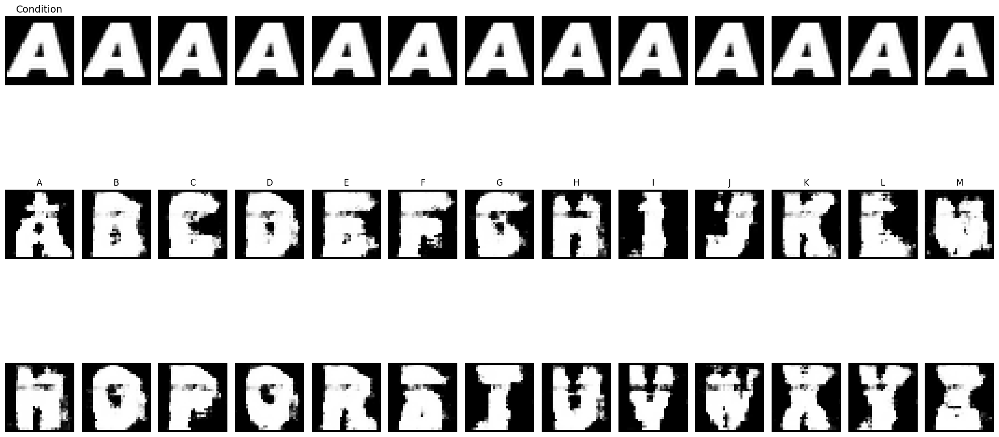

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


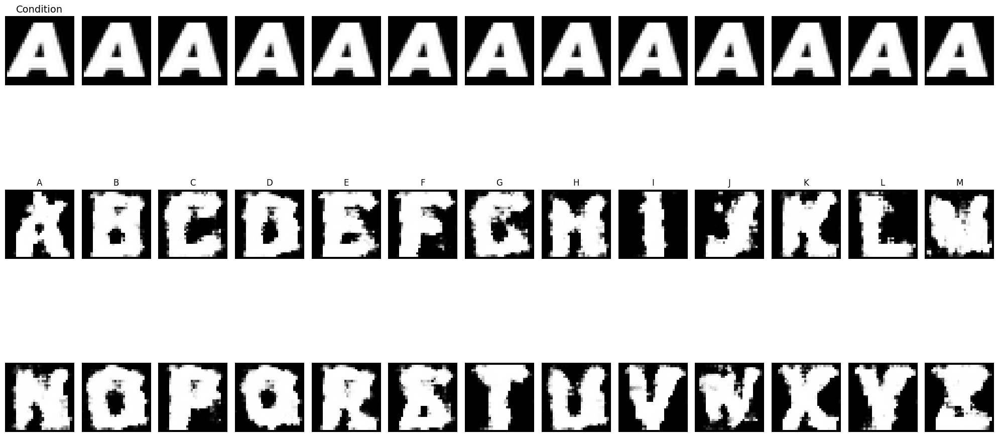

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


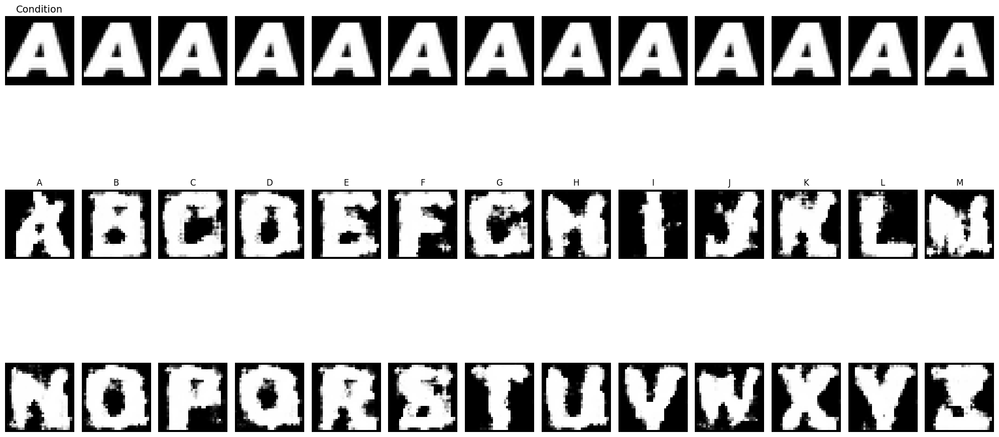

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


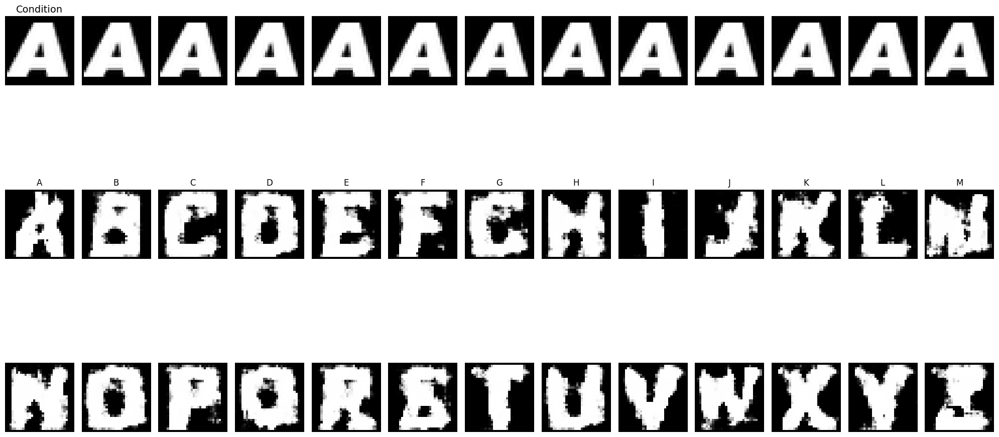

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


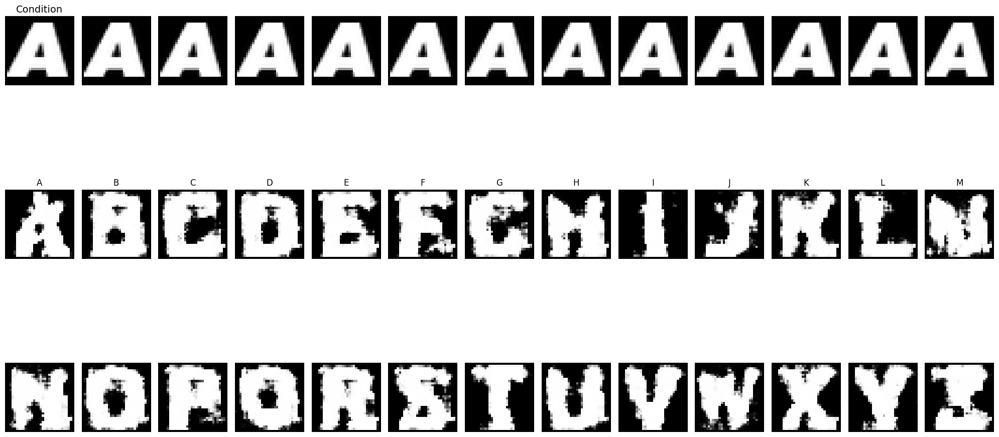

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


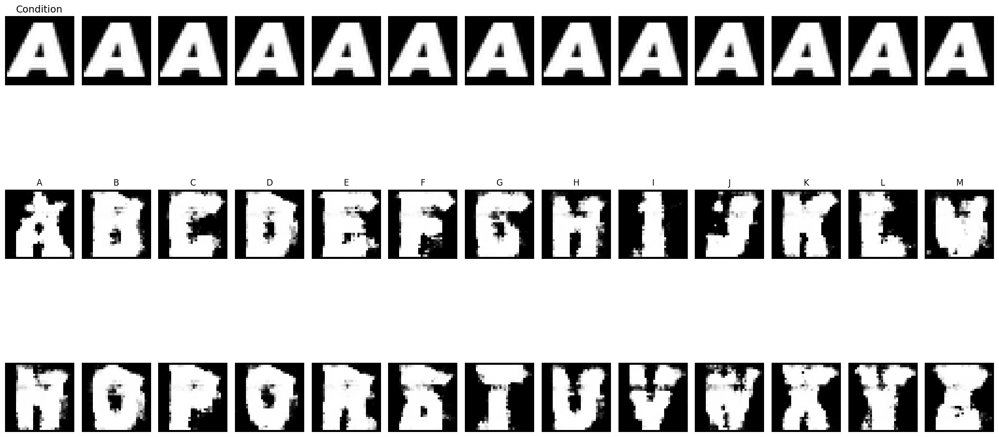

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


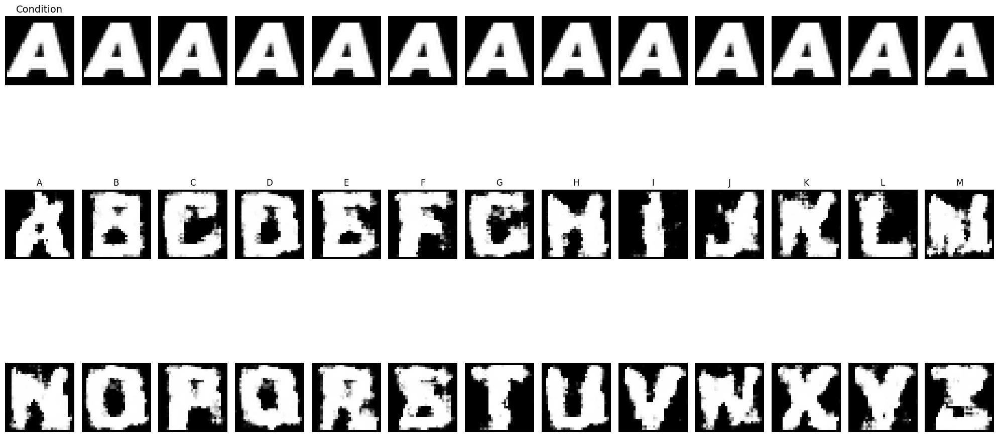

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


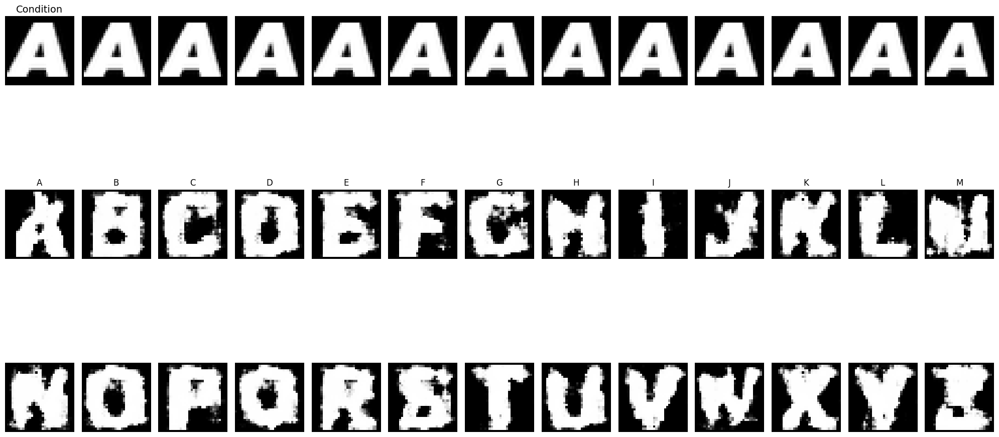

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


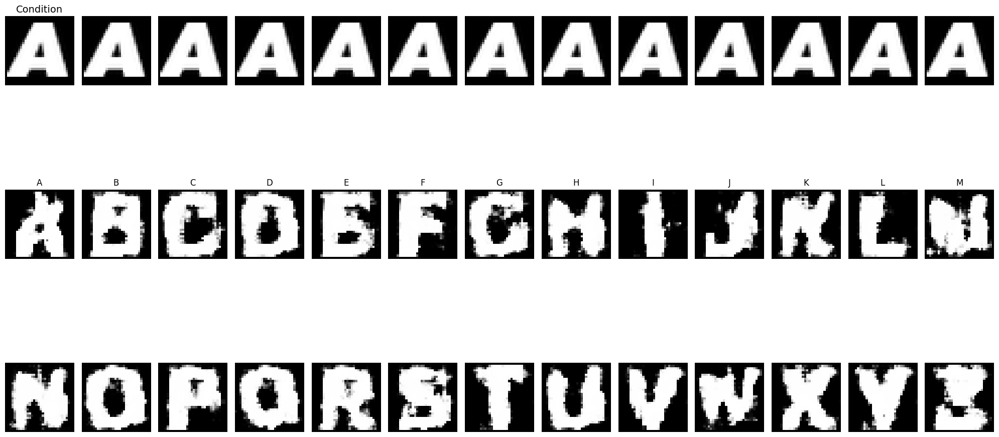

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


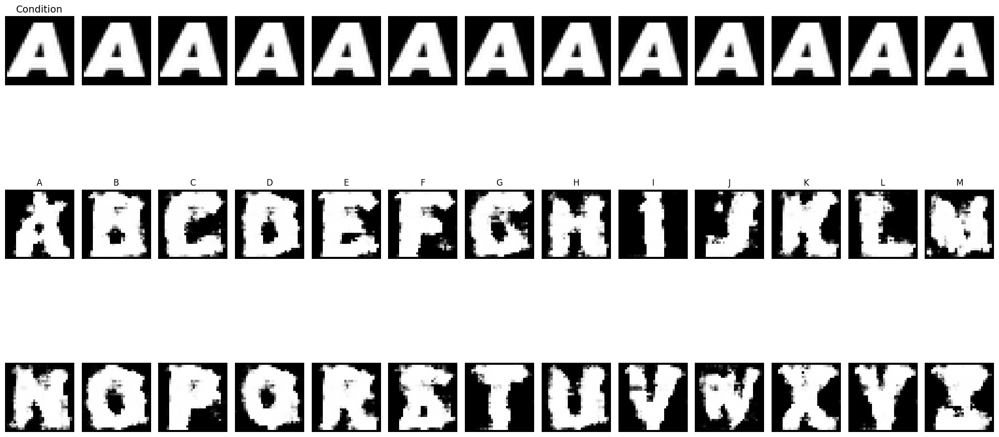

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


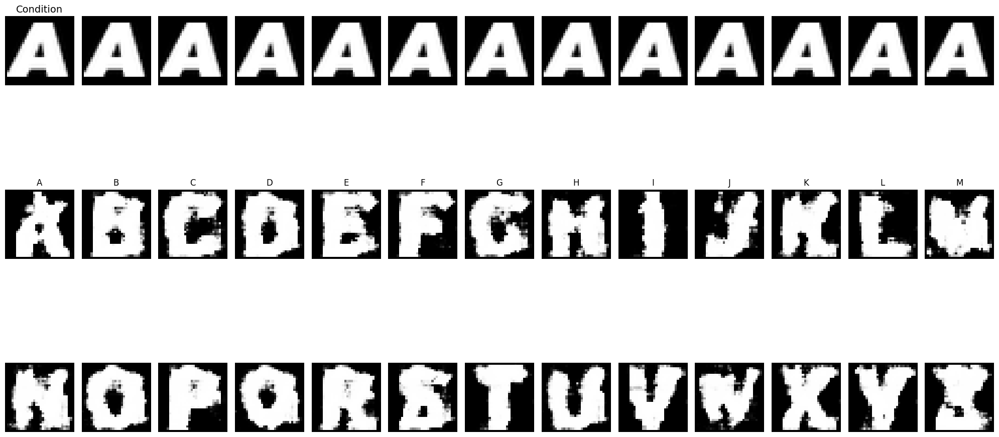

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


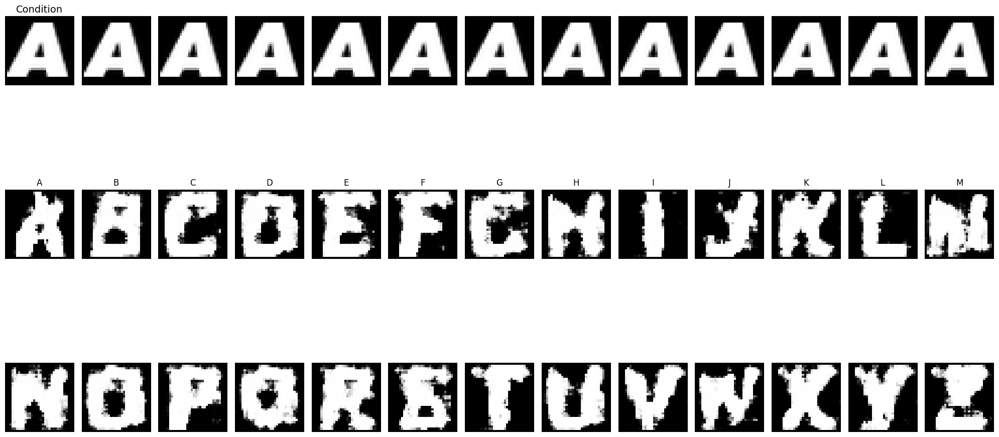

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


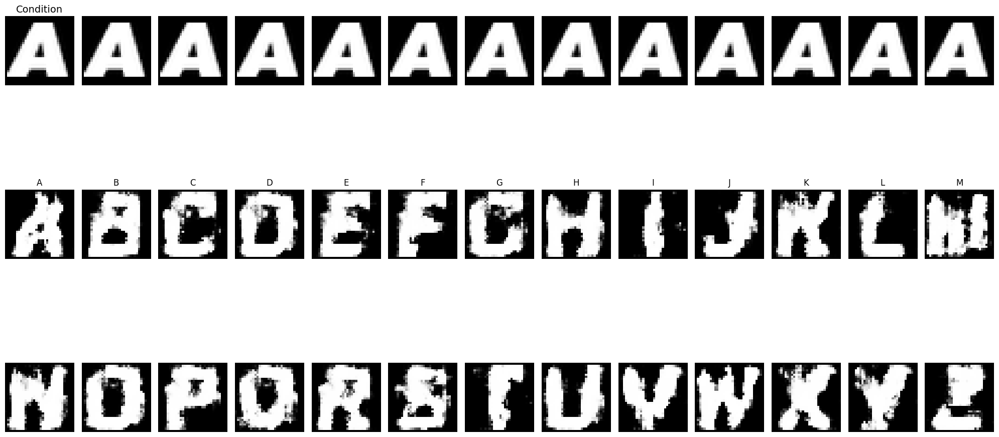

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


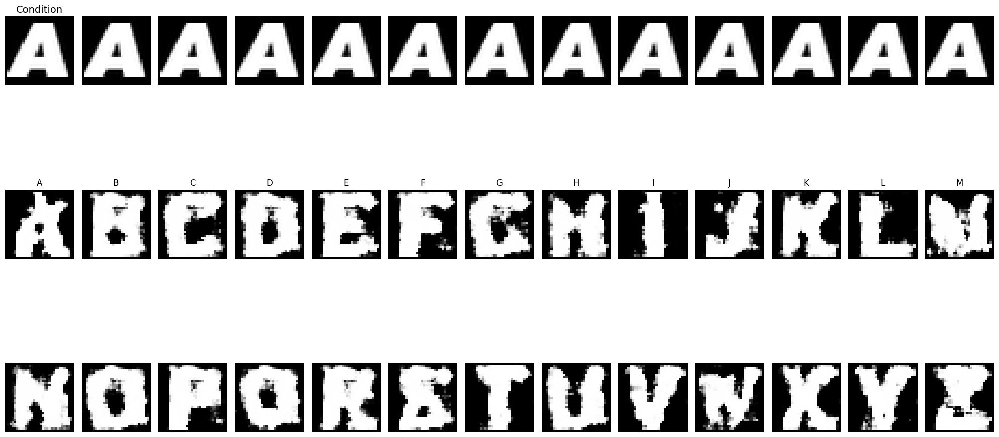

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


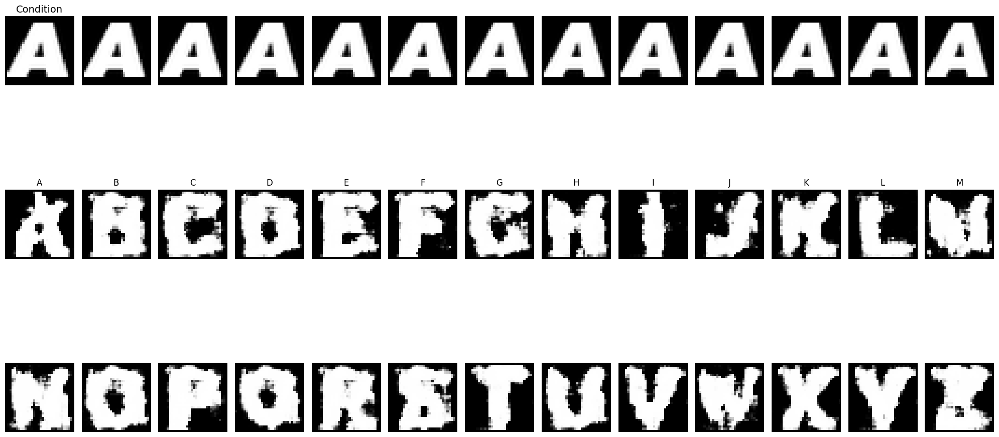

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


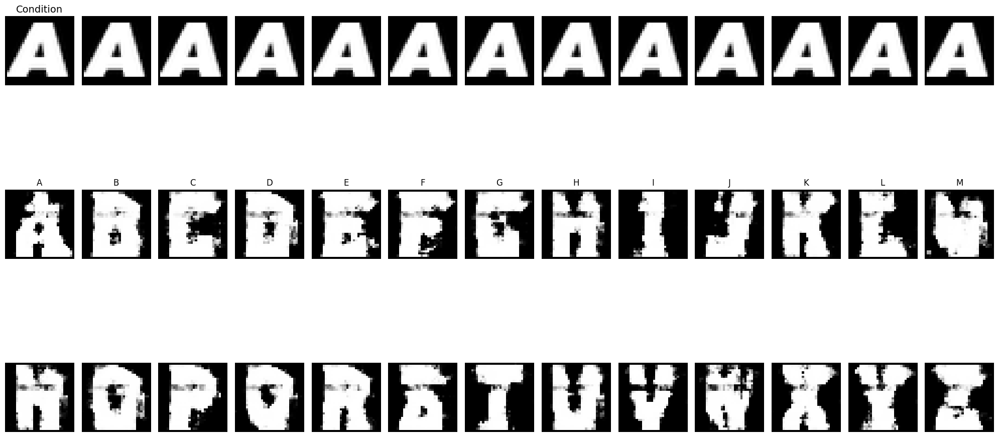

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


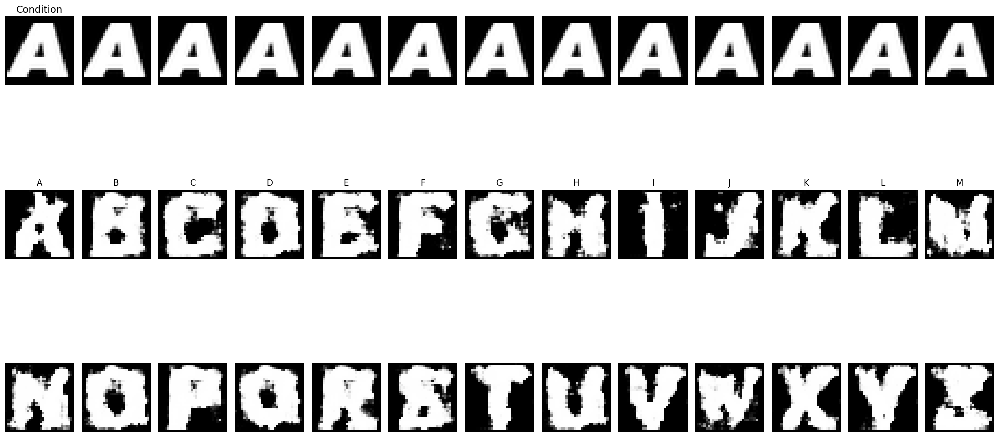

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


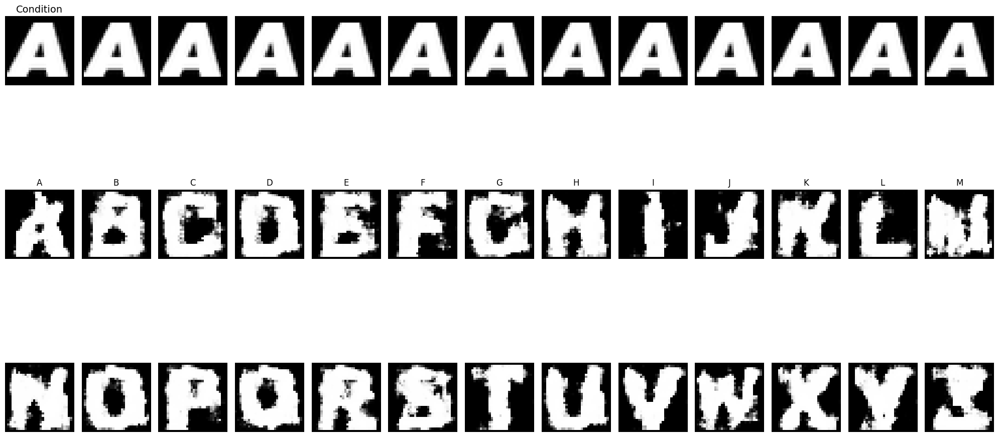

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


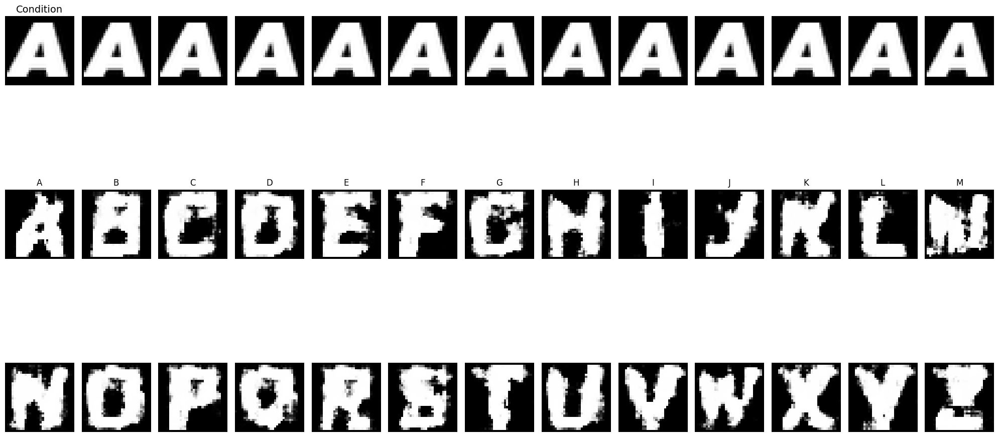

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


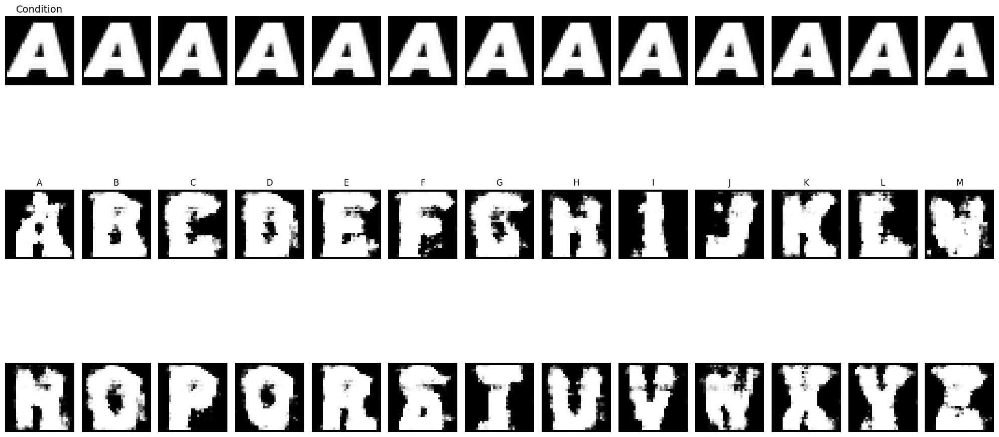

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


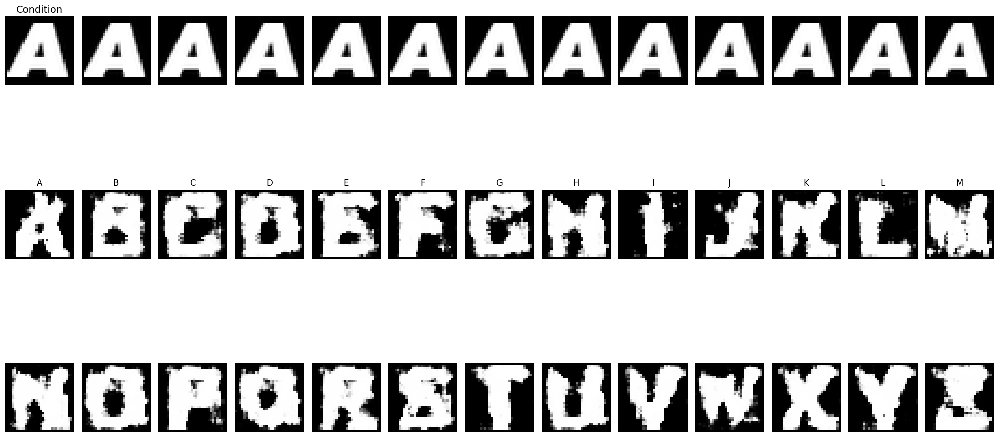

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


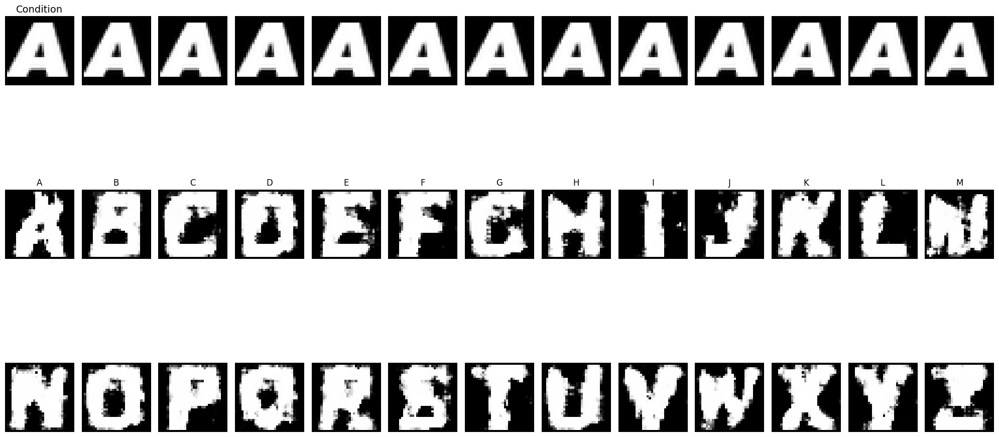

torch.Size([1, 1, 32, 32])
torch.Size([1, 1, 32, 32])
(32, 32)


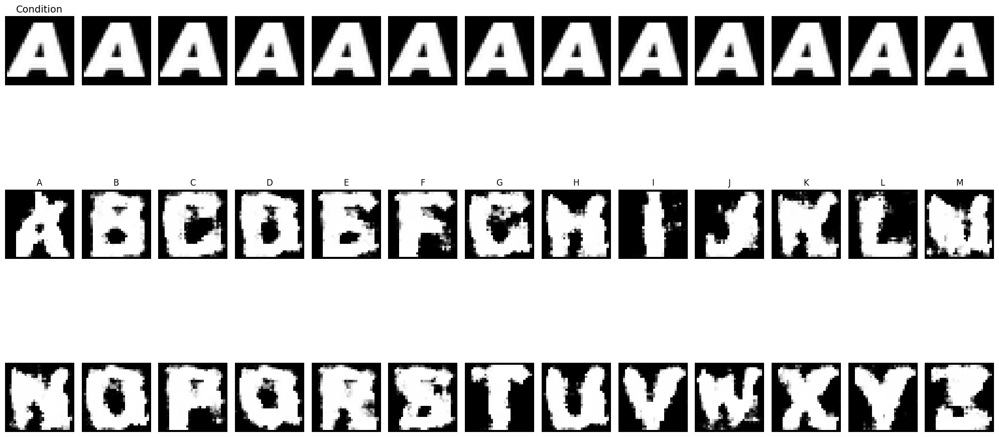

In [111]:
fig, axes = plt.subplots(3, 13, figsize=(20, 12))  # Adjust rows for conditional image (3 rows: 1 for condition + 2 for generated)
#axes = np.expand_dims(axes, axis=1)  # Ensure axes is 2D

for j, (real_imgs, condition_imgs, labels) in enumerate(display_data):
    fig, axes = plt.subplots(3, 13, figsize=(20, 12))  # Adjust rows for conditional image (3 rows: 1 for condition + 2 for generated)
    real_imgs = real_imgs.cuda()
    condition_imgs = condition_imgs.cuda()
    labels = labels.cuda()

    # Preprocess images
    real_imgs = real_imgs.permute(0, 2, 3, 1).cuda()
    condition_imgs = condition_imgs.permute(0, 2, 3, 1).cuda()
    print(condition_imgs.shape)
    condition_img = condition_imgs.squeeze(0)  # Add batch dimension
    print(condition_imgs.shape)

    # Select the first conditional image for display
    condition_img = condition_img[0, :, :].cpu().numpy()  # First condition image, single channel
    print(condition_img.shape)

    # Rescale the conditional image from [-1, 1] to [0, 255]
    condition_img = np.uint8(np.interp(condition_img, (-1, 1), (0, 255)))

    # Plot the conditional image in the first row
    for col in range(13):  # Display the same condition image across the row
        ax = axes[0, col]
        ax.imshow(condition_img, cmap='gray')
        ax.axis("off")
        if col == 0:  # Add a label for the row
            ax.set_title("Condition", fontsize=14)

    # Generate and display images for all classes
    z_s = torch.randn(1, 100, device='cuda')  # Style vector
    for class_index in range(num_classes):
        # Create the one-hot vector for the class
        z_c = torch.zeros(1, num_classes, device=device)
        z_c[0, class_index] = 1  # Set the desired class

        # Concatenate the style and class vectors
        z = torch.cat((z_s, z_c), dim=1)

        # Generate the image
        with torch.no_grad():
            generated_img = generator(z, condition_imgs).cpu().numpy()[0, 0]  # Extract the first batch and first channel

        # Rescale the image from [-1, 1] to [0, 255]
        generated_img = np.uint8(np.interp(generated_img, (-1, 1), (0, 255)))

        # Plot the image in the appropriate subplot
        row = (class_index // 13) + 1  # Offset by +1 to account for the condition row
        col = class_index % 13
        ax = axes[row, col]
        ax.imshow(generated_img, cmap='gray')
        ax.axis("off")
        if row == 1:  # Only set titles for the first generated row
            ax.set_title(chr(65 + class_index), fontsize=12)  # Display A-Z above images

    # Adjust layout and save the figure
    plt.tight_layout()
    plt.show()  # Display the figure
